In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import numpy as np
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader, TensorDataset

In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


In [ ]:
import os
folder_path = f"/content/drive/MyDrive/GRB_Project/GP_via_ANN_2/Saved_Outputs/"
os.makedirs(folder_path, exist_ok=True)
os.makedirs(f"{folder_path}/Final_Figures", exist_ok=True)
os.makedirs(f"{folder_path}/CSV_data", exist_ok=True)

In [ ]:
class GaussianANN(nn.Module):
    def __init__(self, input_dim=1, hidden_dim=32):
        super().__init__()
        self.hidden = nn.Sequential(
            nn.Linear(input_dim, hidden_dim),
            nn.ReLU(),
            nn.Linear(hidden_dim, hidden_dim),
            nn.ReLU()
        )
        self.mean = nn.Linear(hidden_dim, 1)
        self.log_var = nn.Linear(hidden_dim, 1)

    def forward(self, x):
        h = self.hidden(x)
        return self.mean(h), self.log_var(h)

# Custom negative log likelihood loss

def gaussian_nll(y_true, mean, log_var):
    nll= 0.5 * torch.mean(torch.exp(-log_var) * (y_true - mean)**2 + log_var)
    penalty = 0.05 * torch.mean(log_var**2)  # 0.005, 0.01, 0.05
    return torch.mean(nll) + penalty

In [ ]:
def run_model(grb_name):
    import pandas as pd

    print(f"\n-----TRAINING FOR {grb_name}-----\n")
    from scipy import stats as st
    GRB_Name = grb_name
    # header_names=['t', 'pos_t_err', 'neg_t_err', 'flux', 'pos_flux_err', 'neg_flux_err']
    trimmed_data = pd.read_csv("/content/drive/MyDrive/GRB_Project/GRBs_trimmed/"+ str(GRB_Name) +"_trimmed.csv")
    if len(trimmed_data.columns)==6:
      trimmed_data.columns = ["t", "pos_t_err", "neg_t_err", "flux", "pos_flux_err", "neg_flux_err"]
    else:
      trimmed_data.columns = ["0", "t", "pos_t_err", "neg_t_err", "flux", "pos_flux_err", "neg_flux_err"]

    density_factor = 1
    max_fluxes = np.max(trimmed_data["flux"])
    min_fluxes = np.min(trimmed_data["flux"])

    trim_t_val=trimmed_data["t"] if "t" in trimmed_data else trimmed_data["time_sec"]

    max_ts = np.max(trim_t_val)
    min_ts = np.min(trim_t_val)


    #ABOVE VALUES IN LOG SCALE
    log_max_fluxes = np.log10(max_fluxes)
    log_min_fluxes = np.log10(min_fluxes)

    log_max_ts = np.log10(max_ts)
    log_min_ts = np.log10(min_ts)

    #DEFINING THE ERROR VALUES FROM DATA FILE IN LINEAR SCALE

    #for time
    positive_ts_err = trimmed_data["pos_t_err"] if "pos_t_err" in trimmed_data else trimmed_data["timePos_sec"]
    negative_ts_err = trimmed_data["neg_t_err"] if "neg_t_err" in trimmed_data else trimmed_data["timeNeg_sec"]

    #for flux
    positive_fluxes_err = trimmed_data["pos_flux_err"] if "pos_flux_err" in trimmed_data else trimmed_data["flux_errPos"]
    negative_fluxes_err = trimmed_data["neg_flux_err"] if "neg_flux_err" in trimmed_data else trimmed_data["flux_errNeg"]


    #READING TIME AND FLUXES FROM THE TRIMMED DATA
    #THESE VALUES ARE IN LINEAR SCALE
    ts, fluxes = trim_t_val.to_numpy(), trimmed_data["flux"].to_numpy()

    #ABOVE VALUES IN LOG SCALE
    log_ts, log_fluxes = np.log10(ts), np.log10(fluxes)


    # ERROR ON THE FLUXES
    pos_fluxes= fluxes + positive_fluxes_err
    neg_fluxes= fluxes + negative_fluxes_err

    #SYMMETRIC ERROR VALUE
    fluxes_err_sym= (pos_fluxes - neg_fluxes )/2


    # GENERATES TIME VALUES AT EQUAL INTERVALS IN RANGE OF TS IN LINEAR SCALE
    # THIS IS TO BE USED FOR GENERATING THE TIMES AT WHICH WE RECONSTRUCT THE LC
    # IT IS EQUAL TO THE NUMBER OF DATA POINTS AS THE ORIGINAL LIGHT CURVE
    recon_t = np.geomspace(np.min(ts), np.max(ts), density_factor*len(ts))

    #ABOVE VALUE IN LOG SCALE
    log_recon_t = np.log10(recon_t)
    log_recon_t = log_recon_t.reshape(-1,1)

    #CALCULATING ERRORBAR IN LINEAR SCALE
    ts_error = (positive_ts_err - negative_ts_err )/2
    fluxes_error = (positive_fluxes_err - negative_fluxes_err)/2

    #CALCULATING ERRORBAR IN LOG SCALE

    pos_log_fluxes = np.log10(pos_fluxes)
    neg_log_fluxes = np.log10(neg_fluxes)

    #PLOTS ERRORBARS IN LOG SCALE
    plt.xlabel("Time")
    plt.ylabel("Flux")
    plt.errorbar(log_ts, log_fluxes, linestyle='none', yerr=[log_fluxes-neg_log_fluxes,pos_log_fluxes-log_fluxes], marker='o', capsize=5, label="Trimmed Data")
    plt.title(GRB_Name)
    print("\n-----ORIGINAL GRB-----\n")
    plt.show()

    log_ts_mean = np.mean(log_ts, keepdims=True)
    log_ts_std = np.std(log_ts, keepdims=True)
    log_ts_norm = (log_ts - log_ts_mean) / log_ts_std

    log_fluxes_mean = np.mean(log_fluxes, keepdims=True)
    log_fluxes_std = np.std(log_fluxes, keepdims=True)
    log_fluxes_norm = (log_fluxes - log_fluxes_mean) / log_fluxes_std

    # Convert to tensor
    train_x = torch.tensor(log_ts_norm, dtype=torch.float32)
    train_y = torch.tensor(log_fluxes_norm, dtype=torch.float32)



    log_fluxes_error = torch.tensor(fluxes_error / fluxes, dtype=torch.float32)

    print("\n------------------MODEL TRAINING BEGIN---------------------\n")

    dataset = TensorDataset(train_x, train_y)
    dataloader = DataLoader(dataset, batch_size=32, shuffle=True)
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    model = GaussianANN()
    optimizer = torch.optim.Adam(model.parameters(), lr=0.01)

    for epoch in range(500):
        for x_batch, y_batch in dataloader:
            x_batch, y_batch = x_batch.view(-1, 1), y_batch.view(-1, 1)
            optimizer.zero_grad()
            mean_pred, log_var_pred = model(x_batch)
            loss = gaussian_nll(y_batch, mean_pred, log_var_pred)
            loss.backward()
            optimizer.step()
        if epoch % 50 == 0:
            print(f"Epoch {epoch}, Loss: {loss.item():.4f}")

    model.eval()

    log_ts_sorted = np.sort(np.log10(ts))  # ts = original time array
    # log_recon_t = np.log10(ts).reshape(-1, 1)  # start with original points

    # for ff in range(0, len(log_ts_sorted) - 1):
    #     lowbound = log_ts_sorted[ff]
    #     upbound = log_ts_sorted[ff + 1]

    #     if np.abs(upbound - lowbound) >= 0.1:
    #         nofpoints = min(15, int(5 * np.abs(upbound - lowbound) / 0.1))
    #         segment = np.linspace(lowbound, upbound, nofpoints).reshape(-1, 1)
    #         log_recon_t = np.concatenate((log_recon_t, segment), axis=0)
    #GAP-AWARE reconstruction
    gaps = np.diff(log_ts)

    #new code for min gap 0.05, assign points based on the no. of original points
    min_gap = 0.05
    recon_log_t = [log_ts[0]]
    total_span = log_ts[-1] - log_ts[0]
    if len(ts) > 500:   # densest LC
        fraction = 0.05
    elif len(ts) > 250:
        fraction = 0.1
    elif len(ts) > 100:
        fraction = 0.3
    else:
        fraction = 0.4
    n_points = max(20, int(fraction * len(ts)))
    for i in range(len(ts) - 1):
        gap_size = log_ts[i+1] - log_ts[i]

        if gap_size > min_gap:
            # allocate points proportional to gap size
            interval_points = max(2, int(n_points * gap_size / total_span))
            interval = np.linspace(log_ts[i], log_ts[i+1], interval_points, endpoint=True)
            recon_log_t.extend(interval[1:])


    recon_log_t = np.array(recon_log_t)
    recon_t = 10**np.array(recon_log_t)
    recon_t = np.unique(recon_t)

    log_recon_t = np.log10(recon_t).reshape(-1, 1)

    log_recon_t = np.sort(log_recon_t, axis=0)

    test_x = (log_recon_t - log_ts.mean()) / log_ts.std()
    test_x_tensor = torch.tensor(test_x, dtype=torch.float32).to(device)

    with torch.no_grad():
        mu_pred, log_var_pred = model(test_x_tensor)  # model returns both
        std_pred = torch.exp(0.5 * log_var_pred).cpu().numpy().flatten()
        mu_pred = mu_pred.cpu().numpy().flatten()

    # points = []
    # for j in range(len(mu_pred)):
    #     fitted_dist = st.norm(loc=mu_pred[j], scale=std_pred[j])
    #     point = np.random.choice(fitted_dist.rvs(size=50), size=1) - mu_pred[j]
    #     points.append(point)

    # points = np.array(points).ravel()
    # Compute best fit distribution for noise
    fluxes_error = (positive_fluxes_err - negative_fluxes_err) / 2
    logfluxerrs = fluxes_error / (fluxes * np.log(10))
    distributions = [st.norm, st.laplace]
    fits = {}
    for dist in distributions:
        params = dist.fit(logfluxerrs)
        loglikelihood = np.sum(dist.logpdf(logfluxerrs, *params))
        fits[dist.name] = (params, loglikelihood)
    best_dist_name = max(fits, key=lambda d: fits[d][1])
    best_params = fits[best_dist_name][0]
    best_dist = getattr(st, best_dist_name)

    points=[]

    for j in range(len(mu_pred)):
        noise = 3.5 * (best_dist.rvs(*best_params, size=1)[0] - best_params[0])
        points.append(noise)
    points = np.array(points)


    new_points = mu_pred + points

    log_reconstructed_flux = (new_points * log_fluxes_std) + log_fluxes_mean
    # Generate error bars for reconstructed points
    recon_errorbar = []
    for _ in range(len(log_recon_t)):
        err_sample = best_dist.rvs(*best_params, size=1)[0]
        recon_errorbar.append(err_sample)
    recon_errorbar = np.abs(np.array(recon_errorbar))
    mean_prediction_denorm = (mu_pred * log_fluxes_std) + log_fluxes_mean
    lower_denorm = ((mu_pred - 2 * std_pred) * log_fluxes_std) + log_fluxes_mean
    upper_denorm = ((mu_pred + 2 * std_pred) * log_fluxes_std) + log_fluxes_mean

    test_x_denorm = test_x * log_ts.std() + log_ts.mean()
    train_x_denorm = (train_x.numpy() * log_ts_std) + log_ts_mean
    train_y_denorm = (train_y.numpy() * log_fluxes_std) + log_fluxes_mean

    fluxes_error = (positive_fluxes_err - negative_fluxes_err) / 2
    logfluxerrs = fluxes_error / (fluxes * np.log(10))

    # errparameters = st.norm.fit(logfluxerrs)
    # err_dist = st.norm(loc=errparameters[0], scale=errparameters[1])
    # recon_errorbar = err_dist.rvs(size=len(log_recon_t))

    plt.figure(figsize=(8, 6))

    # Original data
    plt.errorbar(train_x_denorm, train_y_denorm,
                yerr=[log_fluxes - neg_log_fluxes, pos_log_fluxes - log_fluxes],
                linestyle="", zorder=4)

    # Reconstructed data
    plt.errorbar(test_x_denorm, log_reconstructed_flux,
                yerr=np.abs(recon_errorbar),
                linestyle='none', marker='o', capsize=5, color='yellow',
                zorder=3, label="Reconstructed Points")

    # Mean prediction and CI
    plt.scatter(train_x_denorm, train_y_denorm, zorder=5, label='Observed Points')
    plt.plot(test_x_denorm, mean_prediction_denorm, label='Mean Prediction', zorder=2)
    plt.fill_between(test_x_denorm.flatten(), lower_denorm, upper_denorm,
                    alpha=0.5, color='orange', label='95% Confidence Region', zorder=1)

    plt.legend(loc='lower left')
    plt.xlabel('log$_{10}$(Time) (s)', fontsize=15)
    plt.ylabel('log$_{10}$(Flux) ($erg$ $cm^{-2}$$s^{-1}$)', fontsize=15)
    plt.title(f'Gaussian ANN on {GRB_Name}', fontsize=18)

    plt.savefig(f"{folder_path}/Final_Figures/{GRB_Name}.png", dpi=300)
    print("\n-----RECONSTRUCTED GRB-----\n")
    plt.show()

    # CALCULATING TIME ERROR IN LOG SCALE
    log_ts_error = ts_error/(ts*np.log(10))

    errparameters = st.norm.fit(log_ts_error) #GAUSSIAN FITTING ON TIME ERROR DISTRIBUTION
    err_dist_time = st.norm(loc=errparameters[0], scale=errparameters[1])

    recon_logtimeerr=err_dist_time.rvs(size=len(log_recon_t)) # len(log_ts_error)
    df = trimmed_data.copy(deep=True)

    for k in range(0, len(log_recon_t)):
        new_row = {
            "t": 10**log_recon_t[k],
            "pos_t_err": 10**recon_logtimeerr[k],
            "neg_t_err": 10**recon_logtimeerr[k],
            "flux": 10**log_reconstructed_flux[k],
            "pos_flux_err": 10**log_reconstructed_flux[k] * np.log(10) * recon_errorbar[k],
            "neg_flux_err": 10**log_reconstructed_flux[k] * np.log(10) * recon_errorbar[k]
        }

        new_row_df = pd.DataFrame(new_row)
        df = pd.concat([df, new_row_df], ignore_index=True)


    df.to_csv(f"{folder_path}/CSV_data/{GRB_Name}.csv", index=False)

    # print("\n-----5K FOLD VALIDATION BEGIN-----\n")
    # from sklearn.model_selection import KFold
    # import torch.nn.functional as F


    # kf = KFold(n_splits=5, shuffle=True, random_state=42)
    # file_path = f"{folder_path}/MSE_data.csv"
    # write_header = not os.path.exists(file_path)

    # test_mse_scores = []
    # train_mse_scores = []

    # for fold, (train_idx, test_idx) in enumerate(kf.split(train_x, train_y)):
    #     print(f"Training on fold {fold+1}/5...")

    #     train_x_fold, test_x_fold = train_x[train_idx].to(device), train_x[test_idx].to(device)
    #     train_y_fold, test_y_fold = train_y[train_idx].to(device), train_y[test_idx].to(device)

    #     train_x_fold = train_x_fold.view(-1, 1)
    #     test_x_fold = test_x_fold.view(-1, 1)
    #     train_y_fold = train_y_fold.view(-1, 1)
    #     test_y_fold = test_y_fold.view(-1, 1)

    #     model = GaussianANN(input_dim=train_x_fold.shape[1]).to(device)
    #     model.train()

    #     optimizer = torch.optim.Adam(model.parameters(), lr=0.01)

    #     num_iterations = 100
    #     for i in range(num_iterations):
    #         optimizer.zero_grad()
    #         mean_pred, log_var_pred = model(train_x_fold)
    #         loss = gaussian_nll(train_y_fold, mean_pred, log_var_pred)
    #         loss.backward()
    #         optimizer.step()

    #         with torch.no_grad():

    #             train_pred_denorm = (mean_pred.detach().cpu().numpy() * log_fluxes_std + log_fluxes_mean)
    #             train_y_denorm = (train_y_fold.detach().cpu().numpy() * log_fluxes_std + log_fluxes_mean)

    #             train_pred_tensor = torch.tensor(train_pred_denorm, dtype=torch.float32)
    #             train_y_tensor = torch.tensor(train_y_denorm, dtype=torch.float32)

    #             train_mse_value = F.mse_loss(train_pred_tensor, train_y_tensor).item()
    #             train_mse_scores.append(train_mse_value)

    #         if (i + 1) % 50 == 0:
    #             print(f"Fold {fold+1} - Iteration {i+1}/{num_iterations} - Loss: {loss.item():.4f}")

    #     model.eval()
    #     with torch.no_grad():
    #         mean_prediction, _ = model(test_x_fold)
    #         test_pred_denorm = (mean_prediction.detach().cpu().numpy() * log_fluxes_std + log_fluxes_mean)
    #         test_y_fold_denorm = (test_y_fold.detach().cpu().numpy() * log_fluxes_std + log_fluxes_mean)

    #         test_pred_tensor = torch.tensor(test_pred_denorm, dtype=torch.float32)
    #         test_y_tensor = torch.tensor(test_y_fold_denorm, dtype=torch.float32)

    #         test_mse_value = F.mse_loss(test_pred_tensor, test_y_tensor).item()
    #         test_mse_scores.append(test_mse_value)

    #     print(f"Fold {fold+1} - Test MSE: {test_mse_value:.4f}")

    # mean_train_mse = np.mean(train_mse_scores)
    # mean_test_mse = np.mean(test_mse_scores)

    # data = {
    #         "GRB_Name": [GRB_Name],
    #         "Final_Train_MSE": [mean_train_mse],
    #         "Final_Validation_MSE":[mean_test_mse]}

    # df = pd.DataFrame(data)
    # df.to_csv(file_path, mode='a', header=write_header, index=False)

    # print("\n-----SAVING TRAIN AND TEST MSE-----\n")
    # print(f"Mean Train MSE: {mean_train_mse:4f}")
    # print(f"Mean Test MSE: {mean_test_mse:.4f}")






-----TRAINING FOR GRB050128-----


-----ORIGINAL GRB-----



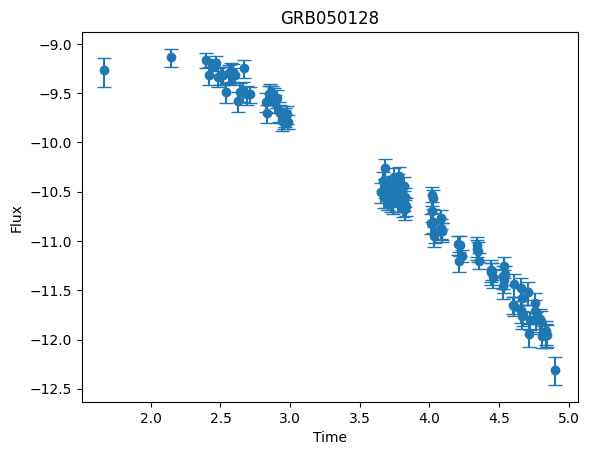


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.2051
Epoch 50, Loss: -0.8812
Epoch 100, Loss: -0.9458
Epoch 150, Loss: -0.9582
Epoch 200, Loss: -0.9497
Epoch 250, Loss: -0.9527
Epoch 300, Loss: -0.8436
Epoch 350, Loss: -0.9015
Epoch 400, Loss: -0.9598
Epoch 450, Loss: -0.9399

-----RECONSTRUCTED GRB-----



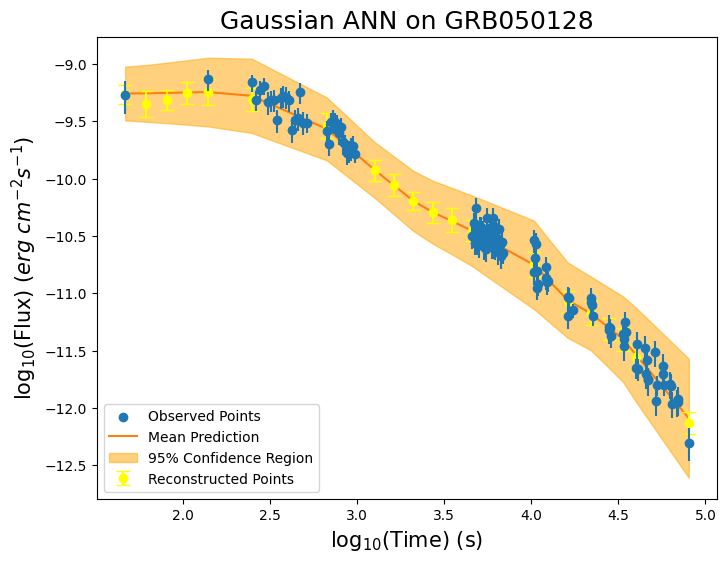


-----TRAINING FOR GRB050502B-----


-----ORIGINAL GRB-----



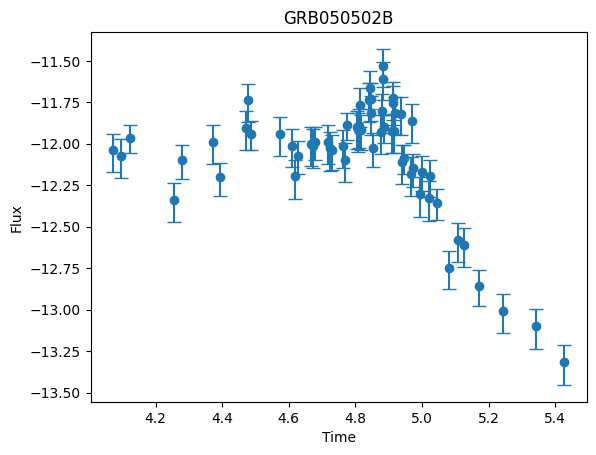


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.3142
Epoch 50, Loss: -0.5004
Epoch 100, Loss: -0.5321
Epoch 150, Loss: -0.4743
Epoch 200, Loss: -0.5085
Epoch 250, Loss: -0.4624
Epoch 300, Loss: -0.5783
Epoch 350, Loss: -0.4682
Epoch 400, Loss: -0.5800
Epoch 450, Loss: -0.5168

-----RECONSTRUCTED GRB-----



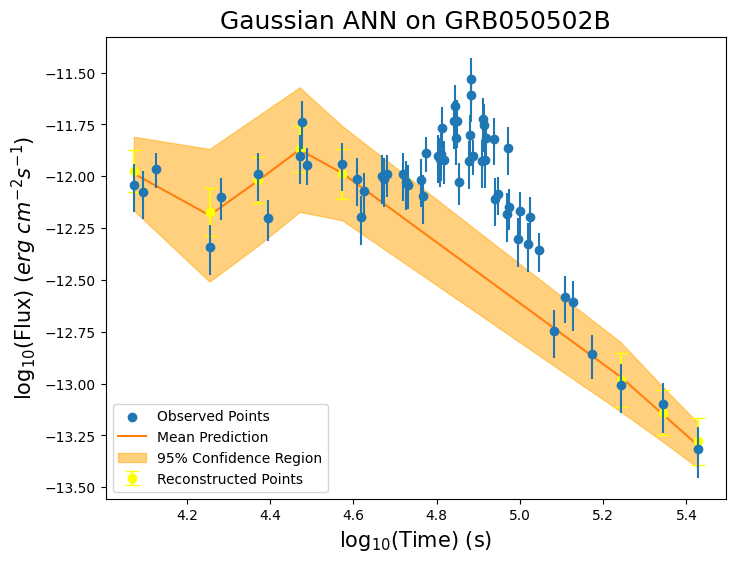


-----TRAINING FOR GRB050607-----


-----ORIGINAL GRB-----



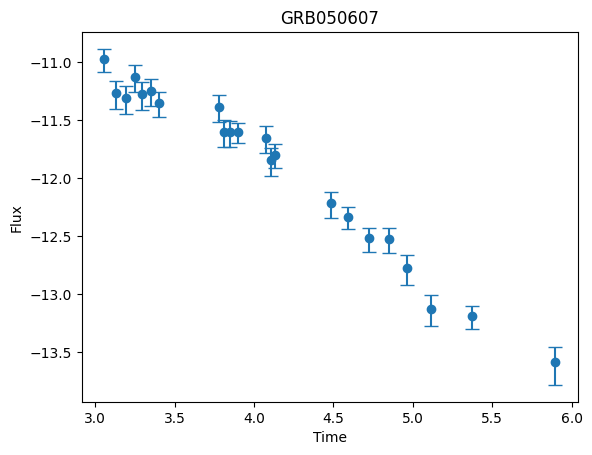


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.4748
Epoch 50, Loss: -0.9560
Epoch 100, Loss: -0.9973
Epoch 150, Loss: -1.0166
Epoch 200, Loss: -1.0187
Epoch 250, Loss: -1.0321
Epoch 300, Loss: -1.0367
Epoch 350, Loss: -1.0526
Epoch 400, Loss: -1.0743
Epoch 450, Loss: -1.0785

-----RECONSTRUCTED GRB-----



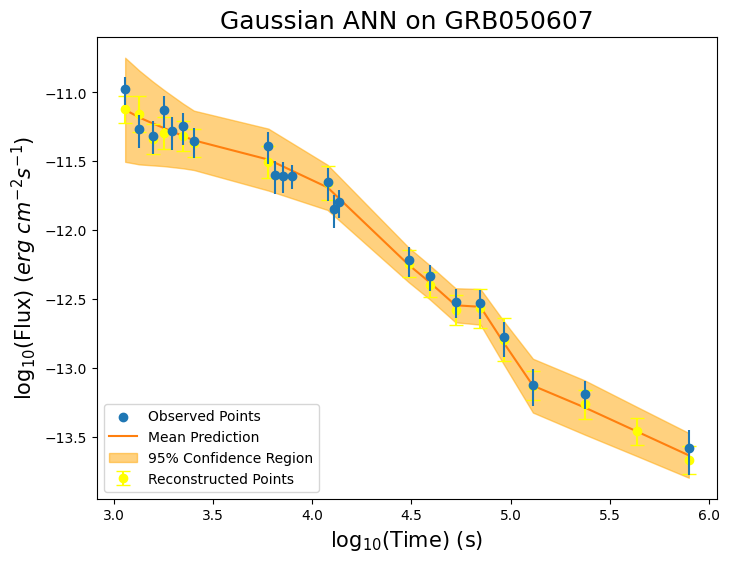


-----TRAINING FOR GRB050712-----


-----ORIGINAL GRB-----



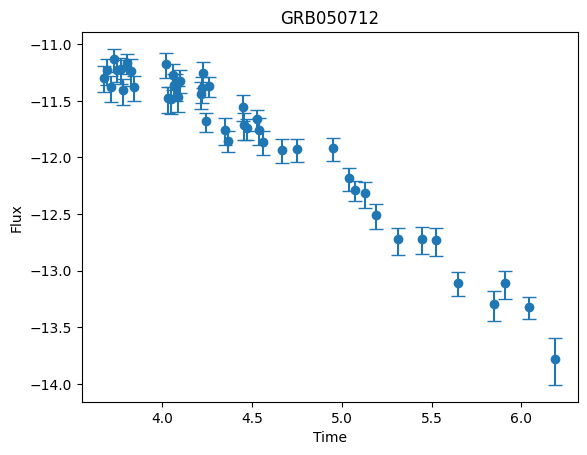


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.2970
Epoch 50, Loss: -0.8198
Epoch 100, Loss: -0.7296
Epoch 150, Loss: -0.8900
Epoch 200, Loss: -0.7564
Epoch 250, Loss: -0.7330
Epoch 300, Loss: -0.9214
Epoch 350, Loss: -0.8686
Epoch 400, Loss: -0.8164
Epoch 450, Loss: -0.8587

-----RECONSTRUCTED GRB-----



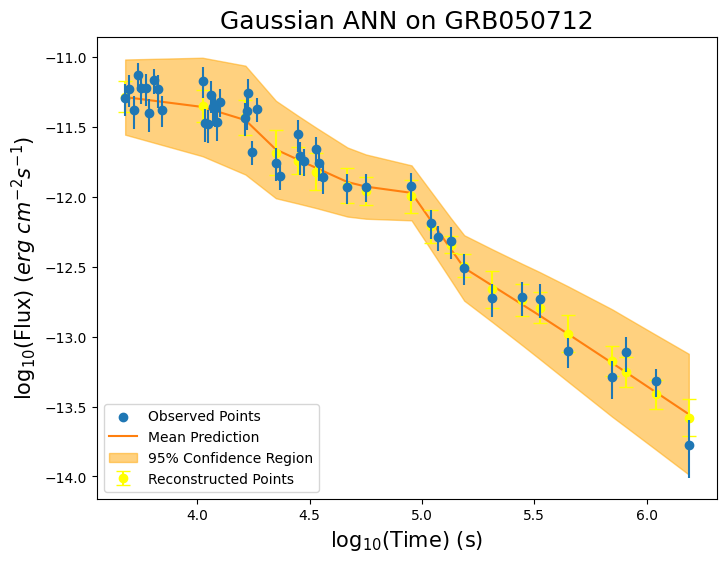


-----TRAINING FOR GRB050713A-----


-----ORIGINAL GRB-----



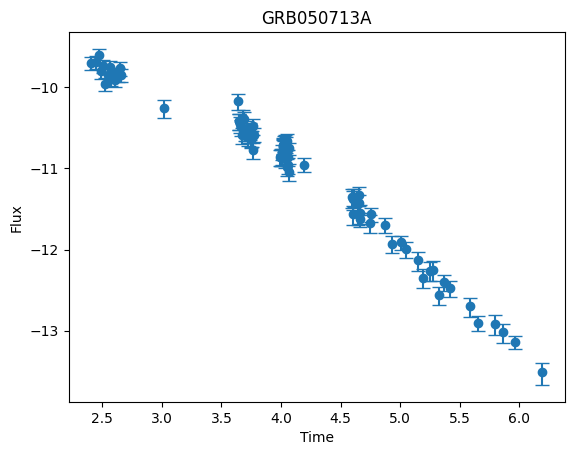


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.2034
Epoch 50, Loss: -1.0222
Epoch 100, Loss: -0.9833
Epoch 150, Loss: -0.9348
Epoch 200, Loss: -0.9775
Epoch 250, Loss: -0.8636
Epoch 300, Loss: -0.9360
Epoch 350, Loss: -1.0537
Epoch 400, Loss: -1.0139
Epoch 450, Loss: -1.0065

-----RECONSTRUCTED GRB-----



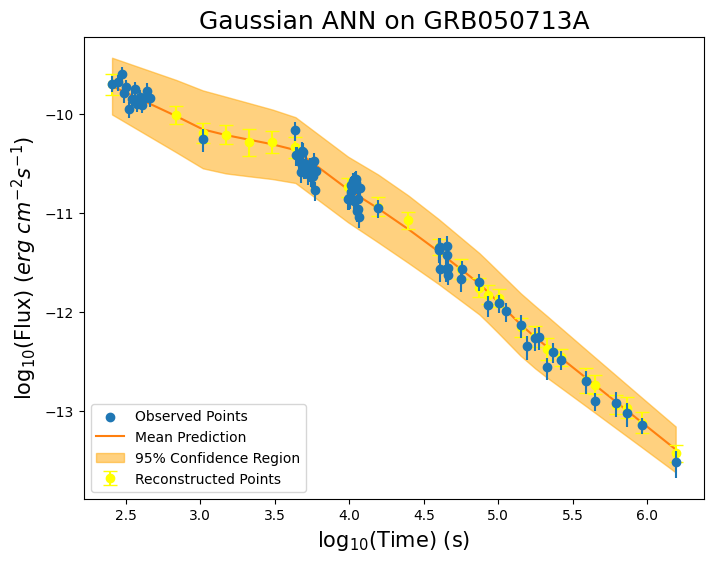


-----TRAINING FOR GRB050713B-----


-----ORIGINAL GRB-----



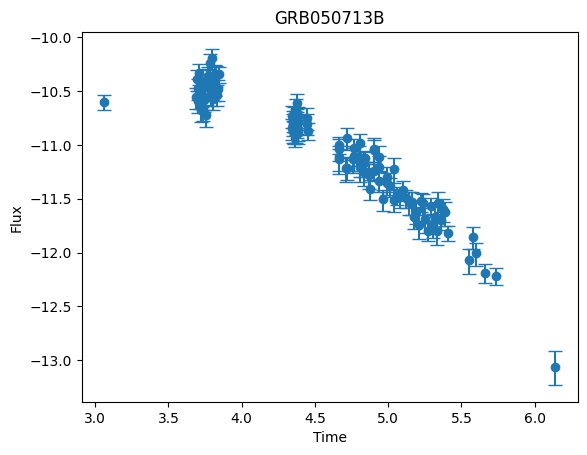


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.1865
Epoch 50, Loss: -0.6061
Epoch 100, Loss: -0.5964
Epoch 150, Loss: -0.5663
Epoch 200, Loss: -0.4596
Epoch 250, Loss: -0.7018
Epoch 300, Loss: -0.5913
Epoch 350, Loss: -0.6692
Epoch 400, Loss: -0.6687
Epoch 450, Loss: -0.7521

-----RECONSTRUCTED GRB-----



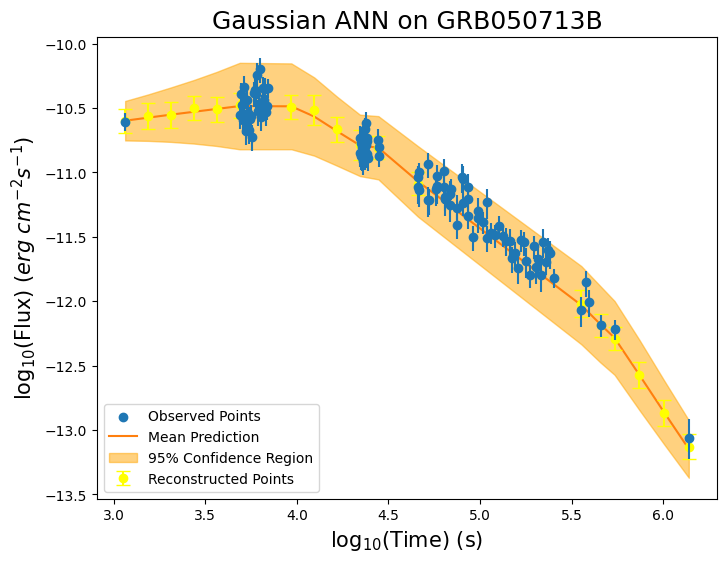


-----TRAINING FOR GRB050726-----


-----ORIGINAL GRB-----



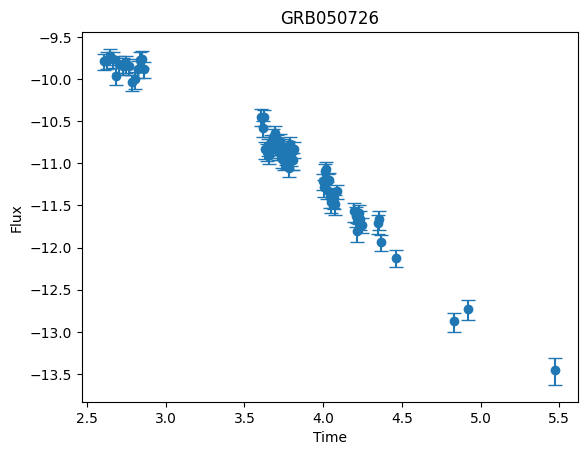


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.2217
Epoch 50, Loss: -0.8274
Epoch 100, Loss: -0.6743
Epoch 150, Loss: -0.8497
Epoch 200, Loss: -0.8985
Epoch 250, Loss: -0.8556
Epoch 300, Loss: -0.9245
Epoch 350, Loss: -0.8218
Epoch 400, Loss: -0.8707
Epoch 450, Loss: -0.9587

-----RECONSTRUCTED GRB-----



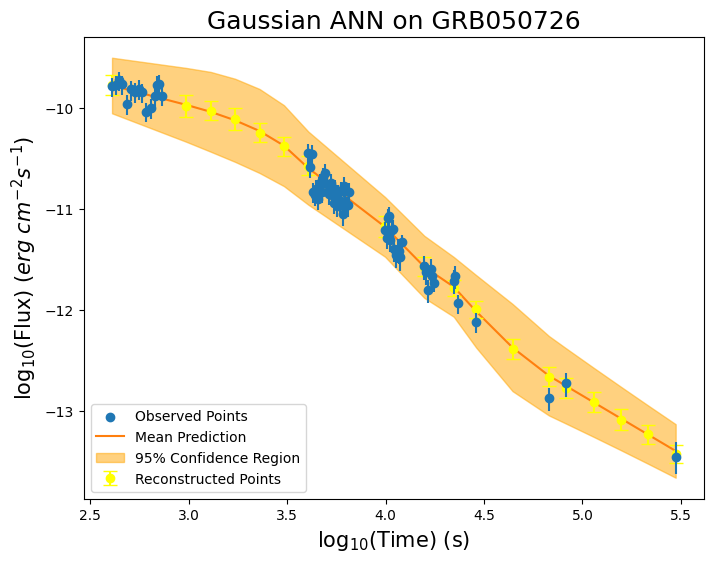


-----TRAINING FOR GRB050814-----


-----ORIGINAL GRB-----



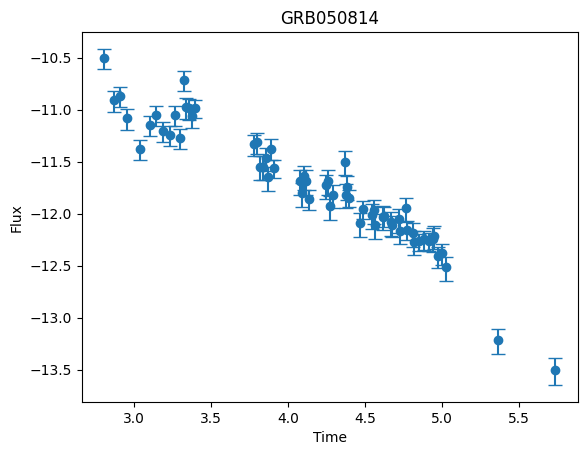


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.3801
Epoch 50, Loss: -0.6771
Epoch 100, Loss: -0.7780
Epoch 150, Loss: -0.6522
Epoch 200, Loss: -0.8186
Epoch 250, Loss: -0.8189
Epoch 300, Loss: -0.8611
Epoch 350, Loss: -0.7913
Epoch 400, Loss: -0.7701
Epoch 450, Loss: -0.7764

-----RECONSTRUCTED GRB-----



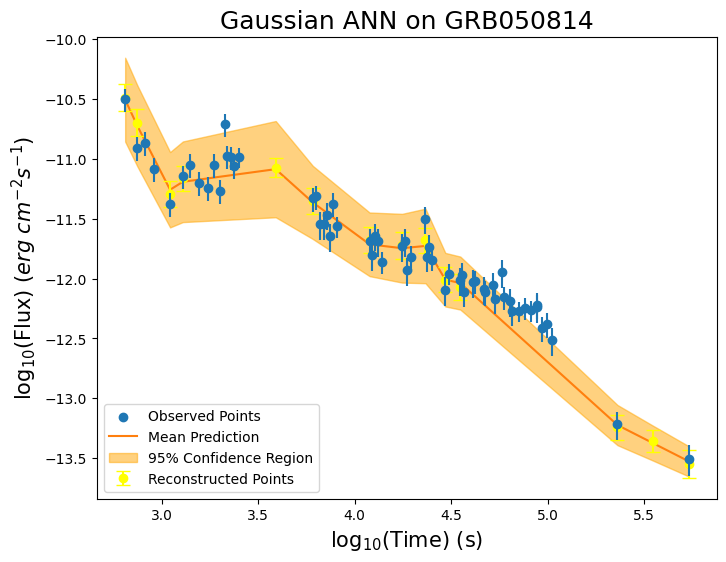


-----TRAINING FOR GRB050822-----


-----ORIGINAL GRB-----



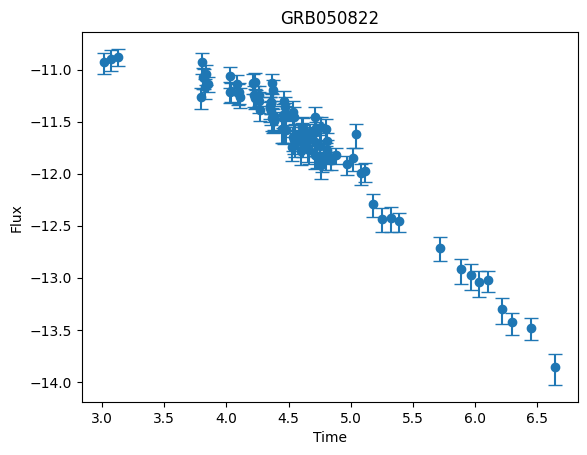


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.1684
Epoch 50, Loss: -0.8113
Epoch 100, Loss: -0.8189
Epoch 150, Loss: -0.7893
Epoch 200, Loss: -0.8124
Epoch 250, Loss: -0.7432
Epoch 300, Loss: -0.8383
Epoch 350, Loss: -0.7956
Epoch 400, Loss: -0.7551
Epoch 450, Loss: -0.8022

-----RECONSTRUCTED GRB-----



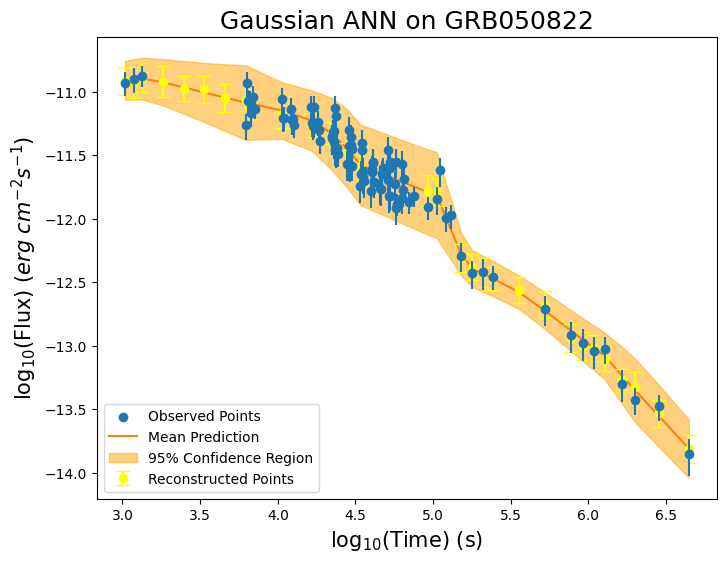


-----TRAINING FOR GRB050915B-----


-----ORIGINAL GRB-----



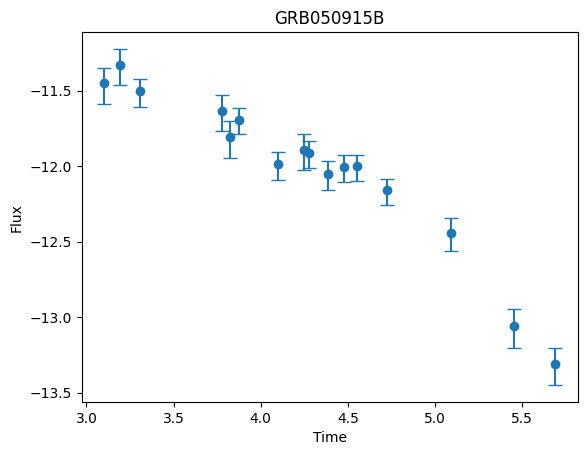


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.4660
Epoch 50, Loss: -0.9558
Epoch 100, Loss: -0.9931
Epoch 150, Loss: -1.0052
Epoch 200, Loss: -1.0042
Epoch 250, Loss: -1.0064
Epoch 300, Loss: -1.0083
Epoch 350, Loss: -1.0111
Epoch 400, Loss: -1.0121
Epoch 450, Loss: -1.0059

-----RECONSTRUCTED GRB-----



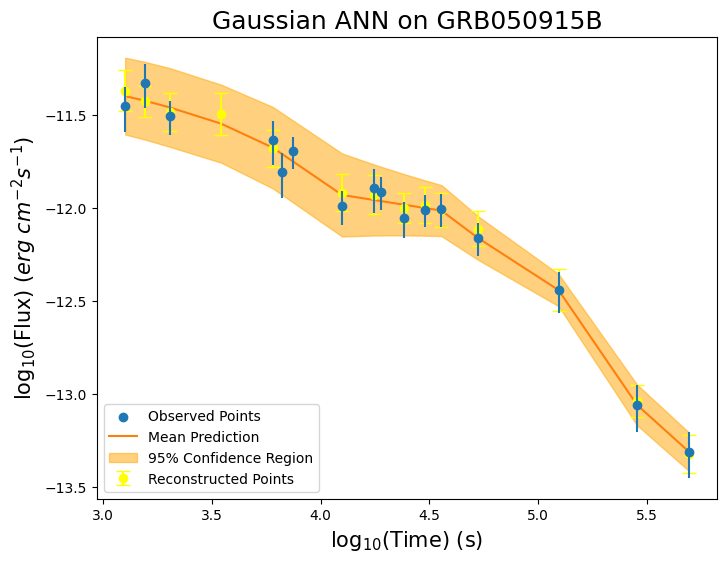


-----TRAINING FOR GRB050922B-----


-----ORIGINAL GRB-----



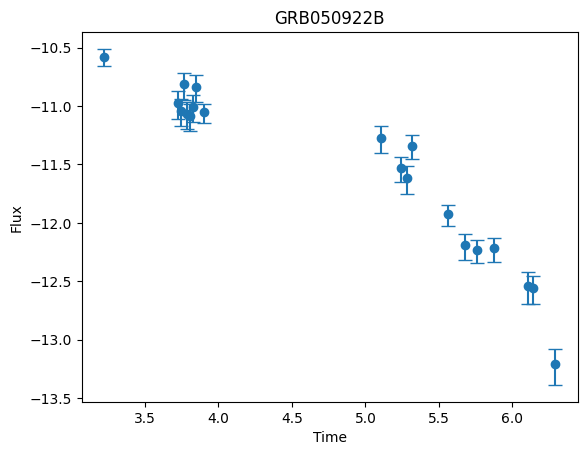


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.6028
Epoch 50, Loss: -0.7870
Epoch 100, Loss: -0.8166
Epoch 150, Loss: -0.8452
Epoch 200, Loss: -0.8911
Epoch 250, Loss: -0.9289
Epoch 300, Loss: -0.9329
Epoch 350, Loss: -0.9388
Epoch 400, Loss: -0.9420
Epoch 450, Loss: -0.9383

-----RECONSTRUCTED GRB-----



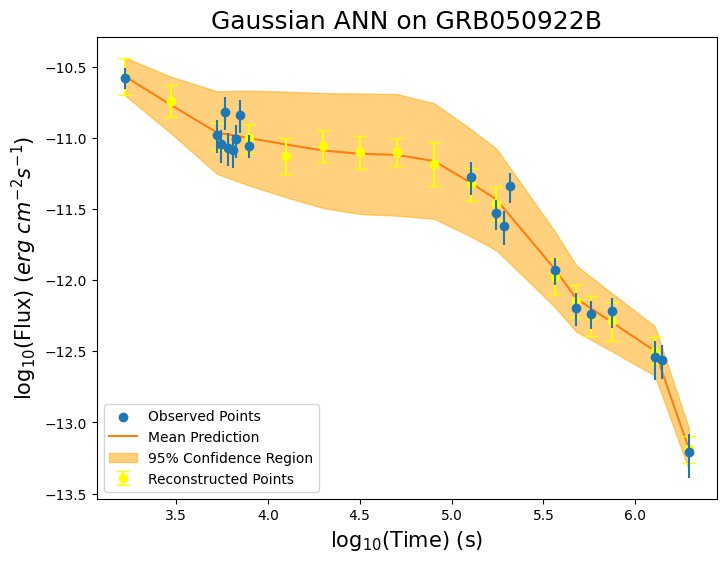


-----TRAINING FOR GRB051016A-----


-----ORIGINAL GRB-----



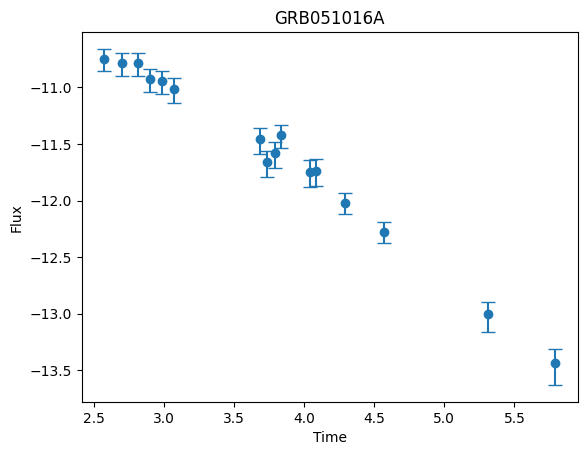


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.5013
Epoch 50, Loss: -1.0653
Epoch 100, Loss: -1.0842
Epoch 150, Loss: -1.0915
Epoch 200, Loss: -1.1003
Epoch 250, Loss: -1.1009
Epoch 300, Loss: -1.1017
Epoch 350, Loss: -1.1212
Epoch 400, Loss: -1.1248
Epoch 450, Loss: -1.1269

-----RECONSTRUCTED GRB-----



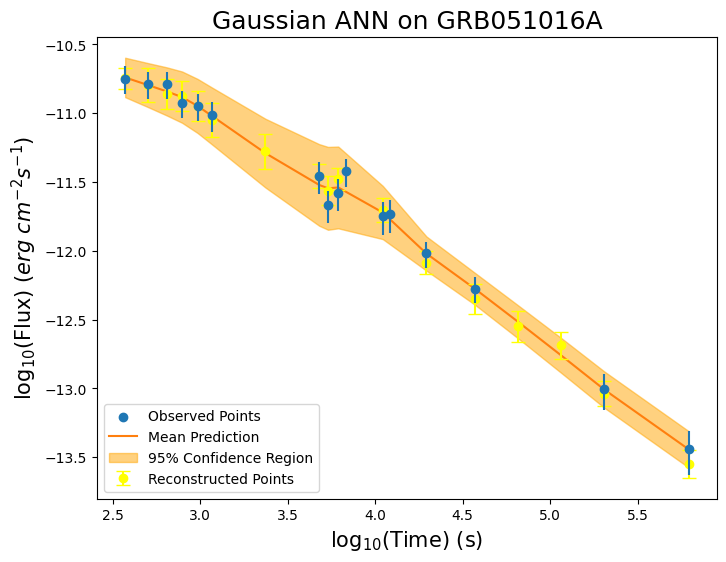


-----TRAINING FOR GRB060105-----


-----ORIGINAL GRB-----



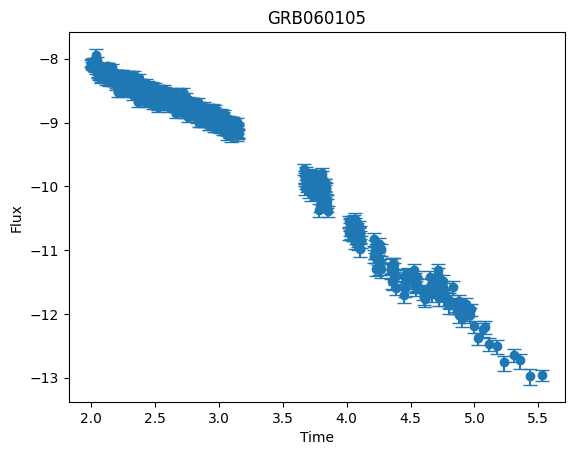


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: -0.9041
Epoch 50, Loss: -1.0393
Epoch 100, Loss: -0.9779
Epoch 150, Loss: -1.0454
Epoch 200, Loss: -1.0582
Epoch 250, Loss: -0.9994
Epoch 300, Loss: -1.0776
Epoch 350, Loss: -1.0445
Epoch 400, Loss: -1.0553
Epoch 450, Loss: -1.1011

-----RECONSTRUCTED GRB-----



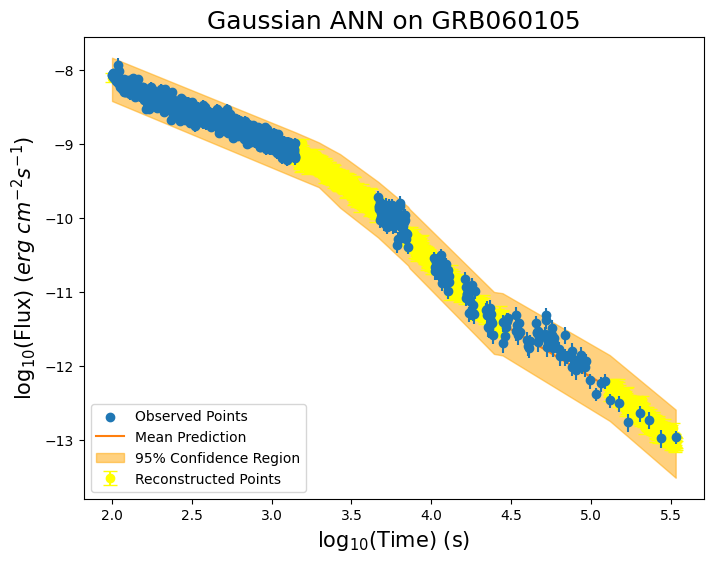


-----TRAINING FOR GRB060108-----


-----ORIGINAL GRB-----



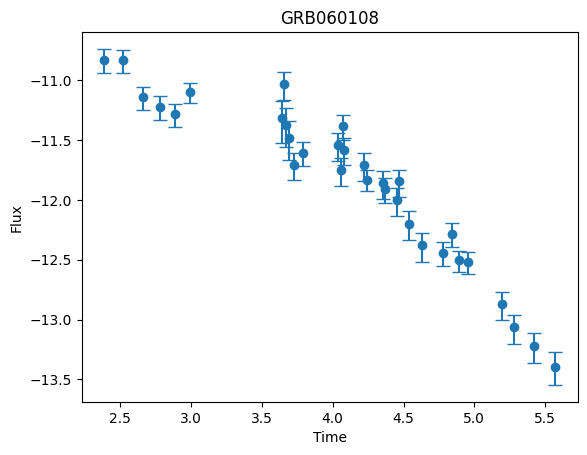


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.4723
Epoch 50, Loss: -0.7585
Epoch 100, Loss: -0.7912
Epoch 150, Loss: -0.8007
Epoch 200, Loss: -0.8036
Epoch 250, Loss: -0.8096
Epoch 300, Loss: -0.8122
Epoch 350, Loss: -0.8247
Epoch 400, Loss: -0.8370
Epoch 450, Loss: -0.8506

-----RECONSTRUCTED GRB-----



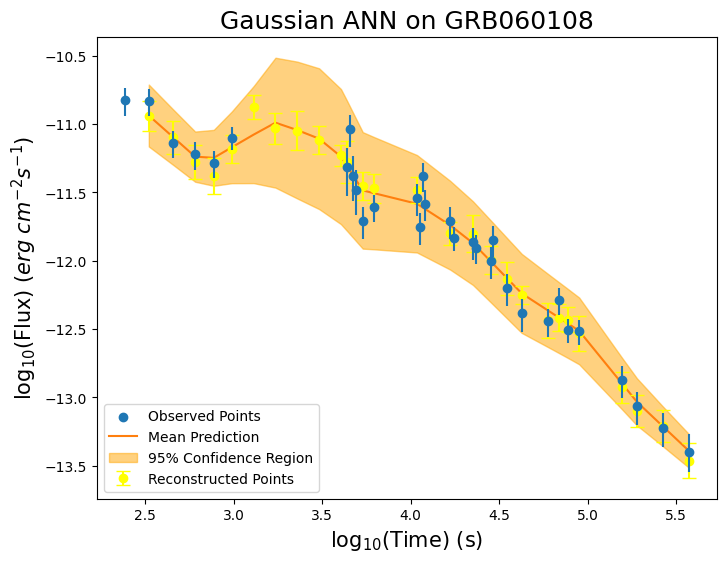


-----TRAINING FOR GRB060109-----


-----ORIGINAL GRB-----



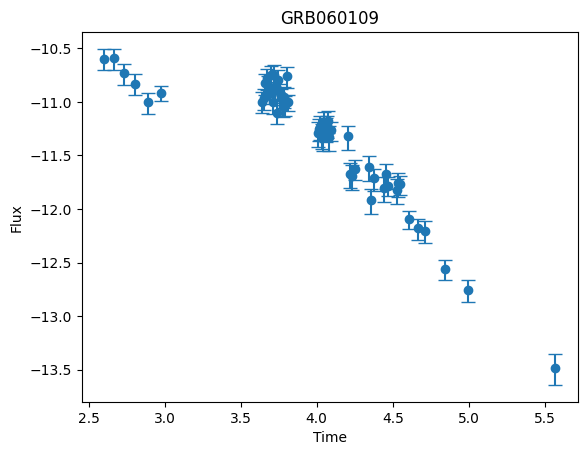


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.4907
Epoch 50, Loss: -0.7521
Epoch 100, Loss: -0.7375
Epoch 150, Loss: -0.7460
Epoch 200, Loss: -0.8096
Epoch 250, Loss: -0.8518
Epoch 300, Loss: -0.8609
Epoch 350, Loss: -0.8921
Epoch 400, Loss: -0.8546
Epoch 450, Loss: -0.8771

-----RECONSTRUCTED GRB-----



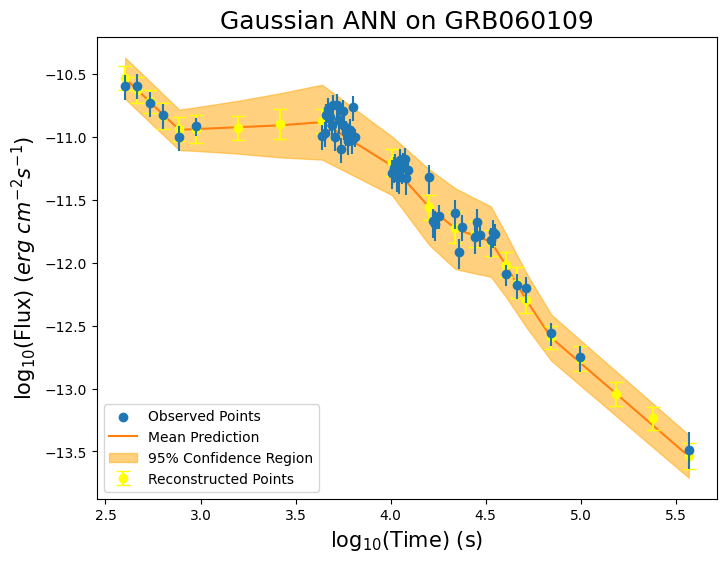


-----TRAINING FOR GRB060219-----


-----ORIGINAL GRB-----



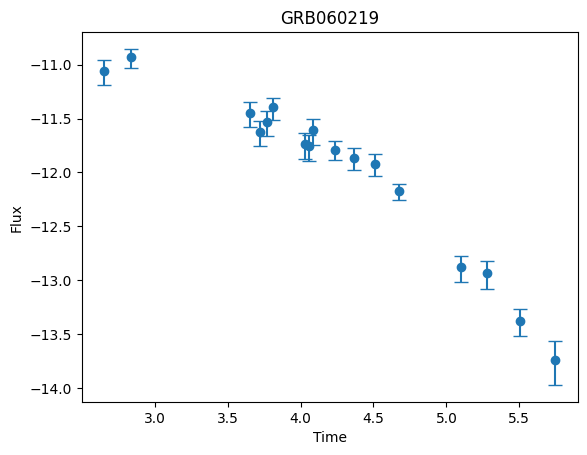


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.4567
Epoch 50, Loss: -0.9681
Epoch 100, Loss: -1.0090
Epoch 150, Loss: -1.0259
Epoch 200, Loss: -0.9960
Epoch 250, Loss: -1.0571
Epoch 300, Loss: -1.0225
Epoch 350, Loss: -1.0920
Epoch 400, Loss: -1.0993
Epoch 450, Loss: -1.1024

-----RECONSTRUCTED GRB-----



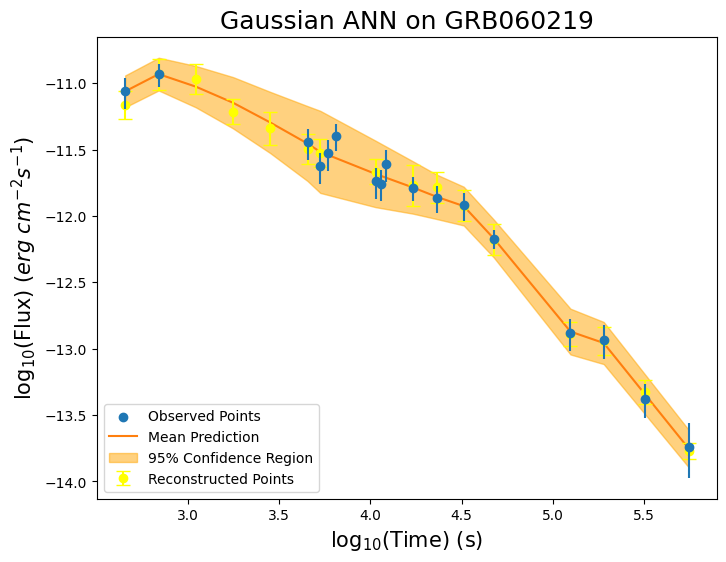


-----TRAINING FOR GRB060312-----


-----ORIGINAL GRB-----



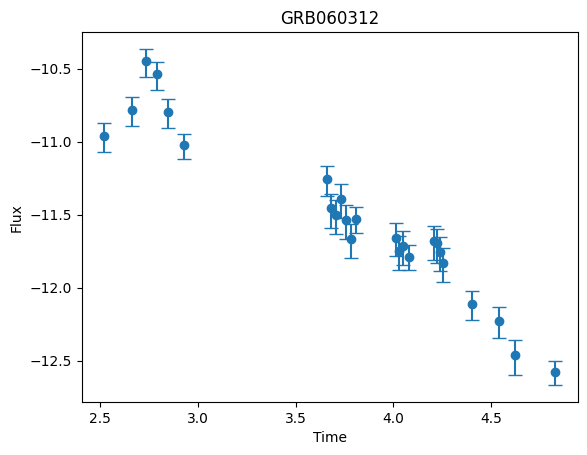


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.5444
Epoch 50, Loss: -0.7247
Epoch 100, Loss: -0.8039
Epoch 150, Loss: -0.8543
Epoch 200, Loss: -0.8980
Epoch 250, Loss: -0.9613
Epoch 300, Loss: -0.9762
Epoch 350, Loss: -1.0306
Epoch 400, Loss: -1.0238
Epoch 450, Loss: -1.0491

-----RECONSTRUCTED GRB-----



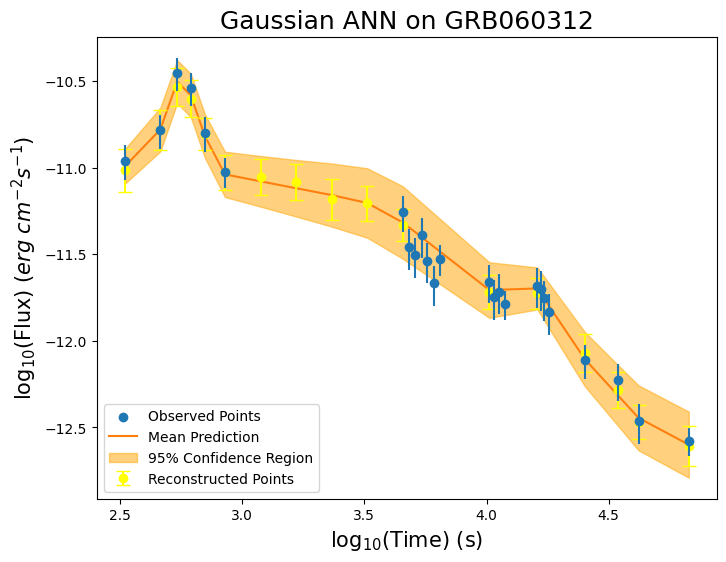


-----TRAINING FOR GRB060413-----


-----ORIGINAL GRB-----



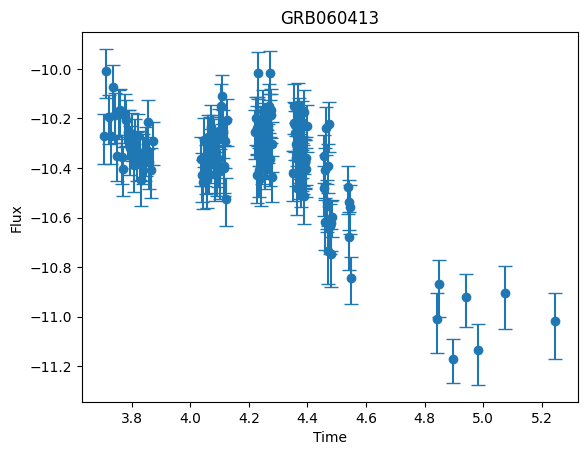


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.2921
Epoch 50, Loss: 0.0263
Epoch 100, Loss: 0.0132
Epoch 150, Loss: -0.1678
Epoch 200, Loss: -0.1901
Epoch 250, Loss: -0.0392
Epoch 300, Loss: -0.2324
Epoch 350, Loss: -0.1710
Epoch 400, Loss: -0.0516
Epoch 450, Loss: 0.1407

-----RECONSTRUCTED GRB-----



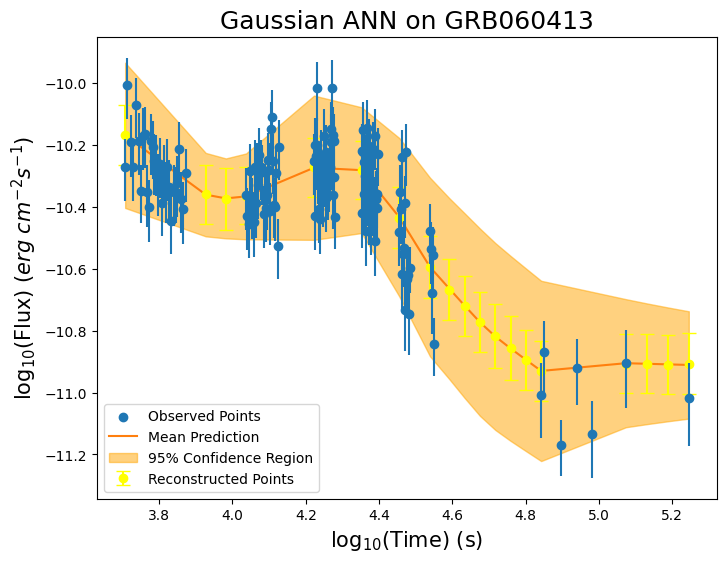


-----TRAINING FOR GRB060421-----


-----ORIGINAL GRB-----



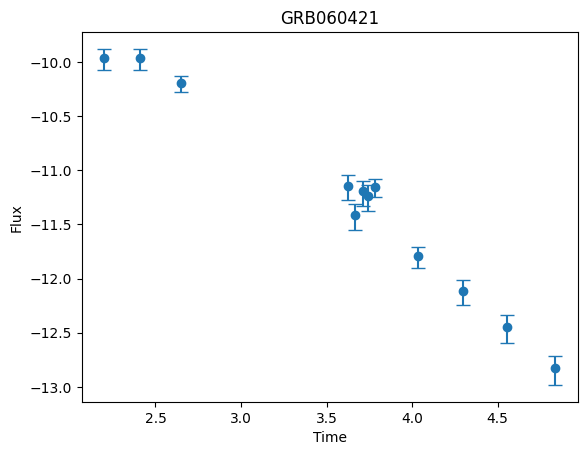


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.5444
Epoch 50, Loss: -1.0035
Epoch 100, Loss: -1.0359
Epoch 150, Loss: -1.0633
Epoch 200, Loss: -1.0782
Epoch 250, Loss: -1.0815
Epoch 300, Loss: -1.1088
Epoch 350, Loss: -1.0530
Epoch 400, Loss: -1.1273
Epoch 450, Loss: -1.1313

-----RECONSTRUCTED GRB-----



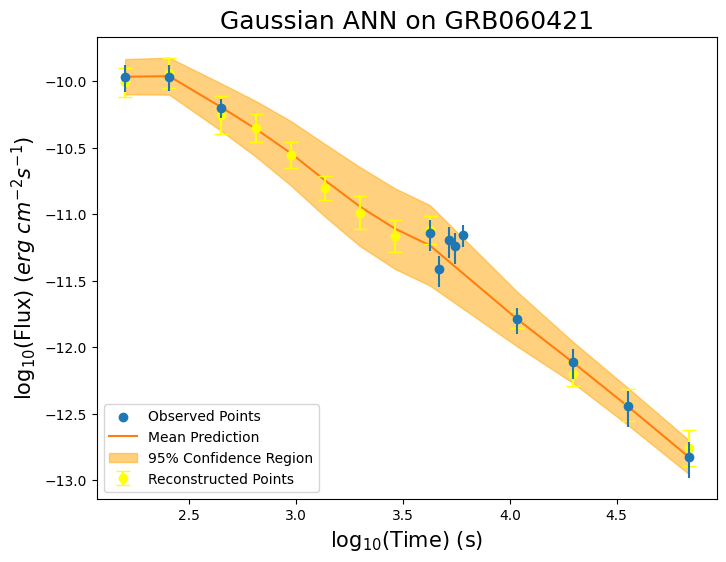


-----TRAINING FOR GRB060510A-----


-----ORIGINAL GRB-----



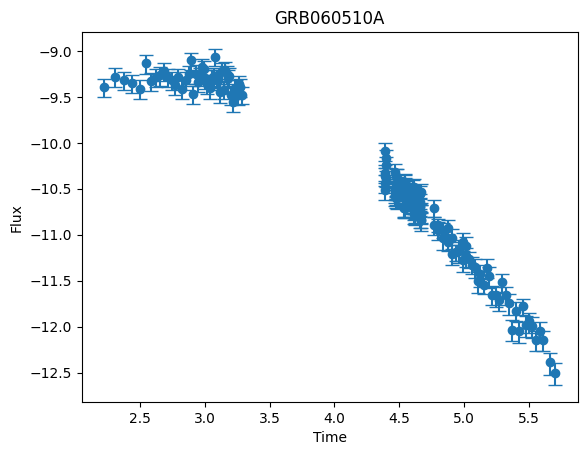


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: -0.1564
Epoch 50, Loss: -1.0112
Epoch 100, Loss: -0.3648
Epoch 150, Loss: -0.9185
Epoch 200, Loss: -0.6513
Epoch 250, Loss: -0.9862
Epoch 300, Loss: -0.6548
Epoch 350, Loss: -0.6806
Epoch 400, Loss: -1.0856
Epoch 450, Loss: -0.9579

-----RECONSTRUCTED GRB-----



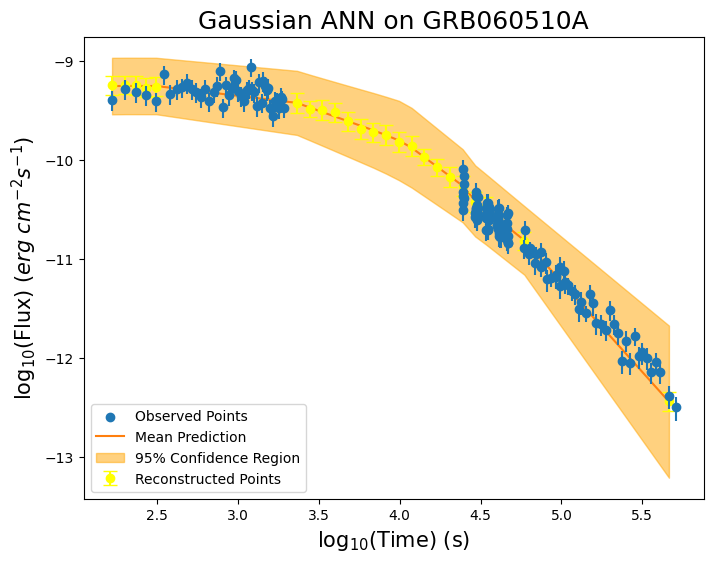


-----TRAINING FOR GRB060719-----


-----ORIGINAL GRB-----



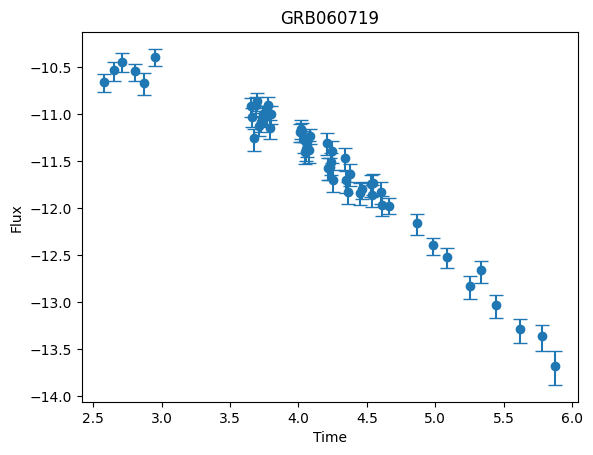


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.3462
Epoch 50, Loss: -0.7936
Epoch 100, Loss: -0.8872
Epoch 150, Loss: -0.8909
Epoch 200, Loss: -0.8649
Epoch 250, Loss: -0.8992
Epoch 300, Loss: -0.8661
Epoch 350, Loss: -0.8472
Epoch 400, Loss: -0.8989
Epoch 450, Loss: -0.9485

-----RECONSTRUCTED GRB-----



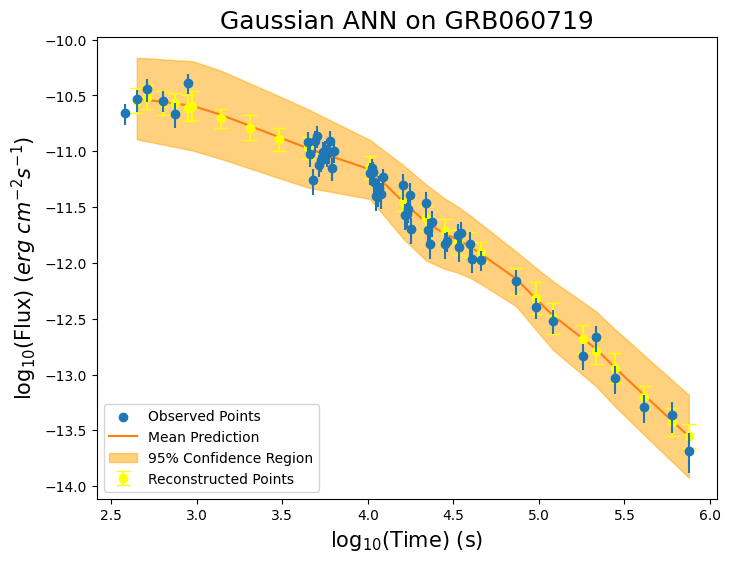


-----TRAINING FOR GRB060805A-----


-----ORIGINAL GRB-----



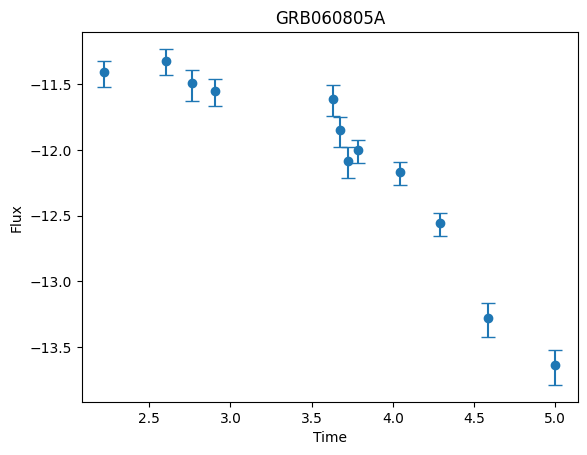


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.6205
Epoch 50, Loss: -0.8821
Epoch 100, Loss: -0.9879
Epoch 150, Loss: -1.0148
Epoch 200, Loss: -1.0321
Epoch 250, Loss: -0.9143
Epoch 300, Loss: -1.0739
Epoch 350, Loss: -1.0894
Epoch 400, Loss: -1.1152
Epoch 450, Loss: -1.1466

-----RECONSTRUCTED GRB-----



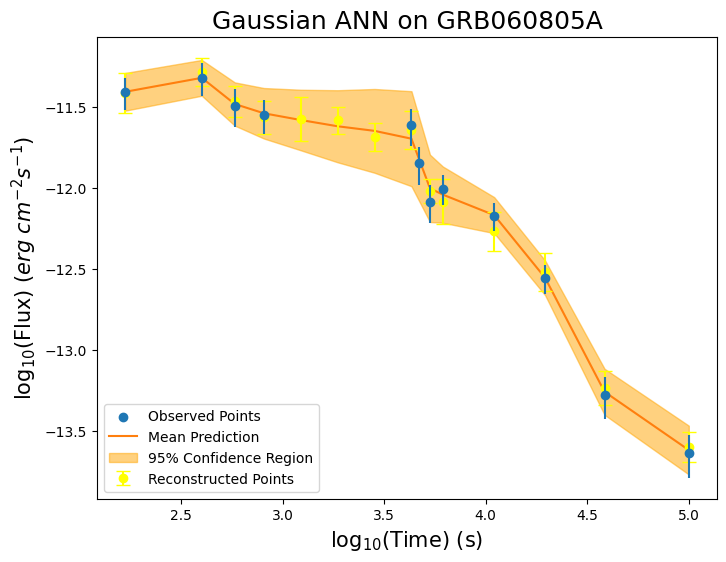


-----TRAINING FOR GRB060807-----


-----ORIGINAL GRB-----



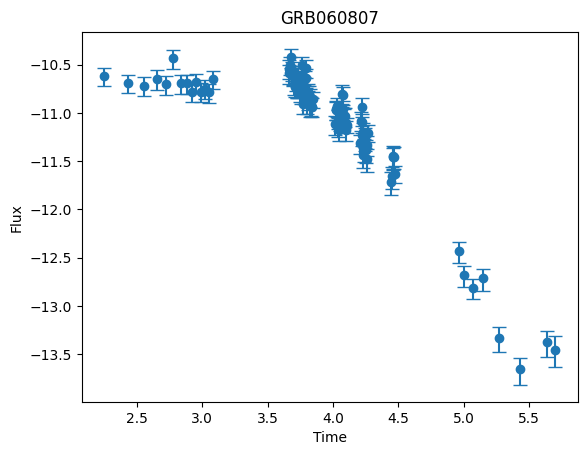


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: -0.0185
Epoch 50, Loss: -0.6532
Epoch 100, Loss: -1.0325
Epoch 150, Loss: -0.8196
Epoch 200, Loss: -0.6944
Epoch 250, Loss: 0.0920
Epoch 300, Loss: -0.0346
Epoch 350, Loss: -0.9739
Epoch 400, Loss: -0.7303
Epoch 450, Loss: -1.0365

-----RECONSTRUCTED GRB-----



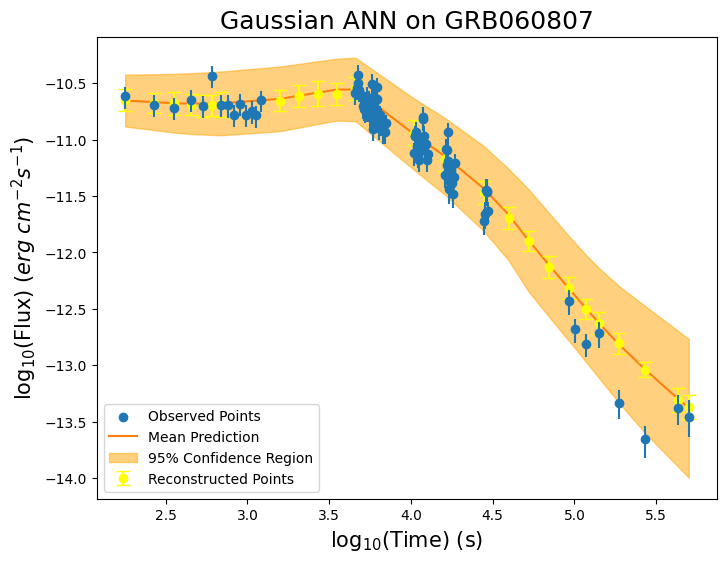


-----TRAINING FOR GRB060813-----


-----ORIGINAL GRB-----



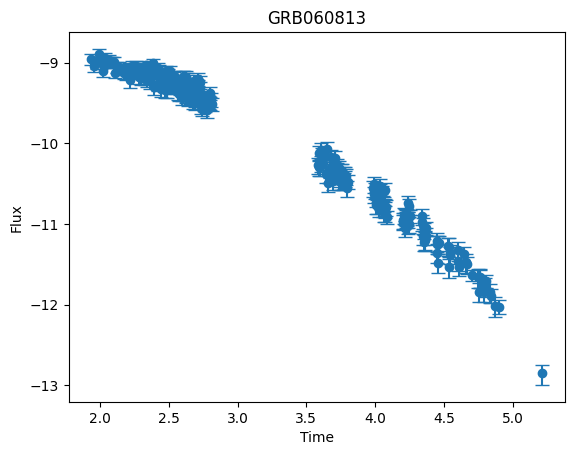


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: -0.2948
Epoch 50, Loss: -1.0287
Epoch 100, Loss: -0.9197
Epoch 150, Loss: -0.9560
Epoch 200, Loss: -1.0181
Epoch 250, Loss: -1.0494
Epoch 300, Loss: -1.0368
Epoch 350, Loss: -0.9957
Epoch 400, Loss: -0.9900
Epoch 450, Loss: -1.0181

-----RECONSTRUCTED GRB-----



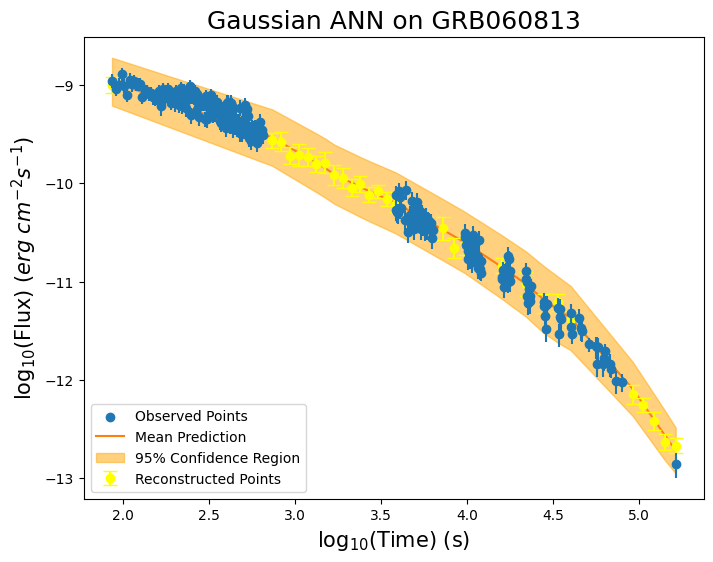


-----TRAINING FOR GRB060923A-----


-----ORIGINAL GRB-----



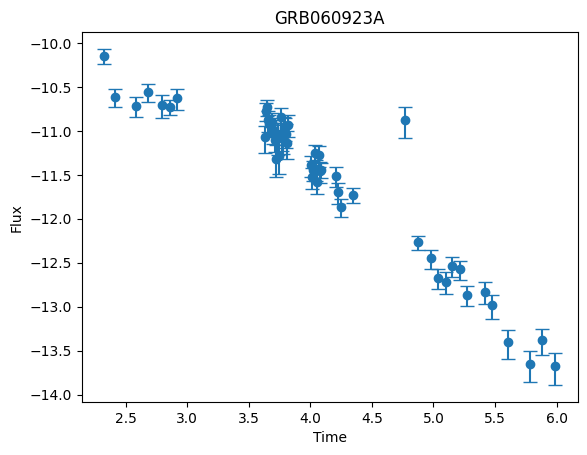


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.2854
Epoch 50, Loss: -0.7392
Epoch 100, Loss: -0.7667
Epoch 150, Loss: -0.5662
Epoch 200, Loss: -0.6306
Epoch 250, Loss: -0.7330
Epoch 300, Loss: -0.8747
Epoch 350, Loss: -0.7950
Epoch 400, Loss: -0.7758
Epoch 450, Loss: -0.7195

-----RECONSTRUCTED GRB-----



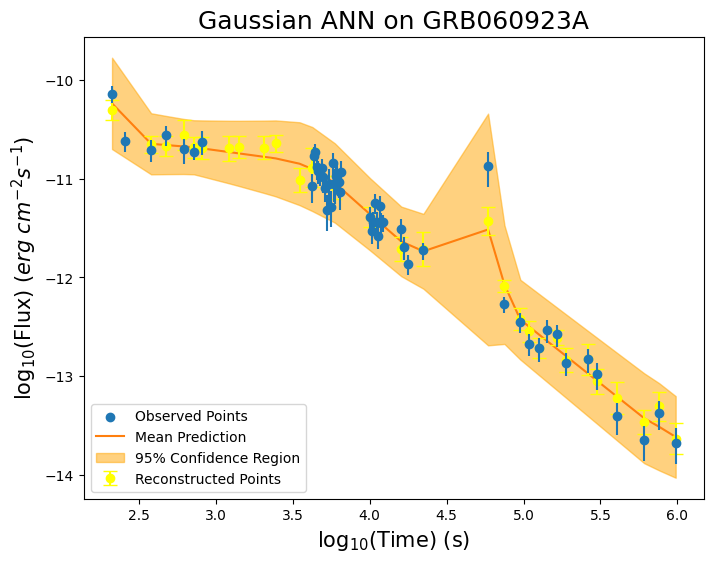


-----TRAINING FOR GRB060923C-----


-----ORIGINAL GRB-----



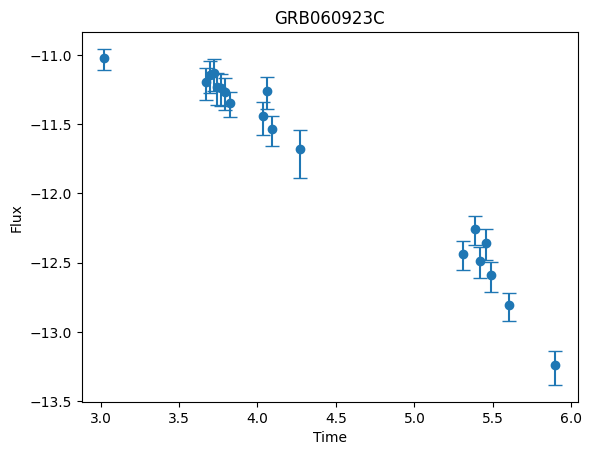


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.5222
Epoch 50, Loss: -0.9399
Epoch 100, Loss: -0.9652
Epoch 150, Loss: -0.9734
Epoch 200, Loss: -0.9533
Epoch 250, Loss: -0.9928
Epoch 300, Loss: -0.9905
Epoch 350, Loss: -0.9999
Epoch 400, Loss: -1.0018
Epoch 450, Loss: -1.0095

-----RECONSTRUCTED GRB-----



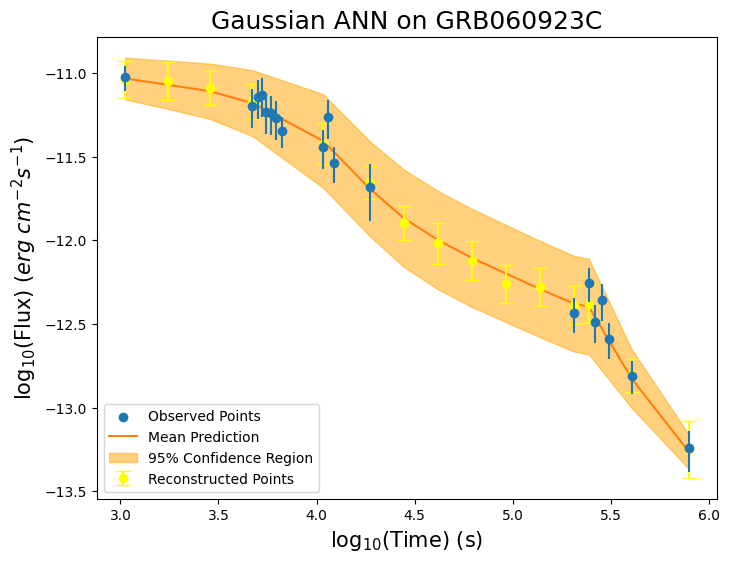


-----TRAINING FOR GRB061019-----


-----ORIGINAL GRB-----



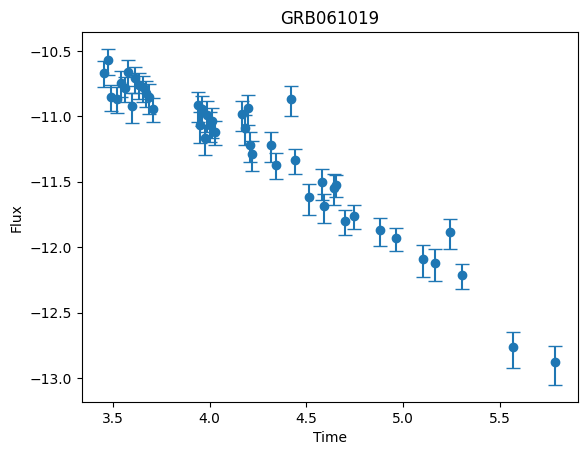


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.3128
Epoch 50, Loss: -0.6265
Epoch 100, Loss: -0.6098
Epoch 150, Loss: -0.6498
Epoch 200, Loss: -0.6850
Epoch 250, Loss: -0.7519
Epoch 300, Loss: -0.6292
Epoch 350, Loss: -0.7440
Epoch 400, Loss: -0.5955
Epoch 450, Loss: -0.8107

-----RECONSTRUCTED GRB-----



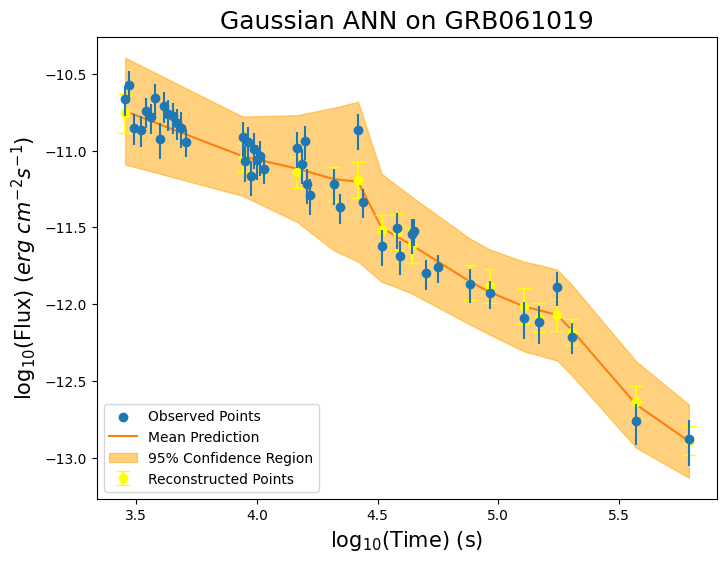


-----TRAINING FOR GRB061202-----


-----ORIGINAL GRB-----



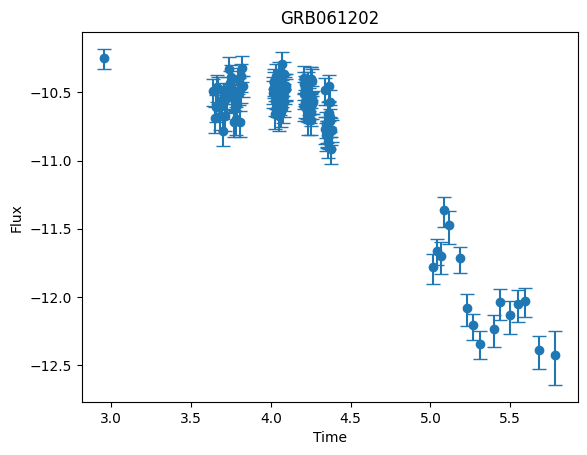


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.0601
Epoch 50, Loss: -0.6295
Epoch 100, Loss: -0.6011
Epoch 150, Loss: -0.6395
Epoch 200, Loss: -0.7276
Epoch 250, Loss: -0.6527
Epoch 300, Loss: -0.7024
Epoch 350, Loss: -0.6866
Epoch 400, Loss: -0.5815
Epoch 450, Loss: -0.6810

-----RECONSTRUCTED GRB-----



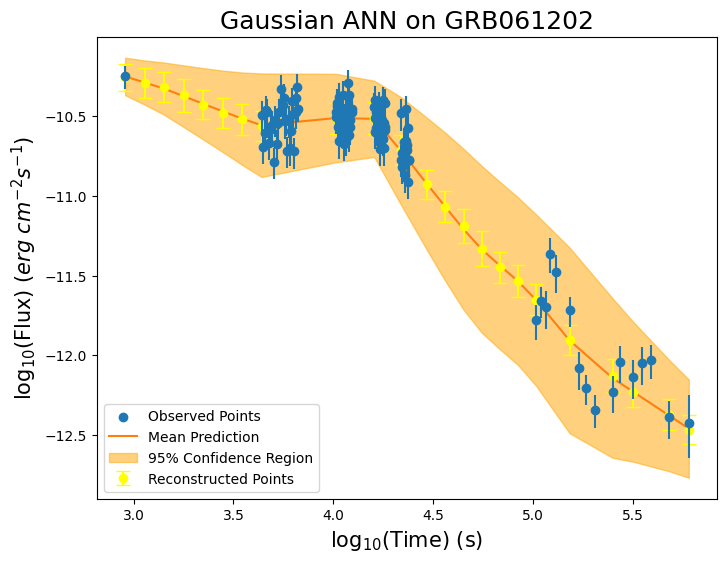


-----TRAINING FOR GRB070103-----


-----ORIGINAL GRB-----



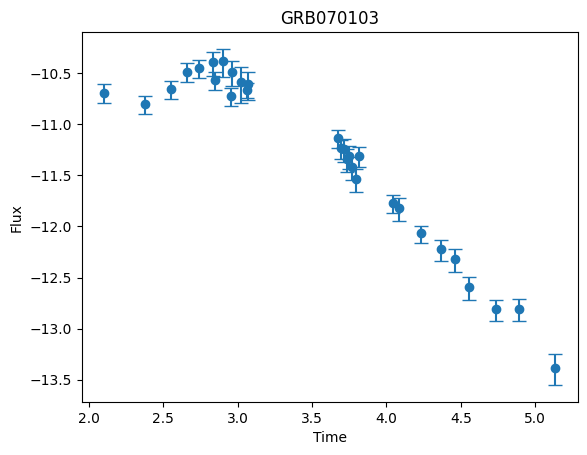


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.5298
Epoch 50, Loss: -0.9660
Epoch 100, Loss: -0.9849
Epoch 150, Loss: -0.9917
Epoch 200, Loss: -0.9956
Epoch 250, Loss: -1.0156
Epoch 300, Loss: -1.0321
Epoch 350, Loss: -1.0426
Epoch 400, Loss: -1.0511
Epoch 450, Loss: -1.0565

-----RECONSTRUCTED GRB-----



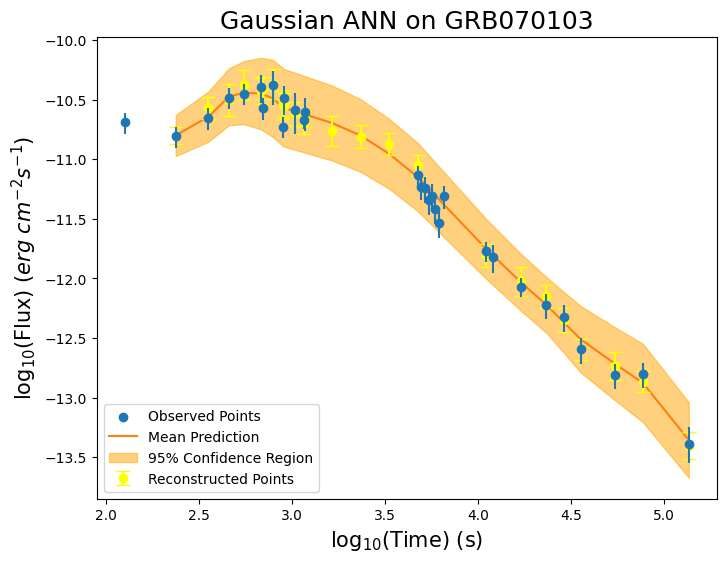


-----TRAINING FOR GRB070107-----


-----ORIGINAL GRB-----



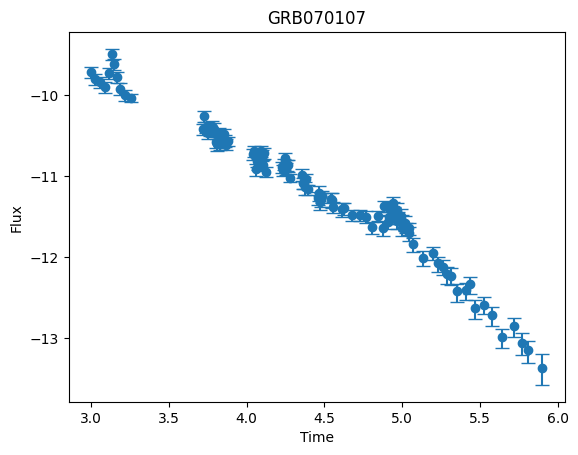


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.1924
Epoch 50, Loss: -1.0246
Epoch 100, Loss: -1.0338
Epoch 150, Loss: -0.8457
Epoch 200, Loss: -1.0579
Epoch 250, Loss: -0.9494
Epoch 300, Loss: -0.9973
Epoch 350, Loss: -0.9611
Epoch 400, Loss: -0.8680
Epoch 450, Loss: -0.8574

-----RECONSTRUCTED GRB-----



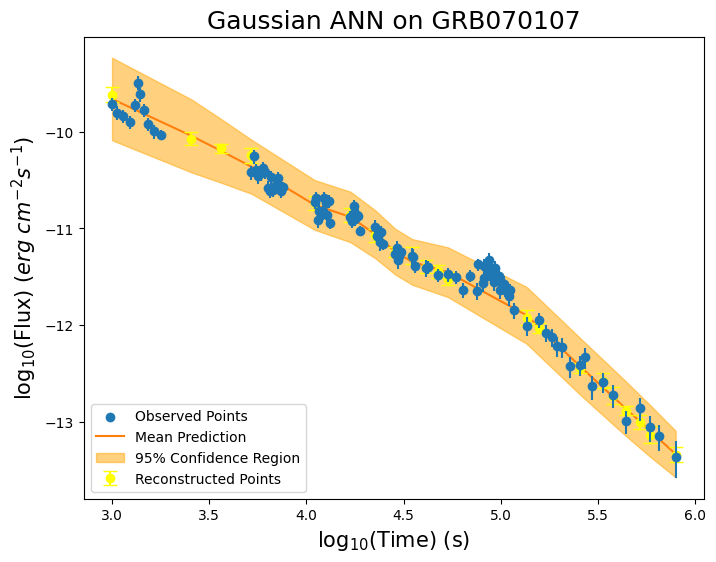


-----TRAINING FOR GRB070129-----


-----ORIGINAL GRB-----



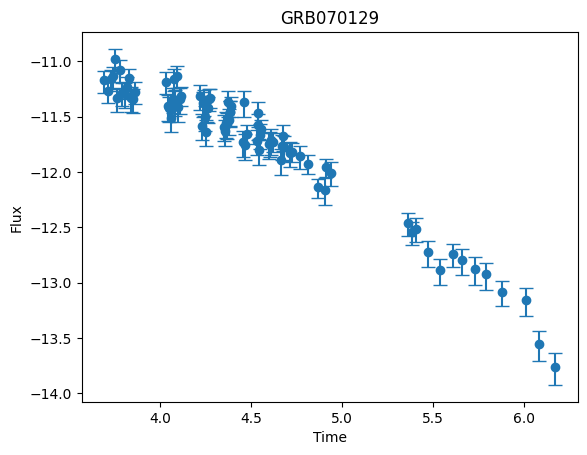


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.2556
Epoch 50, Loss: -0.7718
Epoch 100, Loss: -0.5834
Epoch 150, Loss: -0.6646
Epoch 200, Loss: -0.8272
Epoch 250, Loss: -0.8037
Epoch 300, Loss: -0.7140
Epoch 350, Loss: -0.7206
Epoch 400, Loss: -0.8373
Epoch 450, Loss: -0.7556

-----RECONSTRUCTED GRB-----



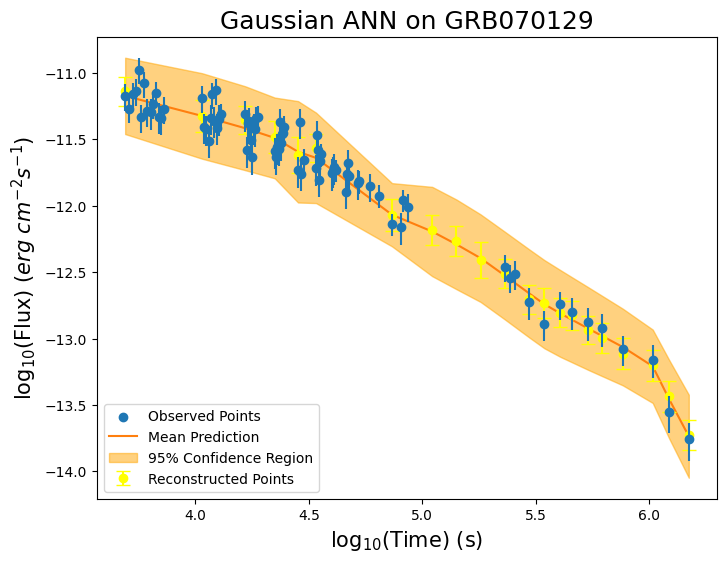


-----TRAINING FOR GRB070224-----


-----ORIGINAL GRB-----



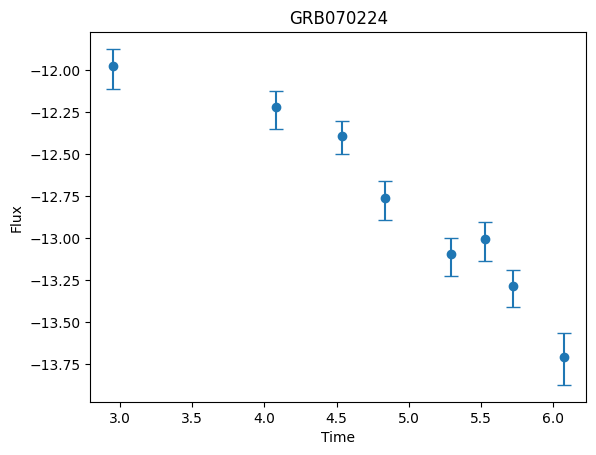


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.5399
Epoch 50, Loss: -0.9331
Epoch 100, Loss: -0.9824
Epoch 150, Loss: -1.1930
Epoch 200, Loss: -1.2286
Epoch 250, Loss: -1.2286
Epoch 300, Loss: -1.1993
Epoch 350, Loss: -1.2204
Epoch 400, Loss: -1.2314
Epoch 450, Loss: -1.2188

-----RECONSTRUCTED GRB-----



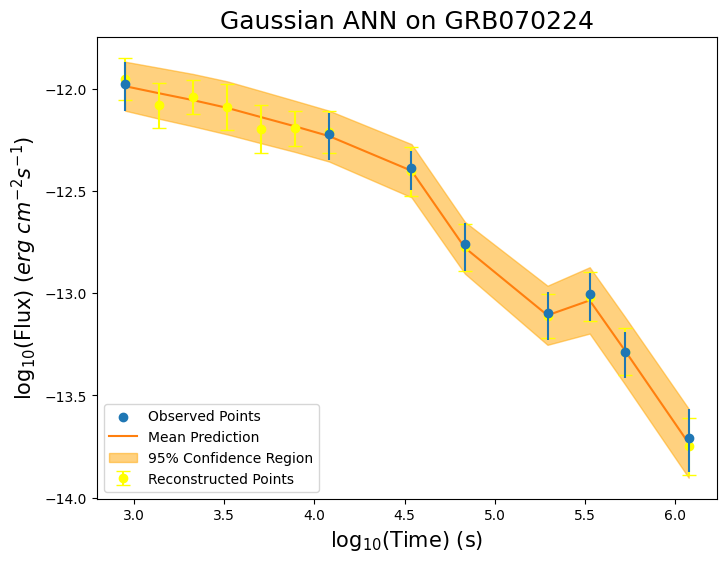


-----TRAINING FOR GRB070328-----


-----ORIGINAL GRB-----



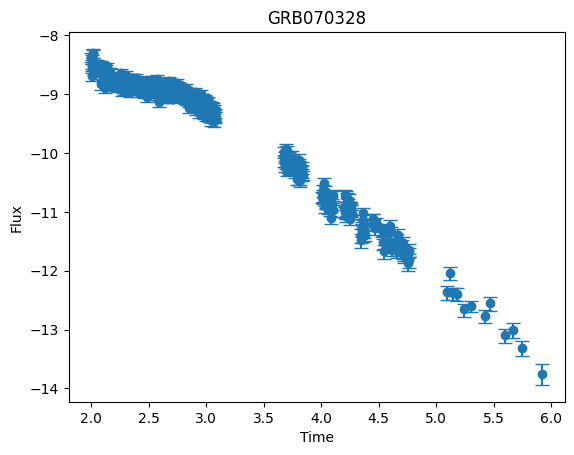


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: -0.9194
Epoch 50, Loss: -0.9465
Epoch 100, Loss: -0.9870
Epoch 150, Loss: -1.0494
Epoch 200, Loss: -1.0714
Epoch 250, Loss: -0.9614
Epoch 300, Loss: -0.9638
Epoch 350, Loss: -0.9727
Epoch 400, Loss: -1.0771
Epoch 450, Loss: -0.9233

-----RECONSTRUCTED GRB-----



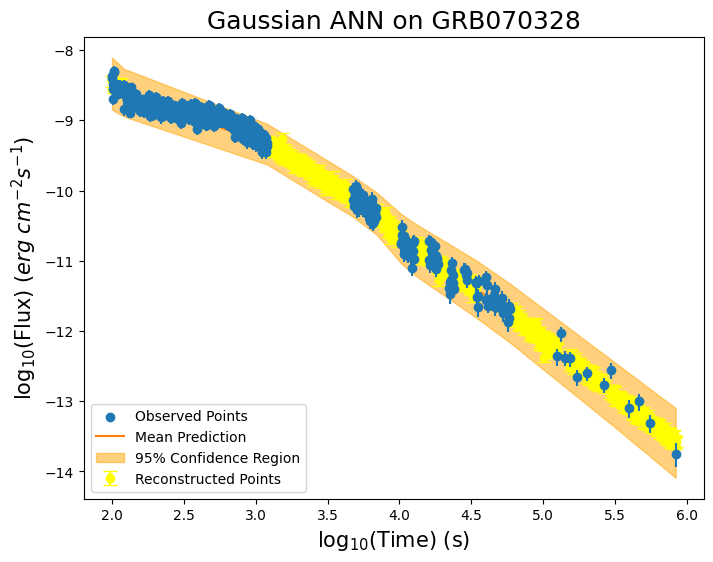


-----TRAINING FOR GRB070420-----


-----ORIGINAL GRB-----



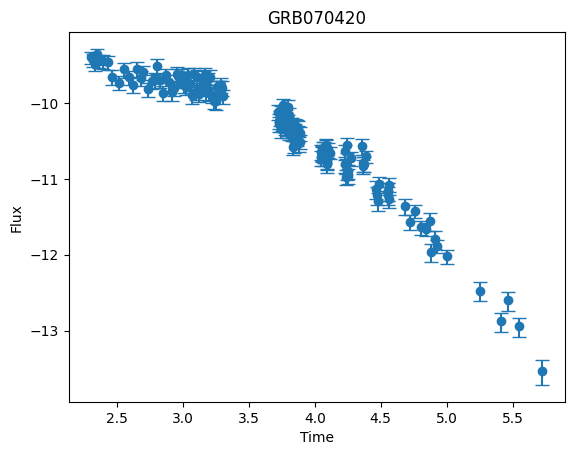


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.2989
Epoch 50, Loss: -0.8939
Epoch 100, Loss: -0.8424
Epoch 150, Loss: -0.9333
Epoch 200, Loss: -0.9322
Epoch 250, Loss: -0.7824
Epoch 300, Loss: -0.8785
Epoch 350, Loss: -0.8641
Epoch 400, Loss: -0.8026
Epoch 450, Loss: -0.9069

-----RECONSTRUCTED GRB-----



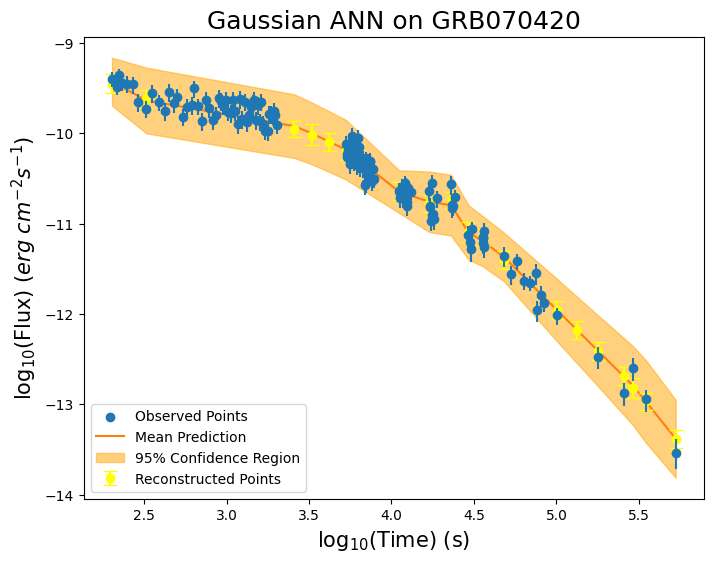


-----TRAINING FOR GRB070517-----


-----ORIGINAL GRB-----



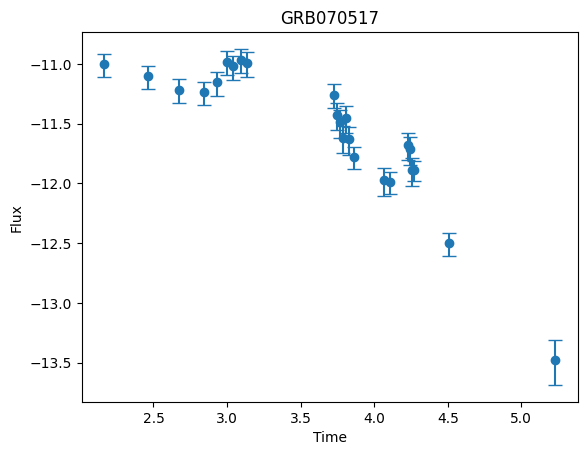


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.6480
Epoch 50, Loss: -0.6417
Epoch 100, Loss: -0.7595
Epoch 150, Loss: -0.8790
Epoch 200, Loss: -0.9567
Epoch 250, Loss: -0.9996
Epoch 300, Loss: -1.0101
Epoch 350, Loss: -1.0080
Epoch 400, Loss: -0.9445
Epoch 450, Loss: -1.0221

-----RECONSTRUCTED GRB-----



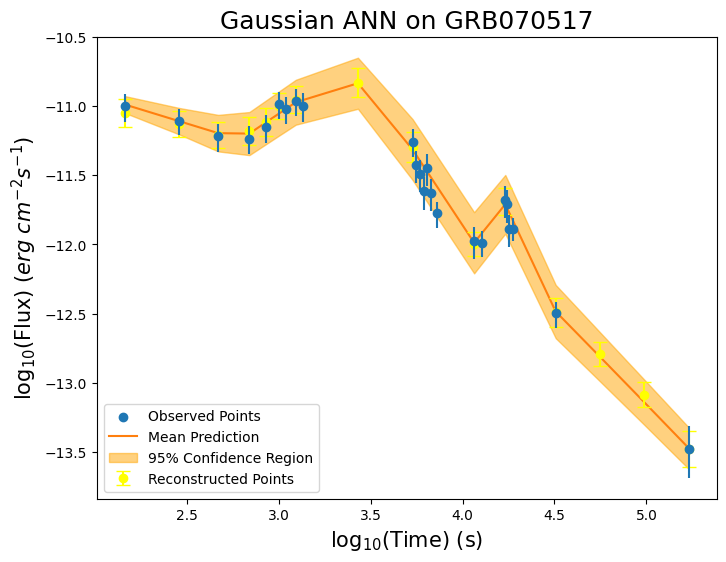


-----TRAINING FOR GRB070621-----


-----ORIGINAL GRB-----



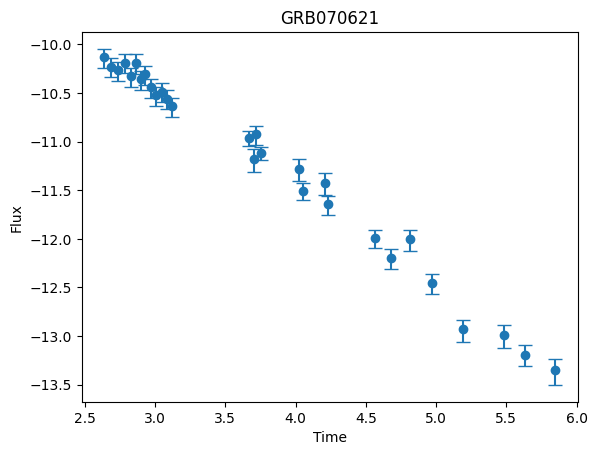


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.5603
Epoch 50, Loss: -1.0254
Epoch 100, Loss: -1.0465
Epoch 150, Loss: -1.0590
Epoch 200, Loss: -1.0726
Epoch 250, Loss: -1.0730
Epoch 300, Loss: -1.0941
Epoch 350, Loss: -1.0716
Epoch 400, Loss: -1.1160
Epoch 450, Loss: -1.1188

-----RECONSTRUCTED GRB-----



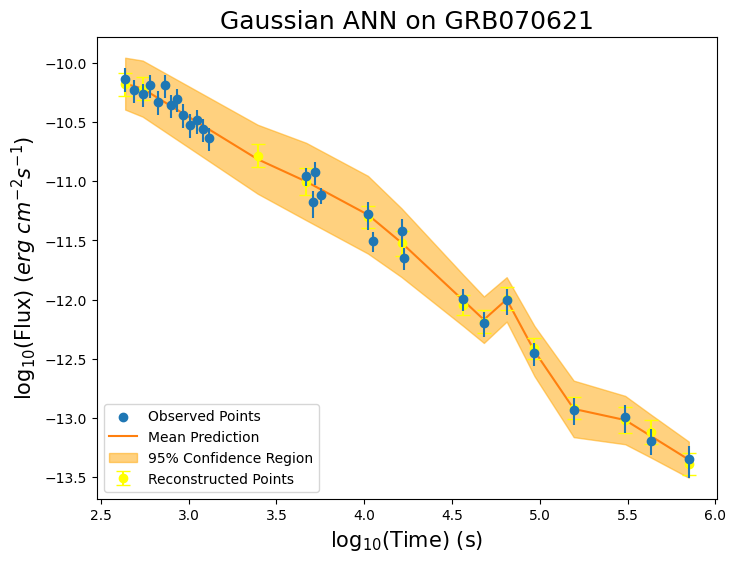


-----TRAINING FOR GRB070628-----


-----ORIGINAL GRB-----



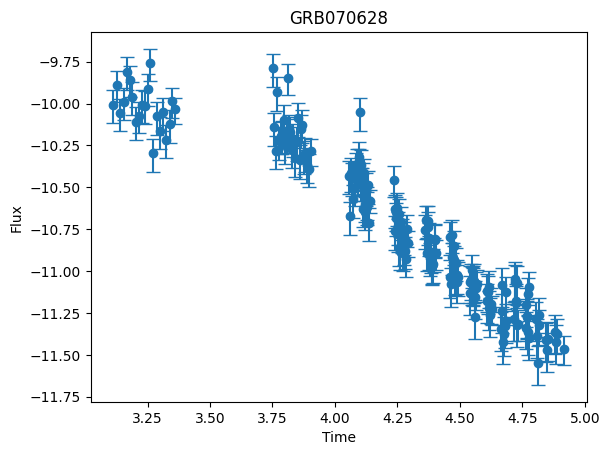


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: -0.0418
Epoch 50, Loss: -0.7410
Epoch 100, Loss: -0.6569
Epoch 150, Loss: -0.6741
Epoch 200, Loss: -0.6398
Epoch 250, Loss: -0.6123
Epoch 300, Loss: -0.6202
Epoch 350, Loss: -0.6673
Epoch 400, Loss: -0.4809
Epoch 450, Loss: -0.8258

-----RECONSTRUCTED GRB-----



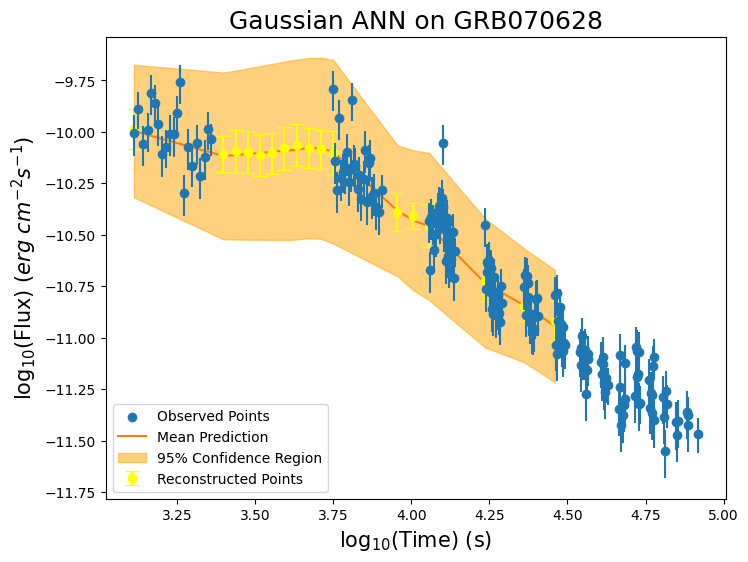


-----TRAINING FOR GRB070714A-----


-----ORIGINAL GRB-----



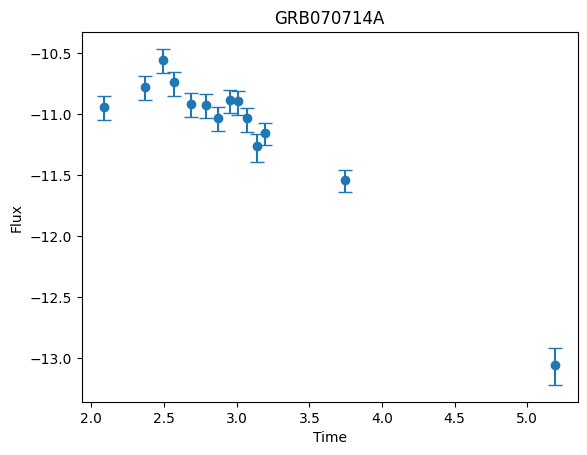


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.5196
Epoch 50, Loss: -0.8359
Epoch 100, Loss: -0.9260
Epoch 150, Loss: -0.9551
Epoch 200, Loss: -0.9774
Epoch 250, Loss: -0.9810
Epoch 300, Loss: -1.0176
Epoch 350, Loss: -1.0073
Epoch 400, Loss: -1.0319
Epoch 450, Loss: -1.0556

-----RECONSTRUCTED GRB-----



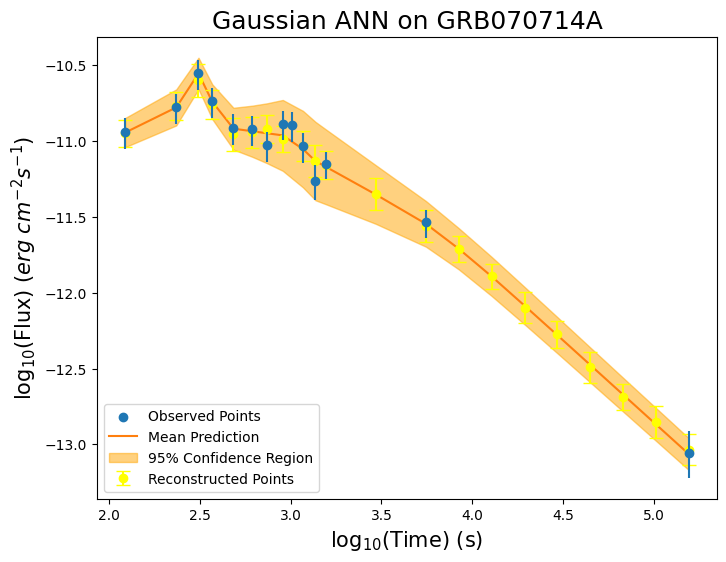


-----TRAINING FOR GRB080129-----


-----ORIGINAL GRB-----



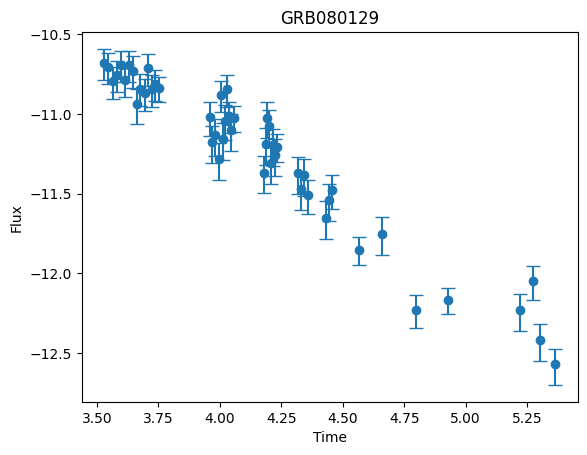


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.2783
Epoch 50, Loss: -0.6276
Epoch 100, Loss: -0.5795
Epoch 150, Loss: -0.5944
Epoch 200, Loss: -0.7947
Epoch 250, Loss: -0.7254
Epoch 300, Loss: -0.6376
Epoch 350, Loss: -0.6563
Epoch 400, Loss: -0.6824
Epoch 450, Loss: -0.7897

-----RECONSTRUCTED GRB-----



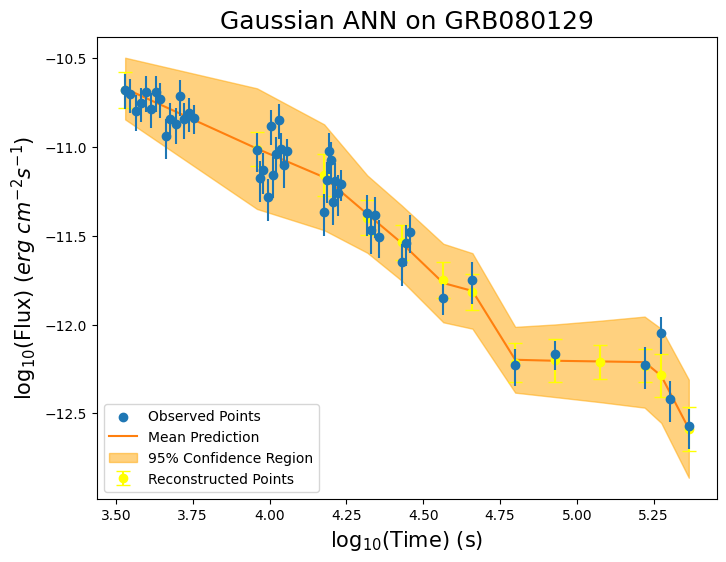


-----TRAINING FOR GRB080205-----


-----ORIGINAL GRB-----



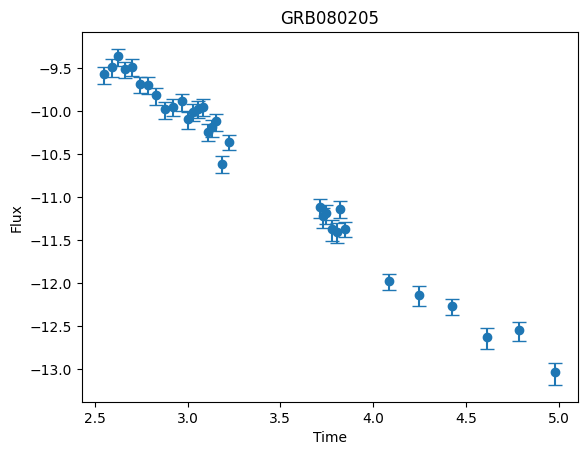


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.5561
Epoch 50, Loss: -1.0040
Epoch 100, Loss: -0.7978
Epoch 150, Loss: -0.8185
Epoch 200, Loss: -0.9921
Epoch 250, Loss: -1.0684
Epoch 300, Loss: -0.2833
Epoch 350, Loss: -1.1019
Epoch 400, Loss: -0.9069
Epoch 450, Loss: -1.1355

-----RECONSTRUCTED GRB-----



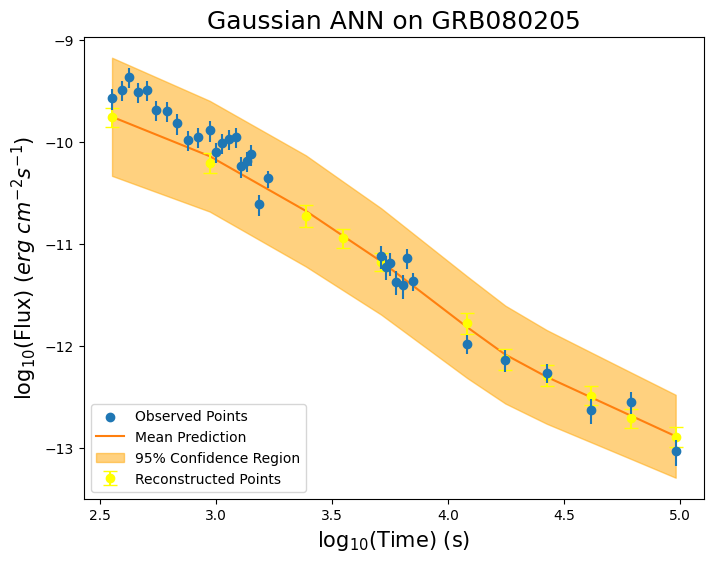


-----TRAINING FOR GRB080212-----


-----ORIGINAL GRB-----



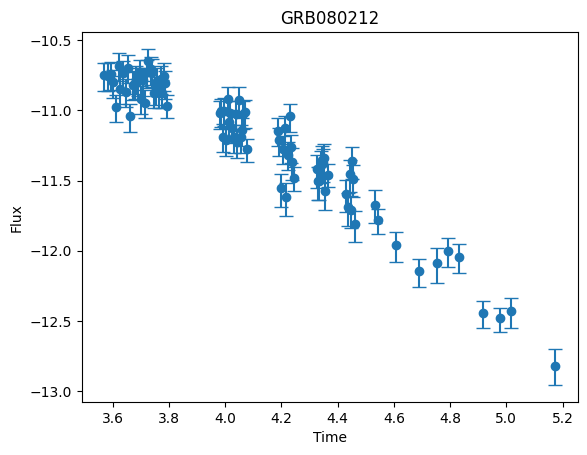


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.1870
Epoch 50, Loss: -0.5280
Epoch 100, Loss: -0.4517
Epoch 150, Loss: -0.6372
Epoch 200, Loss: -0.5892
Epoch 250, Loss: -0.3757
Epoch 300, Loss: -0.6463
Epoch 350, Loss: -0.5778
Epoch 400, Loss: -0.7195
Epoch 450, Loss: -0.7119

-----RECONSTRUCTED GRB-----



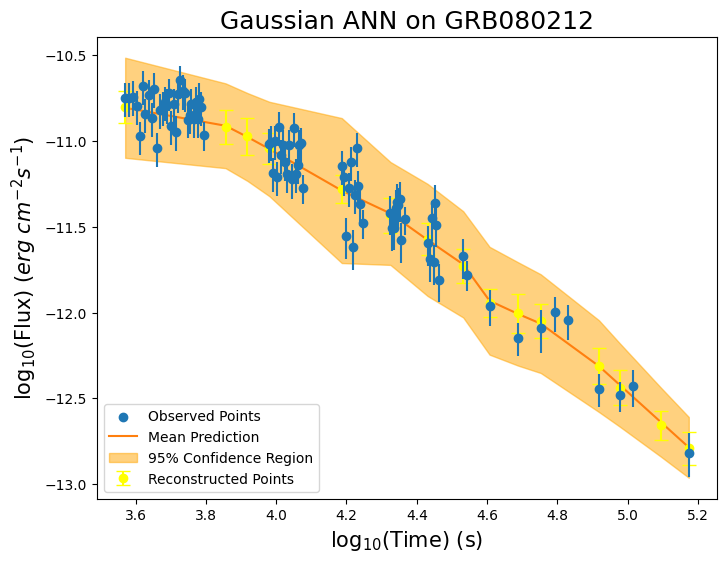


-----TRAINING FOR GRB080218B-----


-----ORIGINAL GRB-----



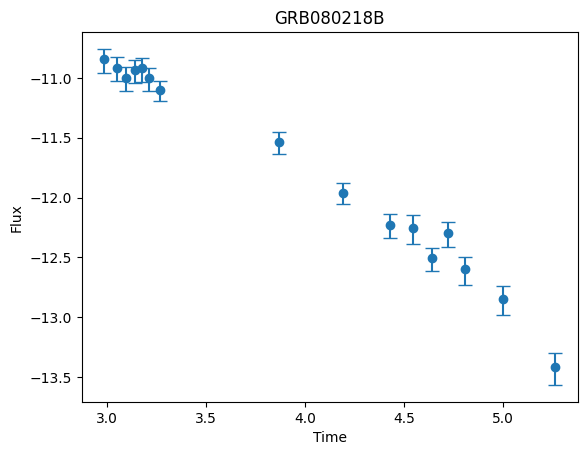


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.5370
Epoch 50, Loss: -1.0347
Epoch 100, Loss: -1.0844
Epoch 150, Loss: -1.0982
Epoch 200, Loss: -1.1128
Epoch 250, Loss: -1.1056
Epoch 300, Loss: -1.1170
Epoch 350, Loss: -1.1175
Epoch 400, Loss: -1.1489
Epoch 450, Loss: -1.1519

-----RECONSTRUCTED GRB-----



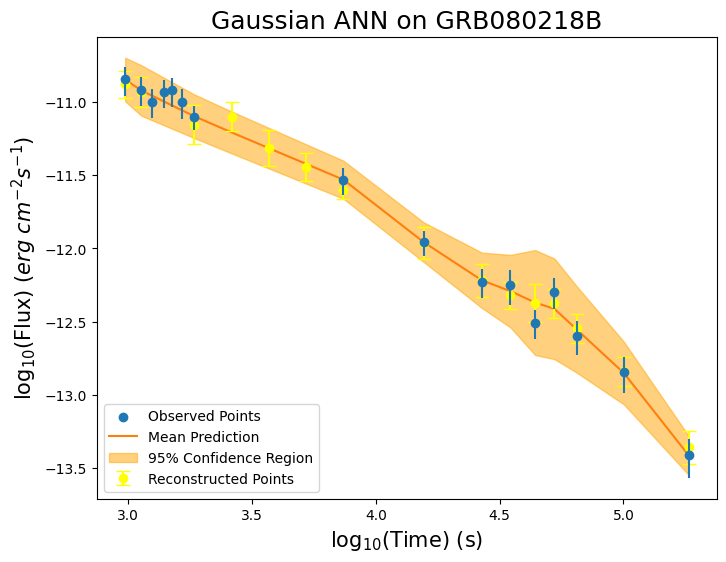


-----TRAINING FOR GRB080229A-----


-----ORIGINAL GRB-----



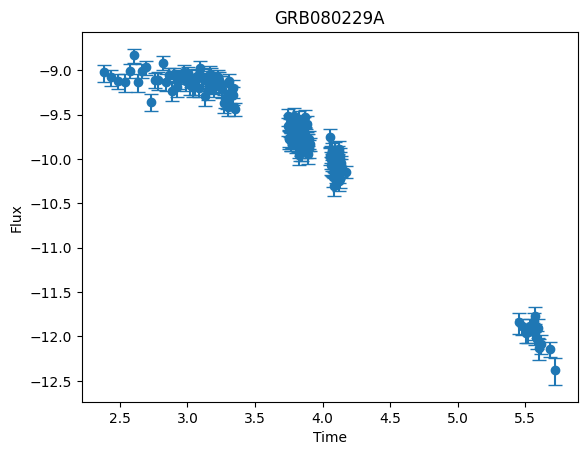


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.2302
Epoch 50, Loss: -0.8536
Epoch 100, Loss: -0.8852
Epoch 150, Loss: -0.7640
Epoch 200, Loss: -0.8214
Epoch 250, Loss: -0.8793
Epoch 300, Loss: -0.8311
Epoch 350, Loss: -0.8975
Epoch 400, Loss: -0.9494
Epoch 450, Loss: -0.9448

-----RECONSTRUCTED GRB-----



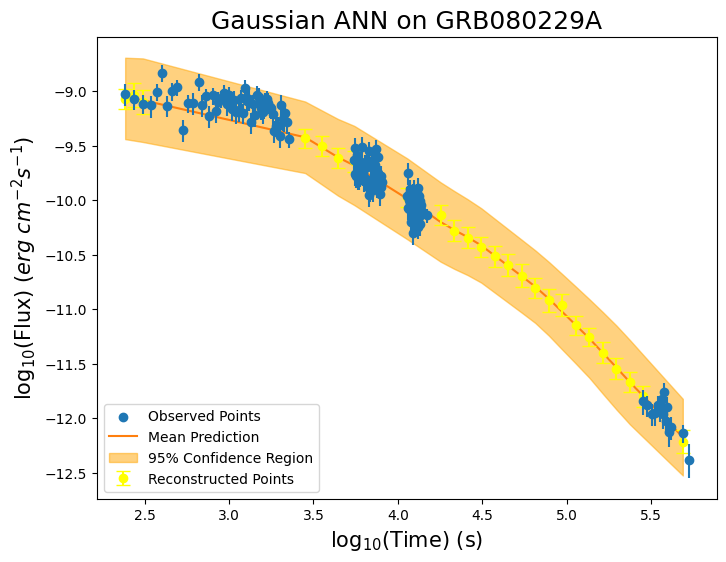


-----TRAINING FOR GRB080328-----


-----ORIGINAL GRB-----



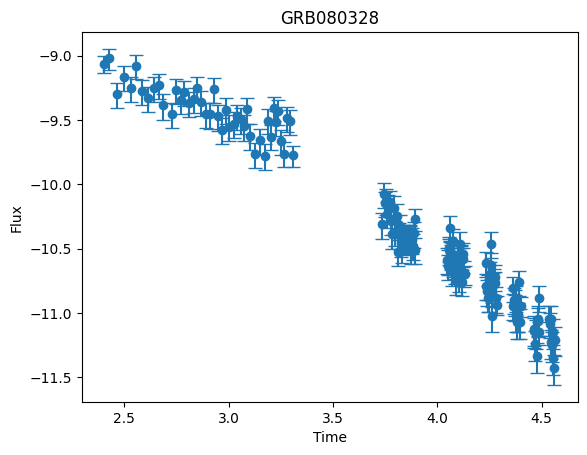


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.2333
Epoch 50, Loss: -0.7870
Epoch 100, Loss: -0.6353
Epoch 150, Loss: -0.8650
Epoch 200, Loss: -0.8152
Epoch 250, Loss: -0.7689
Epoch 300, Loss: -0.8149
Epoch 350, Loss: -0.7950
Epoch 400, Loss: -0.7529
Epoch 450, Loss: -0.7864

-----RECONSTRUCTED GRB-----



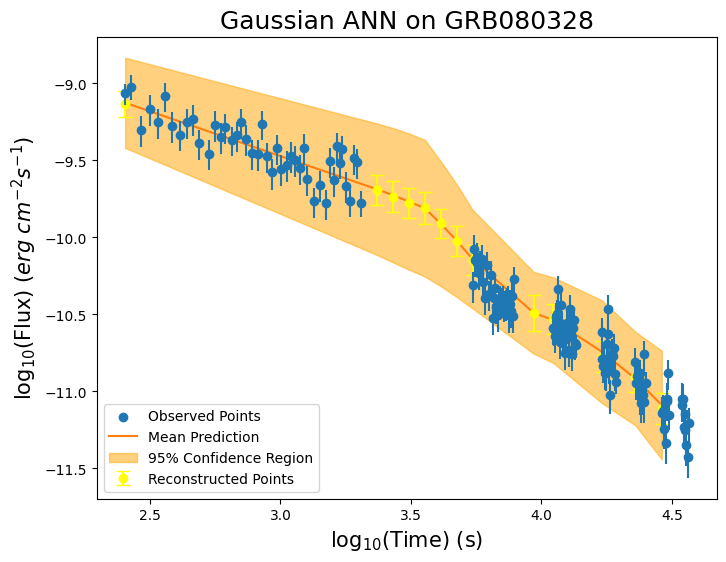


-----TRAINING FOR GRB080409-----


-----ORIGINAL GRB-----



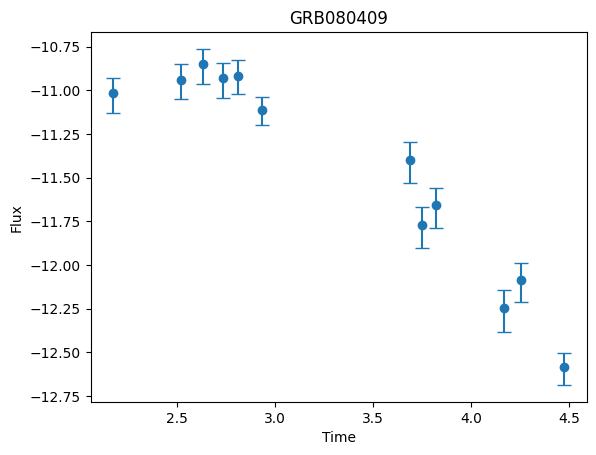


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.6726
Epoch 50, Loss: -0.8349
Epoch 100, Loss: -0.9104
Epoch 150, Loss: -0.9279
Epoch 200, Loss: -0.9487
Epoch 250, Loss: -0.9758
Epoch 300, Loss: -1.0080
Epoch 350, Loss: -1.0174
Epoch 400, Loss: -1.0355
Epoch 450, Loss: -1.0553

-----RECONSTRUCTED GRB-----



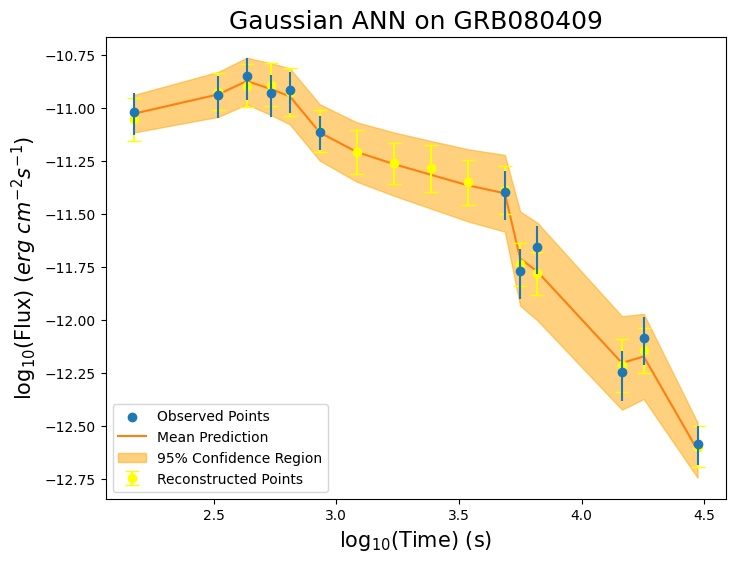


-----TRAINING FOR GRB080426-----


-----ORIGINAL GRB-----



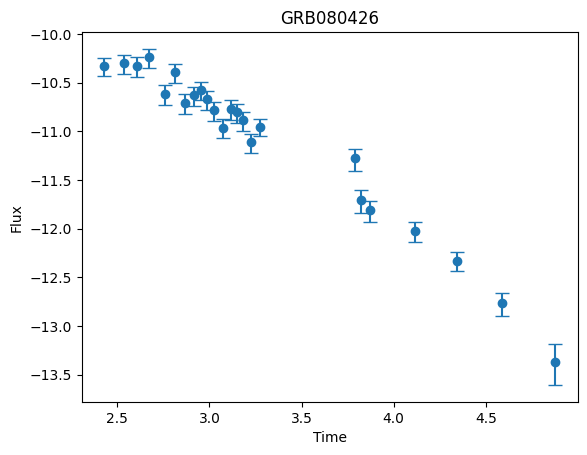


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.4621
Epoch 50, Loss: -0.9143
Epoch 100, Loss: -0.9572
Epoch 150, Loss: -0.9655
Epoch 200, Loss: -0.9951
Epoch 250, Loss: -0.9979
Epoch 300, Loss: -1.0080
Epoch 350, Loss: -1.0361
Epoch 400, Loss: -1.0352
Epoch 450, Loss: -1.0304

-----RECONSTRUCTED GRB-----



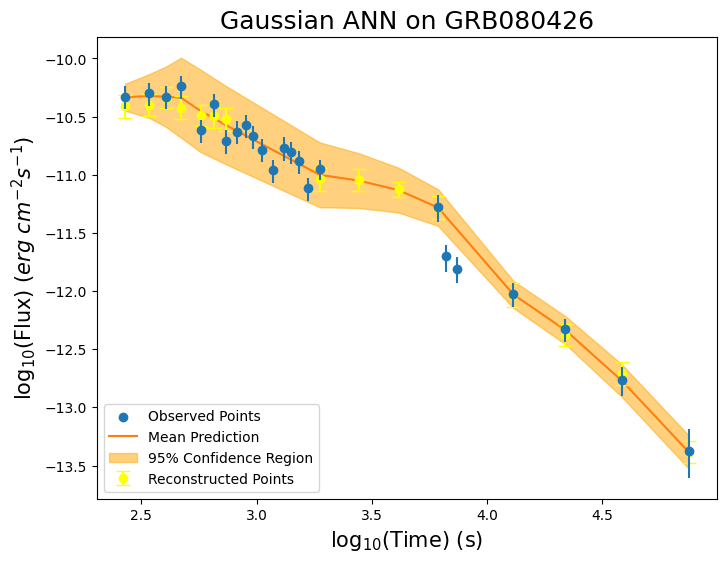


-----TRAINING FOR GRB080605-----


-----ORIGINAL GRB-----



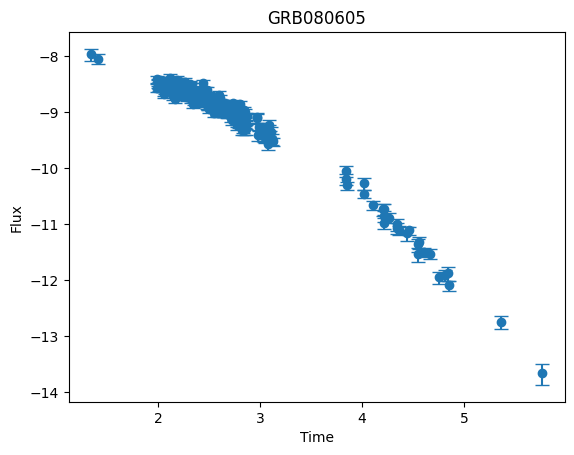


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: -0.4533
Epoch 50, Loss: -0.7990
Epoch 100, Loss: -0.9220
Epoch 150, Loss: -0.8868
Epoch 200, Loss: -0.9086
Epoch 250, Loss: -0.9220
Epoch 300, Loss: -0.9332
Epoch 350, Loss: -0.9160
Epoch 400, Loss: -0.8329
Epoch 450, Loss: -0.9157

-----RECONSTRUCTED GRB-----



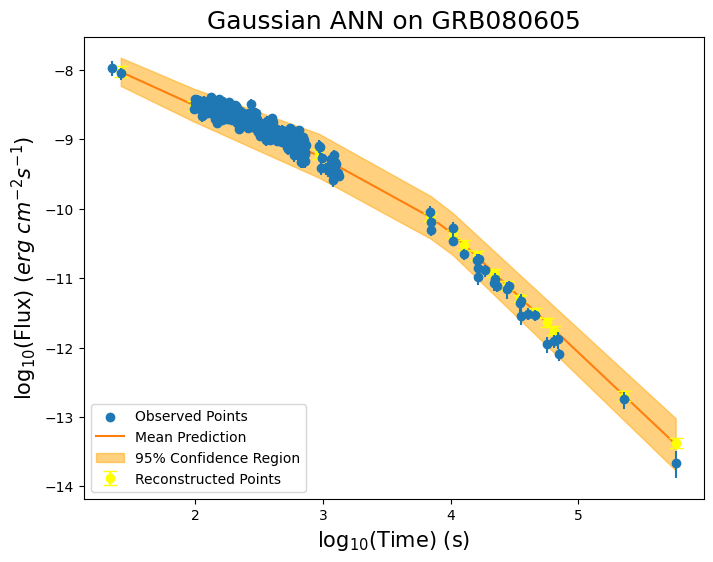


-----TRAINING FOR GRB080707-----


-----ORIGINAL GRB-----



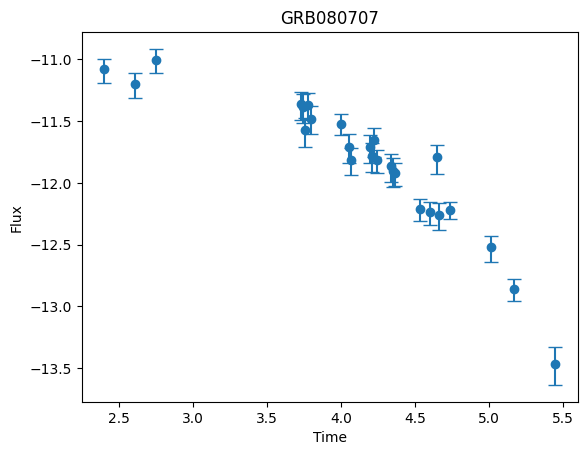


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.4950
Epoch 50, Loss: -0.7161
Epoch 100, Loss: -0.7341
Epoch 150, Loss: -0.7722
Epoch 200, Loss: -0.7969
Epoch 250, Loss: -0.7925
Epoch 300, Loss: -0.7977
Epoch 350, Loss: -0.7321
Epoch 400, Loss: -0.8243
Epoch 450, Loss: -0.8280

-----RECONSTRUCTED GRB-----



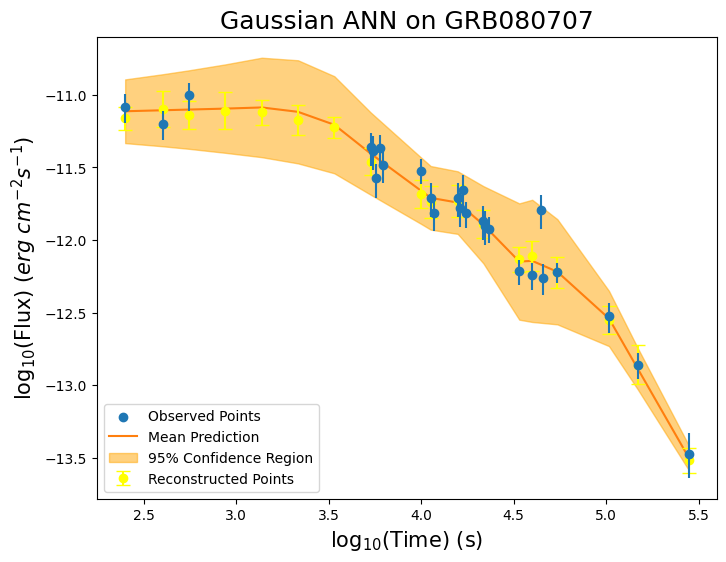


-----TRAINING FOR GRB081126-----


-----ORIGINAL GRB-----



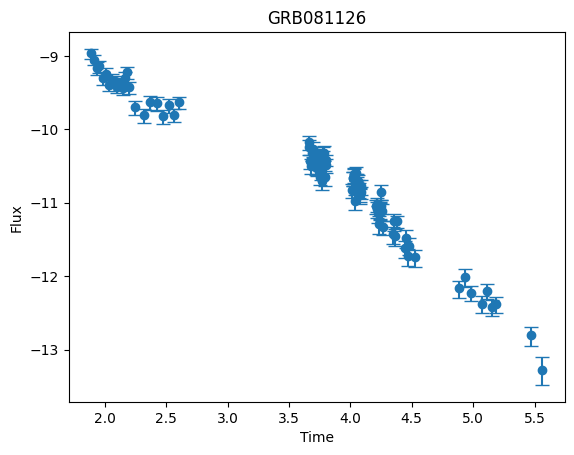


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.2880
Epoch 50, Loss: -0.8102
Epoch 100, Loss: -0.9431
Epoch 150, Loss: -0.8833
Epoch 200, Loss: -0.8473
Epoch 250, Loss: -0.9259
Epoch 300, Loss: -0.9006
Epoch 350, Loss: -0.9037
Epoch 400, Loss: -0.8522
Epoch 450, Loss: -0.9204

-----RECONSTRUCTED GRB-----



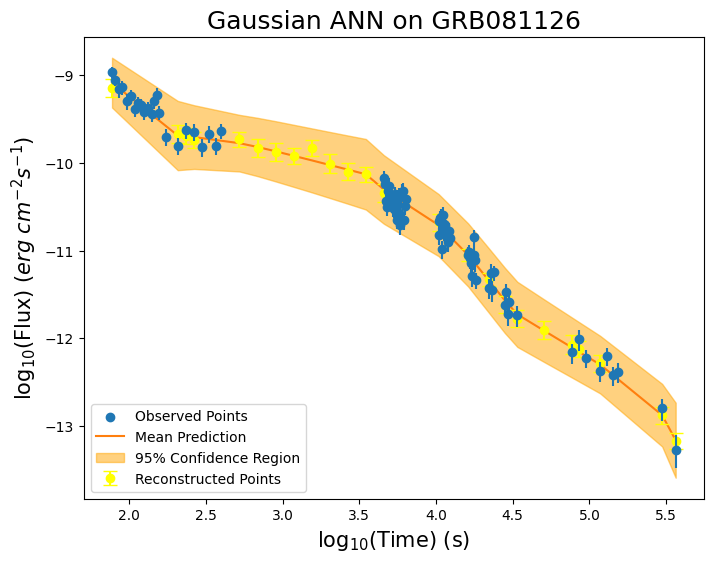


-----TRAINING FOR GRB081222-----


-----ORIGINAL GRB-----



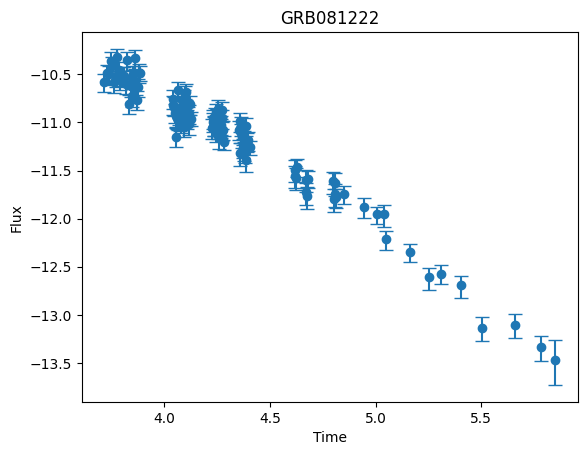


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.1241
Epoch 50, Loss: -0.7529
Epoch 100, Loss: -0.8498
Epoch 150, Loss: -0.8334
Epoch 200, Loss: -0.8230
Epoch 250, Loss: -0.6871
Epoch 300, Loss: -0.7642
Epoch 350, Loss: -0.7659
Epoch 400, Loss: -0.7626
Epoch 450, Loss: -0.7563

-----RECONSTRUCTED GRB-----



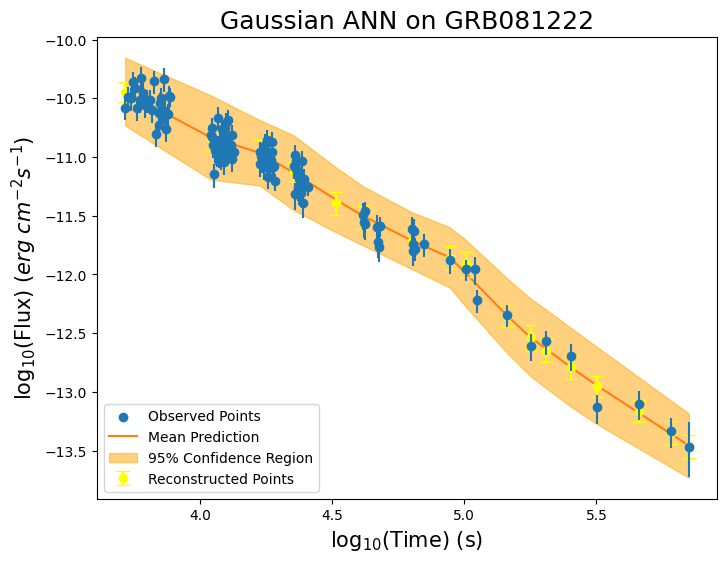


-----TRAINING FOR GRB090113-----


-----ORIGINAL GRB-----



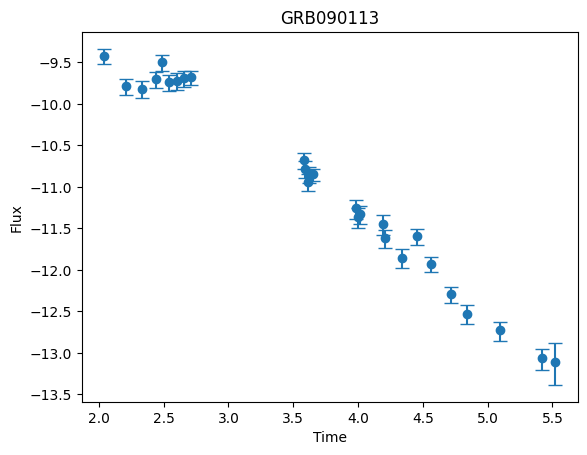


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.4740
Epoch 50, Loss: -1.0002
Epoch 100, Loss: -1.0438
Epoch 150, Loss: -1.0563
Epoch 200, Loss: -1.0699
Epoch 250, Loss: -1.0889
Epoch 300, Loss: -1.0868
Epoch 350, Loss: -1.1102
Epoch 400, Loss: -1.0987
Epoch 450, Loss: -1.1164

-----RECONSTRUCTED GRB-----



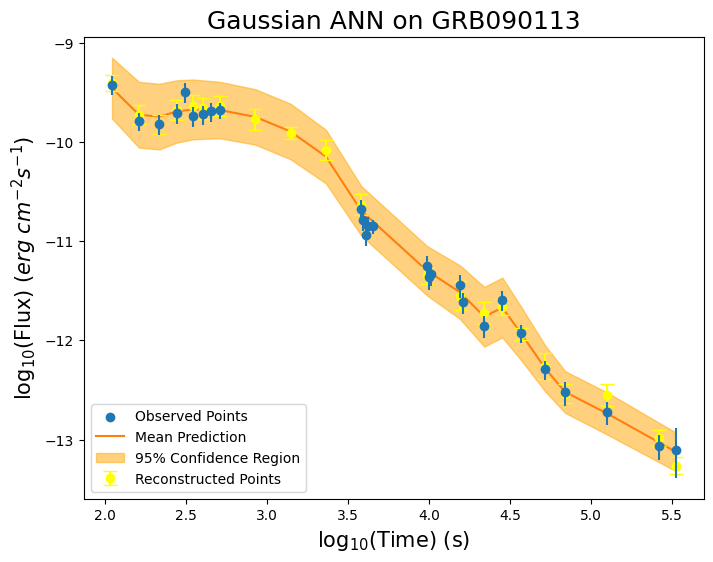


-----TRAINING FOR GRB090404-----


-----ORIGINAL GRB-----



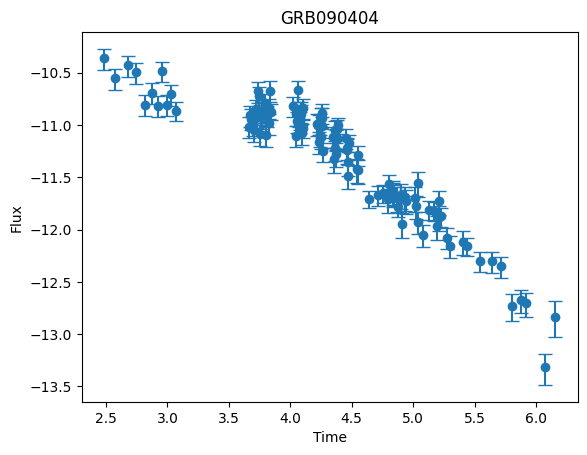


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.3547
Epoch 50, Loss: -0.6951
Epoch 100, Loss: -0.7420
Epoch 150, Loss: -0.6901
Epoch 200, Loss: -0.7310
Epoch 250, Loss: -0.7553
Epoch 300, Loss: -0.6858
Epoch 350, Loss: -0.7376
Epoch 400, Loss: -0.7302
Epoch 450, Loss: -0.6632

-----RECONSTRUCTED GRB-----



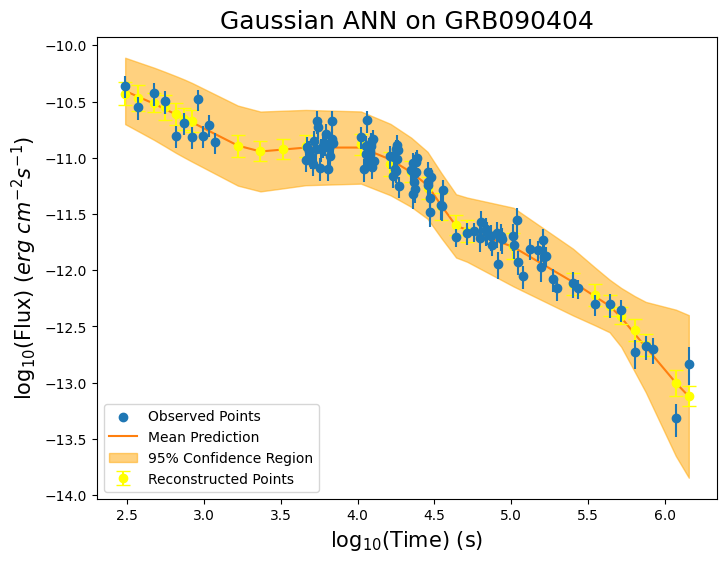


-----TRAINING FOR GRB090407-----


-----ORIGINAL GRB-----



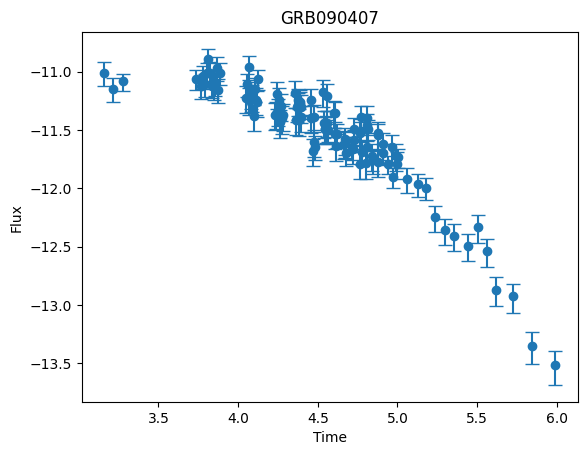


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.2307
Epoch 50, Loss: -0.7094
Epoch 100, Loss: -0.6151
Epoch 150, Loss: -0.6413
Epoch 200, Loss: -0.6551
Epoch 250, Loss: -0.6184
Epoch 300, Loss: -0.6061
Epoch 350, Loss: -0.6513
Epoch 400, Loss: -0.6467
Epoch 450, Loss: -0.7424

-----RECONSTRUCTED GRB-----



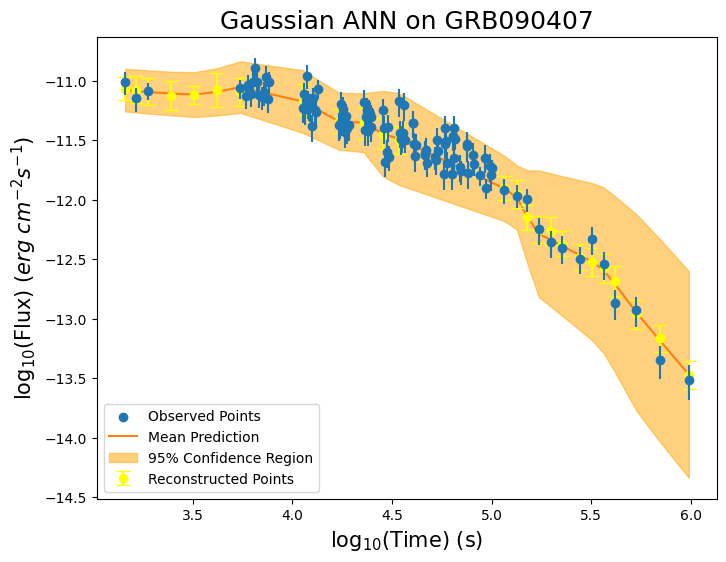


-----TRAINING FOR GRB090518-----


-----ORIGINAL GRB-----



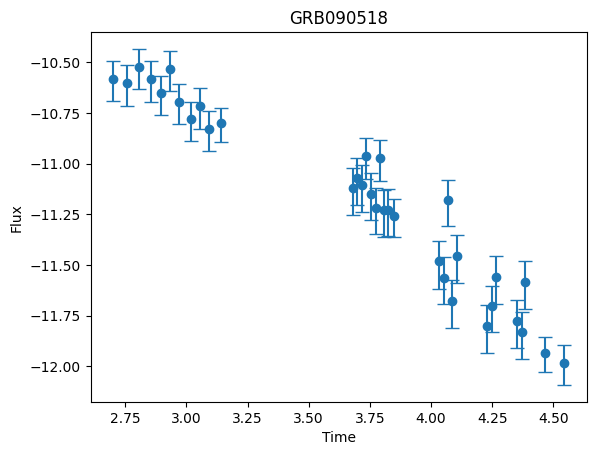


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.4735
Epoch 50, Loss: -0.6859
Epoch 100, Loss: -0.9494
Epoch 150, Loss: -0.3170
Epoch 200, Loss: -0.8455
Epoch 250, Loss: -0.7462
Epoch 300, Loss: -0.8957
Epoch 350, Loss: -0.8246
Epoch 400, Loss: -0.8105
Epoch 450, Loss: -0.4167

-----RECONSTRUCTED GRB-----



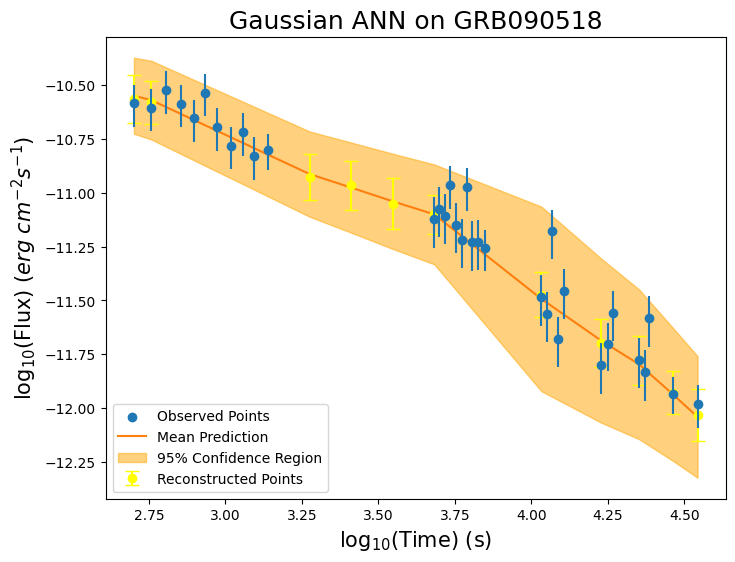


-----TRAINING FOR GRB090727-----


-----ORIGINAL GRB-----



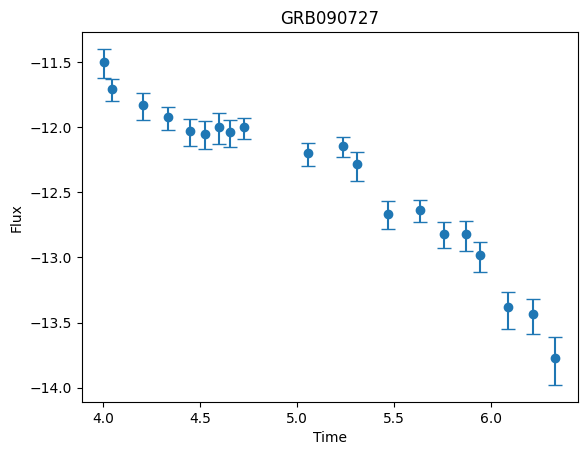


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.5735
Epoch 50, Loss: -0.9320
Epoch 100, Loss: -1.0217
Epoch 150, Loss: -1.0558
Epoch 200, Loss: -1.0808
Epoch 250, Loss: -1.0866
Epoch 300, Loss: -1.1064
Epoch 350, Loss: -1.1327
Epoch 400, Loss: -1.1372
Epoch 450, Loss: -1.1166

-----RECONSTRUCTED GRB-----



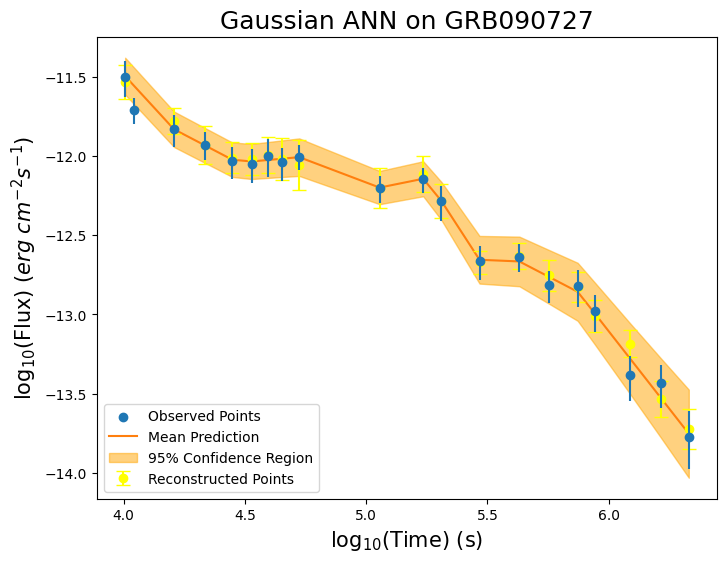


-----TRAINING FOR GRB090728-----


-----ORIGINAL GRB-----



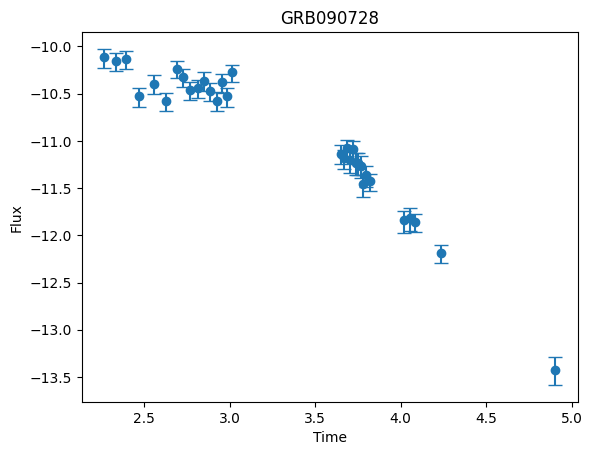


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.5634
Epoch 50, Loss: -0.9023
Epoch 100, Loss: -0.9400
Epoch 150, Loss: -0.9528
Epoch 200, Loss: -0.9566
Epoch 250, Loss: -0.9572
Epoch 300, Loss: -0.9511
Epoch 350, Loss: -0.9630
Epoch 400, Loss: -0.9600
Epoch 450, Loss: -0.9673

-----RECONSTRUCTED GRB-----



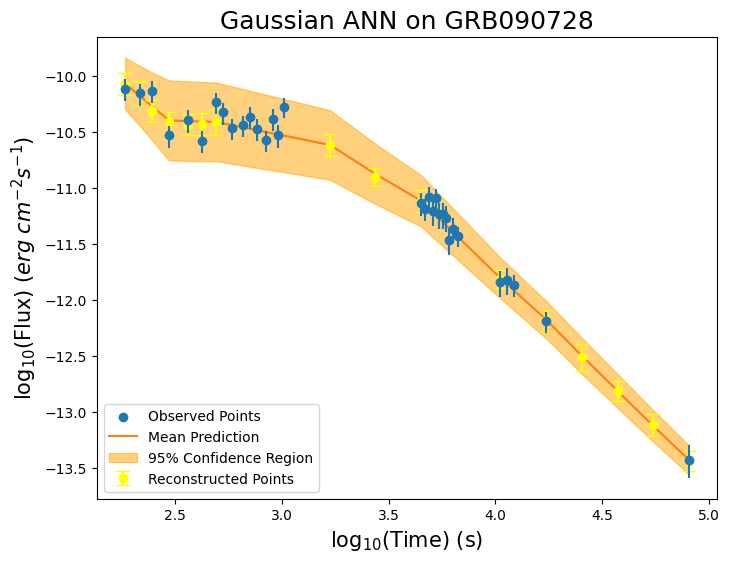


-----TRAINING FOR GRB090807-----


-----ORIGINAL GRB-----



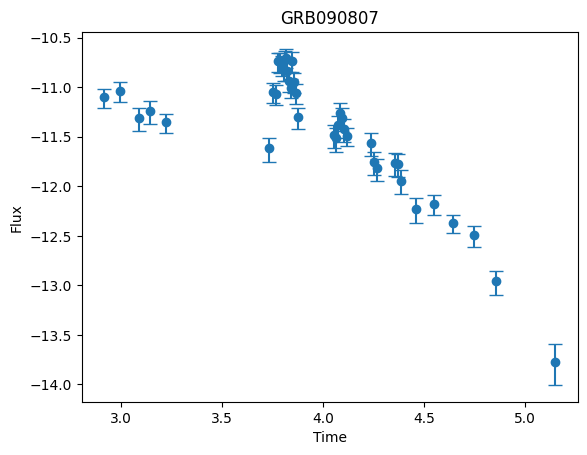


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.0105
Epoch 50, Loss: -0.1658
Epoch 100, Loss: -0.8052
Epoch 150, Loss: -0.5046
Epoch 200, Loss: -0.7515
Epoch 250, Loss: -0.6734
Epoch 300, Loss: -0.7872
Epoch 350, Loss: -0.7401
Epoch 400, Loss: -0.7318
Epoch 450, Loss: -0.6794

-----RECONSTRUCTED GRB-----



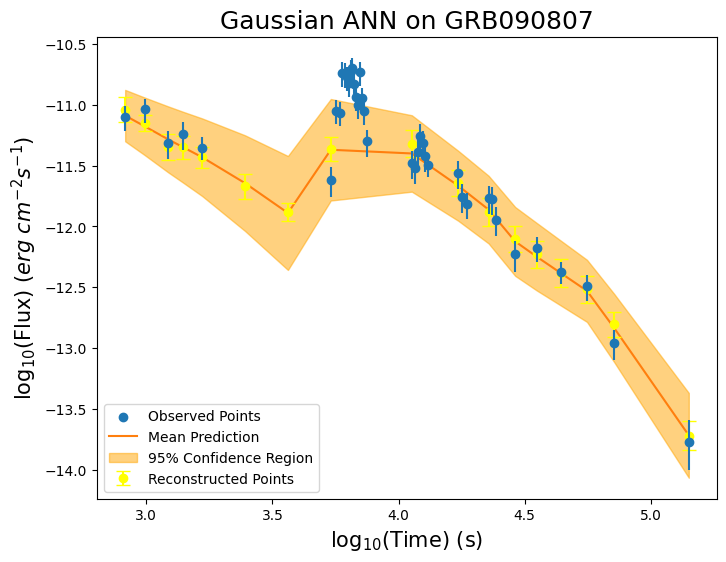


-----TRAINING FOR GRB090813-----


-----ORIGINAL GRB-----



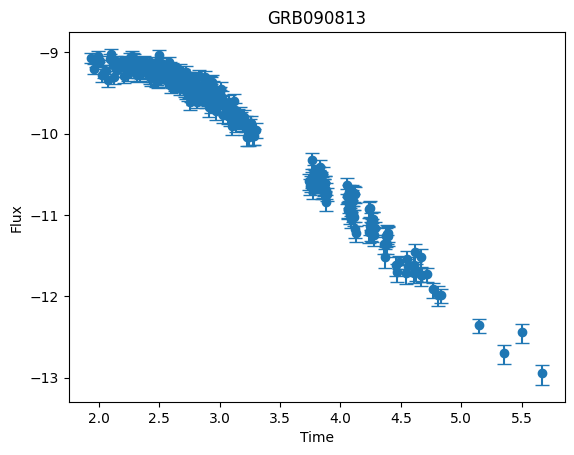


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: -0.4534
Epoch 50, Loss: -0.8911
Epoch 100, Loss: -0.9805
Epoch 150, Loss: -1.0525
Epoch 200, Loss: -0.9492
Epoch 250, Loss: -1.0601
Epoch 300, Loss: -0.9442
Epoch 350, Loss: -0.8113
Epoch 400, Loss: -1.0301
Epoch 450, Loss: -0.7801

-----RECONSTRUCTED GRB-----



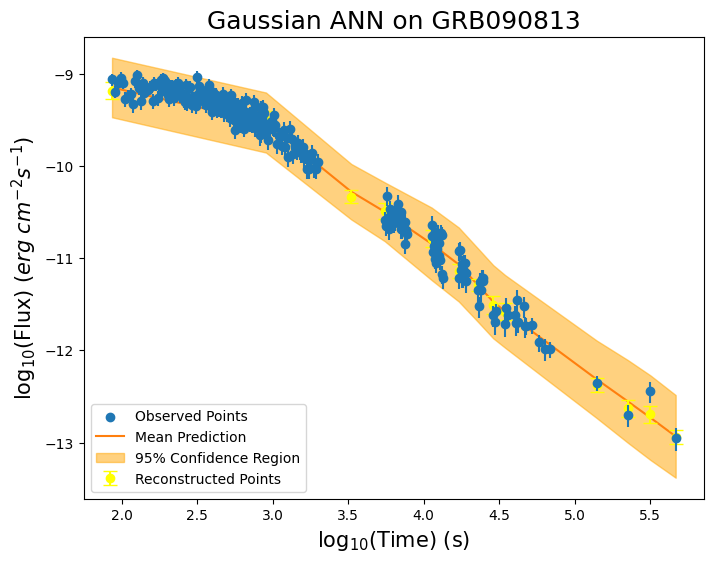


-----TRAINING FOR GRB090904A-----


-----ORIGINAL GRB-----



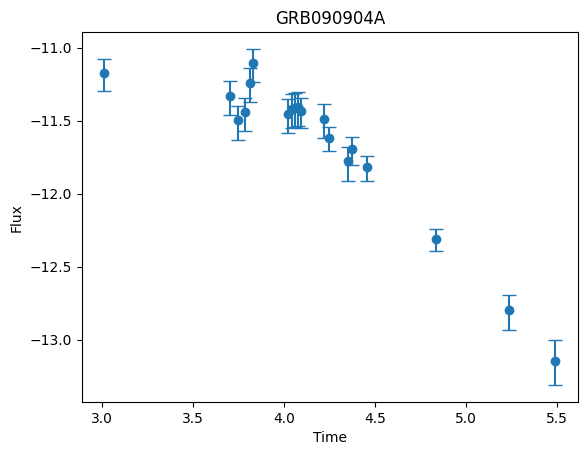


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.6112
Epoch 50, Loss: -0.8715
Epoch 100, Loss: -0.9279
Epoch 150, Loss: -0.9624
Epoch 200, Loss: -0.9846
Epoch 250, Loss: -0.9822
Epoch 300, Loss: -1.0213
Epoch 350, Loss: -0.9126
Epoch 400, Loss: -1.0605
Epoch 450, Loss: -1.0677

-----RECONSTRUCTED GRB-----



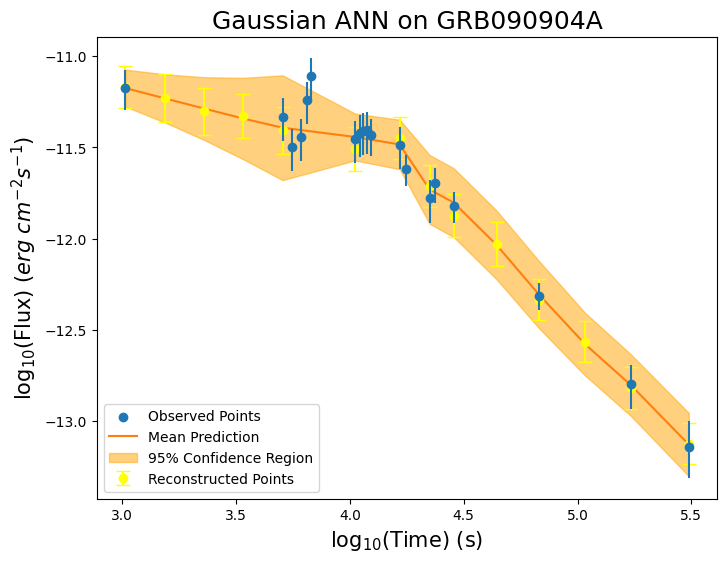


-----TRAINING FOR GRB091130B-----


-----ORIGINAL GRB-----



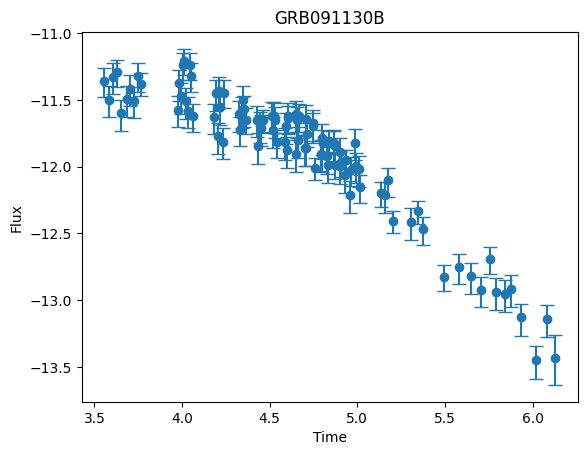


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.2824
Epoch 50, Loss: -0.5420
Epoch 100, Loss: -0.5936
Epoch 150, Loss: -0.5886
Epoch 200, Loss: -0.5274
Epoch 250, Loss: -0.7853
Epoch 300, Loss: -0.6388
Epoch 350, Loss: -0.7896
Epoch 400, Loss: -0.8146
Epoch 450, Loss: -0.7310

-----RECONSTRUCTED GRB-----



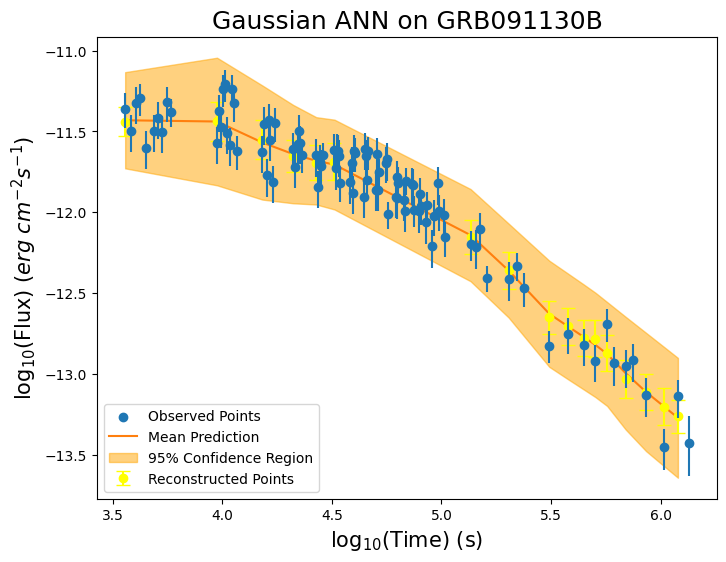


-----TRAINING FOR GRB100302A-----


-----ORIGINAL GRB-----



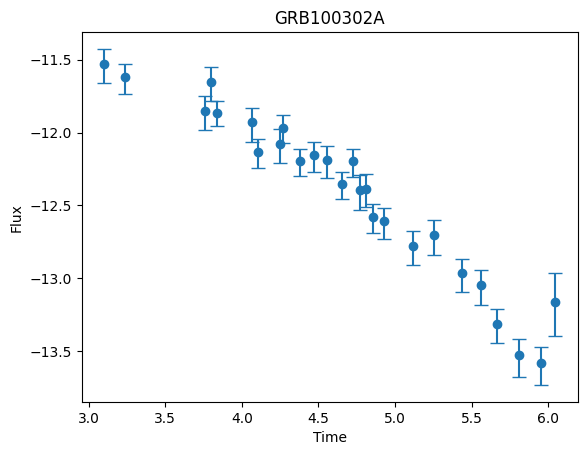


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.5006
Epoch 50, Loss: -0.7517
Epoch 100, Loss: -0.7920
Epoch 150, Loss: -0.8108
Epoch 200, Loss: -0.8373
Epoch 250, Loss: -0.8636
Epoch 300, Loss: -0.8763
Epoch 350, Loss: -0.8700
Epoch 400, Loss: -0.9015
Epoch 450, Loss: -0.9241

-----RECONSTRUCTED GRB-----



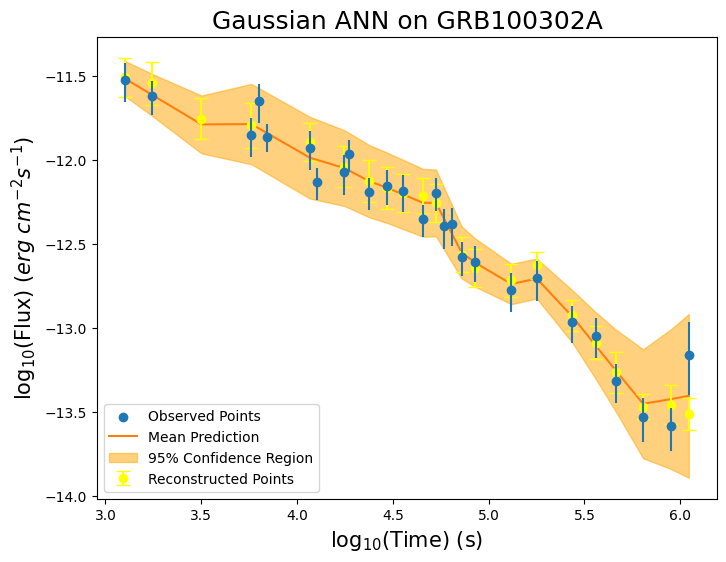


-----TRAINING FOR GRB100305A-----


-----ORIGINAL GRB-----



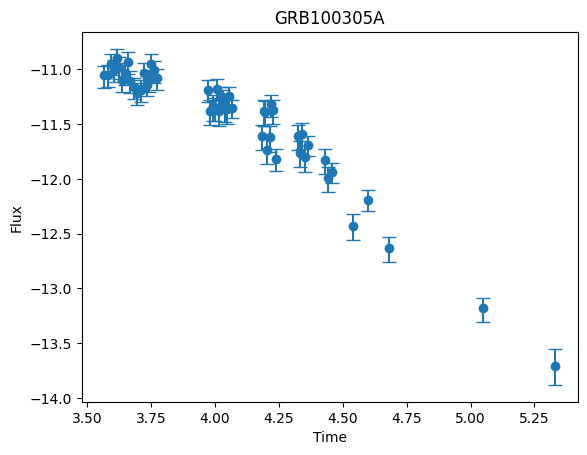


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.1399
Epoch 50, Loss: -0.7763
Epoch 100, Loss: -0.6788
Epoch 150, Loss: -0.7802
Epoch 200, Loss: -0.7303
Epoch 250, Loss: -0.7222
Epoch 300, Loss: -0.8141
Epoch 350, Loss: -0.8040
Epoch 400, Loss: -0.7693
Epoch 450, Loss: -0.8437

-----RECONSTRUCTED GRB-----



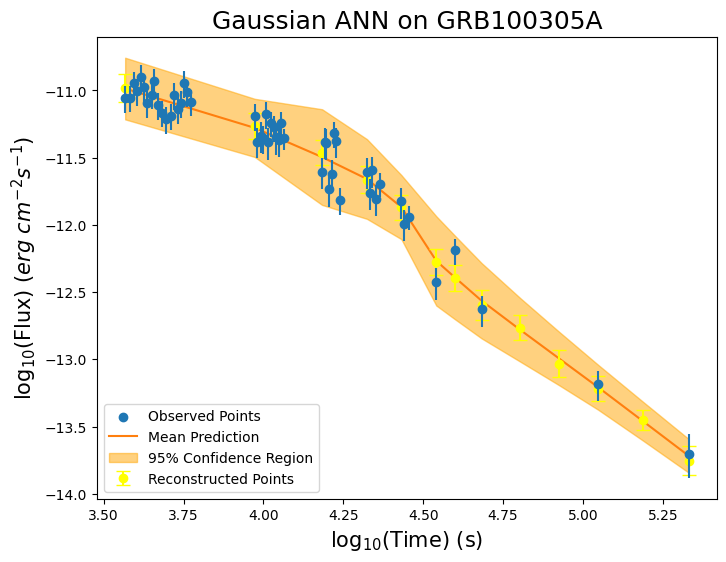


-----TRAINING FOR GRB100424A-----


-----ORIGINAL GRB-----



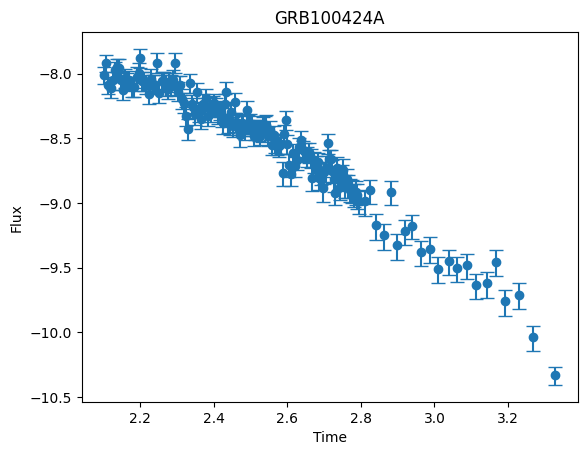


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.0525
Epoch 50, Loss: -0.8157
Epoch 100, Loss: -0.9868
Epoch 150, Loss: -0.4453
Epoch 200, Loss: -0.7609
Epoch 250, Loss: -0.9997
Epoch 300, Loss: -0.7049
Epoch 350, Loss: -0.3596
Epoch 400, Loss: -1.0654
Epoch 450, Loss: -1.0491

-----RECONSTRUCTED GRB-----



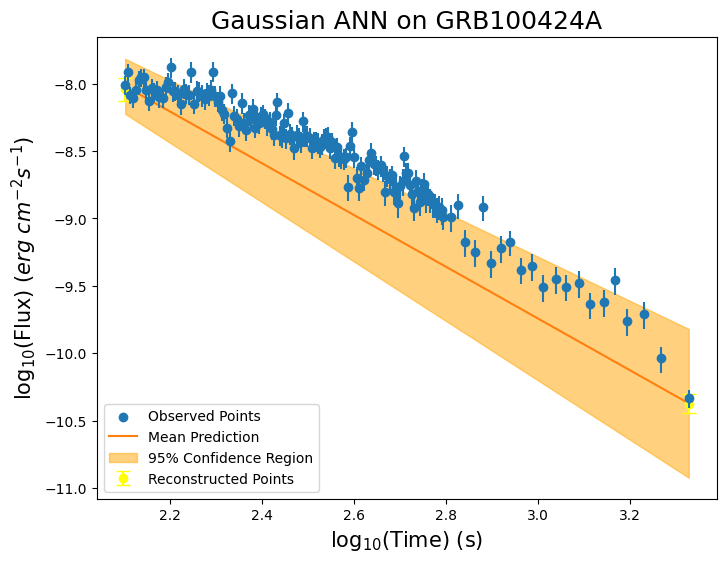


-----TRAINING FOR GRB100522A-----


-----ORIGINAL GRB-----



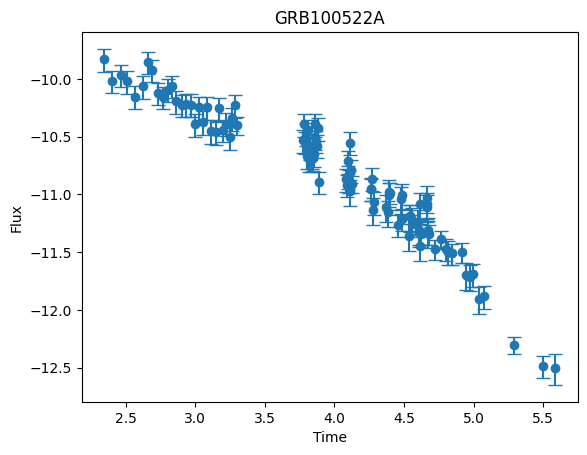


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.2162
Epoch 50, Loss: -0.6489
Epoch 100, Loss: -0.7709
Epoch 150, Loss: -0.9375
Epoch 200, Loss: -0.8621
Epoch 250, Loss: -0.7366
Epoch 300, Loss: -0.7062
Epoch 350, Loss: -0.7712
Epoch 400, Loss: -0.8741
Epoch 450, Loss: -0.7684

-----RECONSTRUCTED GRB-----



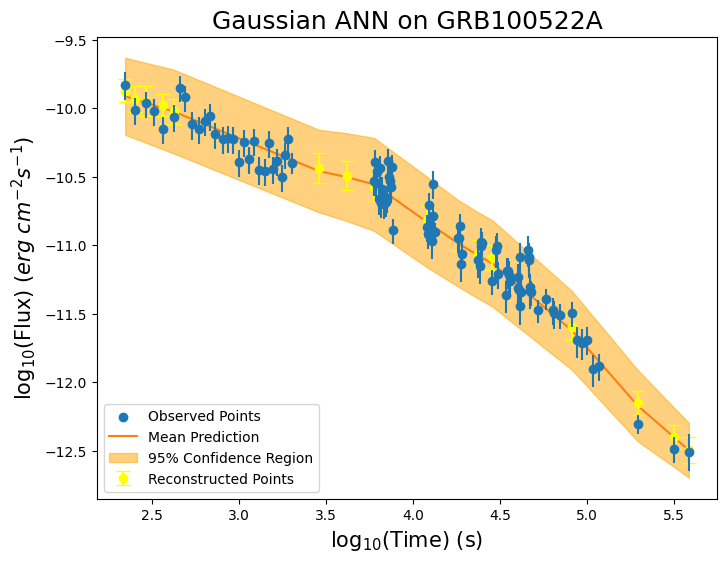


-----TRAINING FOR GRB100606A-----


-----ORIGINAL GRB-----



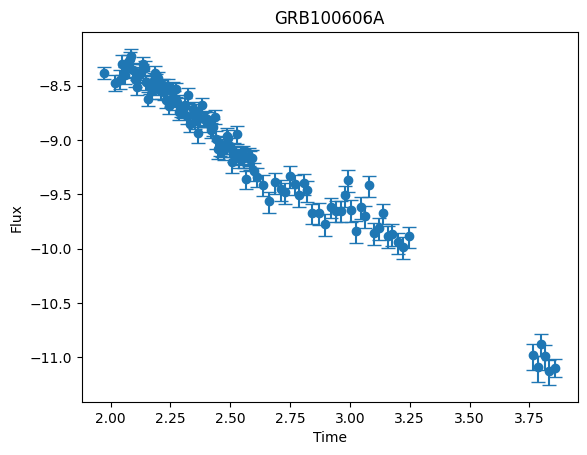


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.1704
Epoch 50, Loss: -0.9236
Epoch 100, Loss: -0.8330
Epoch 150, Loss: -0.7676
Epoch 200, Loss: -0.8080
Epoch 250, Loss: -0.8374
Epoch 300, Loss: -0.7476
Epoch 350, Loss: -0.9103
Epoch 400, Loss: -0.8143
Epoch 450, Loss: -0.8467

-----RECONSTRUCTED GRB-----



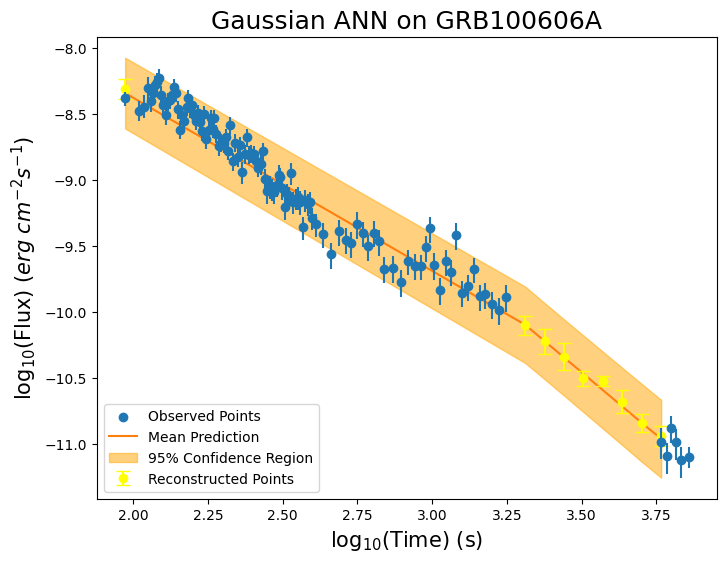


-----TRAINING FOR GRB100725A-----


-----ORIGINAL GRB-----



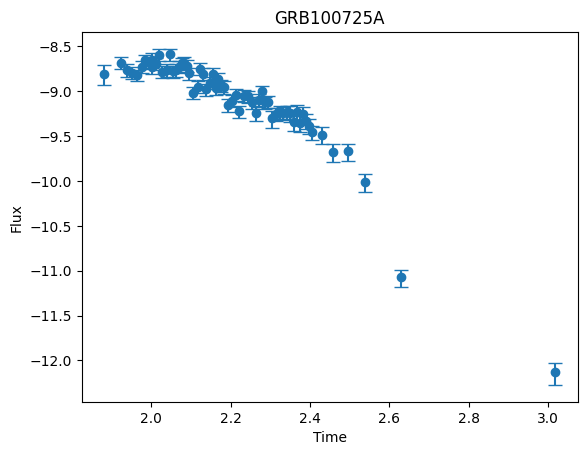


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.2202
Epoch 50, Loss: -0.8529
Epoch 100, Loss: -0.7689
Epoch 150, Loss: -0.8870
Epoch 200, Loss: -0.8055
Epoch 250, Loss: -0.8332
Epoch 300, Loss: -0.7756
Epoch 350, Loss: -0.8426
Epoch 400, Loss: -0.7893
Epoch 450, Loss: -0.8659

-----RECONSTRUCTED GRB-----



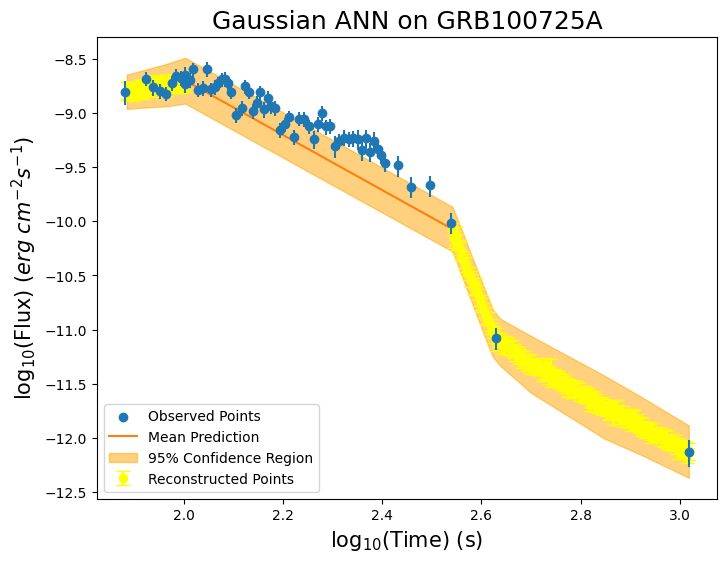


-----TRAINING FOR GRB100725B-----


-----ORIGINAL GRB-----



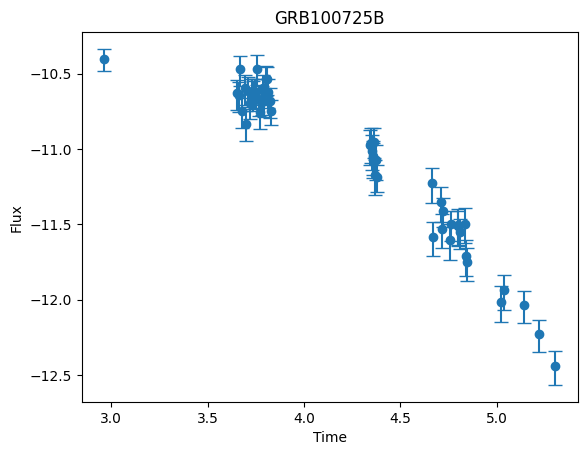


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.3833
Epoch 50, Loss: -0.7786
Epoch 100, Loss: -0.7445
Epoch 150, Loss: -0.7533
Epoch 200, Loss: -0.6581
Epoch 250, Loss: -0.8534
Epoch 300, Loss: -0.7836
Epoch 350, Loss: -0.7306
Epoch 400, Loss: -0.8326
Epoch 450, Loss: -0.7008

-----RECONSTRUCTED GRB-----



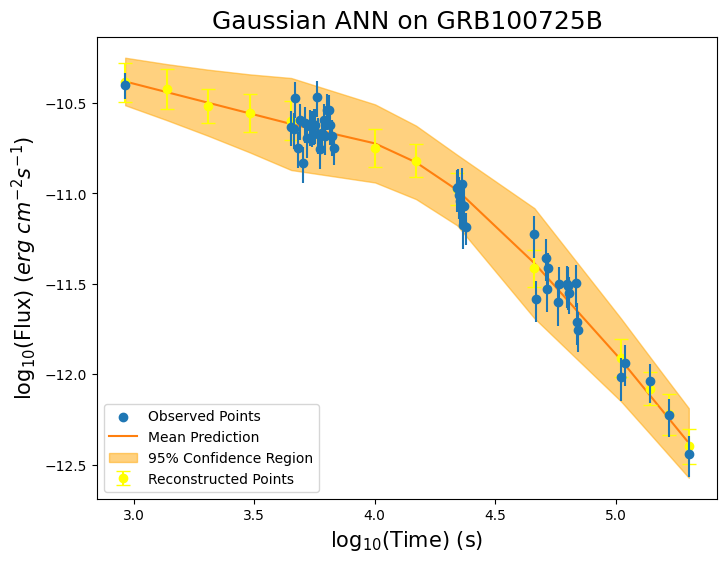


-----TRAINING FOR GRB100727A-----


-----ORIGINAL GRB-----



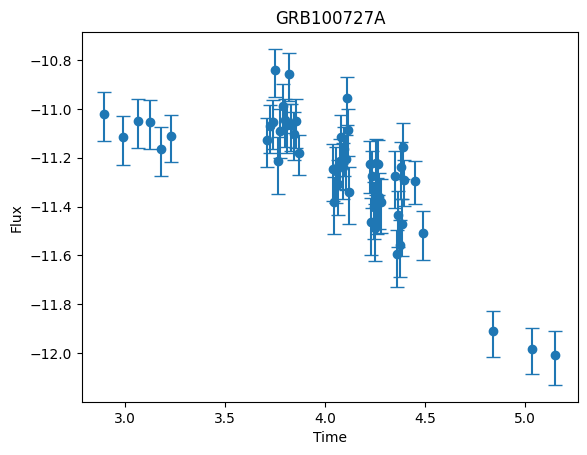


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.3776
Epoch 50, Loss: -0.2087
Epoch 100, Loss: -0.0948
Epoch 150, Loss: -0.3733
Epoch 200, Loss: -0.3186
Epoch 250, Loss: -0.0520
Epoch 300, Loss: -0.2165
Epoch 350, Loss: -0.2983
Epoch 400, Loss: -0.3715
Epoch 450, Loss: -0.2898

-----RECONSTRUCTED GRB-----



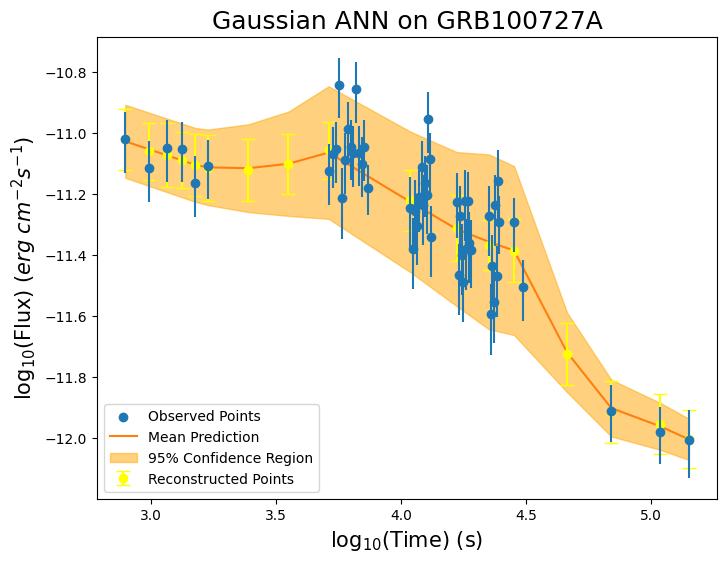


-----TRAINING FOR GRB100802A-----


-----ORIGINAL GRB-----



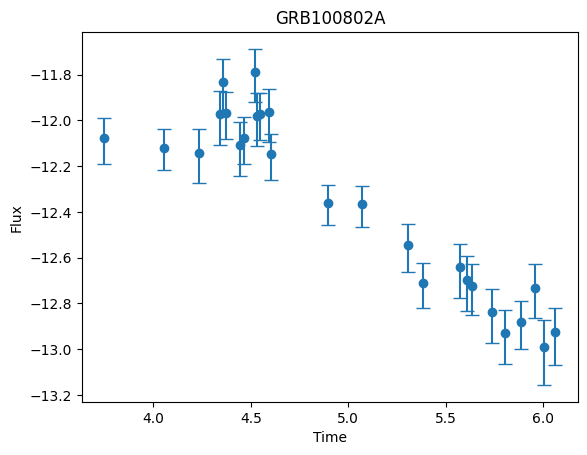


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.5902
Epoch 50, Loss: -0.6381
Epoch 100, Loss: -0.6846
Epoch 150, Loss: -0.7273
Epoch 200, Loss: -0.7604
Epoch 250, Loss: -0.7567
Epoch 300, Loss: -0.7898
Epoch 350, Loss: -0.8328
Epoch 400, Loss: -0.8383
Epoch 450, Loss: -0.8165

-----RECONSTRUCTED GRB-----



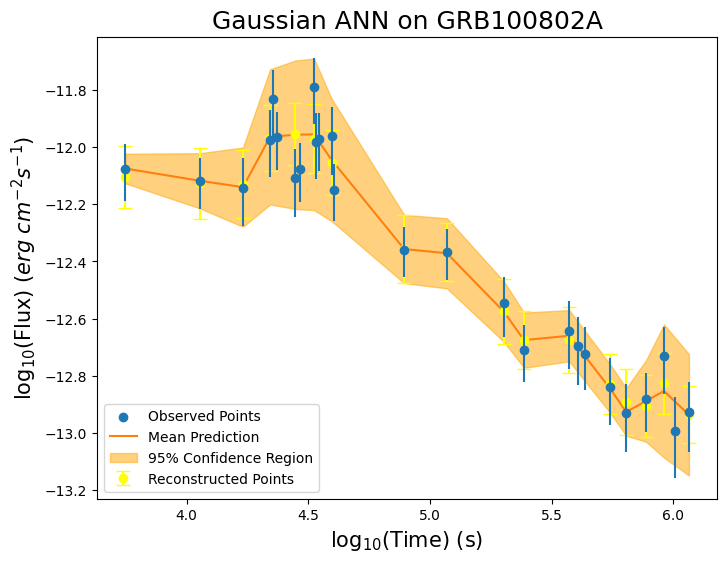


-----TRAINING FOR GRB101011A-----


-----ORIGINAL GRB-----



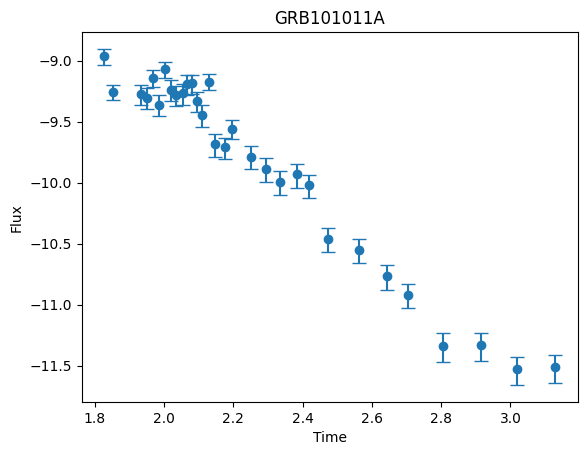


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.4697
Epoch 50, Loss: -0.8466
Epoch 100, Loss: -0.8930
Epoch 150, Loss: -0.9050
Epoch 200, Loss: -0.9217
Epoch 250, Loss: -0.9427
Epoch 300, Loss: -0.9539
Epoch 350, Loss: -0.9696
Epoch 400, Loss: -0.9377
Epoch 450, Loss: -0.9858

-----RECONSTRUCTED GRB-----



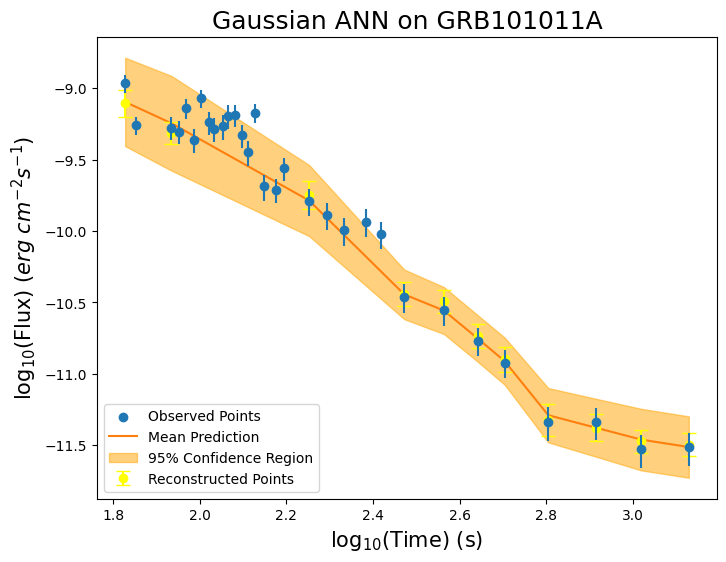


-----TRAINING FOR GRB101024A-----


-----ORIGINAL GRB-----



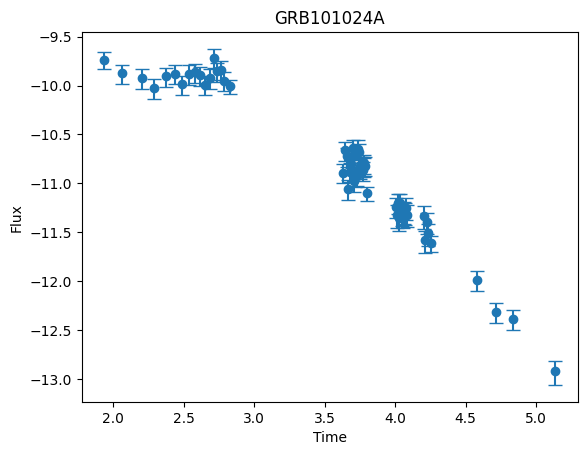


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.4050
Epoch 50, Loss: -0.9114
Epoch 100, Loss: -0.8346
Epoch 150, Loss: -0.8093
Epoch 200, Loss: -0.8453
Epoch 250, Loss: -0.9212
Epoch 300, Loss: -0.8957
Epoch 350, Loss: -0.9382
Epoch 400, Loss: -0.9515
Epoch 450, Loss: -0.9264

-----RECONSTRUCTED GRB-----



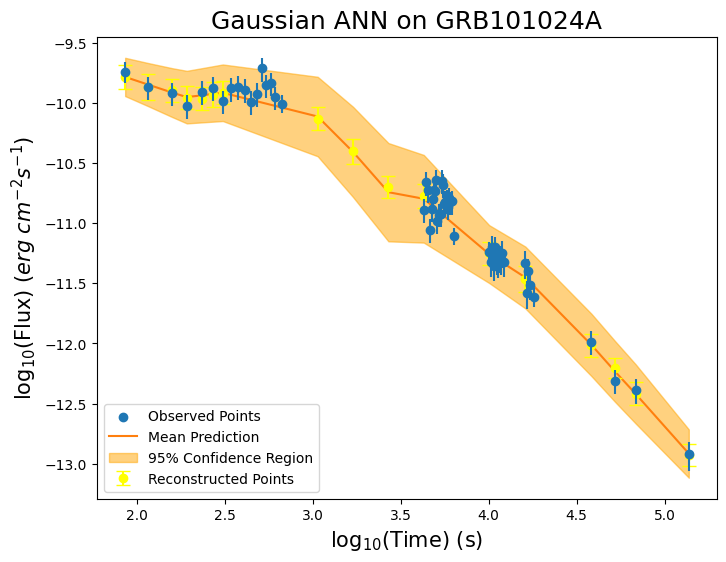


-----TRAINING FOR GRB110102A-----


-----ORIGINAL GRB-----



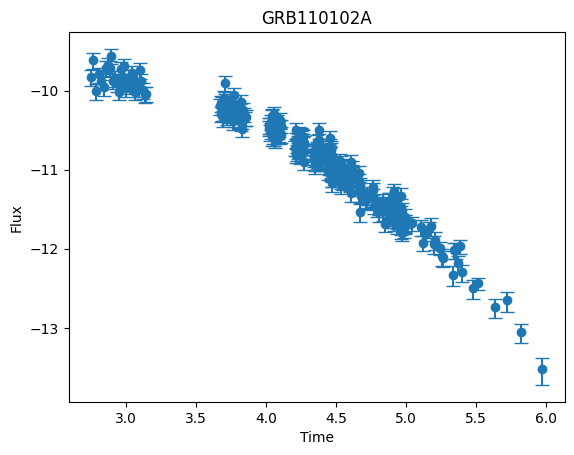


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: -0.1893
Epoch 50, Loss: -0.8593
Epoch 100, Loss: -0.8858
Epoch 150, Loss: -0.7840
Epoch 200, Loss: -0.4409
Epoch 250, Loss: -0.8066
Epoch 300, Loss: -0.8298
Epoch 350, Loss: -0.8371
Epoch 400, Loss: -0.7927
Epoch 450, Loss: -0.7017

-----RECONSTRUCTED GRB-----



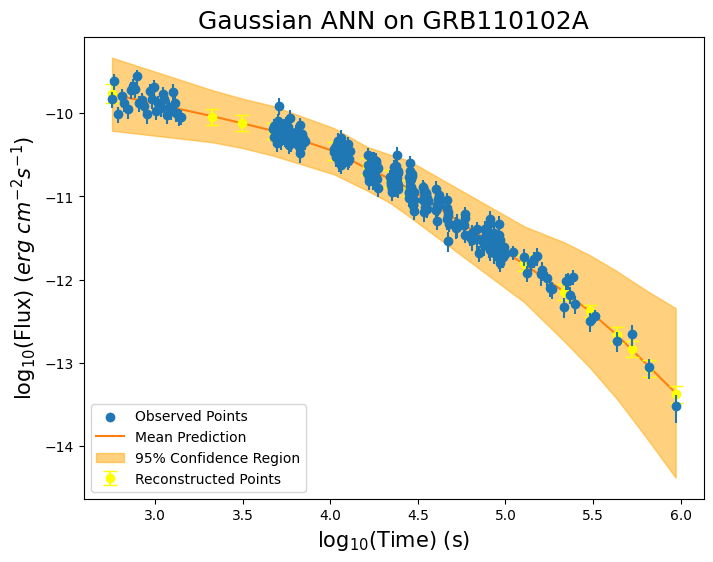


-----TRAINING FOR GRB110201A-----


-----ORIGINAL GRB-----



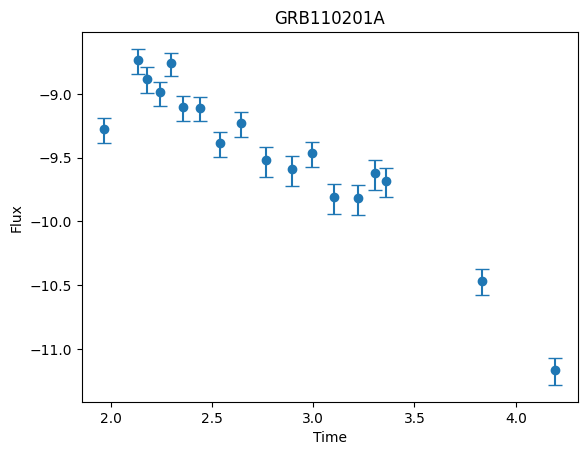


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.4754
Epoch 50, Loss: -0.6681
Epoch 100, Loss: -0.7444
Epoch 150, Loss: -0.7748
Epoch 200, Loss: -0.6438
Epoch 250, Loss: -0.8084
Epoch 300, Loss: -0.7913
Epoch 350, Loss: -0.8358
Epoch 400, Loss: -0.8171
Epoch 450, Loss: -0.8795

-----RECONSTRUCTED GRB-----



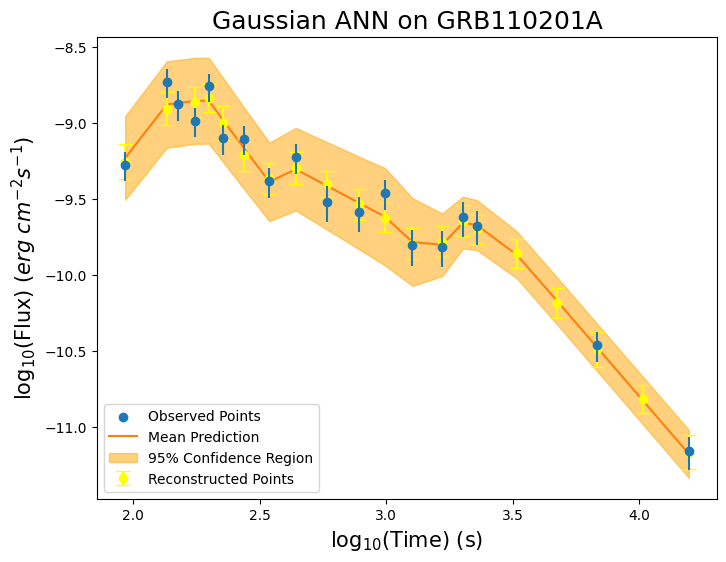


-----TRAINING FOR GRB110208A-----


-----ORIGINAL GRB-----



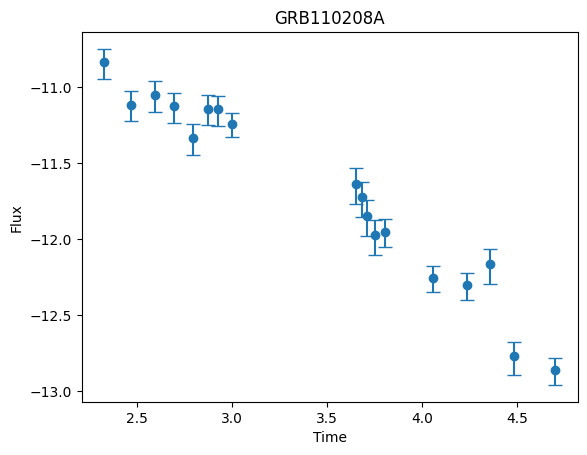


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.5388
Epoch 50, Loss: -0.7788
Epoch 100, Loss: -0.9052
Epoch 150, Loss: -0.9457
Epoch 200, Loss: -0.9636
Epoch 250, Loss: -1.0029
Epoch 300, Loss: -0.9641
Epoch 350, Loss: -1.0417
Epoch 400, Loss: -0.9572
Epoch 450, Loss: -1.0478

-----RECONSTRUCTED GRB-----



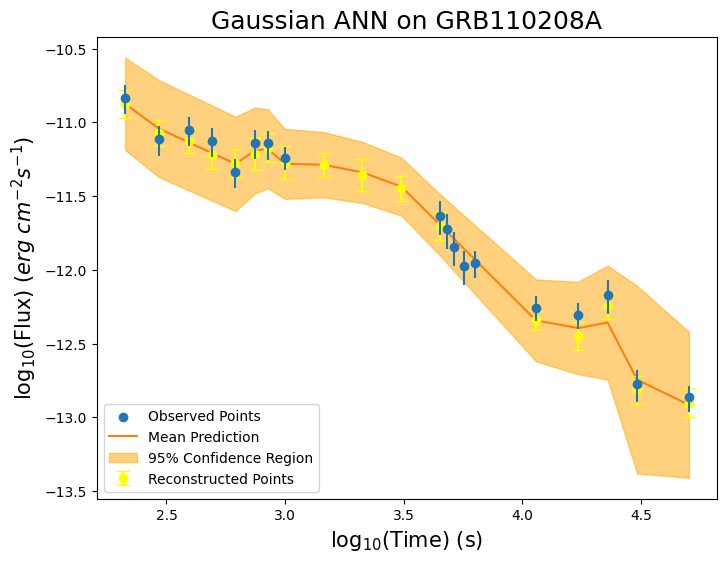


-----TRAINING FOR GRB110312A-----


-----ORIGINAL GRB-----



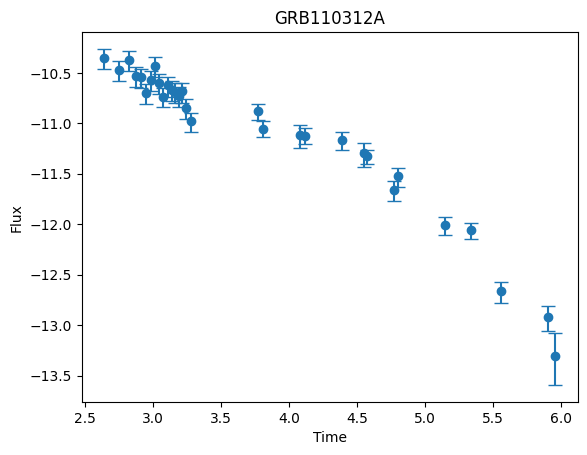


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.5528
Epoch 50, Loss: -0.9347
Epoch 100, Loss: -0.9658
Epoch 150, Loss: -0.9760
Epoch 200, Loss: -0.9794
Epoch 250, Loss: -0.9838
Epoch 300, Loss: -0.9942
Epoch 350, Loss: -0.9935
Epoch 400, Loss: -1.0098
Epoch 450, Loss: -1.0139

-----RECONSTRUCTED GRB-----



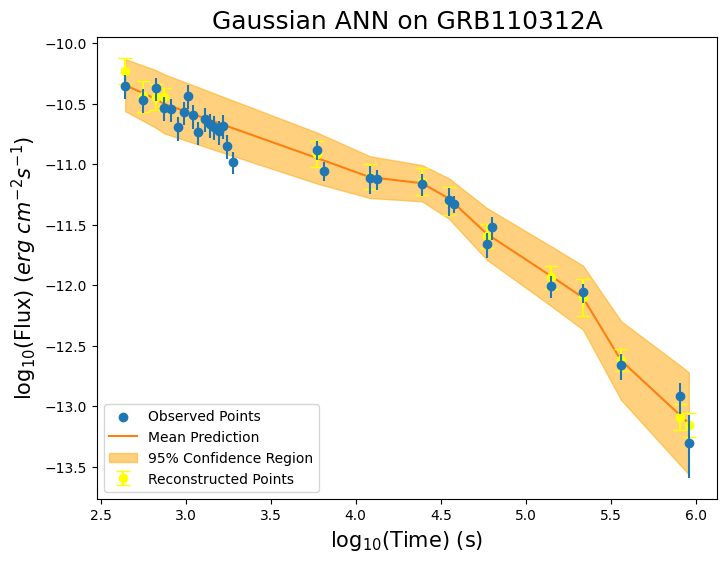


-----TRAINING FOR GRB110315A-----


-----ORIGINAL GRB-----



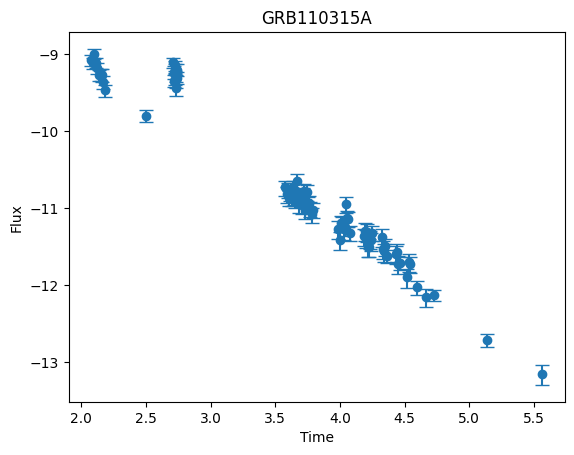


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.3605
Epoch 50, Loss: -0.9571
Epoch 100, Loss: -0.9673
Epoch 150, Loss: -0.9569
Epoch 200, Loss: -0.9593
Epoch 250, Loss: -0.8777
Epoch 300, Loss: -1.0252
Epoch 350, Loss: -0.8435
Epoch 400, Loss: -1.0568
Epoch 450, Loss: -0.9721

-----RECONSTRUCTED GRB-----



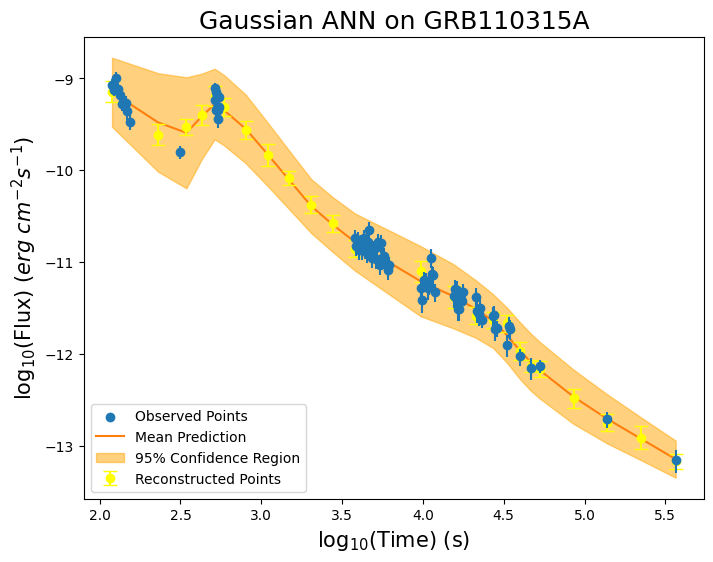


-----TRAINING FOR GRB110318B-----


-----ORIGINAL GRB-----



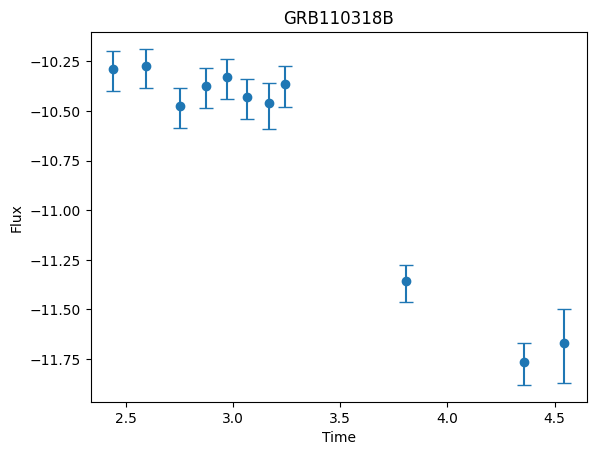


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.4583
Epoch 50, Loss: -0.9578
Epoch 100, Loss: -1.0758
Epoch 150, Loss: -1.0880
Epoch 200, Loss: -1.0618
Epoch 250, Loss: -1.1019
Epoch 300, Loss: -1.1031
Epoch 350, Loss: -1.1066
Epoch 400, Loss: -1.1083
Epoch 450, Loss: -1.0833

-----RECONSTRUCTED GRB-----



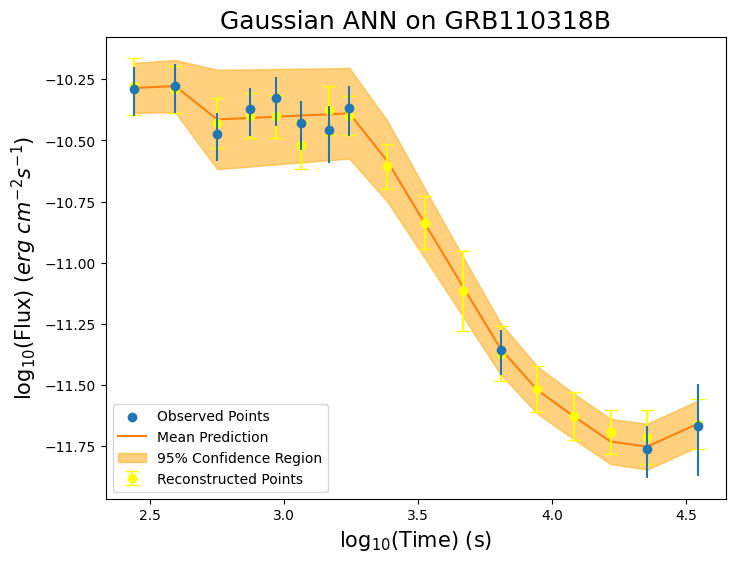


-----TRAINING FOR GRB110319A-----


-----ORIGINAL GRB-----



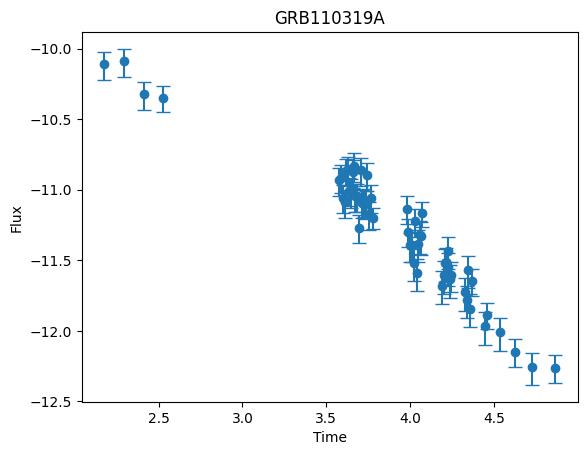


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.3734
Epoch 50, Loss: -0.6531
Epoch 100, Loss: -0.6523
Epoch 150, Loss: -0.7580
Epoch 200, Loss: -0.7207
Epoch 250, Loss: -0.7674
Epoch 300, Loss: -0.7018
Epoch 350, Loss: -0.6634
Epoch 400, Loss: -0.7093
Epoch 450, Loss: -0.6210

-----RECONSTRUCTED GRB-----



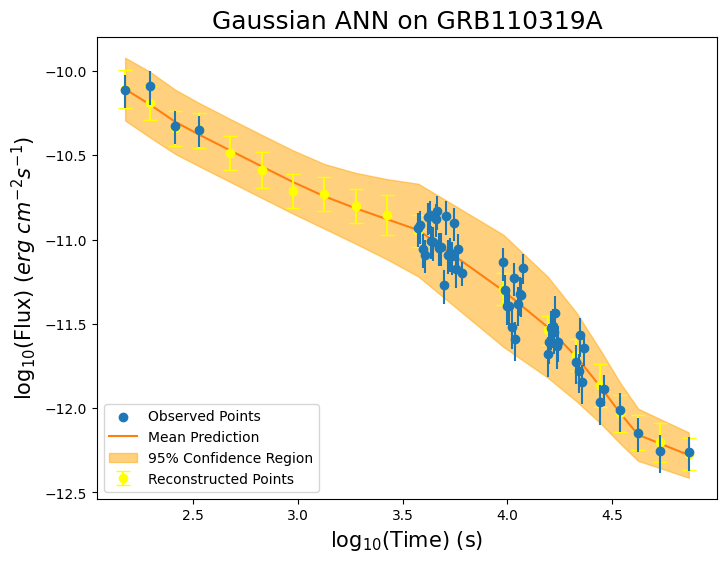


-----TRAINING FOR GRB110402A-----


-----ORIGINAL GRB-----



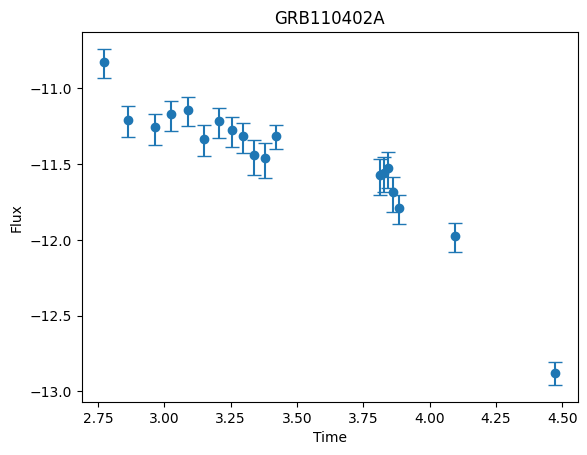


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.6271
Epoch 50, Loss: -0.7766
Epoch 100, Loss: -0.8633
Epoch 150, Loss: -0.8821
Epoch 200, Loss: -0.9213
Epoch 250, Loss: -0.9450
Epoch 300, Loss: -0.9642
Epoch 350, Loss: -0.9851
Epoch 400, Loss: -0.9887
Epoch 450, Loss: -1.0096

-----RECONSTRUCTED GRB-----



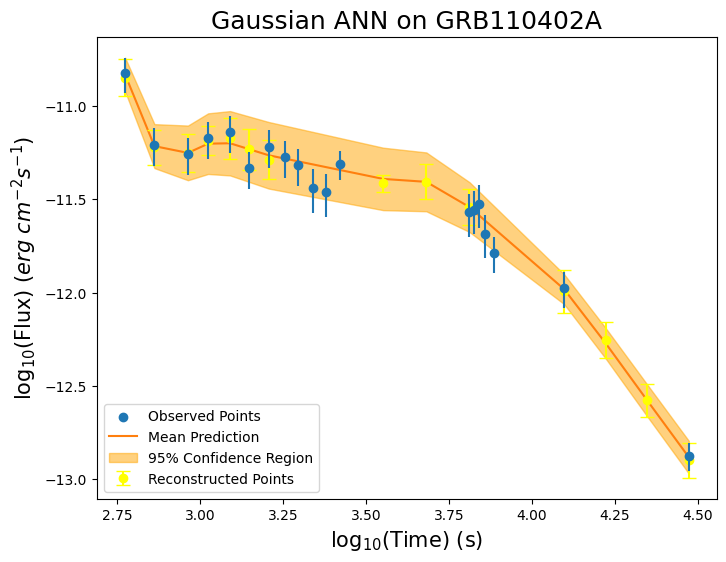


-----TRAINING FOR GRB110411A-----


-----ORIGINAL GRB-----



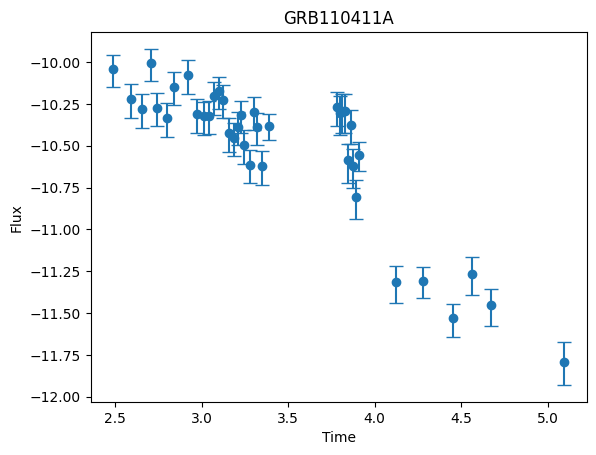


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.3993
Epoch 50, Loss: -0.4431
Epoch 100, Loss: -0.5015
Epoch 150, Loss: -0.5843
Epoch 200, Loss: -0.5745
Epoch 250, Loss: -0.6573
Epoch 300, Loss: -0.3936
Epoch 350, Loss: -0.6025
Epoch 400, Loss: -0.4644
Epoch 450, Loss: -0.5711

-----RECONSTRUCTED GRB-----



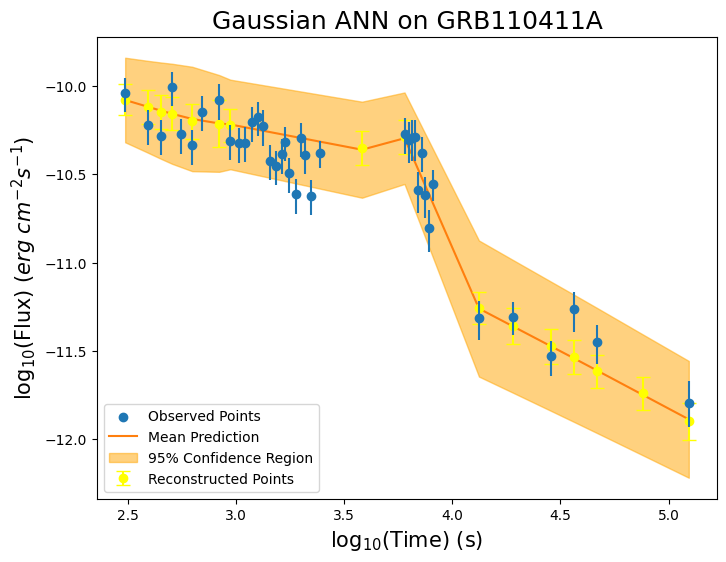


-----TRAINING FOR GRB110414A-----


-----ORIGINAL GRB-----



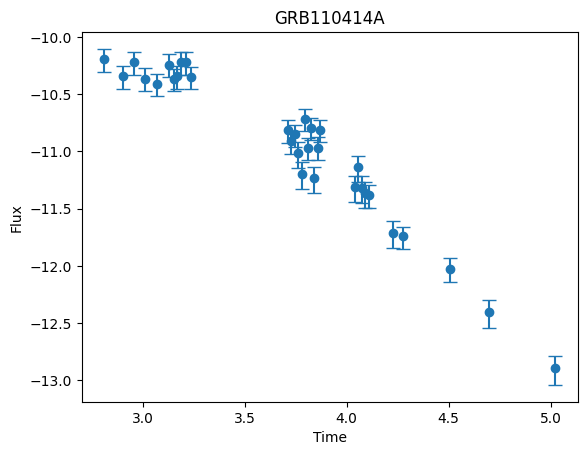


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.5061
Epoch 50, Loss: -0.8137
Epoch 100, Loss: -0.8441
Epoch 150, Loss: -0.8587
Epoch 200, Loss: -0.8757
Epoch 250, Loss: -0.8929
Epoch 300, Loss: -0.8976
Epoch 350, Loss: -0.9028
Epoch 400, Loss: -0.9066
Epoch 450, Loss: -0.9101

-----RECONSTRUCTED GRB-----



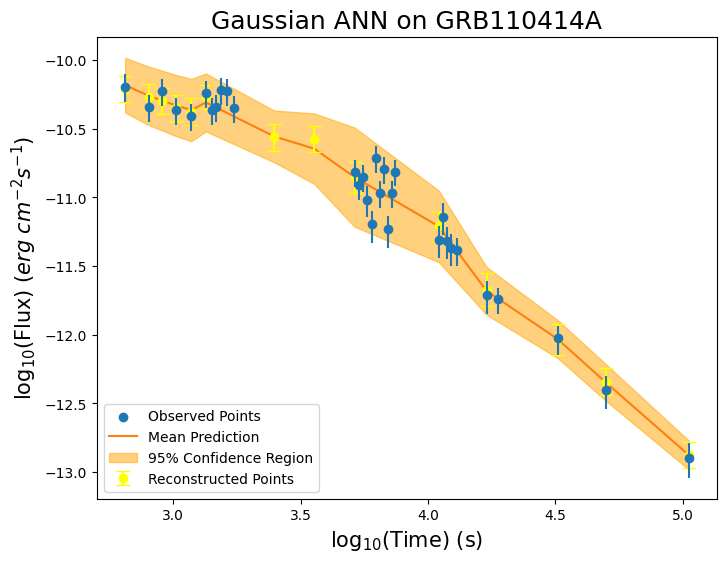


-----TRAINING FOR GRB110420A-----


-----ORIGINAL GRB-----



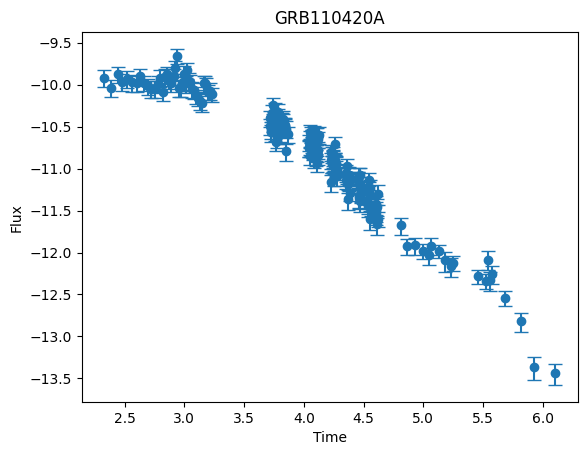


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.1312
Epoch 50, Loss: -0.7679
Epoch 100, Loss: -0.9269
Epoch 150, Loss: -0.8180
Epoch 200, Loss: -0.8434
Epoch 250, Loss: -0.8553
Epoch 300, Loss: -0.8399
Epoch 350, Loss: -0.8563
Epoch 400, Loss: -0.8169
Epoch 450, Loss: -0.8175

-----RECONSTRUCTED GRB-----



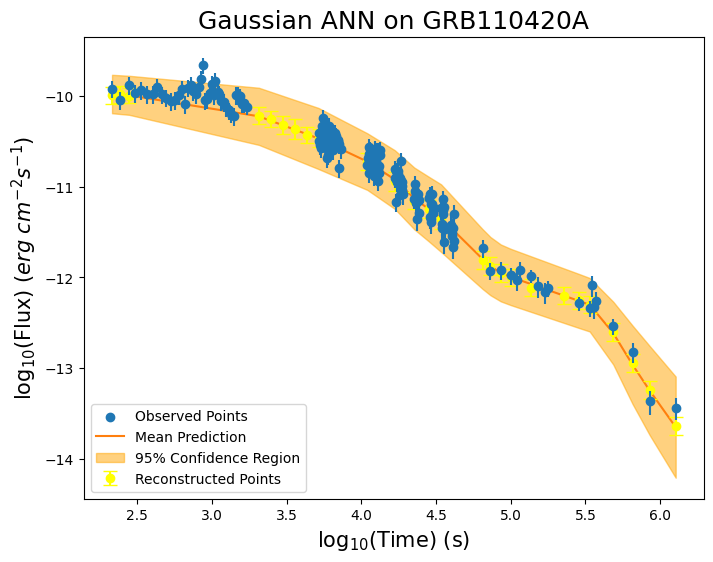


-----TRAINING FOR GRB110530A-----


-----ORIGINAL GRB-----



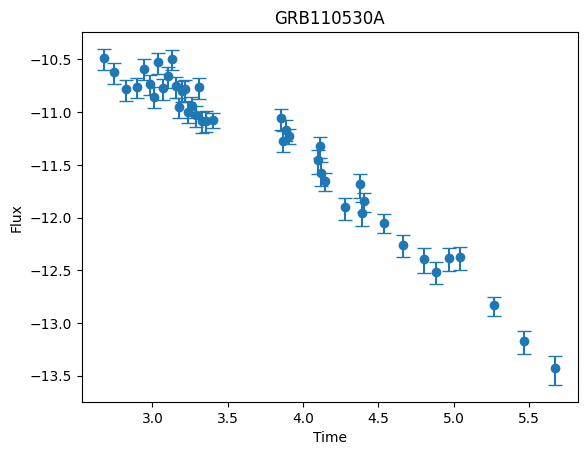


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.5716
Epoch 50, Loss: -0.7746
Epoch 100, Loss: -0.8968
Epoch 150, Loss: -0.8345
Epoch 200, Loss: -0.9103
Epoch 250, Loss: -0.8432
Epoch 300, Loss: -0.9020
Epoch 350, Loss: -0.9445
Epoch 400, Loss: -0.6614
Epoch 450, Loss: -0.8636

-----RECONSTRUCTED GRB-----



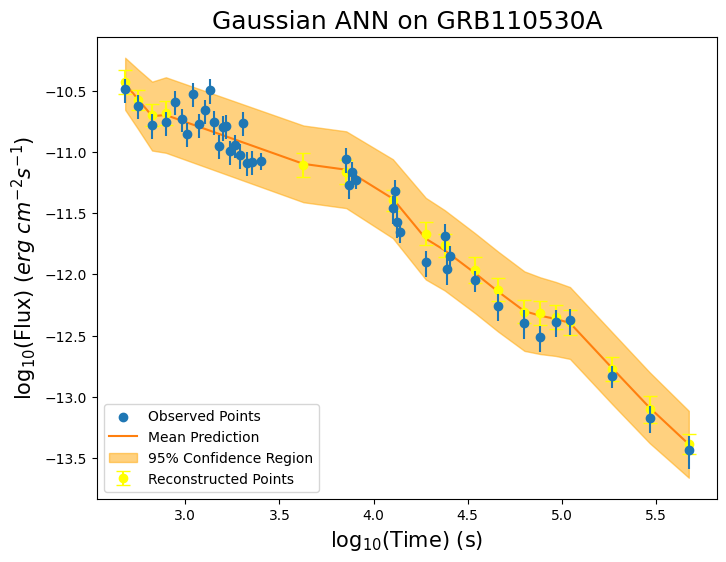


-----TRAINING FOR GRB110610A-----


-----ORIGINAL GRB-----



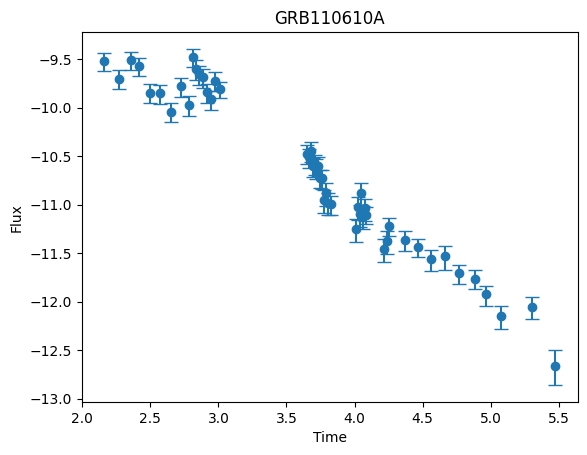


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.4692
Epoch 50, Loss: -0.8585
Epoch 100, Loss: -0.8372
Epoch 150, Loss: -0.8433
Epoch 200, Loss: -0.8764
Epoch 250, Loss: -0.8098
Epoch 300, Loss: -0.8065
Epoch 350, Loss: -0.9252
Epoch 400, Loss: -0.8394
Epoch 450, Loss: -0.8438

-----RECONSTRUCTED GRB-----



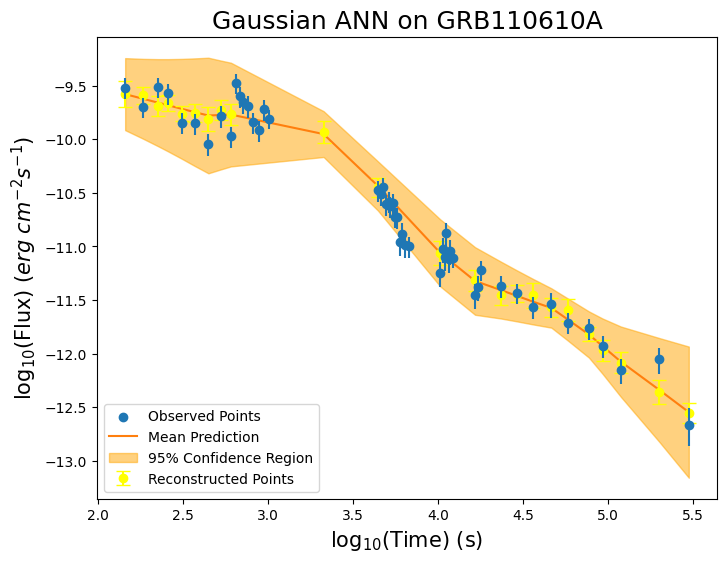


-----TRAINING FOR GRB110709A-----


-----ORIGINAL GRB-----



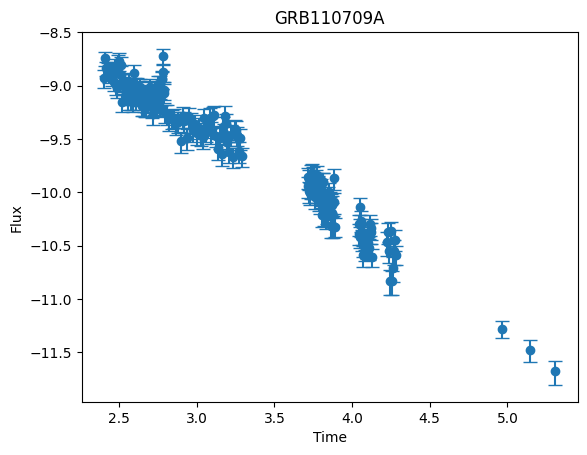


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.0106
Epoch 50, Loss: -0.7733
Epoch 100, Loss: -0.7224
Epoch 150, Loss: -0.8649
Epoch 200, Loss: -0.5925
Epoch 250, Loss: -0.8783
Epoch 300, Loss: -0.7827
Epoch 350, Loss: -0.9236
Epoch 400, Loss: -0.7393
Epoch 450, Loss: -0.8481

-----RECONSTRUCTED GRB-----



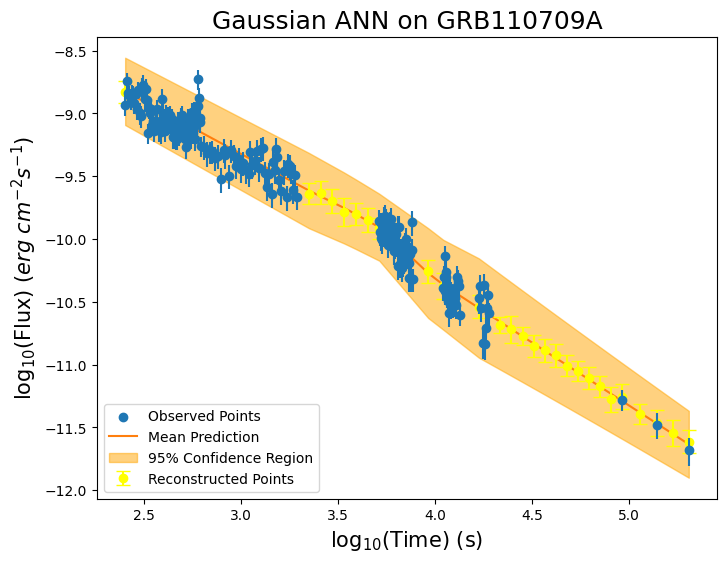


-----TRAINING FOR GRB110801A-----


-----ORIGINAL GRB-----



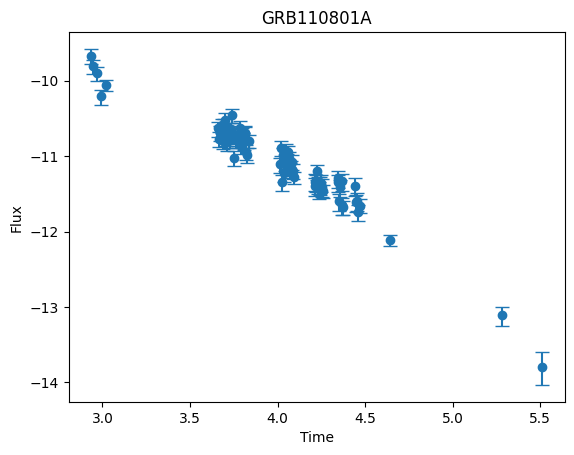


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.7537
Epoch 50, Loss: -0.4512
Epoch 100, Loss: -0.7613
Epoch 150, Loss: -0.7410
Epoch 200, Loss: -0.6434
Epoch 250, Loss: -0.7901
Epoch 300, Loss: -0.8081
Epoch 350, Loss: -0.7150
Epoch 400, Loss: -0.7304
Epoch 450, Loss: -0.6159

-----RECONSTRUCTED GRB-----



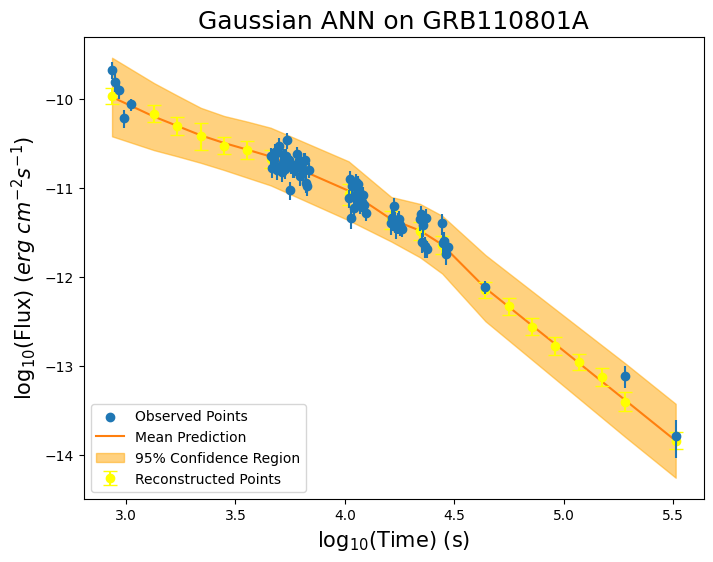


-----TRAINING FOR GRB110820A-----


-----ORIGINAL GRB-----



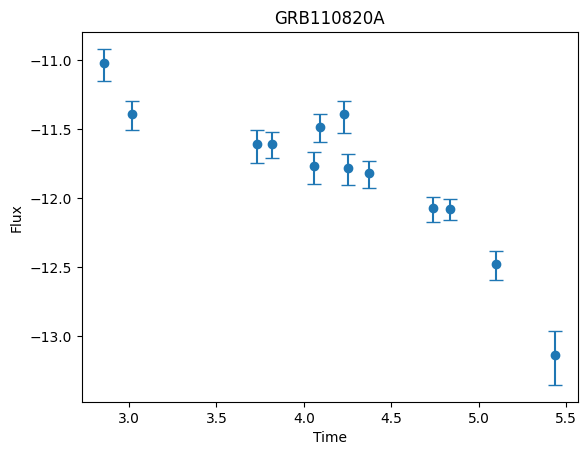


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.4515
Epoch 50, Loss: -0.7446
Epoch 100, Loss: -0.8139
Epoch 150, Loss: -0.8788
Epoch 200, Loss: -0.9030
Epoch 250, Loss: -0.9750
Epoch 300, Loss: -0.9776
Epoch 350, Loss: -0.9824
Epoch 400, Loss: -1.0168
Epoch 450, Loss: -1.0371

-----RECONSTRUCTED GRB-----



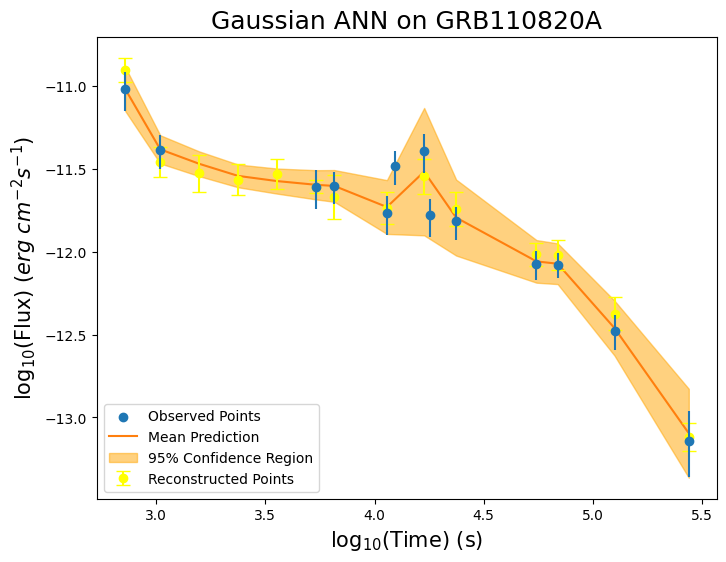


-----TRAINING FOR GRB111107A-----


-----ORIGINAL GRB-----



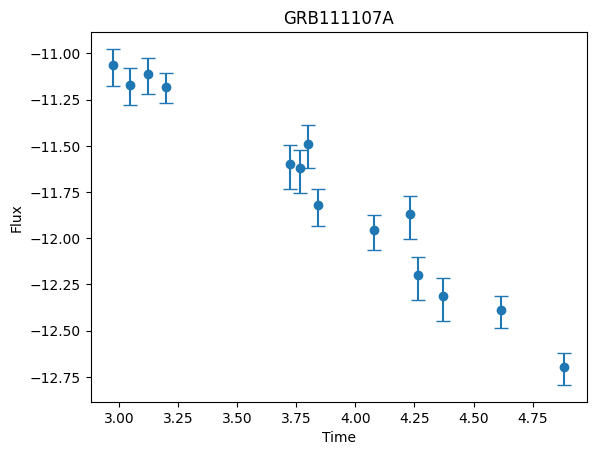


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.5116
Epoch 50, Loss: -0.8158
Epoch 100, Loss: -0.8491
Epoch 150, Loss: -0.8795
Epoch 200, Loss: -0.9064
Epoch 250, Loss: -0.9148
Epoch 300, Loss: -0.9363
Epoch 350, Loss: -1.0194
Epoch 400, Loss: -1.0418
Epoch 450, Loss: -1.0777

-----RECONSTRUCTED GRB-----



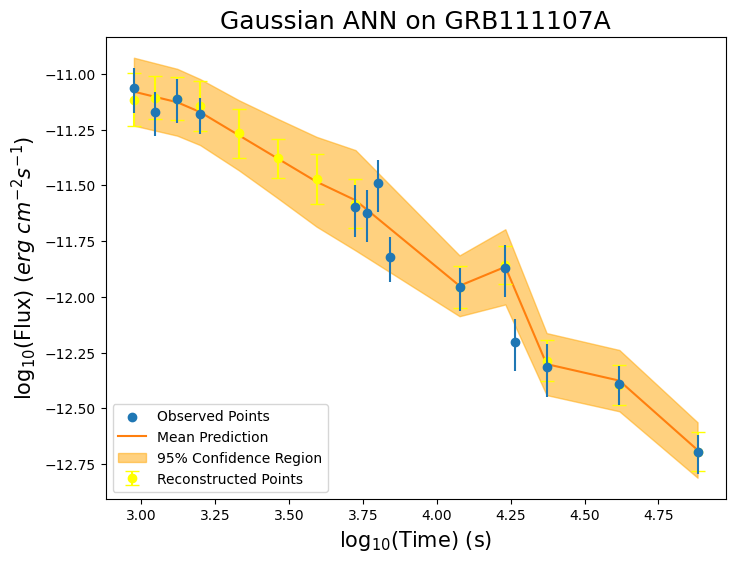


-----TRAINING FOR GRB111121A-----


-----ORIGINAL GRB-----



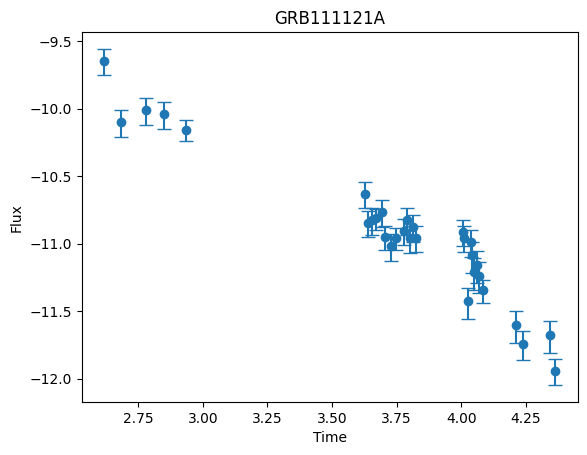


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.5262
Epoch 50, Loss: -0.6451
Epoch 100, Loss: -0.6756
Epoch 150, Loss: -0.7064
Epoch 200, Loss: -0.7481
Epoch 250, Loss: -0.7816
Epoch 300, Loss: -0.8038
Epoch 350, Loss: -0.8124
Epoch 400, Loss: -0.8246
Epoch 450, Loss: -0.8277

-----RECONSTRUCTED GRB-----



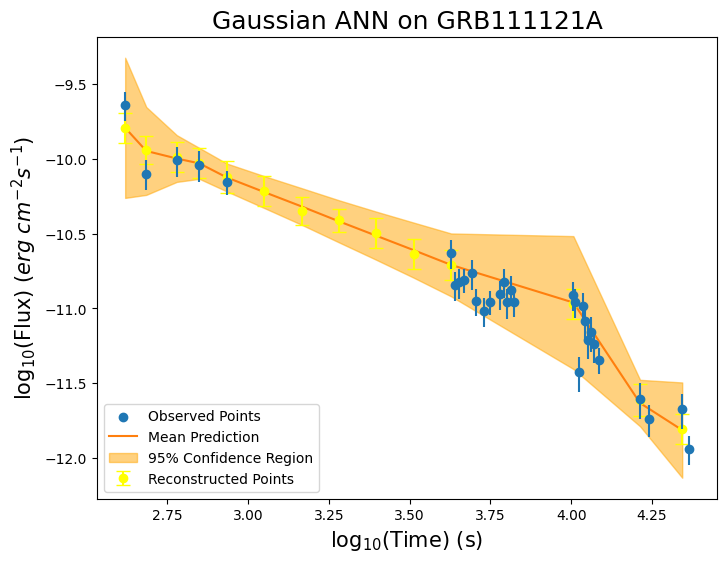


-----TRAINING FOR GRB111129A-----


-----ORIGINAL GRB-----



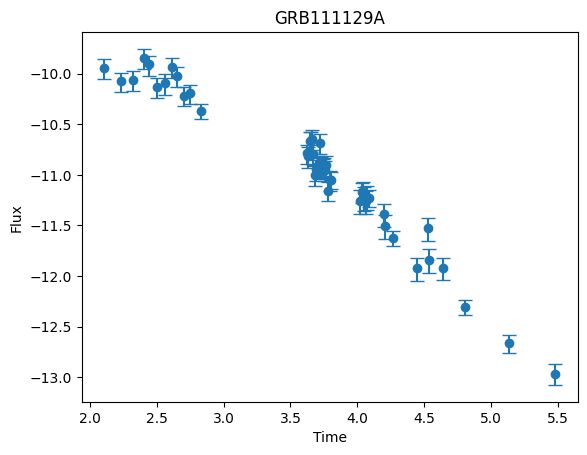


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.3493
Epoch 50, Loss: -0.6856
Epoch 100, Loss: -0.9036
Epoch 150, Loss: -0.9272
Epoch 200, Loss: -0.8060
Epoch 250, Loss: -0.8869
Epoch 300, Loss: -0.8531
Epoch 350, Loss: -0.8477
Epoch 400, Loss: -0.8160
Epoch 450, Loss: -0.9681

-----RECONSTRUCTED GRB-----



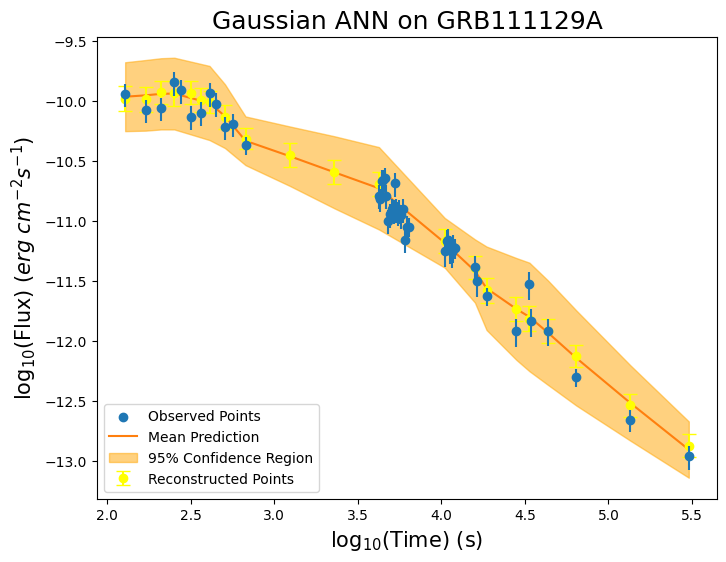


-----TRAINING FOR GRB120102A-----


-----ORIGINAL GRB-----



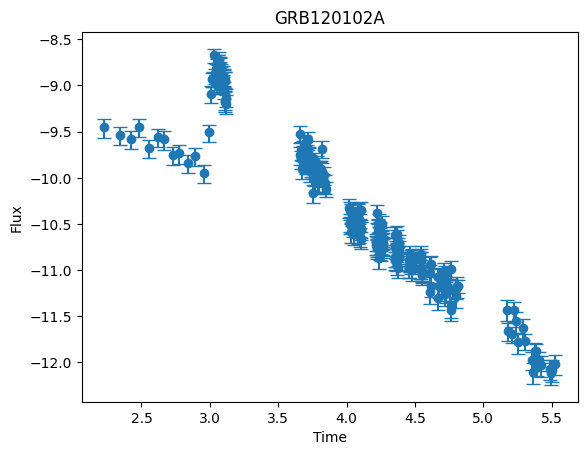


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: -0.0549
Epoch 50, Loss: -0.7945
Epoch 100, Loss: -0.8325
Epoch 150, Loss: -0.8601
Epoch 200, Loss: -0.9207
Epoch 250, Loss: -0.8711
Epoch 300, Loss: -0.5922
Epoch 350, Loss: -0.9199
Epoch 400, Loss: -0.8830
Epoch 450, Loss: -0.9360

-----RECONSTRUCTED GRB-----



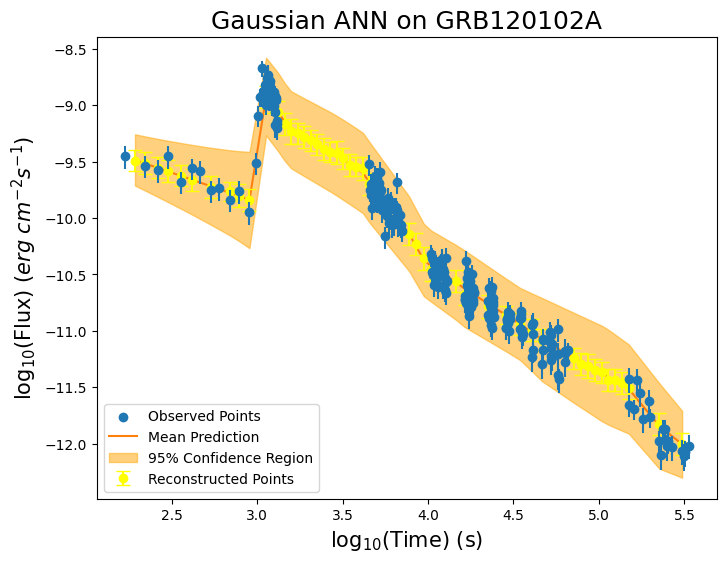


-----TRAINING FOR GRB120116A-----


-----ORIGINAL GRB-----



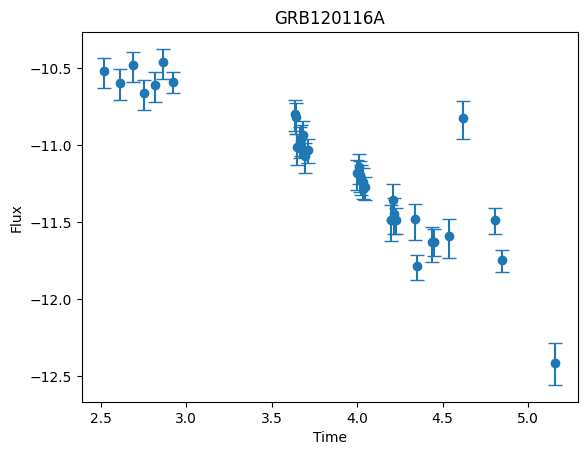


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.3269
Epoch 50, Loss: -0.5088
Epoch 100, Loss: -0.4060
Epoch 150, Loss: -0.1464
Epoch 200, Loss: -0.5067
Epoch 250, Loss: -0.8435
Epoch 300, Loss: 1.8937
Epoch 350, Loss: -0.8804
Epoch 400, Loss: -0.4988
Epoch 450, Loss: -0.6217

-----RECONSTRUCTED GRB-----



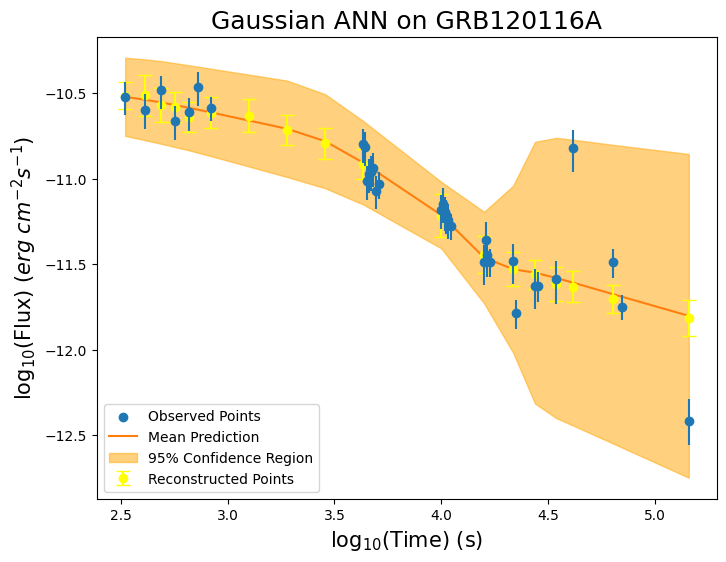


-----TRAINING FOR GRB120119A-----


-----ORIGINAL GRB-----



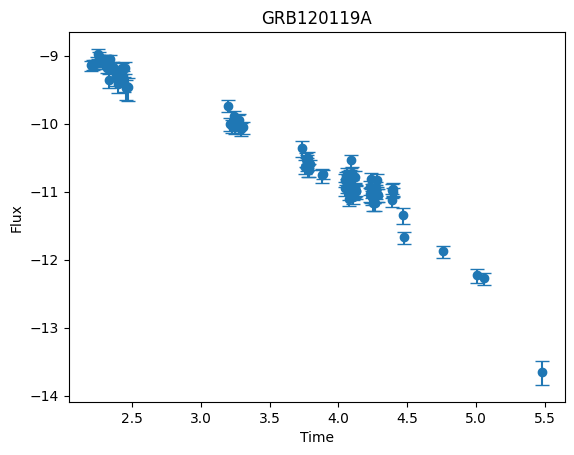


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.2732
Epoch 50, Loss: -0.8154
Epoch 100, Loss: -0.8725
Epoch 150, Loss: -0.8719
Epoch 200, Loss: -0.9635
Epoch 250, Loss: -0.8482
Epoch 300, Loss: -0.9223
Epoch 350, Loss: -0.9838
Epoch 400, Loss: -0.9590
Epoch 450, Loss: -0.8751

-----RECONSTRUCTED GRB-----



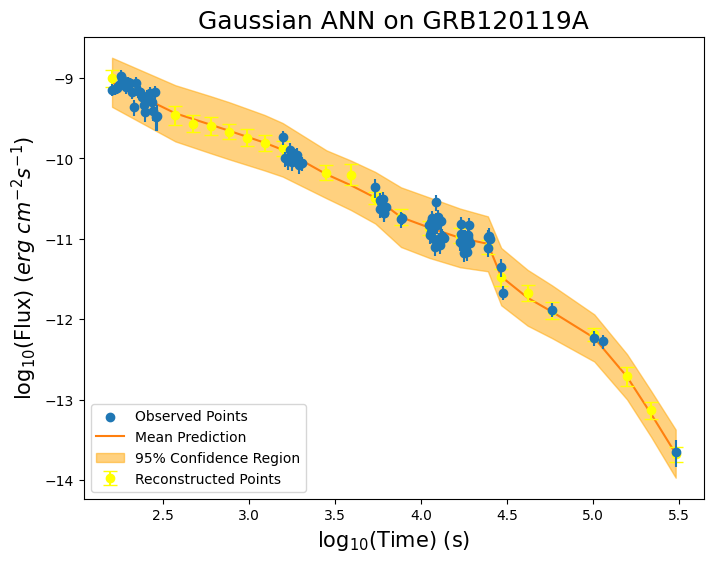


-----TRAINING FOR GRB120211A-----


-----ORIGINAL GRB-----



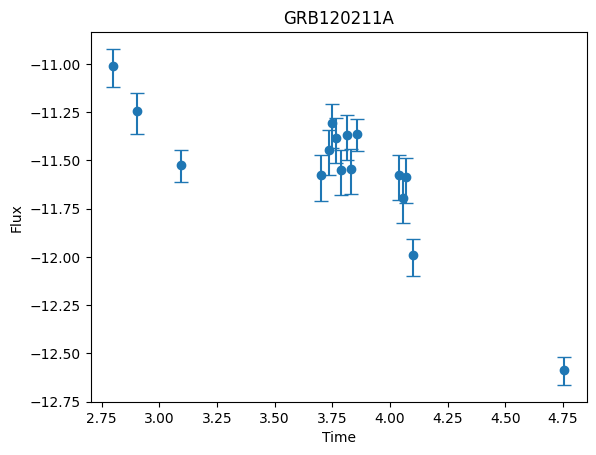


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.4861
Epoch 50, Loss: -0.4360
Epoch 100, Loss: -0.6447
Epoch 150, Loss: -0.6935
Epoch 200, Loss: -0.6994
Epoch 250, Loss: -0.6910
Epoch 300, Loss: -0.6969
Epoch 350, Loss: -0.7003
Epoch 400, Loss: -0.7092
Epoch 450, Loss: -0.6987

-----RECONSTRUCTED GRB-----



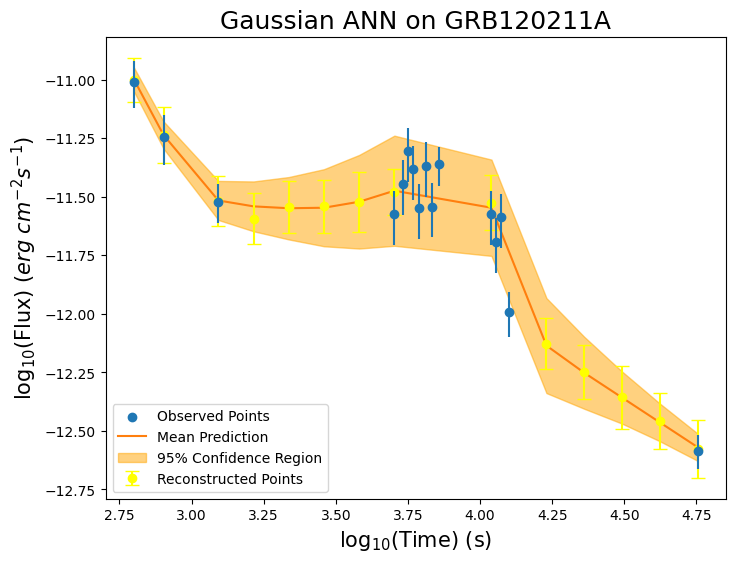


-----TRAINING FOR GRB120213A-----


-----ORIGINAL GRB-----



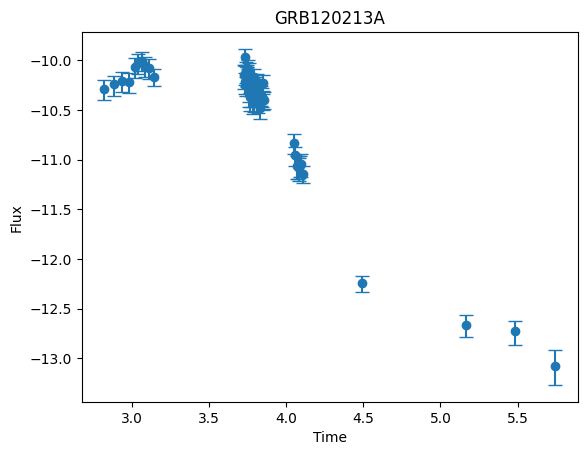


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.4163
Epoch 50, Loss: -0.7976
Epoch 100, Loss: -0.9408
Epoch 150, Loss: -0.9038
Epoch 200, Loss: -0.8744
Epoch 250, Loss: -0.9384
Epoch 300, Loss: -0.9549
Epoch 350, Loss: -0.9042
Epoch 400, Loss: -1.0139
Epoch 450, Loss: -0.9657

-----RECONSTRUCTED GRB-----



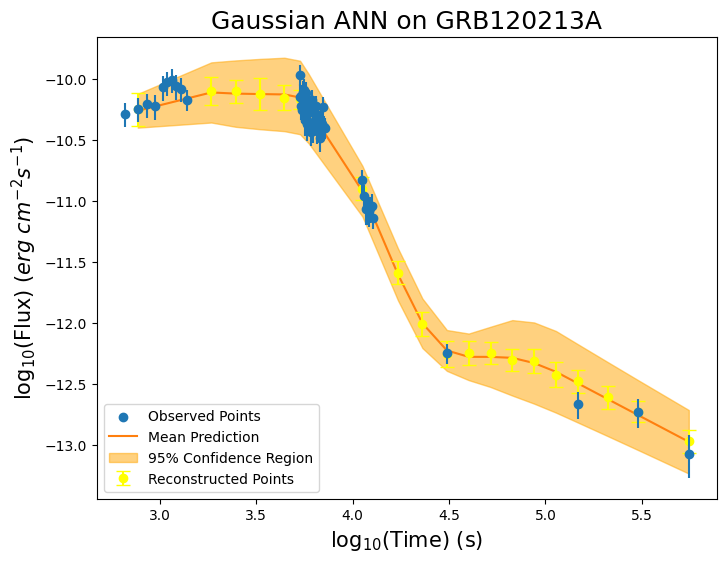


-----TRAINING FOR GRB120215A-----


-----ORIGINAL GRB-----



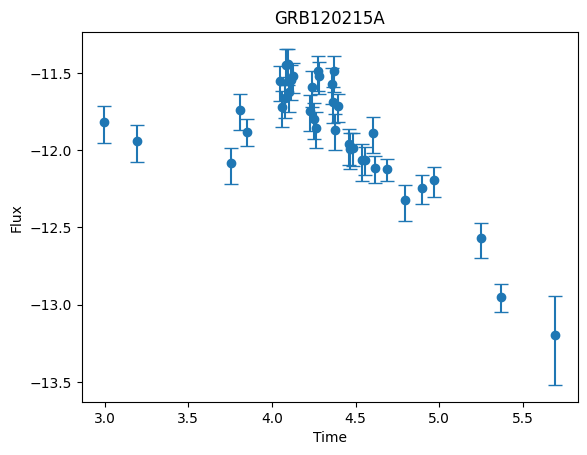


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.6470
Epoch 50, Loss: -0.4517
Epoch 100, Loss: -0.5035
Epoch 150, Loss: -0.4848
Epoch 200, Loss: -0.3715
Epoch 250, Loss: -0.5035
Epoch 300, Loss: -0.5907
Epoch 350, Loss: -0.3584
Epoch 400, Loss: -0.4299
Epoch 450, Loss: -0.6000

-----RECONSTRUCTED GRB-----



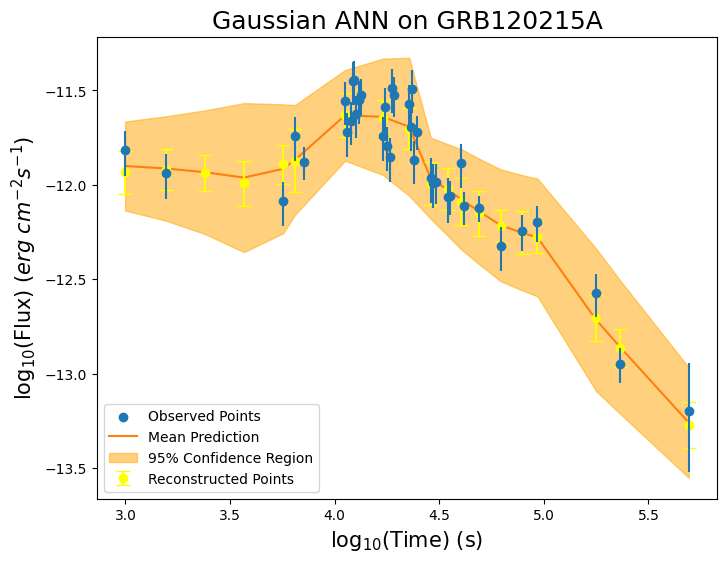


-----TRAINING FOR GRB120224A-----


-----ORIGINAL GRB-----



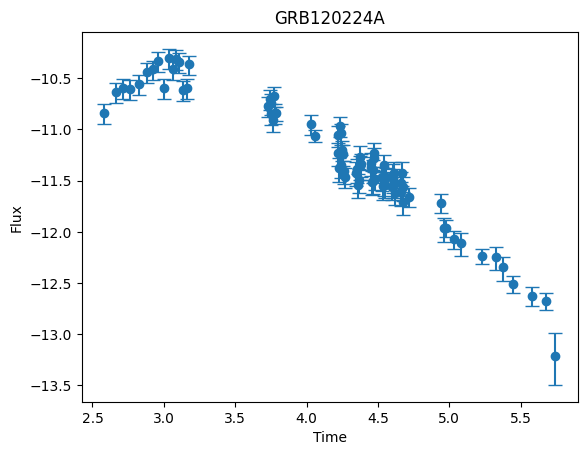


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.3486
Epoch 50, Loss: -0.8174
Epoch 100, Loss: -0.7408
Epoch 150, Loss: -0.6937
Epoch 200, Loss: -0.6223
Epoch 250, Loss: -0.8092
Epoch 300, Loss: -0.6594
Epoch 350, Loss: -0.8474
Epoch 400, Loss: -0.7306
Epoch 450, Loss: -0.8470

-----RECONSTRUCTED GRB-----



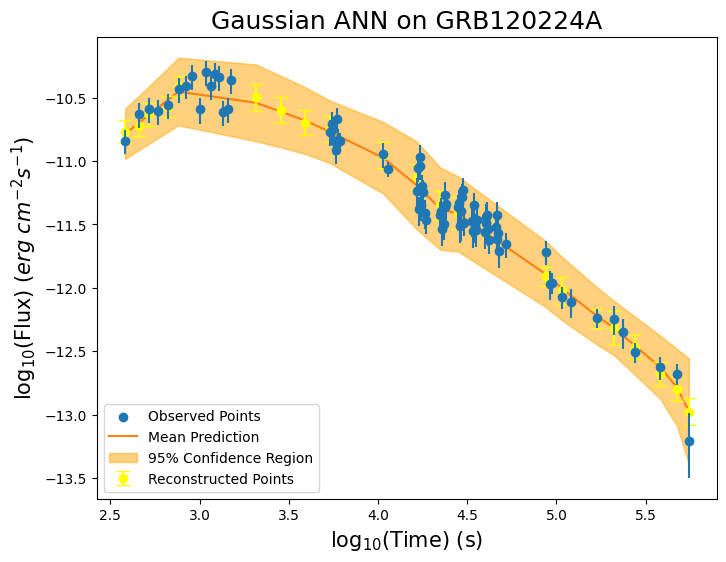


-----TRAINING FOR GRB120308A-----


-----ORIGINAL GRB-----



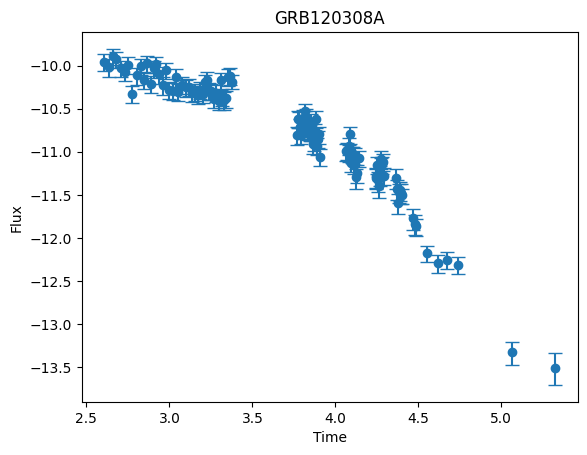


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.0087
Epoch 50, Loss: -0.7609
Epoch 100, Loss: -0.7898
Epoch 150, Loss: -0.6276
Epoch 200, Loss: -0.8807
Epoch 250, Loss: -0.7380
Epoch 300, Loss: -0.8460
Epoch 350, Loss: -0.7764
Epoch 400, Loss: -0.9335
Epoch 450, Loss: -0.9639

-----RECONSTRUCTED GRB-----



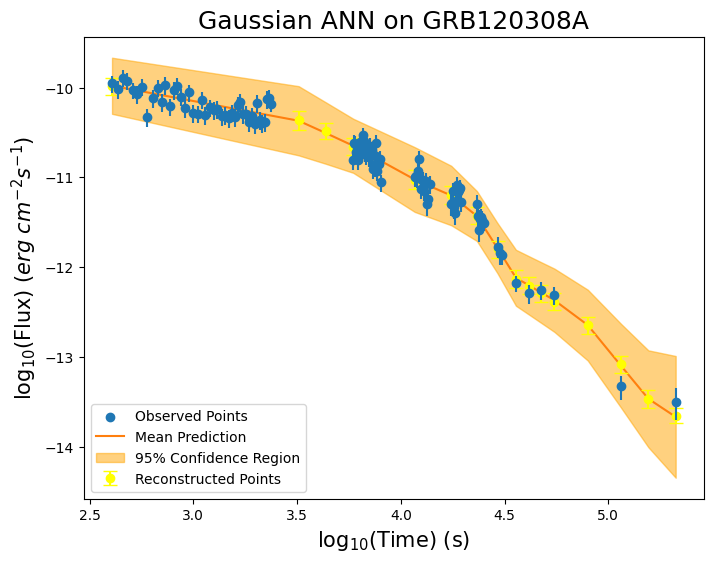


-----TRAINING FOR GRB120324A-----


-----ORIGINAL GRB-----



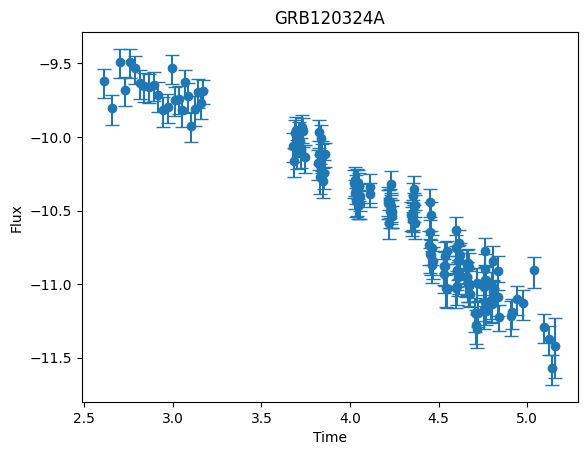


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: -0.0419
Epoch 50, Loss: -0.6812
Epoch 100, Loss: -0.6631
Epoch 150, Loss: -0.6395
Epoch 200, Loss: -0.5906
Epoch 250, Loss: -0.5180
Epoch 300, Loss: -0.7153
Epoch 350, Loss: -0.7648
Epoch 400, Loss: -0.7669
Epoch 450, Loss: -0.6822

-----RECONSTRUCTED GRB-----



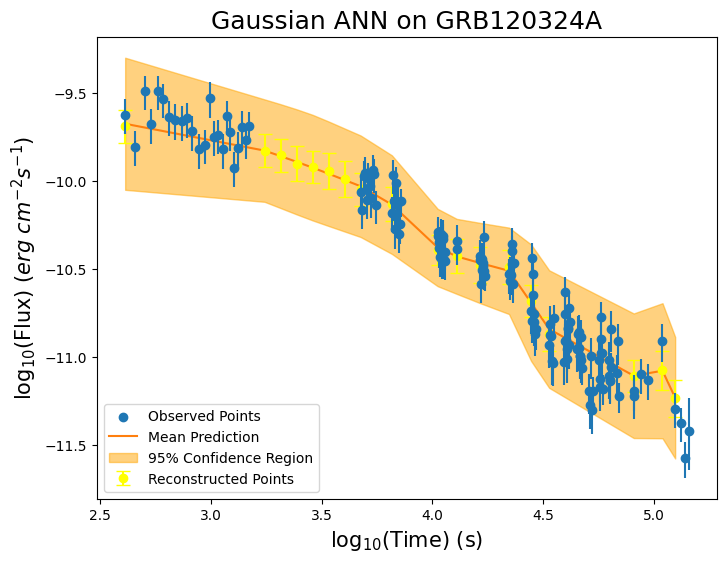


-----TRAINING FOR GRB120326A-----


-----ORIGINAL GRB-----



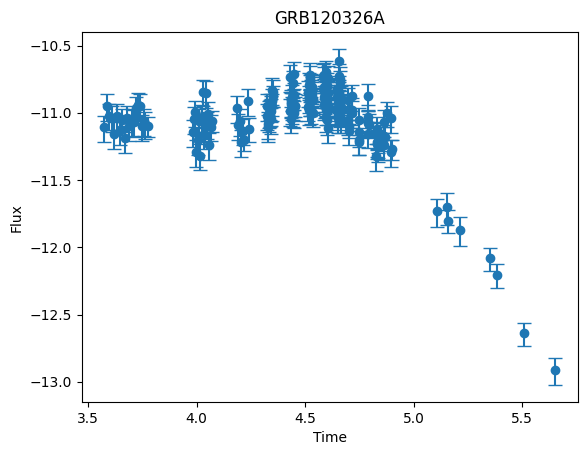


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.0769
Epoch 50, Loss: -0.4821
Epoch 100, Loss: -0.5590
Epoch 150, Loss: -0.6327
Epoch 200, Loss: -0.5424
Epoch 250, Loss: -0.4747
Epoch 300, Loss: -0.6366
Epoch 350, Loss: -0.3992
Epoch 400, Loss: -0.1688
Epoch 450, Loss: -0.6644

-----RECONSTRUCTED GRB-----



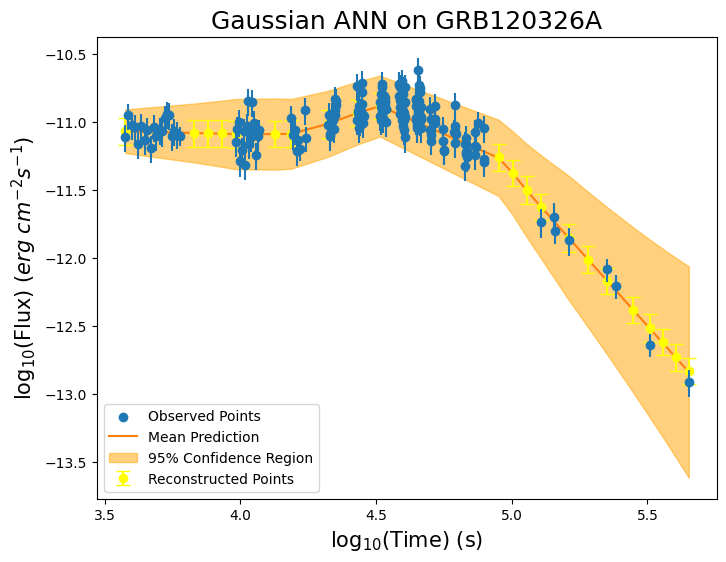


-----TRAINING FOR GRB120701A-----


-----ORIGINAL GRB-----



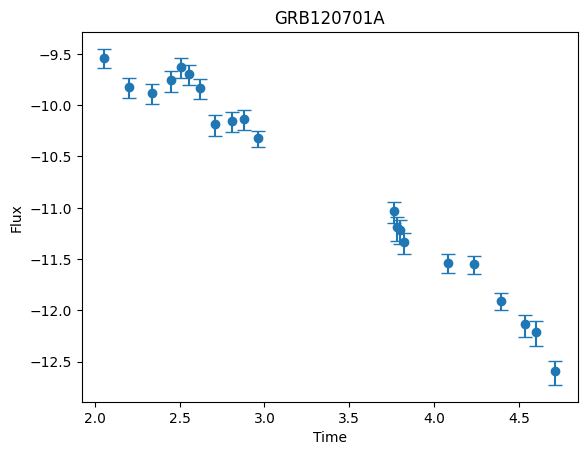


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.4846
Epoch 50, Loss: -0.9087
Epoch 100, Loss: -0.9746
Epoch 150, Loss: -0.9923
Epoch 200, Loss: -0.9977
Epoch 250, Loss: -1.0046
Epoch 300, Loss: -1.0009
Epoch 350, Loss: -1.0254
Epoch 400, Loss: -1.0297
Epoch 450, Loss: -1.0411

-----RECONSTRUCTED GRB-----



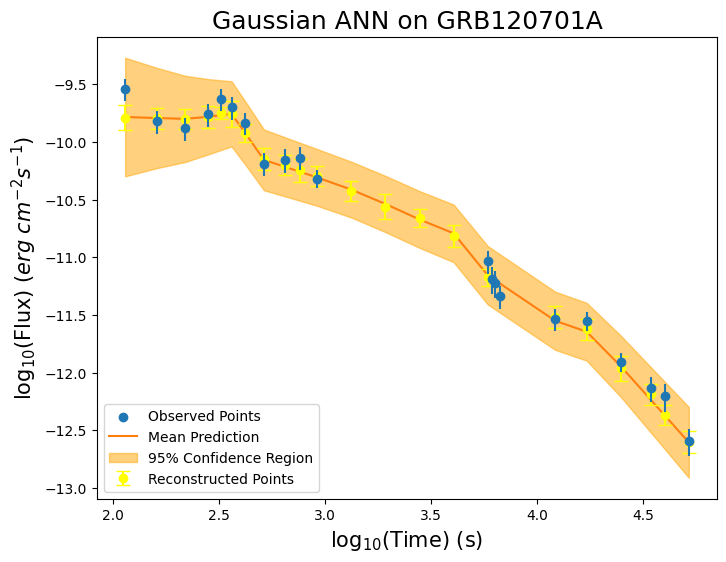


-----TRAINING FOR GRB120703A-----


-----ORIGINAL GRB-----



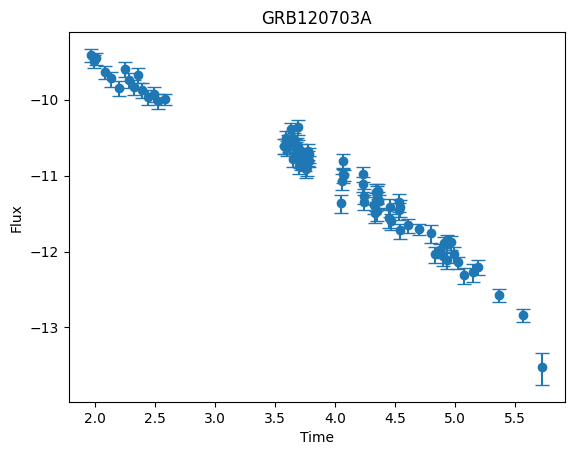


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.5929
Epoch 50, Loss: -0.8169
Epoch 100, Loss: -0.8515
Epoch 150, Loss: -0.8776
Epoch 200, Loss: -0.8284
Epoch 250, Loss: -0.7957
Epoch 300, Loss: -0.8678
Epoch 350, Loss: -0.9291
Epoch 400, Loss: -0.8773
Epoch 450, Loss: -0.8802

-----RECONSTRUCTED GRB-----



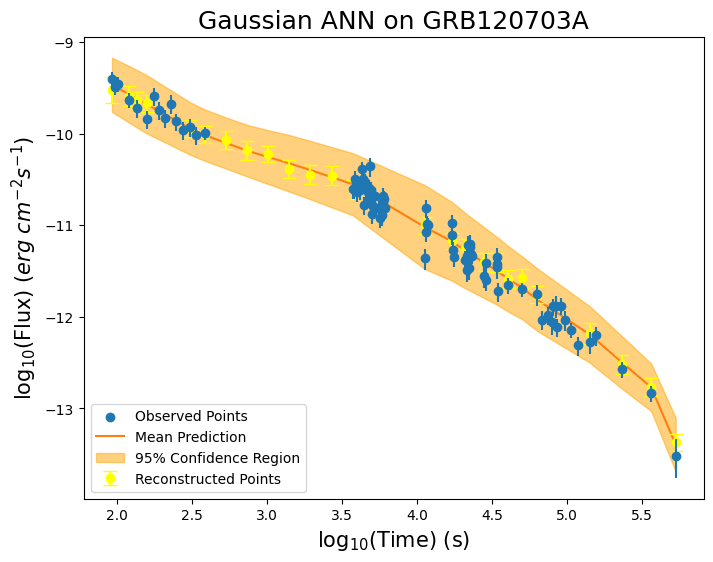


-----TRAINING FOR GRB120728A-----


-----ORIGINAL GRB-----



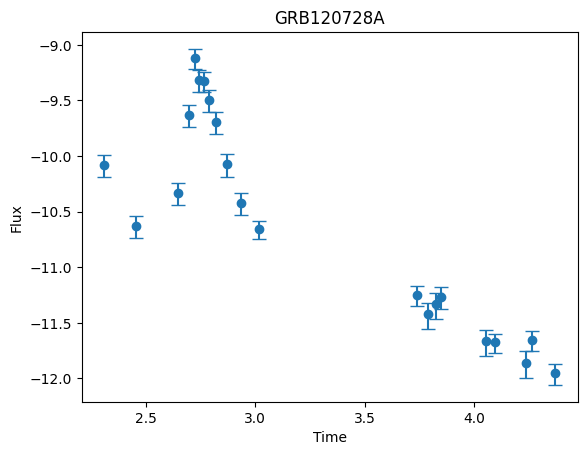


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.5527
Epoch 50, Loss: -0.5426
Epoch 100, Loss: -0.8155
Epoch 150, Loss: -0.8702
Epoch 200, Loss: -0.9147
Epoch 250, Loss: -0.9204
Epoch 300, Loss: -1.0119
Epoch 350, Loss: -0.9981
Epoch 400, Loss: -1.1167
Epoch 450, Loss: -1.0395

-----RECONSTRUCTED GRB-----



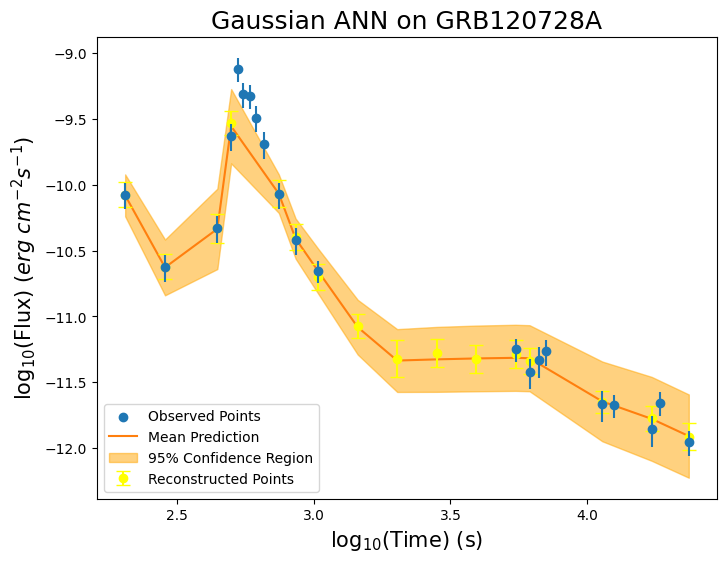


-----TRAINING FOR GRB120927A-----


-----ORIGINAL GRB-----



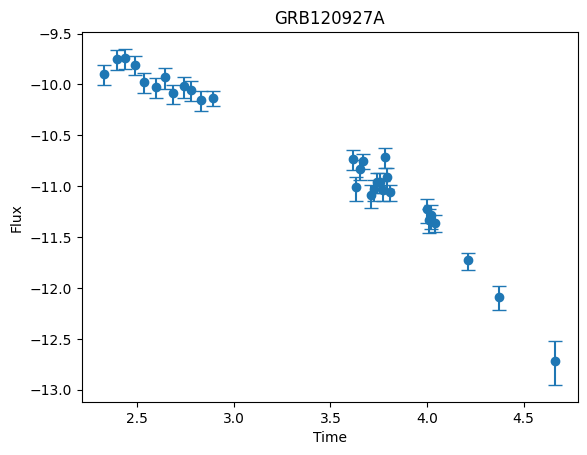


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.5392
Epoch 50, Loss: -0.9207
Epoch 100, Loss: -0.9464
Epoch 150, Loss: -0.9537
Epoch 200, Loss: -0.9690
Epoch 250, Loss: -0.9741
Epoch 300, Loss: -0.9687
Epoch 350, Loss: -0.9806
Epoch 400, Loss: -0.9835
Epoch 450, Loss: -0.9861

-----RECONSTRUCTED GRB-----



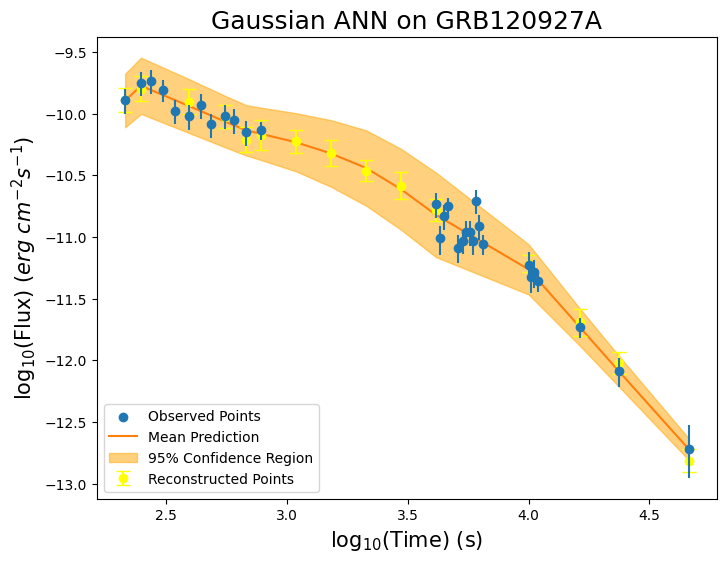


-----TRAINING FOR GRB121123A-----


-----ORIGINAL GRB-----



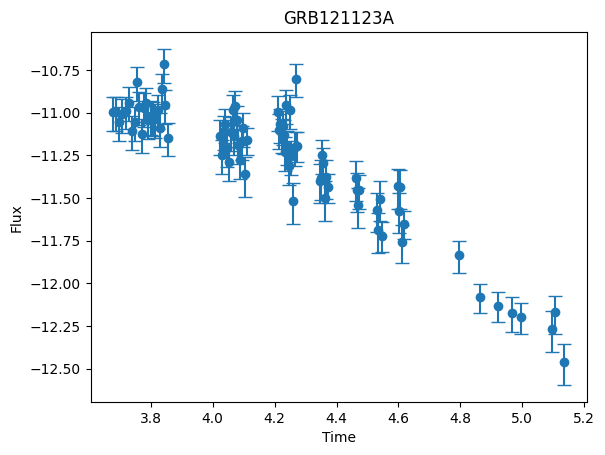


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.2240
Epoch 50, Loss: -0.2828
Epoch 100, Loss: -0.6001
Epoch 150, Loss: -0.4429
Epoch 200, Loss: -0.6098
Epoch 250, Loss: -0.5630
Epoch 300, Loss: -0.4631
Epoch 350, Loss: -0.4916
Epoch 400, Loss: -0.5042
Epoch 450, Loss: -0.6131

-----RECONSTRUCTED GRB-----



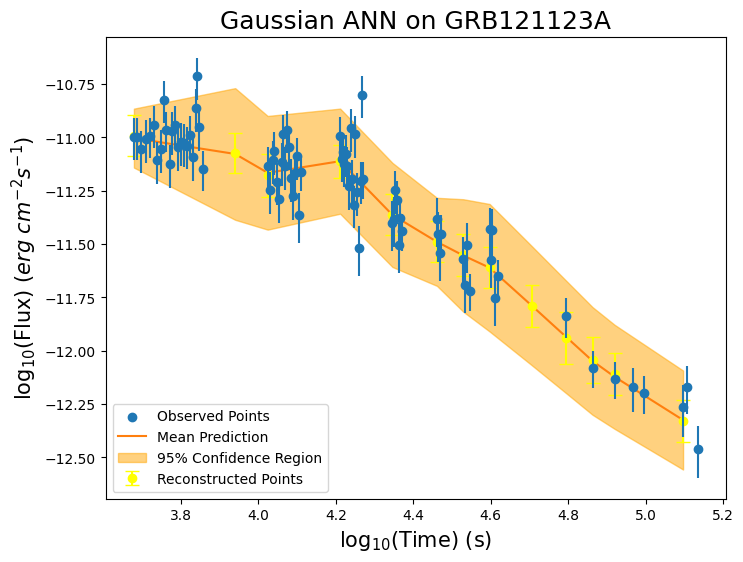


-----TRAINING FOR GRB121209A-----


-----ORIGINAL GRB-----



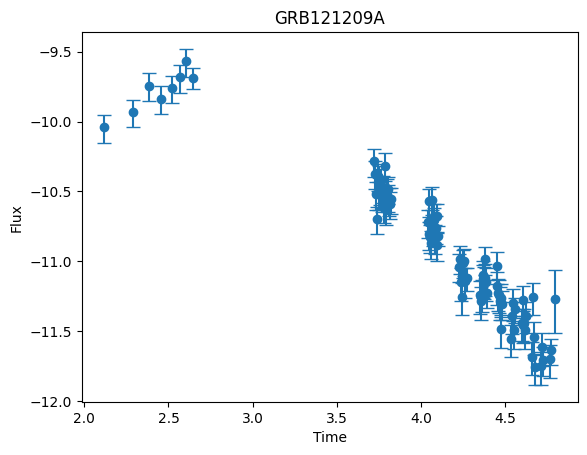


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.0157
Epoch 50, Loss: -0.6359
Epoch 100, Loss: -0.6887
Epoch 150, Loss: -0.5690
Epoch 200, Loss: -0.7616
Epoch 250, Loss: -0.5788
Epoch 300, Loss: -0.7447
Epoch 350, Loss: -0.6764
Epoch 400, Loss: -0.7539
Epoch 450, Loss: -0.6240

-----RECONSTRUCTED GRB-----



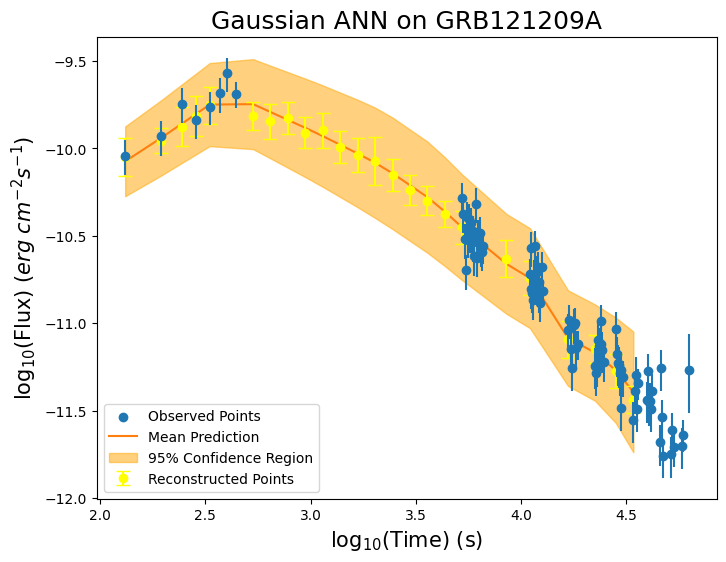


-----TRAINING FOR GRB121217A-----


-----ORIGINAL GRB-----



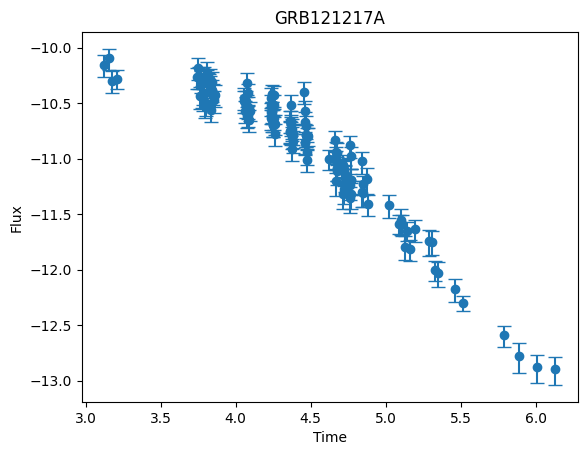


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: -0.0534
Epoch 50, Loss: -0.6787
Epoch 100, Loss: -0.9045
Epoch 150, Loss: 0.2184
Epoch 200, Loss: -0.9326
Epoch 250, Loss: -0.8816
Epoch 300, Loss: -0.7301
Epoch 350, Loss: -0.7005
Epoch 400, Loss: -0.7020
Epoch 450, Loss: -0.8648

-----RECONSTRUCTED GRB-----



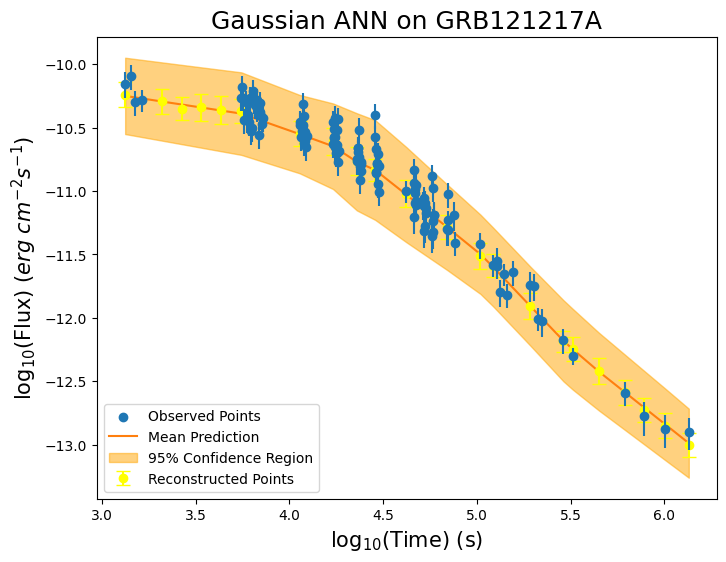


-----TRAINING FOR GRB130131A-----


-----ORIGINAL GRB-----



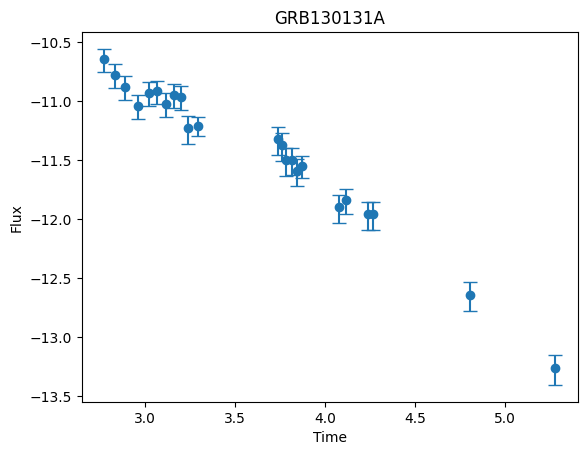


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.5159
Epoch 50, Loss: -0.9005
Epoch 100, Loss: -1.0112
Epoch 150, Loss: -1.0390
Epoch 200, Loss: -1.0589
Epoch 250, Loss: -1.0693
Epoch 300, Loss: -1.0556
Epoch 350, Loss: -1.1021
Epoch 400, Loss: -1.1215
Epoch 450, Loss: -1.1222

-----RECONSTRUCTED GRB-----



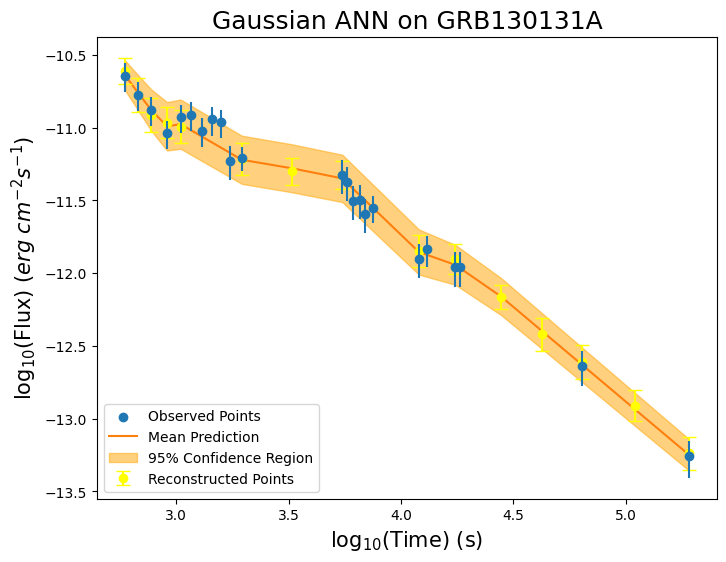


-----TRAINING FOR GRB130211A-----


-----ORIGINAL GRB-----



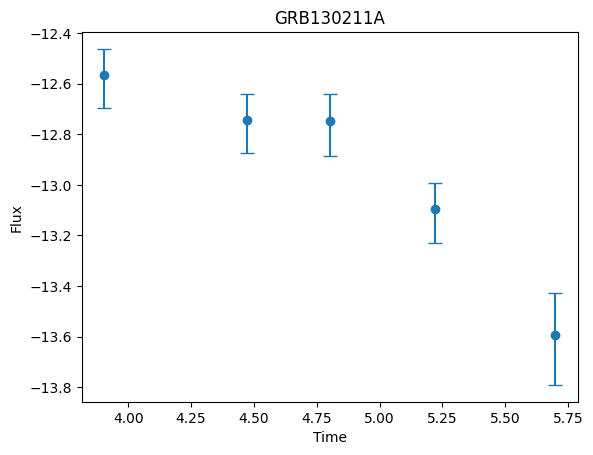


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.5877
Epoch 50, Loss: -1.2147
Epoch 100, Loss: -1.2475
Epoch 150, Loss: -1.2473
Epoch 200, Loss: -1.2250
Epoch 250, Loss: -1.2465
Epoch 300, Loss: -1.2498
Epoch 350, Loss: -1.2499
Epoch 400, Loss: -1.2499
Epoch 450, Loss: -1.2469

-----RECONSTRUCTED GRB-----



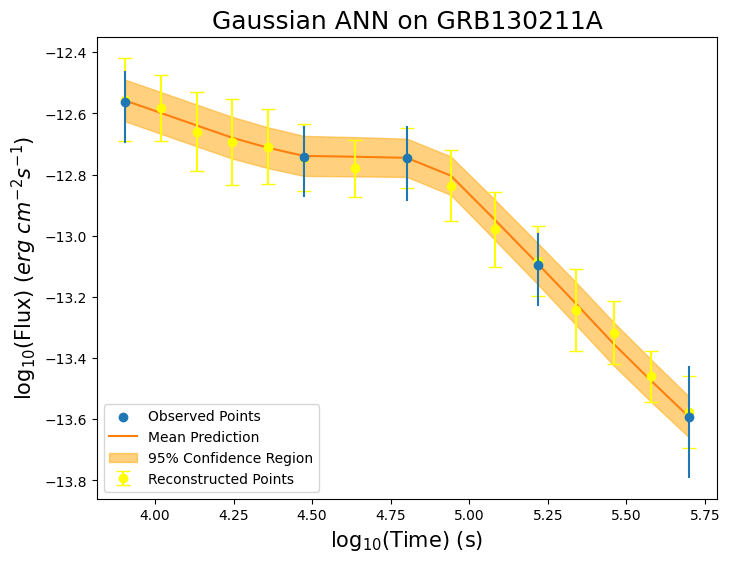


-----TRAINING FOR GRB130427B-----


-----ORIGINAL GRB-----



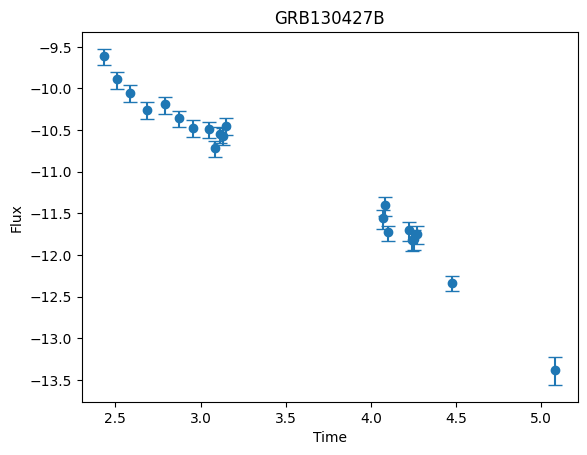


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.6216
Epoch 50, Loss: -0.9818
Epoch 100, Loss: -1.0139
Epoch 150, Loss: -1.0333
Epoch 200, Loss: -1.0395
Epoch 250, Loss: -1.0431
Epoch 300, Loss: -1.0415
Epoch 350, Loss: -1.0501
Epoch 400, Loss: -1.0448
Epoch 450, Loss: -1.0534

-----RECONSTRUCTED GRB-----



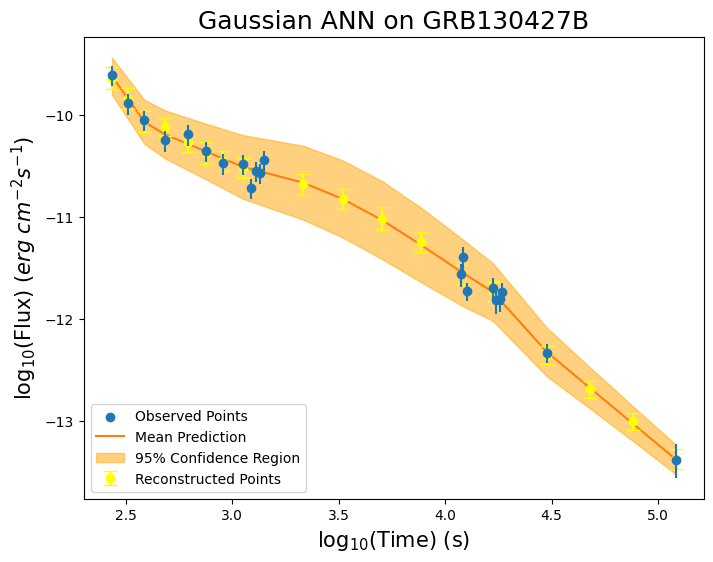


-----TRAINING FOR GRB130504A-----


-----ORIGINAL GRB-----



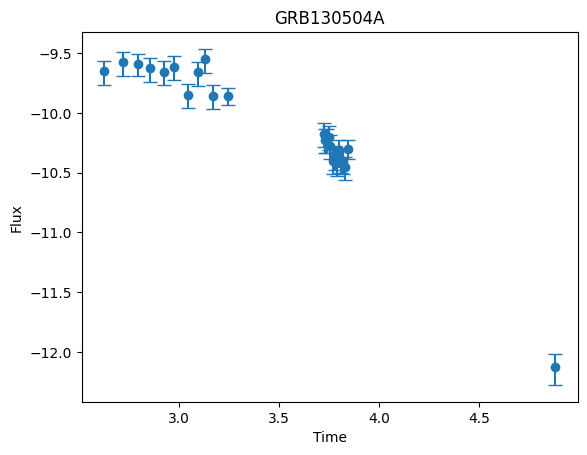


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.5828
Epoch 50, Loss: -0.8675
Epoch 100, Loss: -0.8924
Epoch 150, Loss: -0.9064
Epoch 200, Loss: -0.9185
Epoch 250, Loss: -0.9239
Epoch 300, Loss: -0.9405
Epoch 350, Loss: -0.9591
Epoch 400, Loss: -0.9602
Epoch 450, Loss: -0.9794

-----RECONSTRUCTED GRB-----



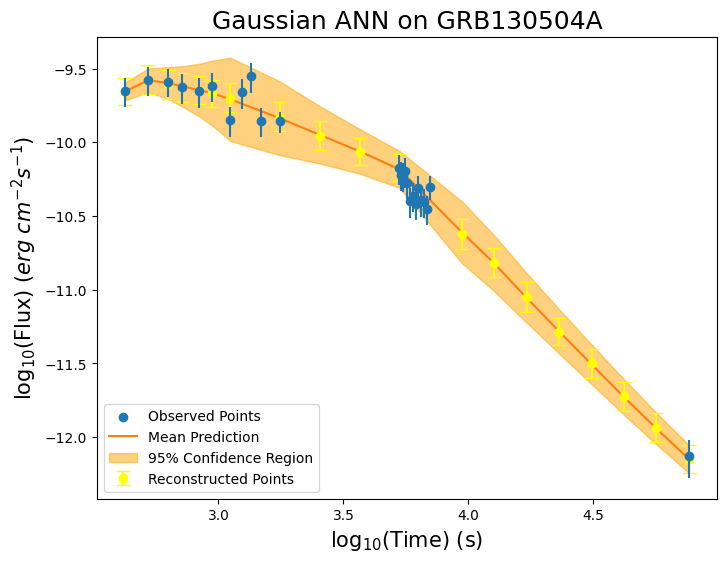


-----TRAINING FOR GRB130527A-----


-----ORIGINAL GRB-----



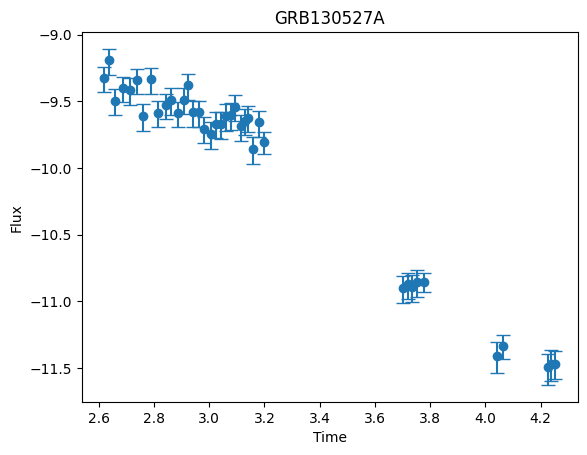


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.0913
Epoch 50, Loss: -0.9353
Epoch 100, Loss: -0.8707
Epoch 150, Loss: -0.8517
Epoch 200, Loss: -0.8055
Epoch 250, Loss: -0.9261
Epoch 300, Loss: -0.7344
Epoch 350, Loss: -0.9993
Epoch 400, Loss: -0.9482
Epoch 450, Loss: -0.9716

-----RECONSTRUCTED GRB-----



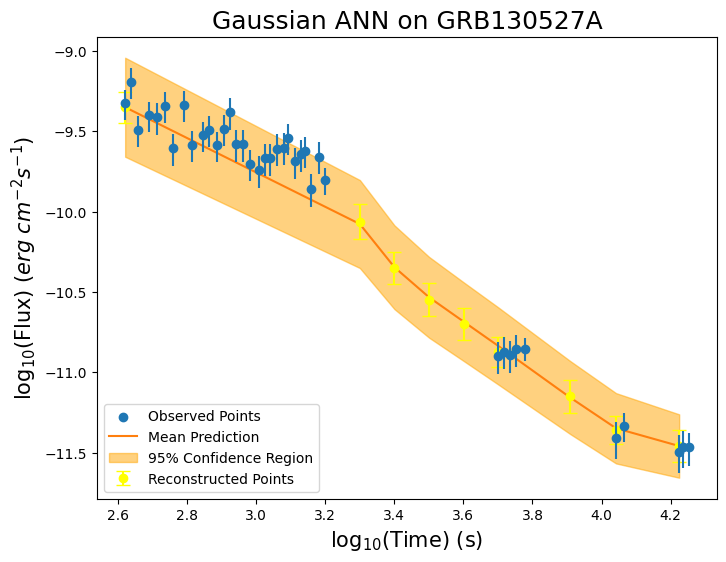


-----TRAINING FOR GRB130528A-----


-----ORIGINAL GRB-----



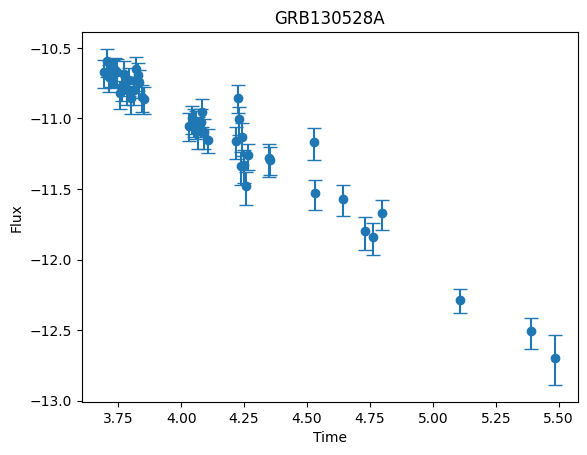


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.5714
Epoch 50, Loss: -0.7764
Epoch 100, Loss: -0.5997
Epoch 150, Loss: -0.7611
Epoch 200, Loss: -0.6569
Epoch 250, Loss: -0.7761
Epoch 300, Loss: -0.6979
Epoch 350, Loss: -0.7418
Epoch 400, Loss: -0.7323
Epoch 450, Loss: -0.7593

-----RECONSTRUCTED GRB-----



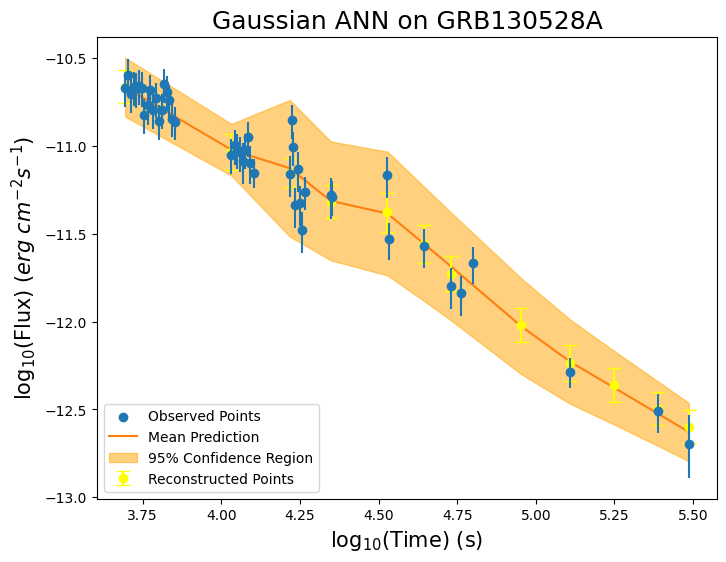


-----TRAINING FOR GRB130603A-----


-----ORIGINAL GRB-----



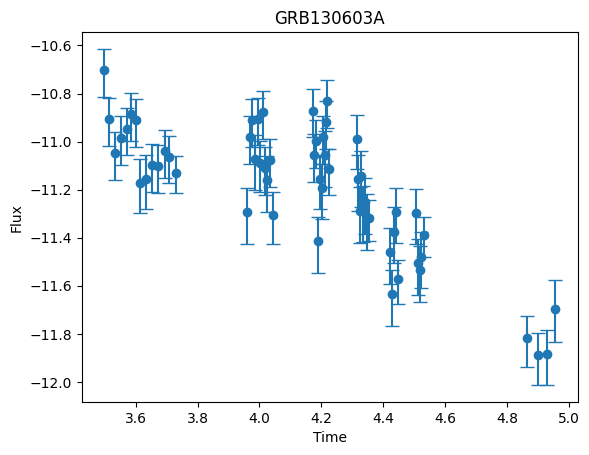


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.4213
Epoch 50, Loss: -0.1172
Epoch 100, Loss: -0.0356
Epoch 150, Loss: -0.1441
Epoch 200, Loss: 0.0085
Epoch 250, Loss: -0.2592
Epoch 300, Loss: -0.2238
Epoch 350, Loss: -0.1573
Epoch 400, Loss: -0.1788
Epoch 450, Loss: -0.3080

-----RECONSTRUCTED GRB-----



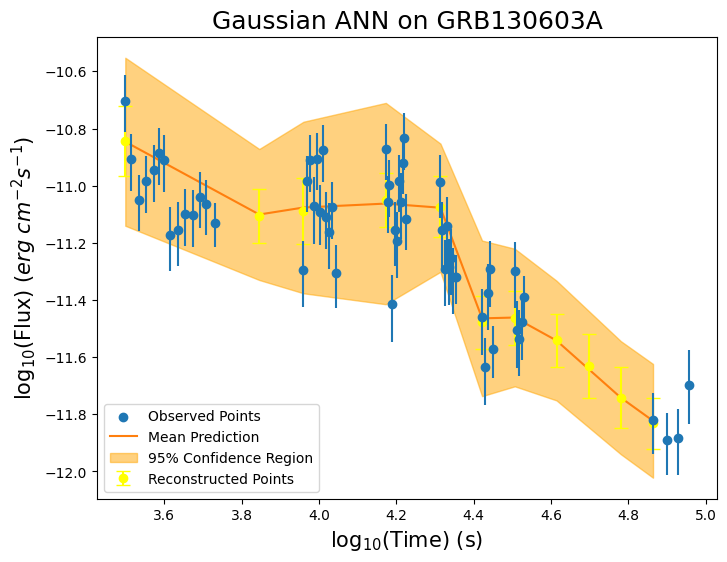


-----TRAINING FOR GRB130608A-----


-----ORIGINAL GRB-----



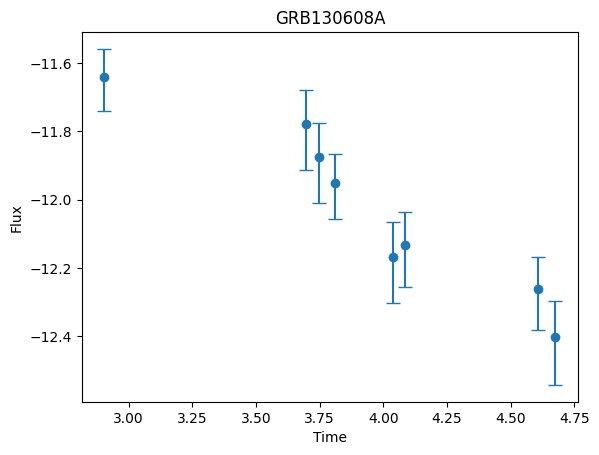


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.5515
Epoch 50, Loss: -0.8923
Epoch 100, Loss: -0.9888
Epoch 150, Loss: -1.0689
Epoch 200, Loss: -0.8940
Epoch 250, Loss: -1.1804
Epoch 300, Loss: -0.9174
Epoch 350, Loss: -1.2182
Epoch 400, Loss: -1.2426
Epoch 450, Loss: -1.2282

-----RECONSTRUCTED GRB-----



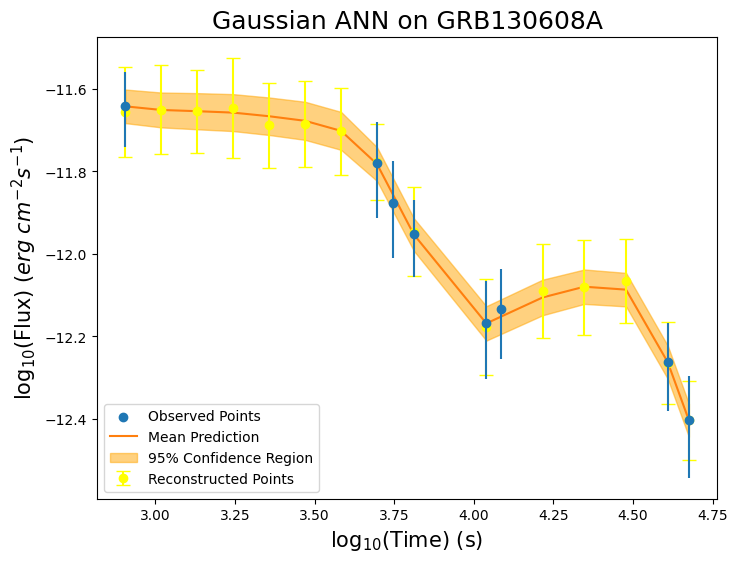


-----TRAINING FOR GRB130609B-----


-----ORIGINAL GRB-----



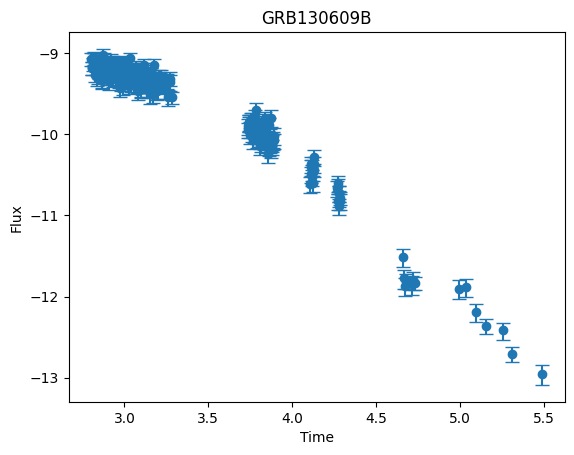


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.0053
Epoch 50, Loss: -0.8837
Epoch 100, Loss: -0.8969
Epoch 150, Loss: -0.8406
Epoch 200, Loss: -0.9347
Epoch 250, Loss: -0.8905
Epoch 300, Loss: -0.4694
Epoch 350, Loss: -0.8798
Epoch 400, Loss: -0.9561
Epoch 450, Loss: -0.8621

-----RECONSTRUCTED GRB-----



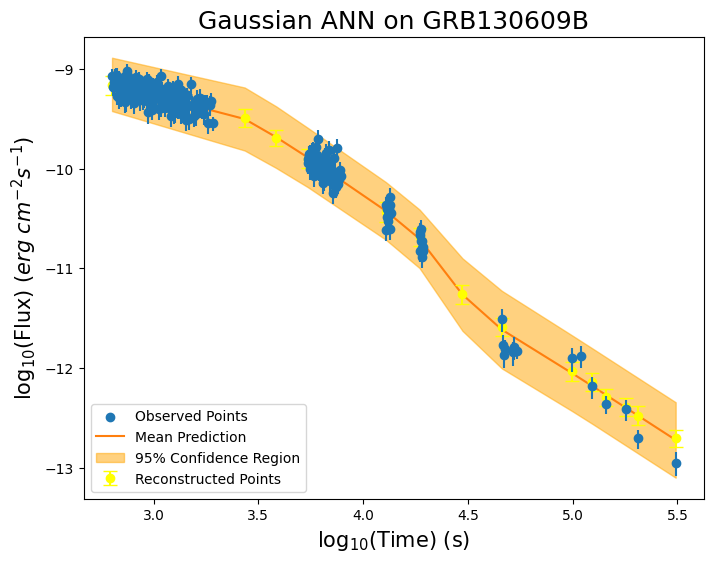


-----TRAINING FOR GRB130725B-----


-----ORIGINAL GRB-----



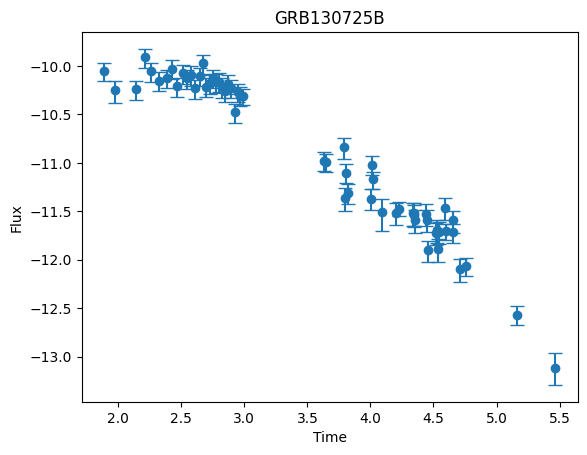


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.4087
Epoch 50, Loss: -0.7570
Epoch 100, Loss: -0.8829
Epoch 150, Loss: -0.8061
Epoch 200, Loss: -0.8477
Epoch 250, Loss: -0.8367
Epoch 300, Loss: -0.8817
Epoch 350, Loss: -0.8119
Epoch 400, Loss: -0.8624
Epoch 450, Loss: -0.8244

-----RECONSTRUCTED GRB-----



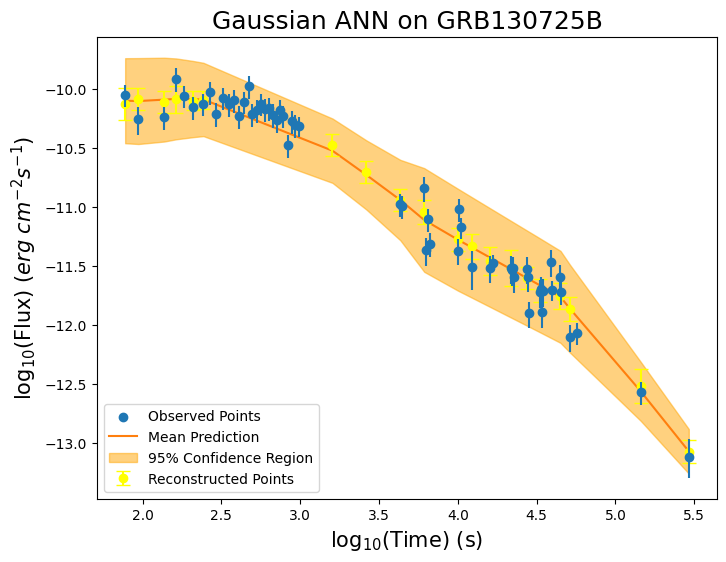


-----TRAINING FOR GRB130812A-----


-----ORIGINAL GRB-----



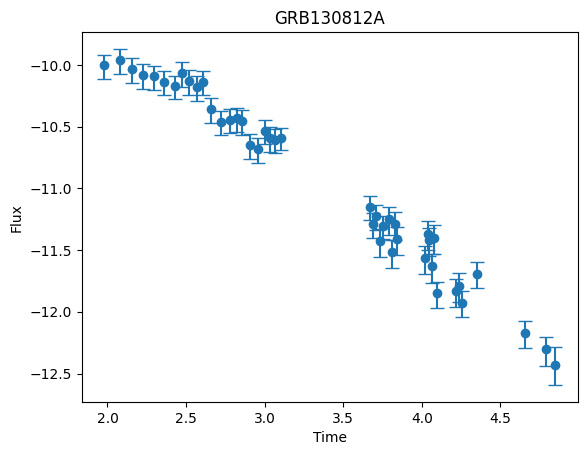


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.4476
Epoch 50, Loss: -0.8947
Epoch 100, Loss: -0.8093
Epoch 150, Loss: -0.8003
Epoch 200, Loss: -0.9799
Epoch 250, Loss: -0.9681
Epoch 300, Loss: -0.9521
Epoch 350, Loss: -0.9200
Epoch 400, Loss: -0.8342
Epoch 450, Loss: -0.9538

-----RECONSTRUCTED GRB-----



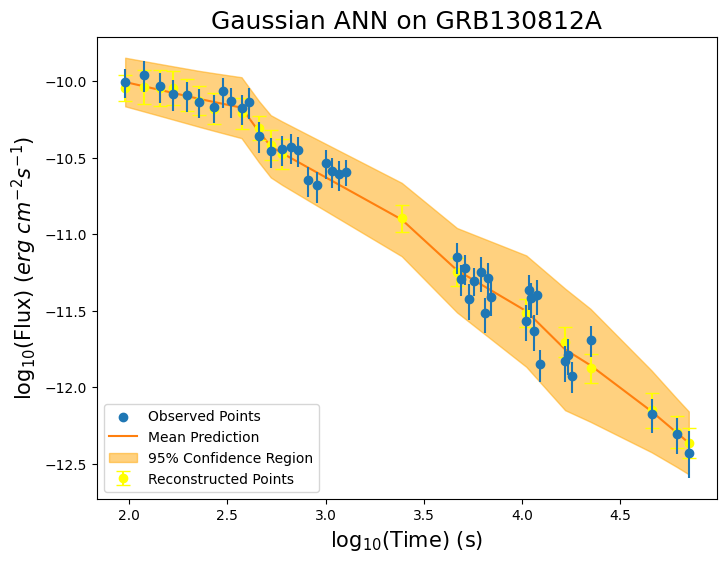


-----TRAINING FOR GRB130816A-----


-----ORIGINAL GRB-----



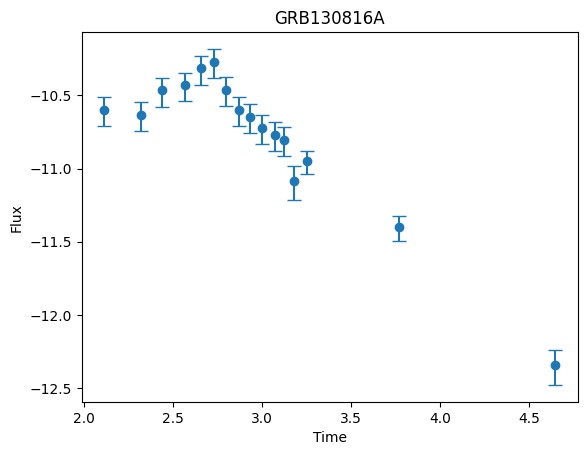


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.3976
Epoch 50, Loss: -0.8867
Epoch 100, Loss: -0.9782
Epoch 150, Loss: -1.0024
Epoch 200, Loss: -0.9916
Epoch 250, Loss: -1.0069
Epoch 300, Loss: -1.0062
Epoch 350, Loss: -1.0461
Epoch 400, Loss: -1.0814
Epoch 450, Loss: -1.0763

-----RECONSTRUCTED GRB-----



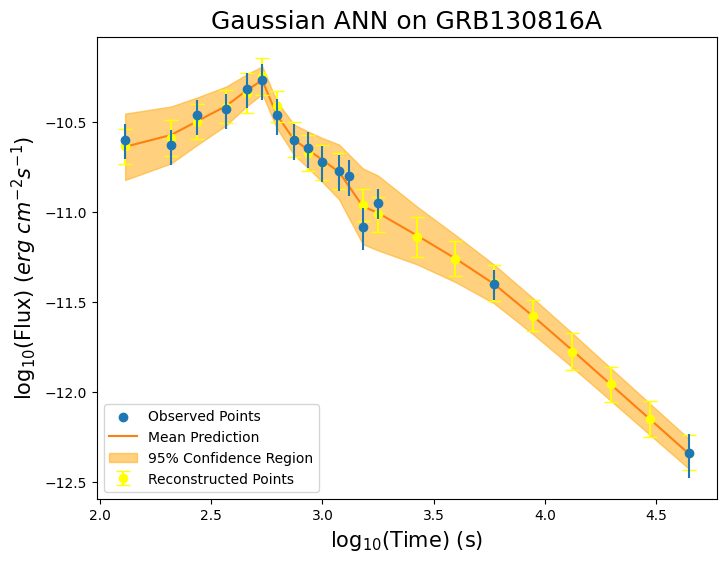


-----TRAINING FOR GRB131002A-----


-----ORIGINAL GRB-----



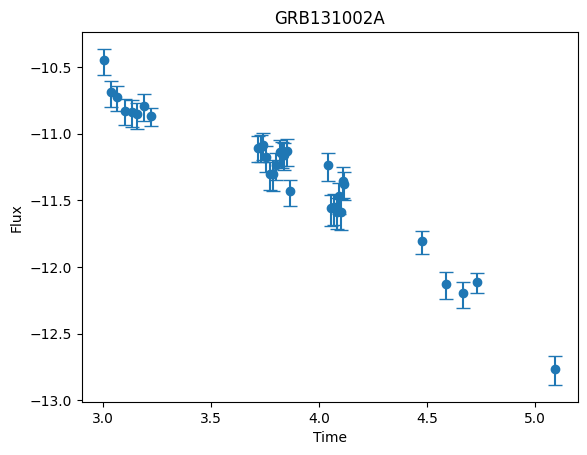


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.0554
Epoch 50, Loss: -0.5233
Epoch 100, Loss: -0.4359
Epoch 150, Loss: -0.9002
Epoch 200, Loss: -0.8645
Epoch 250, Loss: -0.9305
Epoch 300, Loss: -0.7192
Epoch 350, Loss: -0.8229
Epoch 400, Loss: -0.7966
Epoch 450, Loss: -0.7953

-----RECONSTRUCTED GRB-----



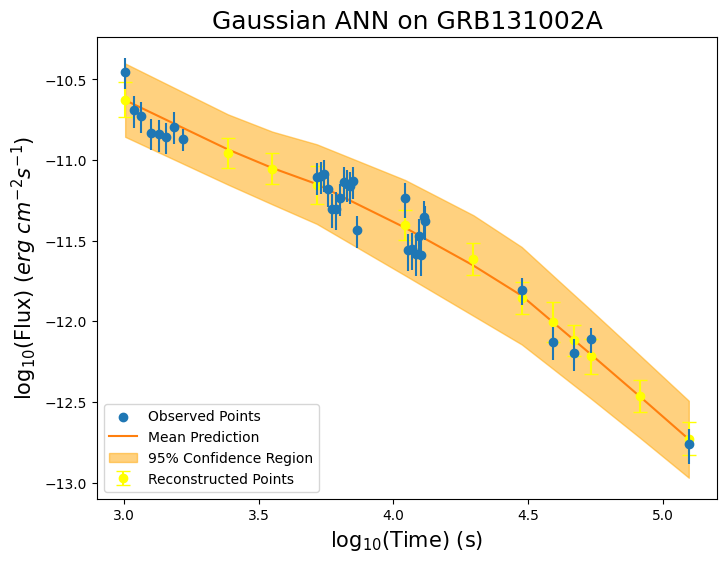


-----TRAINING FOR GRB131002B-----


-----ORIGINAL GRB-----



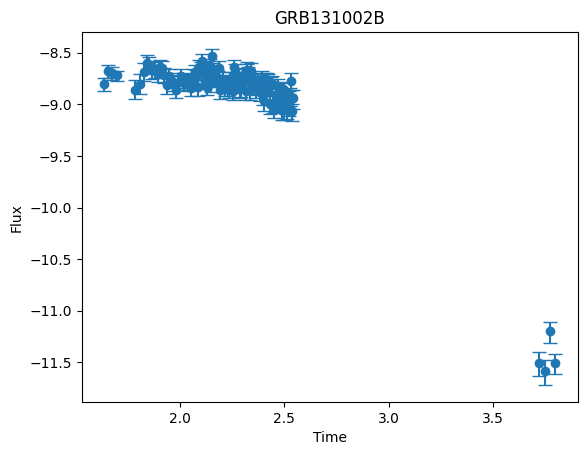


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.1228
Epoch 50, Loss: -0.8113
Epoch 100, Loss: -0.8627
Epoch 150, Loss: -0.7463
Epoch 200, Loss: -0.8431
Epoch 250, Loss: -0.8008
Epoch 300, Loss: -0.7120
Epoch 350, Loss: -0.9394
Epoch 400, Loss: -0.7988
Epoch 450, Loss: -0.8319

-----RECONSTRUCTED GRB-----



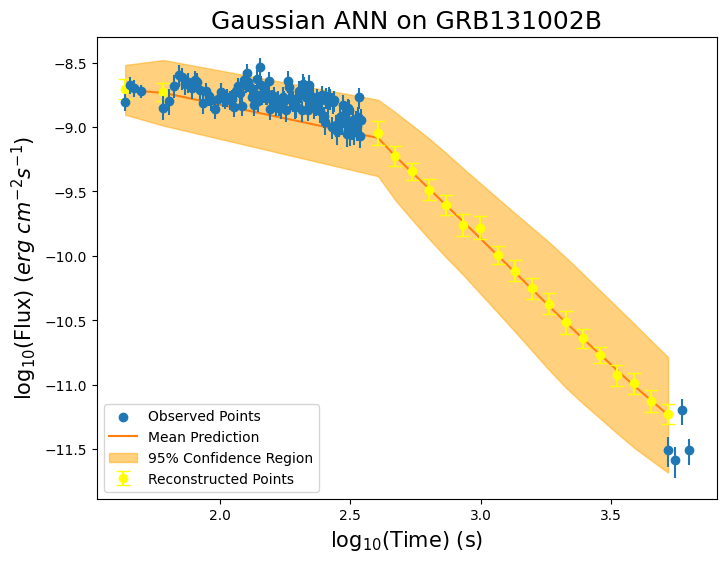


-----TRAINING FOR GRB131018A-----


-----ORIGINAL GRB-----



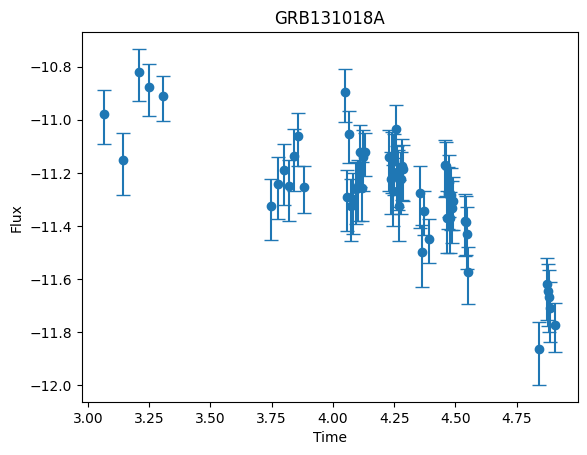


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.4300
Epoch 50, Loss: -0.1362
Epoch 100, Loss: -0.1500
Epoch 150, Loss: -0.2780
Epoch 200, Loss: -0.2596
Epoch 250, Loss: -0.2651
Epoch 300, Loss: -0.2039
Epoch 350, Loss: -0.2746
Epoch 400, Loss: -0.3647
Epoch 450, Loss: -0.3198

-----RECONSTRUCTED GRB-----



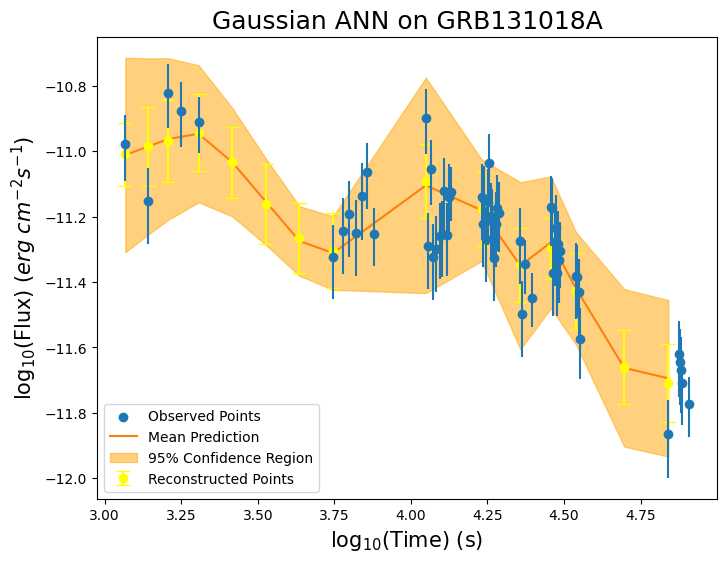


-----TRAINING FOR GRB131024A-----


-----ORIGINAL GRB-----



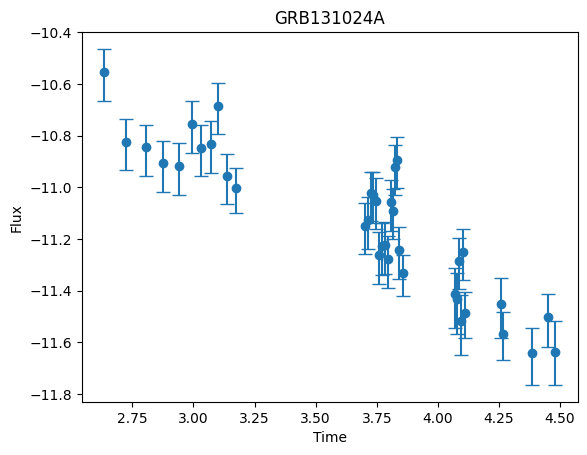


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.5396
Epoch 50, Loss: -0.1302
Epoch 100, Loss: -0.3475
Epoch 150, Loss: -0.4348
Epoch 200, Loss: -0.2138
Epoch 250, Loss: -0.2853
Epoch 300, Loss: -0.3172
Epoch 350, Loss: -0.3281
Epoch 400, Loss: -0.2067
Epoch 450, Loss: -0.1931

-----RECONSTRUCTED GRB-----



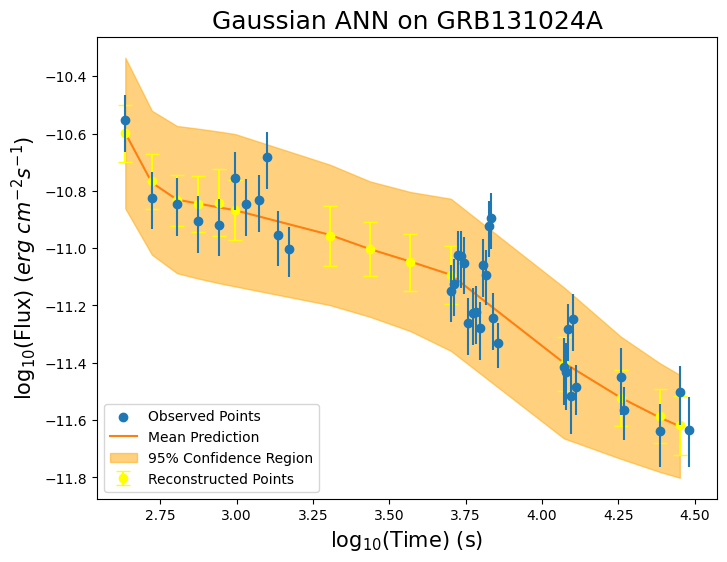


-----TRAINING FOR GRB131229A-----


-----ORIGINAL GRB-----



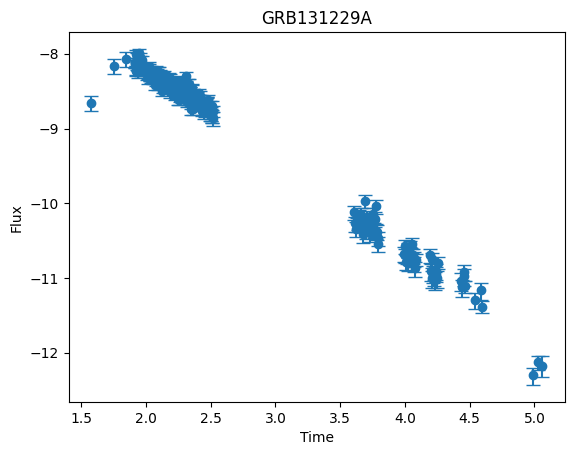


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: -0.1790
Epoch 50, Loss: -1.0384
Epoch 100, Loss: -1.0510
Epoch 150, Loss: -0.8333
Epoch 200, Loss: -1.1028
Epoch 250, Loss: -0.9918
Epoch 300, Loss: -0.9908
Epoch 350, Loss: -1.0806
Epoch 400, Loss: -1.0811
Epoch 450, Loss: -0.9192

-----RECONSTRUCTED GRB-----



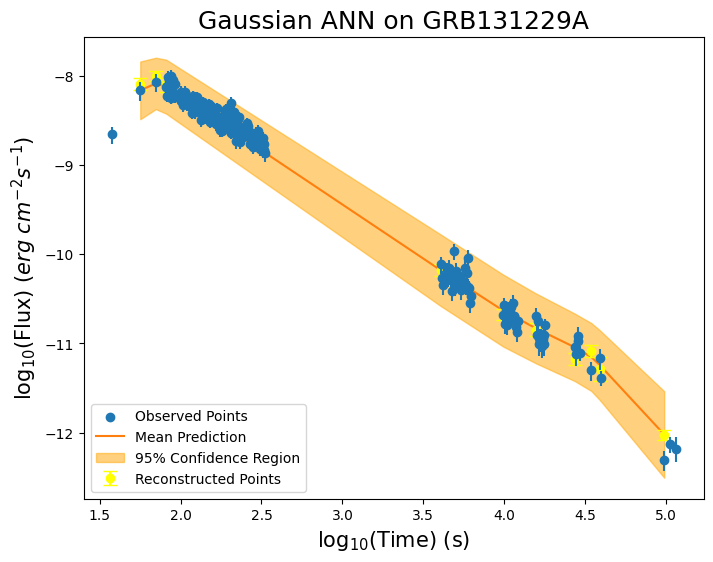


-----TRAINING FOR GRB140108A-----


-----ORIGINAL GRB-----



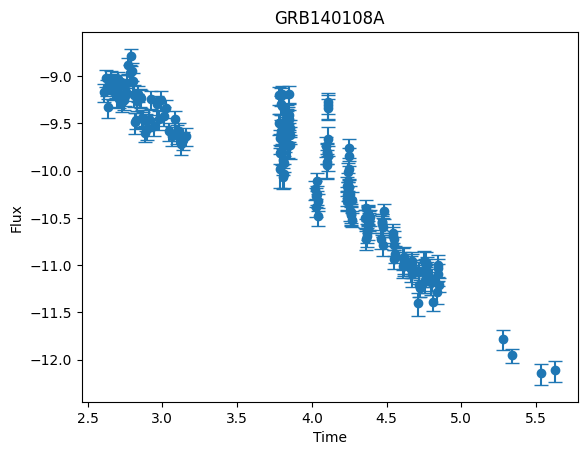


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.1727
Epoch 50, Loss: -0.6255
Epoch 100, Loss: -0.6476
Epoch 150, Loss: -0.7143
Epoch 200, Loss: -0.5791
Epoch 250, Loss: -0.5811
Epoch 300, Loss: -0.6665
Epoch 350, Loss: -0.5841
Epoch 400, Loss: -0.6225
Epoch 450, Loss: -0.4188

-----RECONSTRUCTED GRB-----



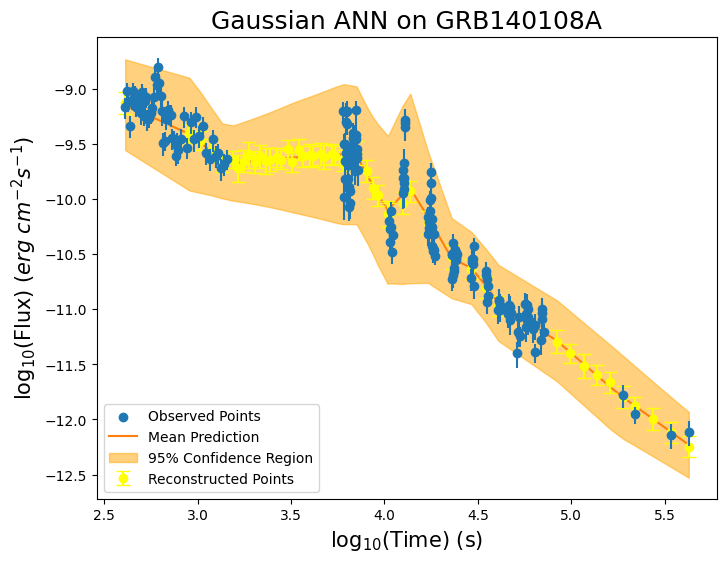


-----TRAINING FOR GRB140114A-----


-----ORIGINAL GRB-----



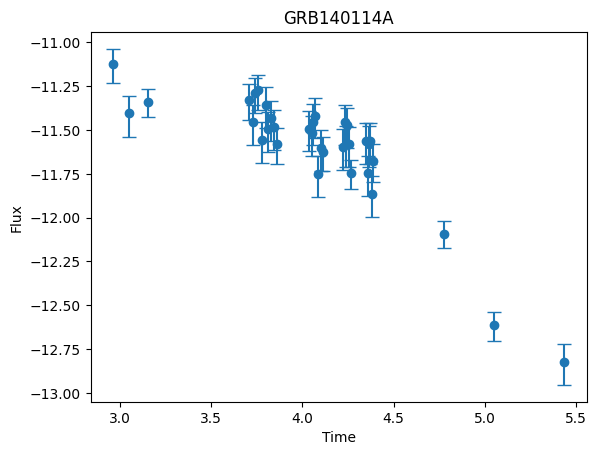


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.1115
Epoch 50, Loss: -0.3503
Epoch 100, Loss: -0.3643
Epoch 150, Loss: -0.5532
Epoch 200, Loss: -0.2776
Epoch 250, Loss: -0.1843
Epoch 300, Loss: 0.4404
Epoch 350, Loss: -0.6661
Epoch 400, Loss: -0.2039
Epoch 450, Loss: -0.6996

-----RECONSTRUCTED GRB-----



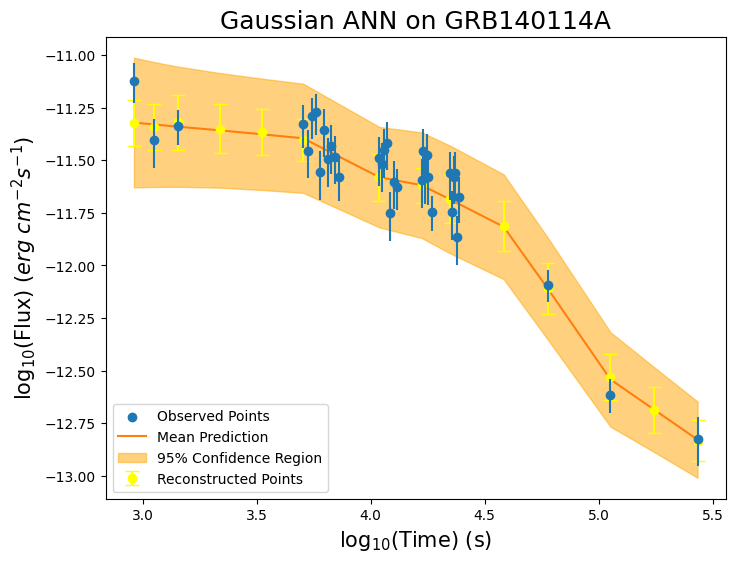


-----TRAINING FOR GRB140215A-----


-----ORIGINAL GRB-----



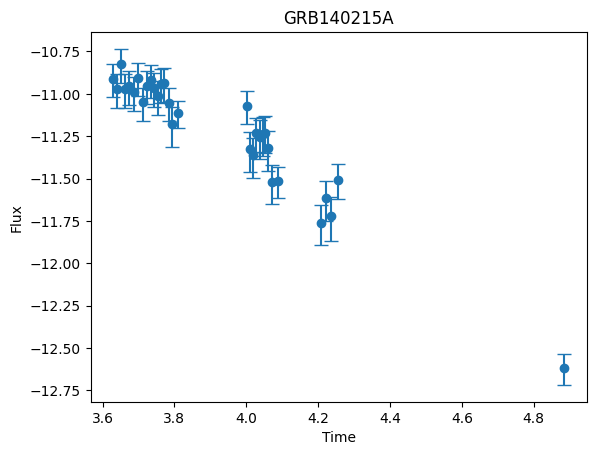


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.6314
Epoch 50, Loss: -0.6553
Epoch 100, Loss: -0.6775
Epoch 150, Loss: -0.6962
Epoch 200, Loss: -0.7184
Epoch 250, Loss: -0.7434
Epoch 300, Loss: -0.7685
Epoch 350, Loss: -0.7799
Epoch 400, Loss: -0.8134
Epoch 450, Loss: -0.8342

-----RECONSTRUCTED GRB-----



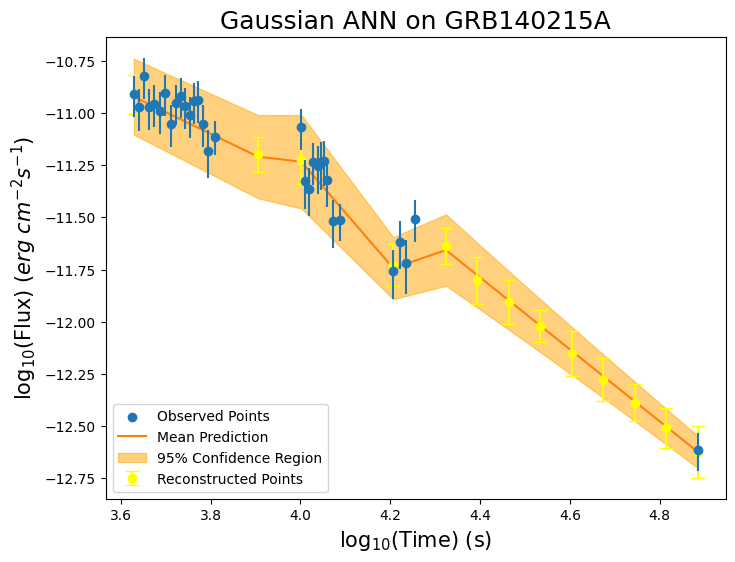


-----TRAINING FOR GRB140304A-----


-----ORIGINAL GRB-----



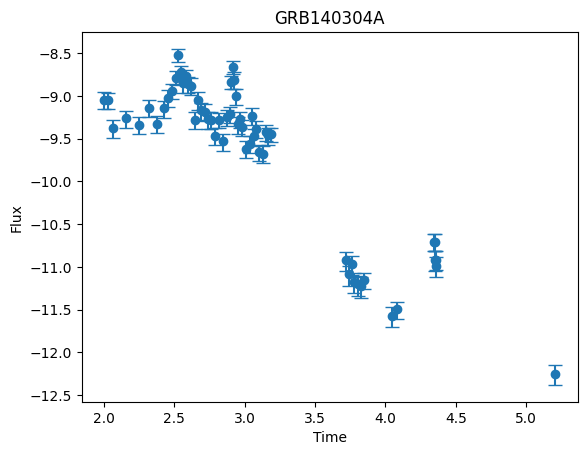


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.3687
Epoch 50, Loss: -0.5168
Epoch 100, Loss: -0.4694
Epoch 150, Loss: -0.6827
Epoch 200, Loss: -0.6755
Epoch 250, Loss: -0.6960
Epoch 300, Loss: -0.7707
Epoch 350, Loss: -0.7272
Epoch 400, Loss: -0.8094
Epoch 450, Loss: -0.8916

-----RECONSTRUCTED GRB-----



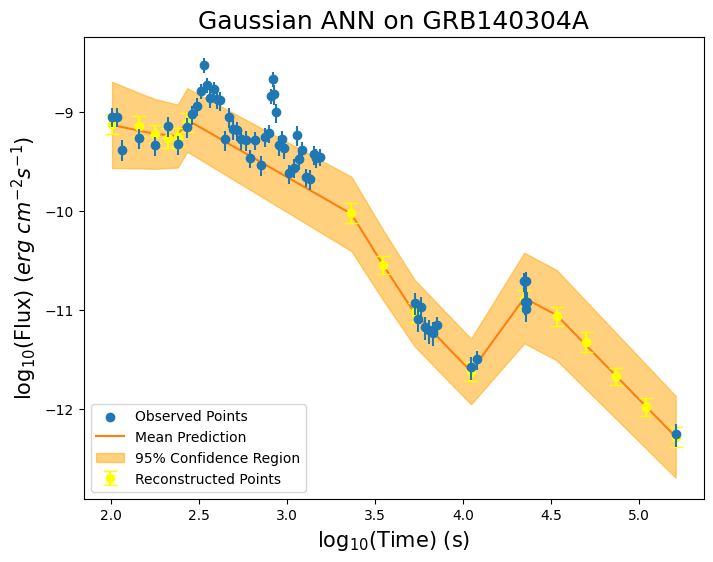


-----TRAINING FOR GRB140323A-----


-----ORIGINAL GRB-----



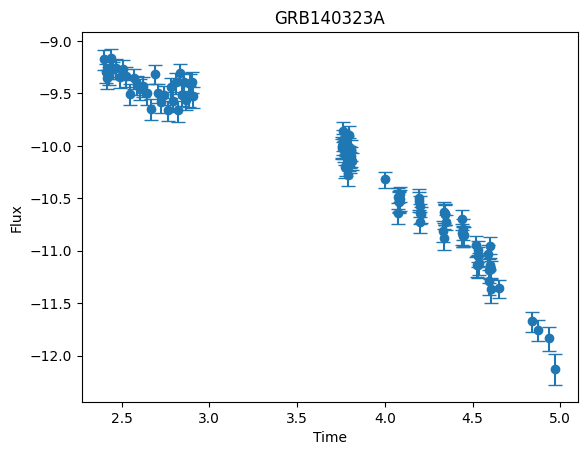


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.3262
Epoch 50, Loss: -0.8850
Epoch 100, Loss: -0.8000
Epoch 150, Loss: -0.8451
Epoch 200, Loss: -0.7395
Epoch 250, Loss: -0.9646
Epoch 300, Loss: -0.8829
Epoch 350, Loss: -0.9100
Epoch 400, Loss: -0.8343
Epoch 450, Loss: -0.7667

-----RECONSTRUCTED GRB-----



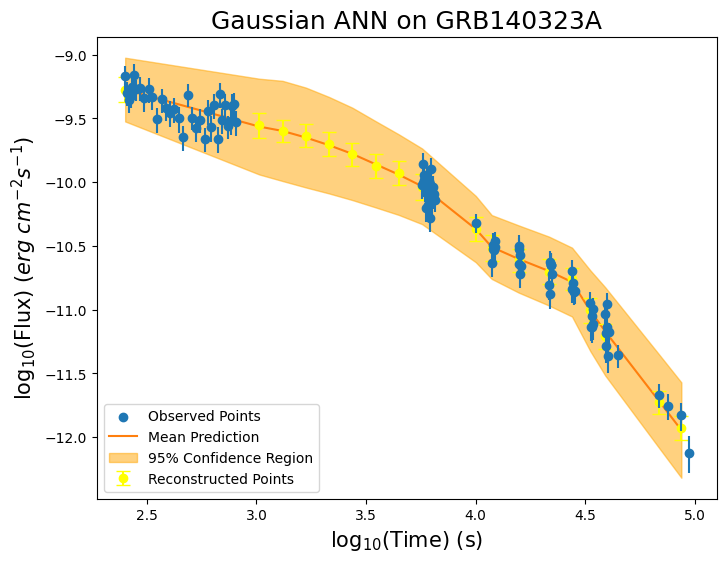


-----TRAINING FOR GRB140331A-----


-----ORIGINAL GRB-----



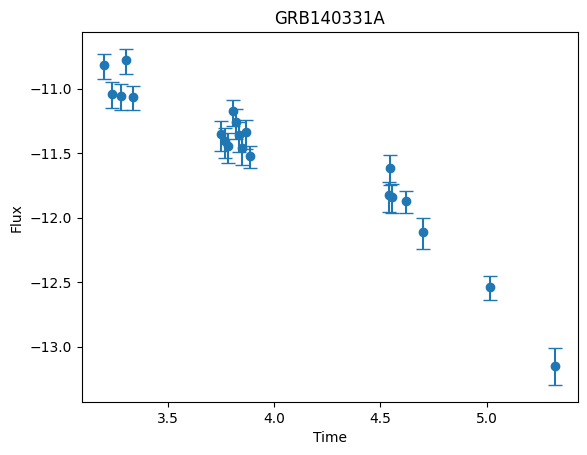


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.6027
Epoch 50, Loss: -0.7690
Epoch 100, Loss: -0.7997
Epoch 150, Loss: -0.8055
Epoch 200, Loss: -0.8071
Epoch 250, Loss: -0.8159
Epoch 300, Loss: -0.8232
Epoch 350, Loss: -0.8220
Epoch 400, Loss: -0.8403
Epoch 450, Loss: -0.8357

-----RECONSTRUCTED GRB-----



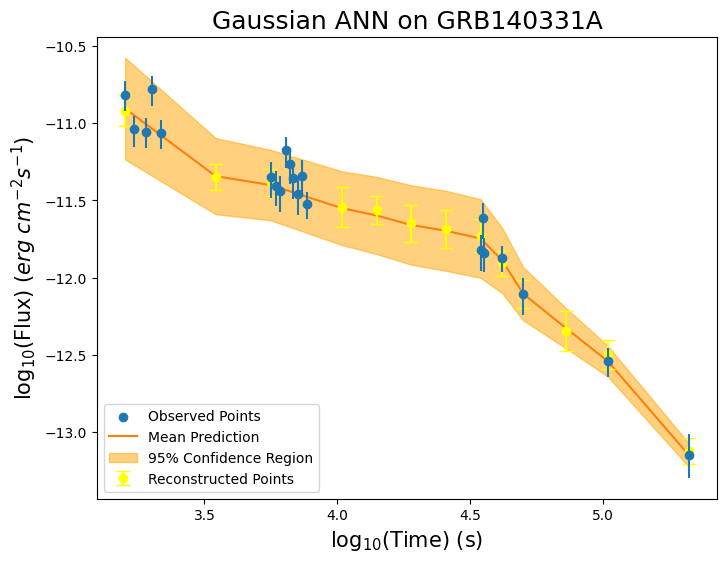


-----TRAINING FOR GRB140626A-----


-----ORIGINAL GRB-----



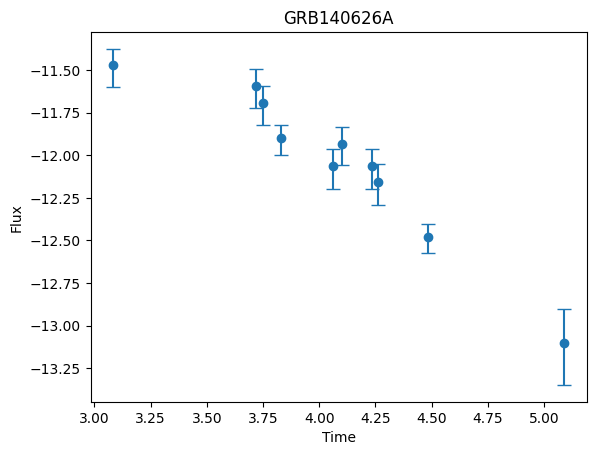


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.5716
Epoch 50, Loss: -0.9481
Epoch 100, Loss: -1.0630
Epoch 150, Loss: -1.0999
Epoch 200, Loss: -1.0899
Epoch 250, Loss: -1.1293
Epoch 300, Loss: -1.1412
Epoch 350, Loss: -1.1530
Epoch 400, Loss: -1.1631
Epoch 450, Loss: -1.1116

-----RECONSTRUCTED GRB-----



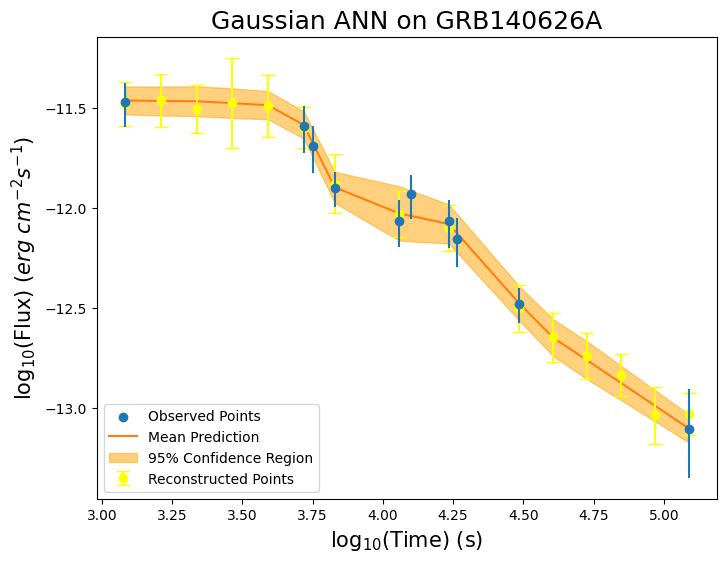


-----TRAINING FOR GRB140703A-----


-----ORIGINAL GRB-----



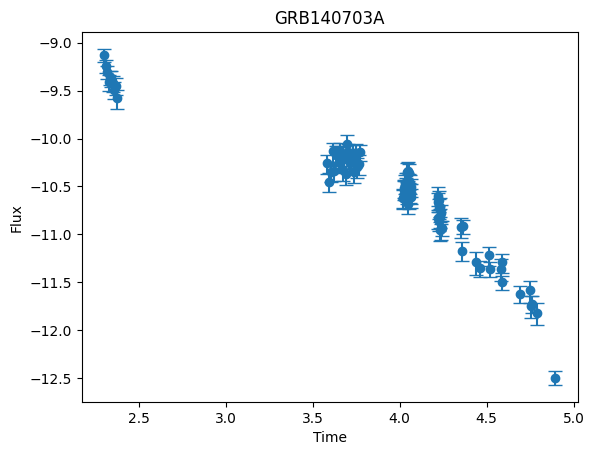


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.2232
Epoch 50, Loss: -0.7617
Epoch 100, Loss: -0.6451
Epoch 150, Loss: -0.7389
Epoch 200, Loss: -0.8234
Epoch 250, Loss: -0.7453
Epoch 300, Loss: -0.8387
Epoch 350, Loss: -0.7849
Epoch 400, Loss: -0.8788
Epoch 450, Loss: -0.8380

-----RECONSTRUCTED GRB-----



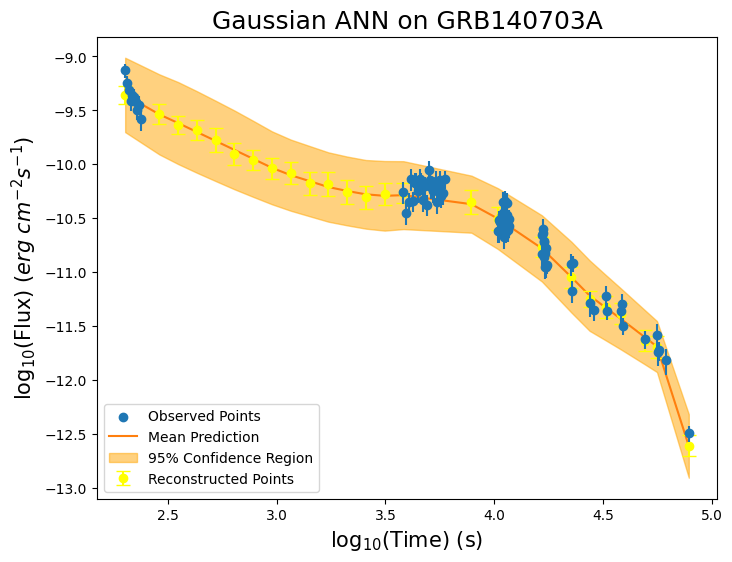


-----TRAINING FOR GRB140706A-----


-----ORIGINAL GRB-----



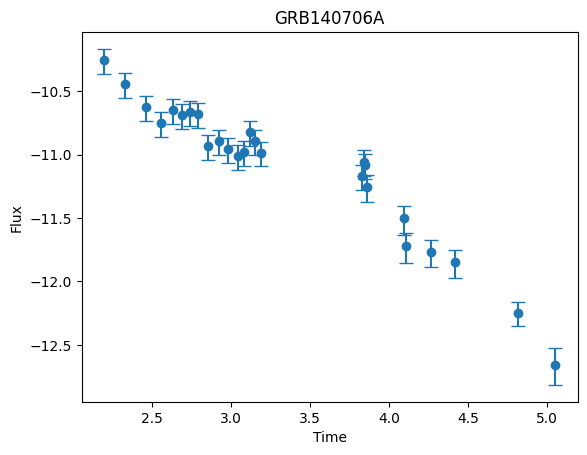


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.6567
Epoch 50, Loss: -0.8559
Epoch 100, Loss: -0.9060
Epoch 150, Loss: -0.9202
Epoch 200, Loss: -0.9209
Epoch 250, Loss: -0.9271
Epoch 300, Loss: -0.9265
Epoch 350, Loss: -0.9225
Epoch 400, Loss: -0.9251
Epoch 450, Loss: -0.9254

-----RECONSTRUCTED GRB-----



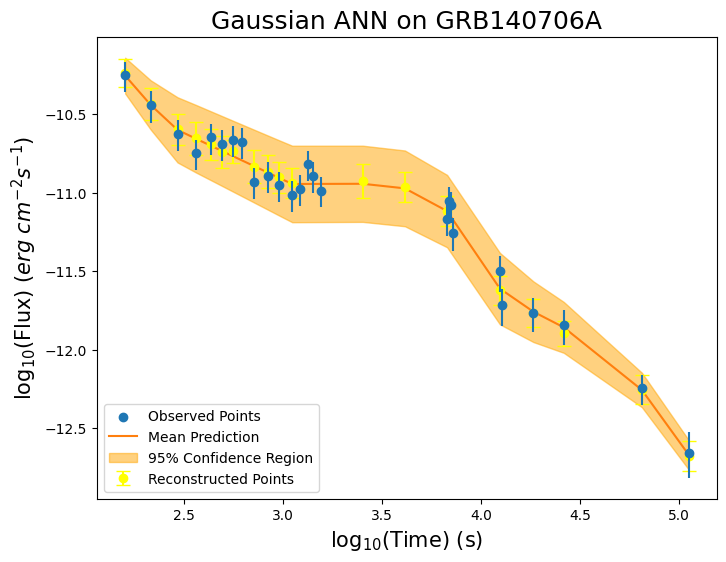


-----TRAINING FOR GRB140709A-----


-----ORIGINAL GRB-----



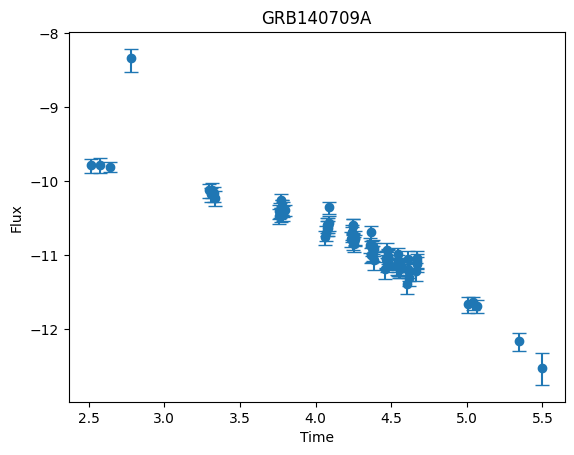


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: -0.0245
Epoch 50, Loss: -0.7287
Epoch 100, Loss: -0.7709
Epoch 150, Loss: -0.8120
Epoch 200, Loss: -0.7890
Epoch 250, Loss: -0.6784
Epoch 300, Loss: -0.6956
Epoch 350, Loss: -0.9118
Epoch 400, Loss: -0.8172
Epoch 450, Loss: -0.4204

-----RECONSTRUCTED GRB-----



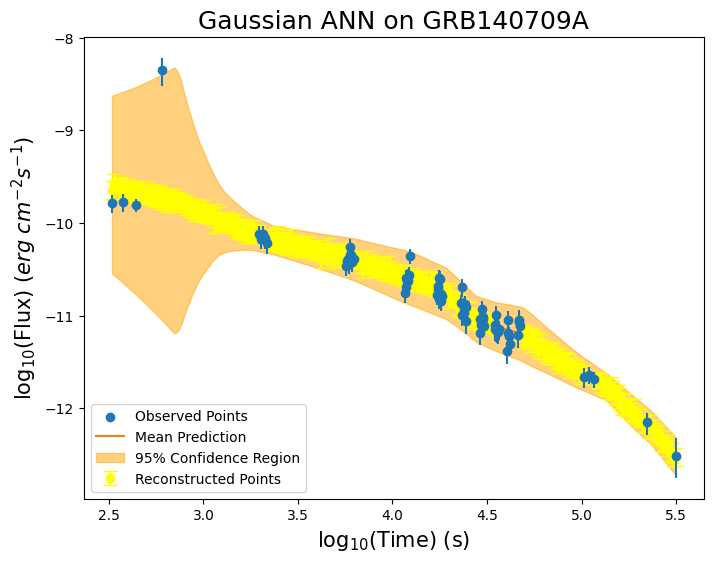


-----TRAINING FOR GRB140713A-----


-----ORIGINAL GRB-----



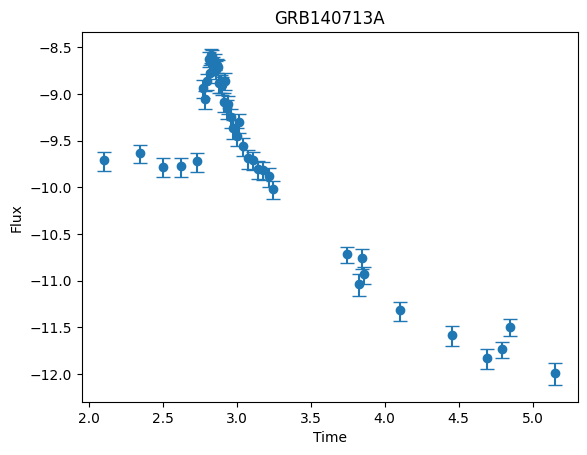


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.5618
Epoch 50, Loss: -0.5714
Epoch 100, Loss: -0.8685
Epoch 150, Loss: -0.9697
Epoch 200, Loss: -0.9989
Epoch 250, Loss: -0.8926
Epoch 300, Loss: -1.0514
Epoch 350, Loss: -1.0257
Epoch 400, Loss: -0.9402
Epoch 450, Loss: -0.9834

-----RECONSTRUCTED GRB-----



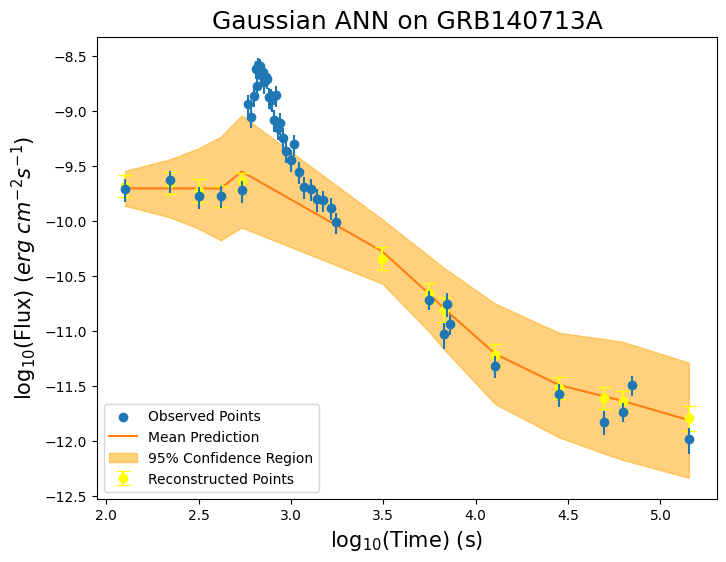


-----TRAINING FOR GRB140719A-----


-----ORIGINAL GRB-----



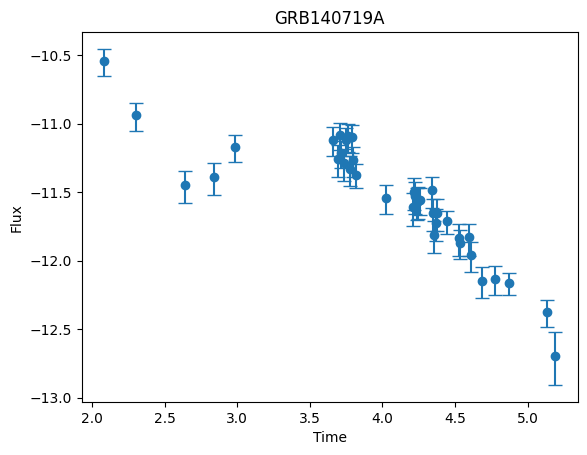


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.4459
Epoch 50, Loss: -0.5797
Epoch 100, Loss: -0.5484
Epoch 150, Loss: -0.5034
Epoch 200, Loss: -0.8005
Epoch 250, Loss: -0.8365
Epoch 300, Loss: -0.7443
Epoch 350, Loss: -0.6481
Epoch 400, Loss: -0.6102
Epoch 450, Loss: -0.6573

-----RECONSTRUCTED GRB-----



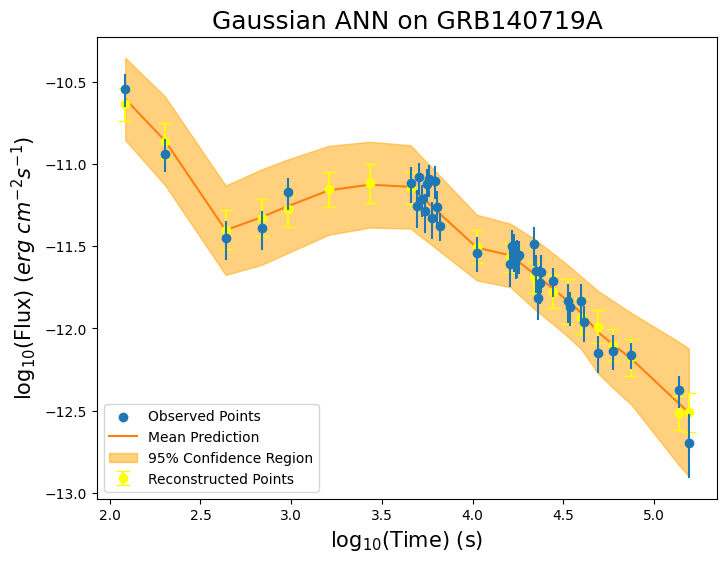


-----TRAINING FOR GRB140730A-----


-----ORIGINAL GRB-----



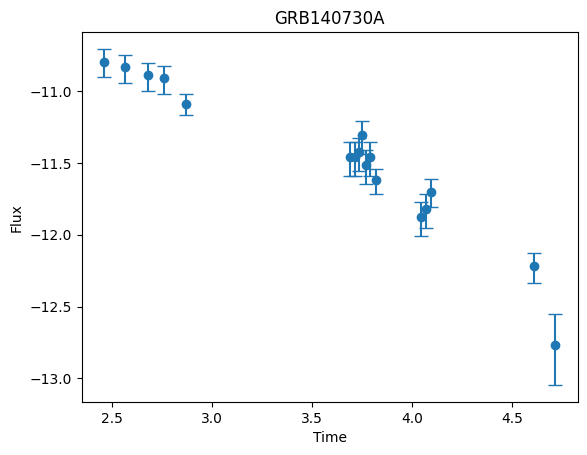


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.5516
Epoch 50, Loss: -0.8411
Epoch 100, Loss: -0.8947
Epoch 150, Loss: -0.9739
Epoch 200, Loss: -0.9957
Epoch 250, Loss: -0.9852
Epoch 300, Loss: -0.9834
Epoch 350, Loss: -1.0288
Epoch 400, Loss: -0.9688
Epoch 450, Loss: -1.0479

-----RECONSTRUCTED GRB-----



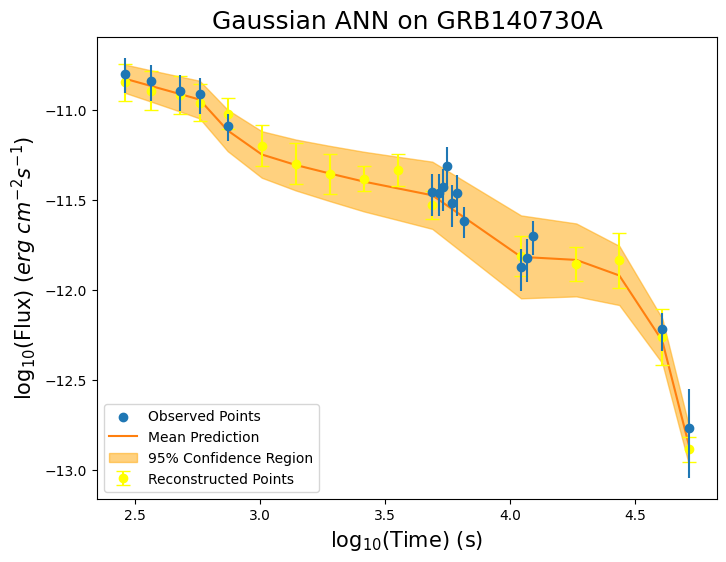


-----TRAINING FOR GRB140817A-----


-----ORIGINAL GRB-----



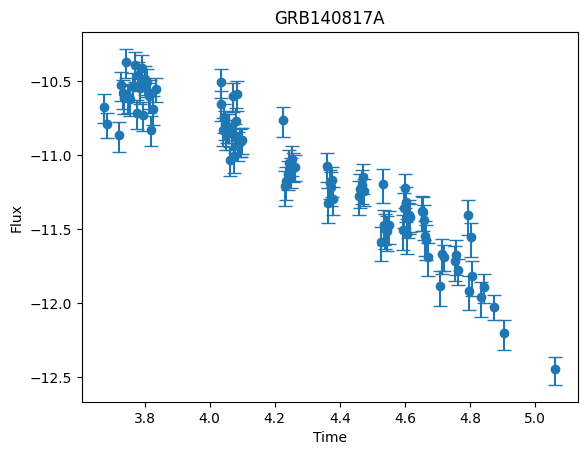


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: -0.0340
Epoch 50, Loss: 0.0144
Epoch 100, Loss: 0.1725
Epoch 150, Loss: -0.5955
Epoch 200, Loss: -0.6020
Epoch 250, Loss: -0.7050
Epoch 300, Loss: 0.4438
Epoch 350, Loss: -0.1716
Epoch 400, Loss: -0.6697
Epoch 450, Loss: -0.5372

-----RECONSTRUCTED GRB-----



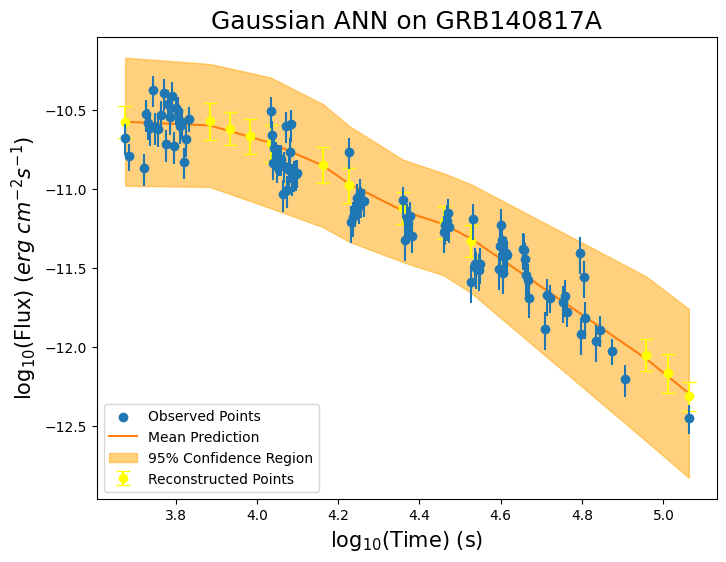


-----TRAINING FOR GRB140818B-----


-----ORIGINAL GRB-----



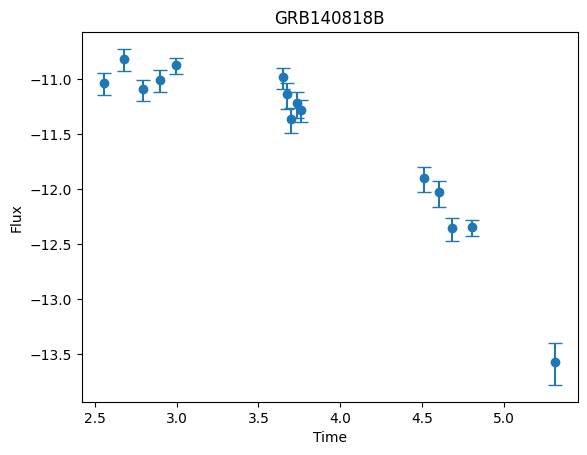


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.6221
Epoch 50, Loss: -0.8330
Epoch 100, Loss: -0.8865
Epoch 150, Loss: -0.9085
Epoch 200, Loss: -0.9386
Epoch 250, Loss: -0.9528
Epoch 300, Loss: -0.8195
Epoch 350, Loss: -1.0091
Epoch 400, Loss: -1.0148
Epoch 450, Loss: -1.0256

-----RECONSTRUCTED GRB-----



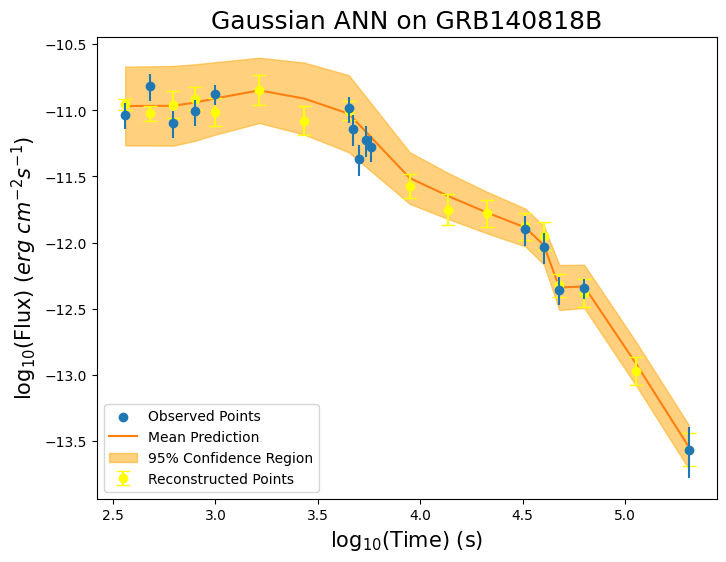


-----TRAINING FOR GRB140824A-----


-----ORIGINAL GRB-----



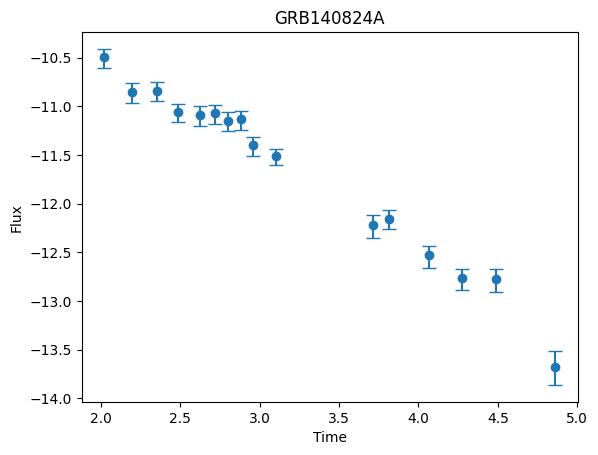


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.8005
Epoch 50, Loss: -0.9845
Epoch 100, Loss: -1.0654
Epoch 150, Loss: -1.1026
Epoch 200, Loss: -1.1063
Epoch 250, Loss: -1.1192
Epoch 300, Loss: -1.0802
Epoch 350, Loss: -1.1313
Epoch 400, Loss: -1.1380
Epoch 450, Loss: -1.1346

-----RECONSTRUCTED GRB-----



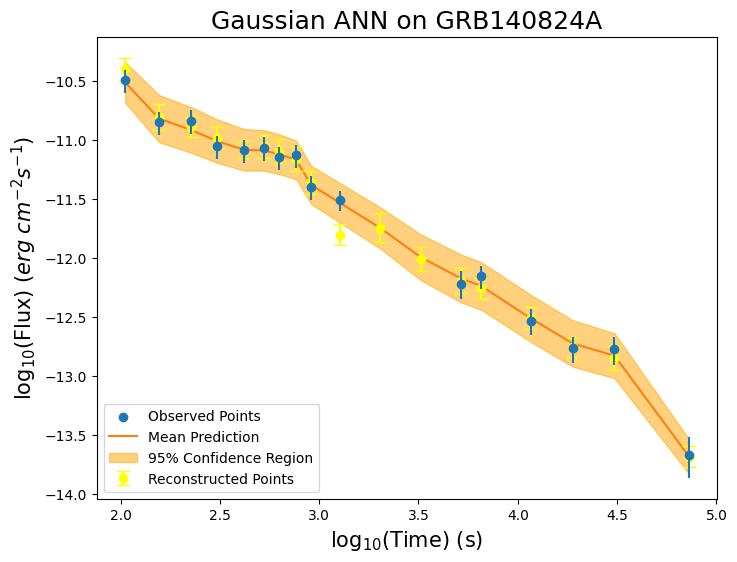


-----TRAINING FOR GRB140916A-----


-----ORIGINAL GRB-----



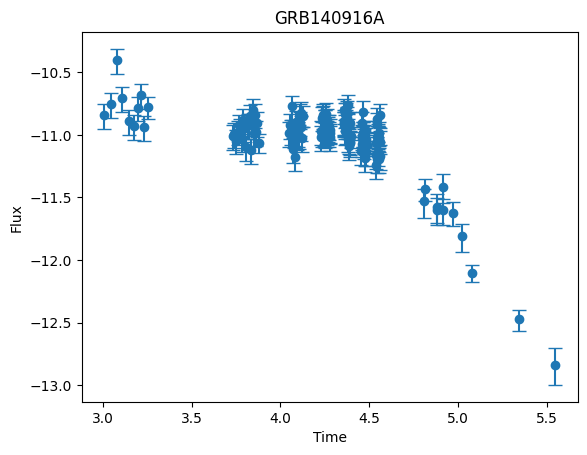


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.5273
Epoch 50, Loss: -0.0978
Epoch 100, Loss: -0.4771
Epoch 150, Loss: -0.3752
Epoch 200, Loss: -0.5976
Epoch 250, Loss: -0.5945
Epoch 300, Loss: -0.5174
Epoch 350, Loss: -0.5003
Epoch 400, Loss: -0.2987
Epoch 450, Loss: -0.1283

-----RECONSTRUCTED GRB-----



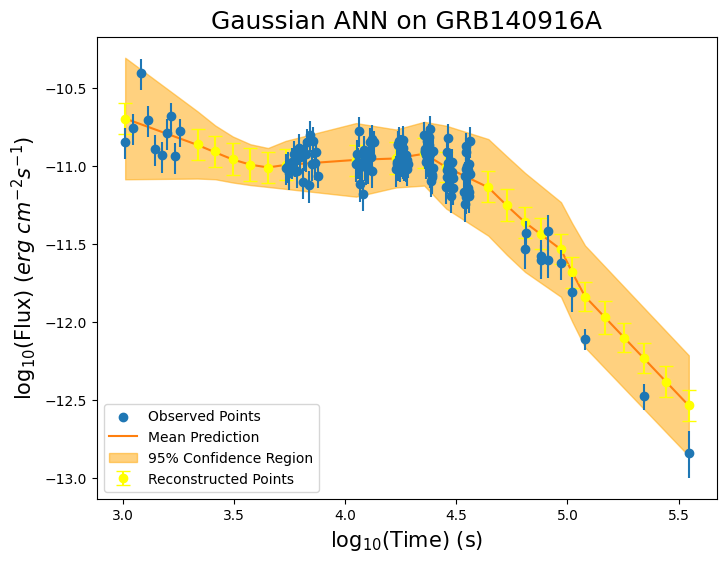


-----TRAINING FOR GRB140927A-----


-----ORIGINAL GRB-----



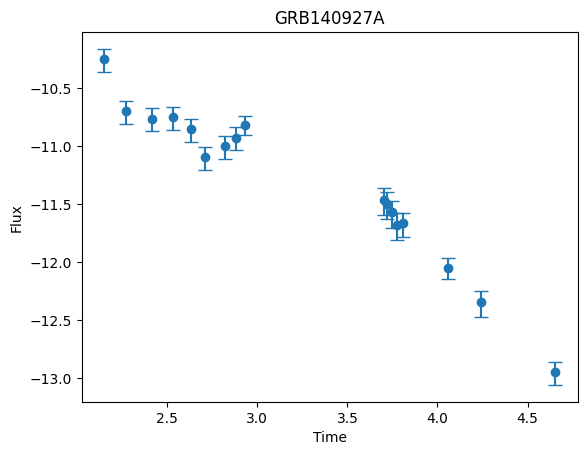


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.6594
Epoch 50, Loss: -0.9235
Epoch 100, Loss: -0.9668
Epoch 150, Loss: -0.9751
Epoch 200, Loss: -0.9678
Epoch 250, Loss: -1.0027
Epoch 300, Loss: -1.0893
Epoch 350, Loss: -1.1061
Epoch 400, Loss: -1.1198
Epoch 450, Loss: -1.1380

-----RECONSTRUCTED GRB-----



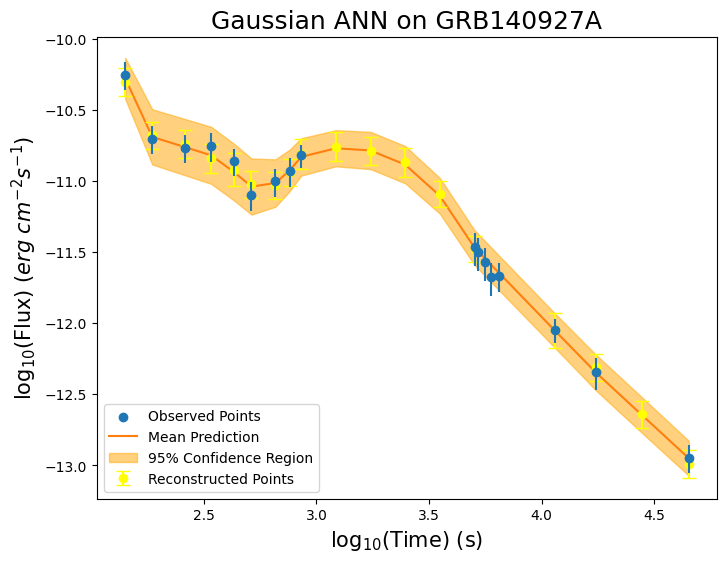


-----TRAINING FOR GRB141005A-----


-----ORIGINAL GRB-----



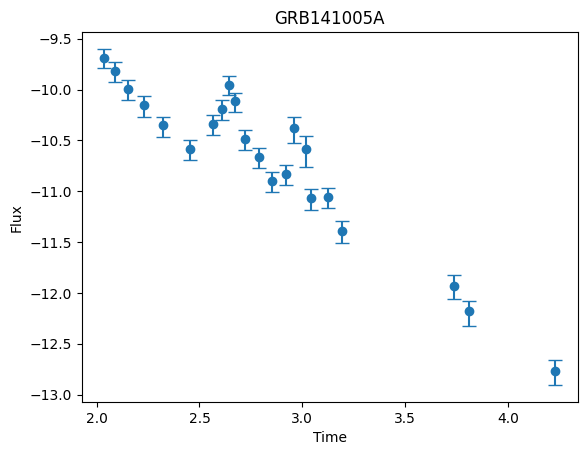


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.5039
Epoch 50, Loss: -0.6657
Epoch 100, Loss: -0.7430
Epoch 150, Loss: -0.7826
Epoch 200, Loss: -0.8377
Epoch 250, Loss: -0.8507
Epoch 300, Loss: -0.9208
Epoch 350, Loss: -0.9740
Epoch 400, Loss: -0.9925
Epoch 450, Loss: -0.9969

-----RECONSTRUCTED GRB-----



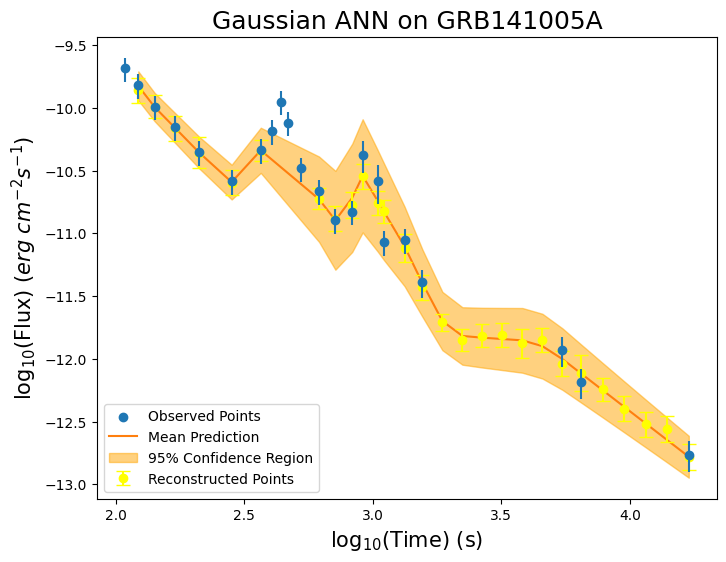


-----TRAINING FOR GRB141017A-----


-----ORIGINAL GRB-----



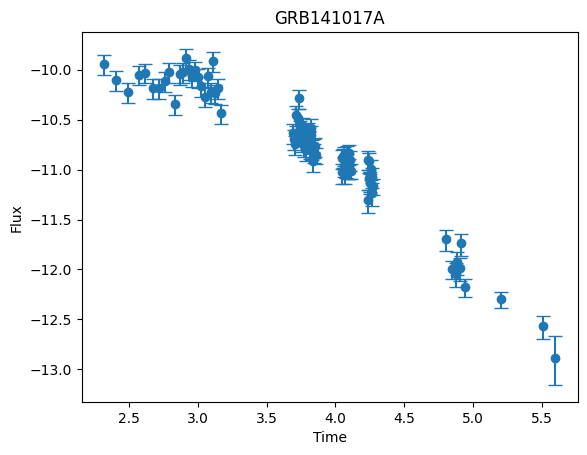


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.2241
Epoch 50, Loss: -0.8411
Epoch 100, Loss: -0.6941
Epoch 150, Loss: -0.8027
Epoch 200, Loss: -0.8232
Epoch 250, Loss: -0.6006
Epoch 300, Loss: -0.7474
Epoch 350, Loss: -0.7751
Epoch 400, Loss: -0.8319
Epoch 450, Loss: -0.7962

-----RECONSTRUCTED GRB-----



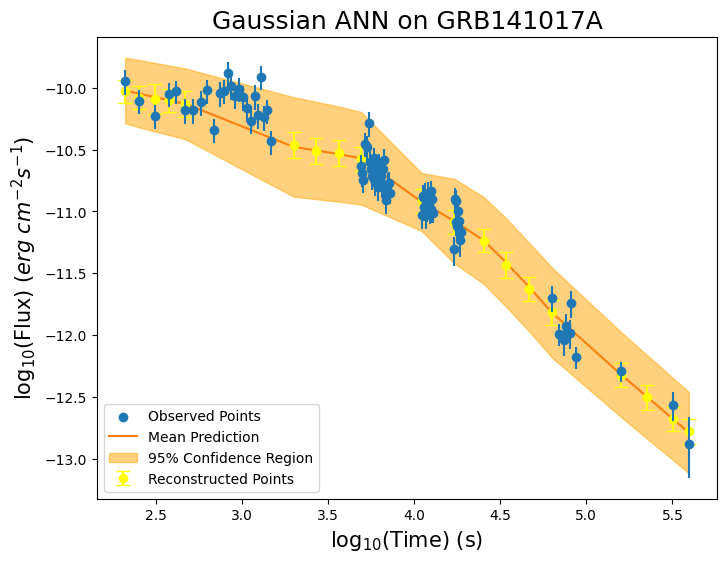


-----TRAINING FOR GRB141020A-----


-----ORIGINAL GRB-----



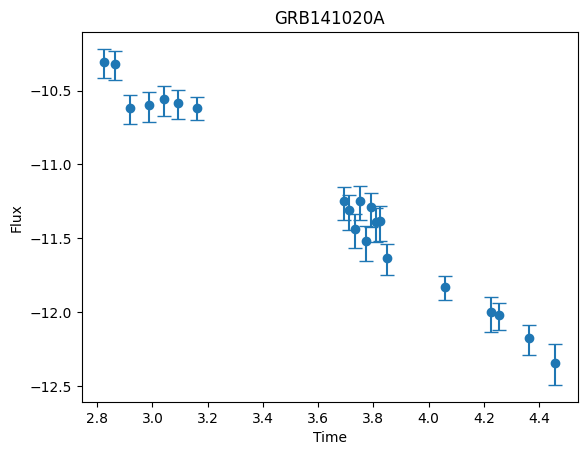


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.5253
Epoch 50, Loss: -0.8930
Epoch 100, Loss: -0.9310
Epoch 150, Loss: -0.9638
Epoch 200, Loss: -0.9800
Epoch 250, Loss: -0.9770
Epoch 300, Loss: -1.0055
Epoch 350, Loss: -1.0126
Epoch 400, Loss: -1.0296
Epoch 450, Loss: -1.0026

-----RECONSTRUCTED GRB-----



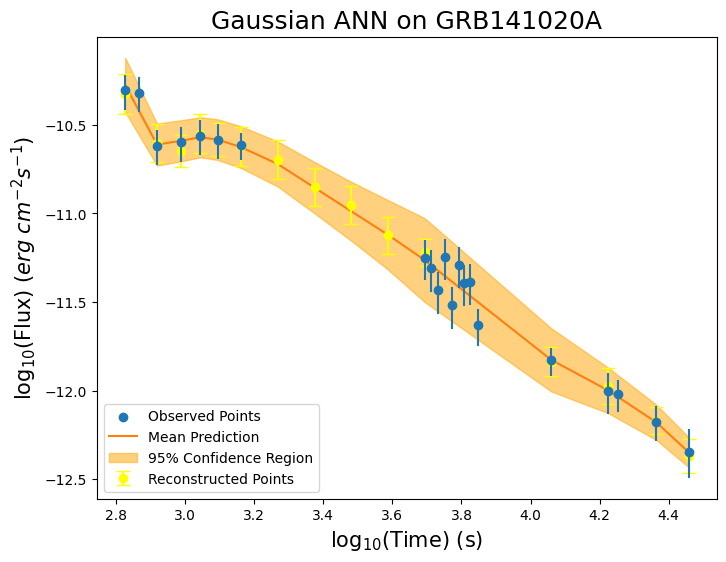


-----TRAINING FOR GRB141026A-----


-----ORIGINAL GRB-----



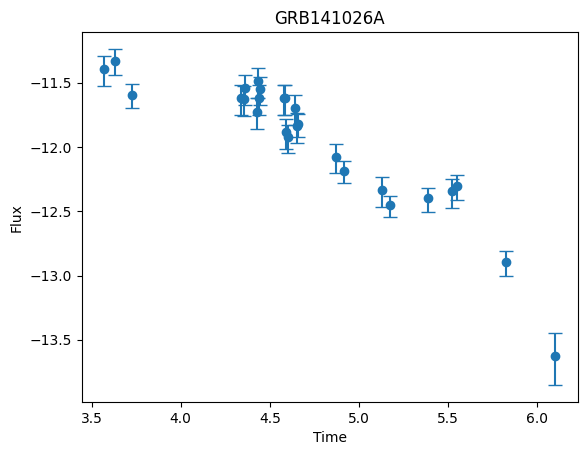


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.5457
Epoch 50, Loss: -0.6847
Epoch 100, Loss: -0.8540
Epoch 150, Loss: -0.8611
Epoch 200, Loss: -0.8803
Epoch 250, Loss: -0.8489
Epoch 300, Loss: -0.8964
Epoch 350, Loss: -0.9067
Epoch 400, Loss: -0.8936
Epoch 450, Loss: -0.9088

-----RECONSTRUCTED GRB-----



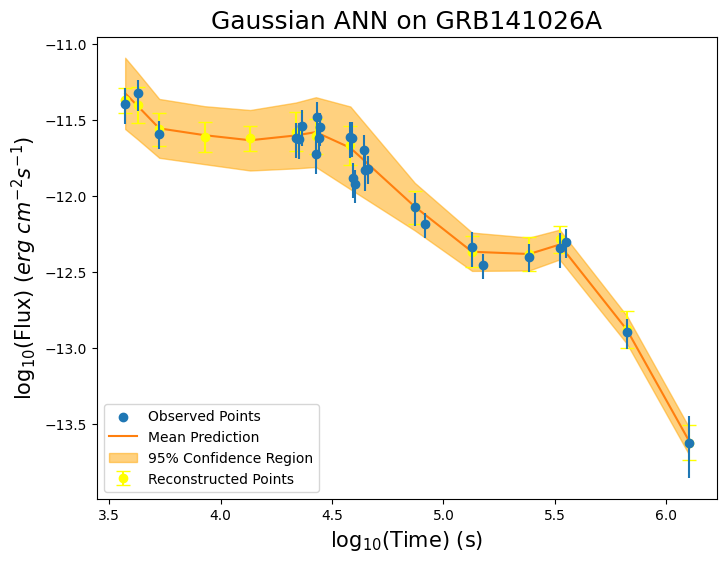


-----TRAINING FOR GRB141031A-----


-----ORIGINAL GRB-----



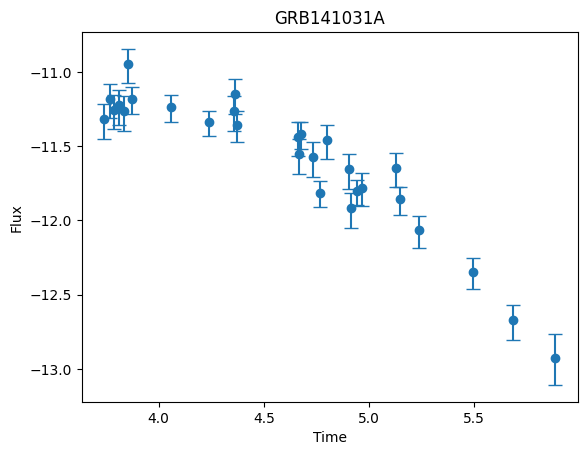


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.4769
Epoch 50, Loss: -0.6533
Epoch 100, Loss: -0.6962
Epoch 150, Loss: -0.7103
Epoch 200, Loss: -0.7240
Epoch 250, Loss: -0.7374
Epoch 300, Loss: -0.7320
Epoch 350, Loss: -0.7609
Epoch 400, Loss: -0.7649
Epoch 450, Loss: -0.7755

-----RECONSTRUCTED GRB-----



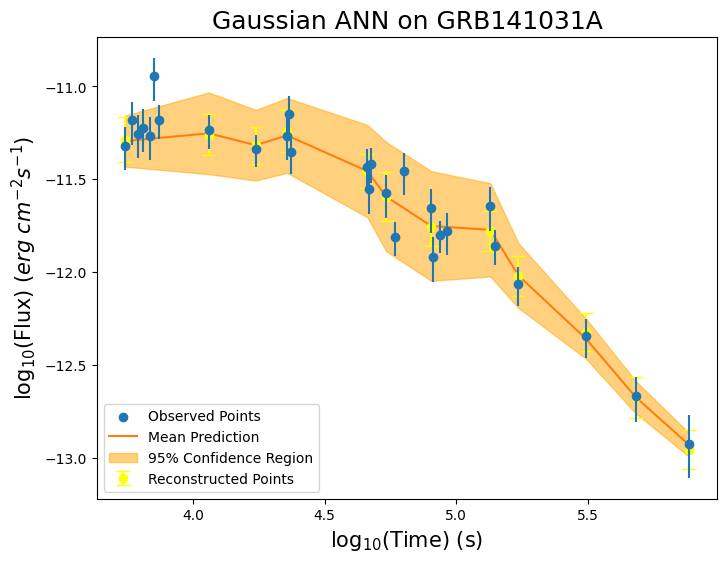


-----TRAINING FOR GRB141109B-----


-----ORIGINAL GRB-----



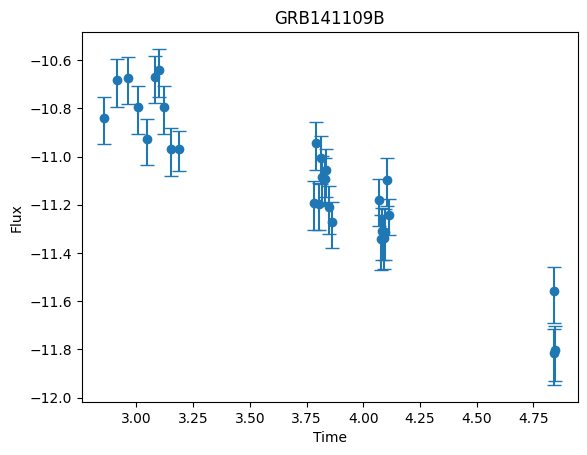


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.5783
Epoch 50, Loss: -0.3934
Epoch 100, Loss: -0.4095
Epoch 150, Loss: -0.4280
Epoch 200, Loss: -0.4503
Epoch 250, Loss: -0.4720
Epoch 300, Loss: -0.4837
Epoch 350, Loss: -0.5086
Epoch 400, Loss: -0.5305
Epoch 450, Loss: -0.5489

-----RECONSTRUCTED GRB-----



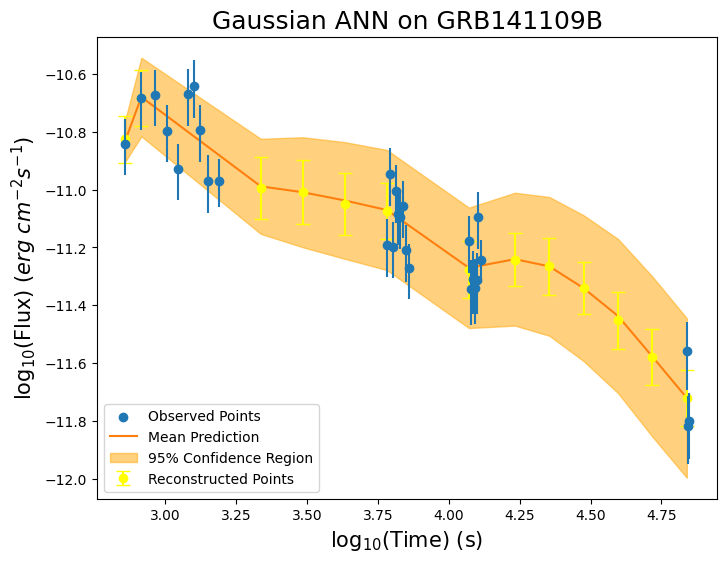


-----TRAINING FOR GRB141221A-----


-----ORIGINAL GRB-----



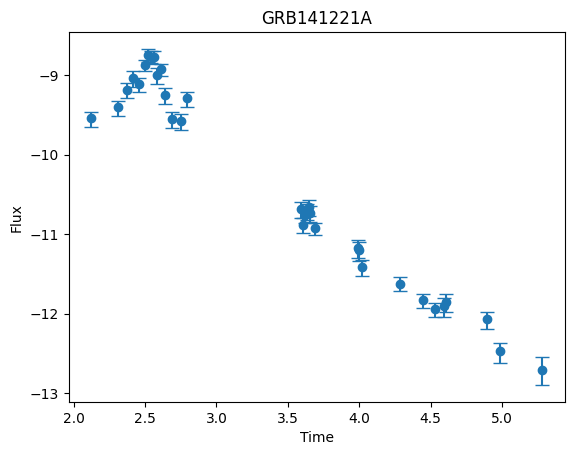


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.6353
Epoch 50, Loss: -0.5667
Epoch 100, Loss: -1.1766
Epoch 150, Loss: -0.8081
Epoch 200, Loss: -0.6226
Epoch 250, Loss: -0.9927
Epoch 300, Loss: -0.8605
Epoch 350, Loss: -1.0231
Epoch 400, Loss: -0.3393
Epoch 450, Loss: -1.0058

-----RECONSTRUCTED GRB-----



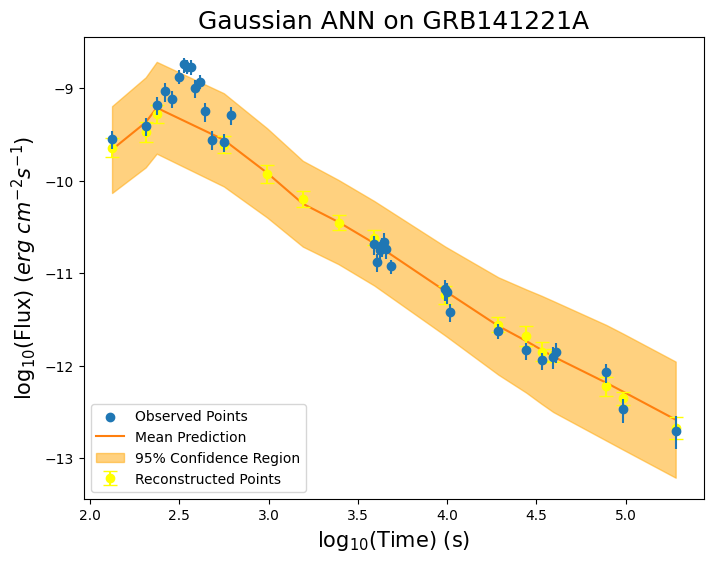


-----TRAINING FOR GRB150323A-----


-----ORIGINAL GRB-----



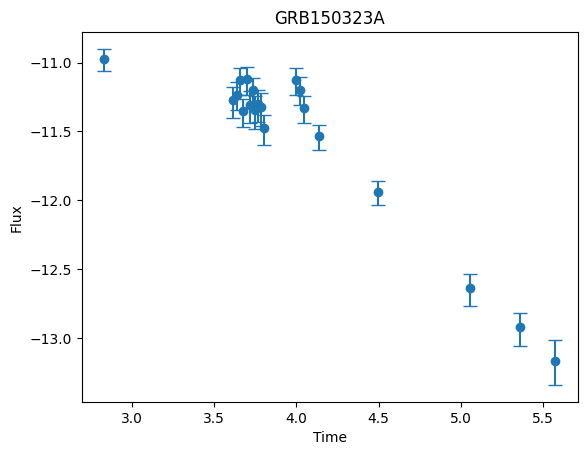


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.3496
Epoch 50, Loss: -0.8635
Epoch 100, Loss: -0.8945
Epoch 150, Loss: -0.9181
Epoch 200, Loss: -0.9259
Epoch 250, Loss: -0.9737
Epoch 300, Loss: -0.9909
Epoch 350, Loss: -1.0177
Epoch 400, Loss: -1.0268
Epoch 450, Loss: -1.0073

-----RECONSTRUCTED GRB-----



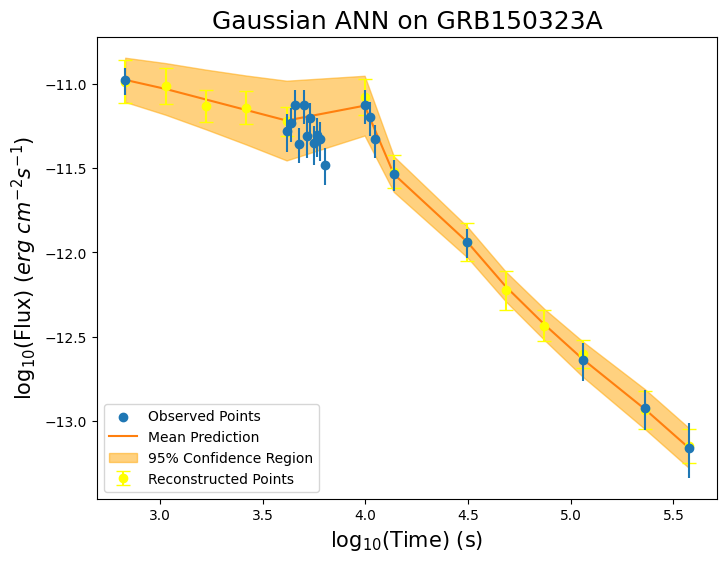


-----TRAINING FOR GRB150323C-----


-----ORIGINAL GRB-----



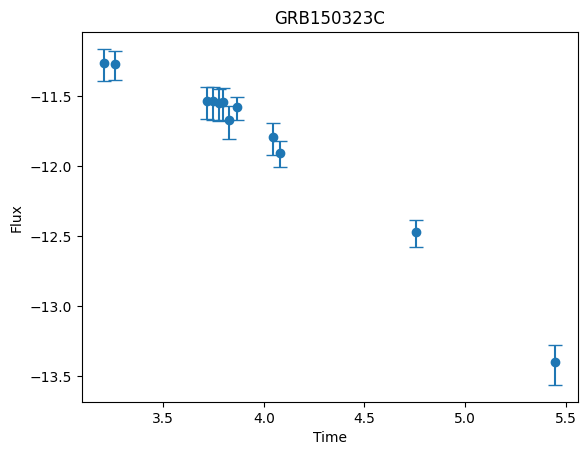


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.5165
Epoch 50, Loss: -1.1240
Epoch 100, Loss: -1.1469
Epoch 150, Loss: -1.1535
Epoch 200, Loss: -1.1646
Epoch 250, Loss: -1.1615
Epoch 300, Loss: -1.1692
Epoch 350, Loss: -1.1652
Epoch 400, Loss: -1.1717
Epoch 450, Loss: -1.1615

-----RECONSTRUCTED GRB-----



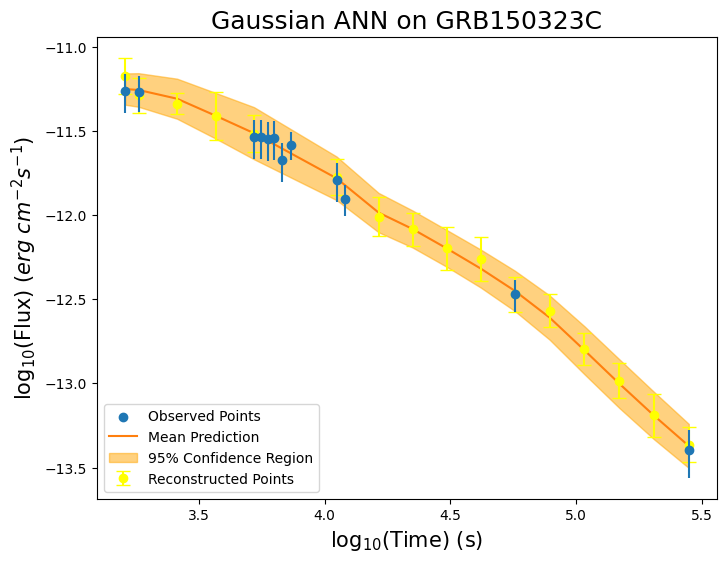


-----TRAINING FOR GRB150424A-----


-----ORIGINAL GRB-----



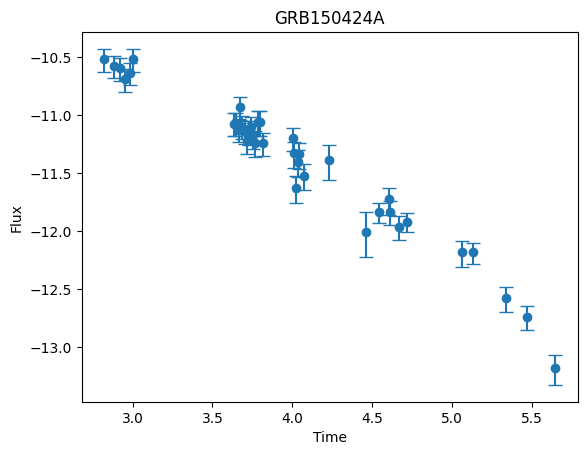


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.4652
Epoch 50, Loss: -0.7130
Epoch 100, Loss: -0.9188
Epoch 150, Loss: -0.7320
Epoch 200, Loss: -0.6982
Epoch 250, Loss: -0.6270
Epoch 300, Loss: -0.9454
Epoch 350, Loss: -0.4021
Epoch 400, Loss: -0.6763
Epoch 450, Loss: -0.9060

-----RECONSTRUCTED GRB-----



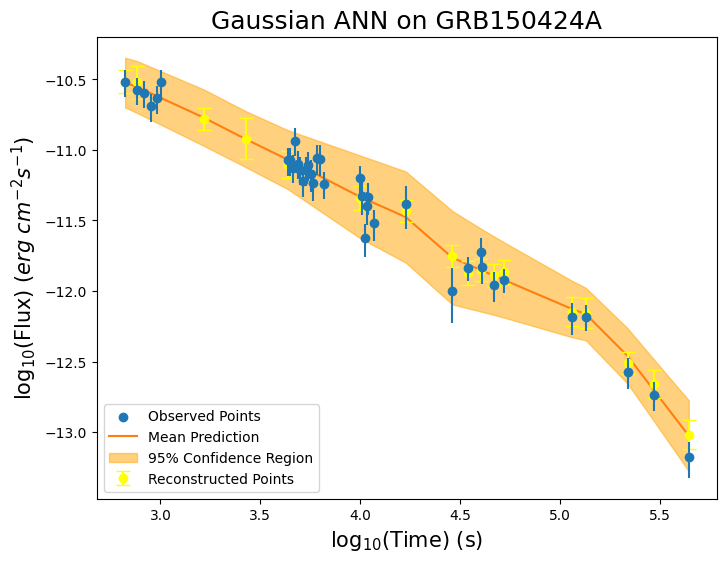


-----TRAINING FOR GRB150428B-----


-----ORIGINAL GRB-----



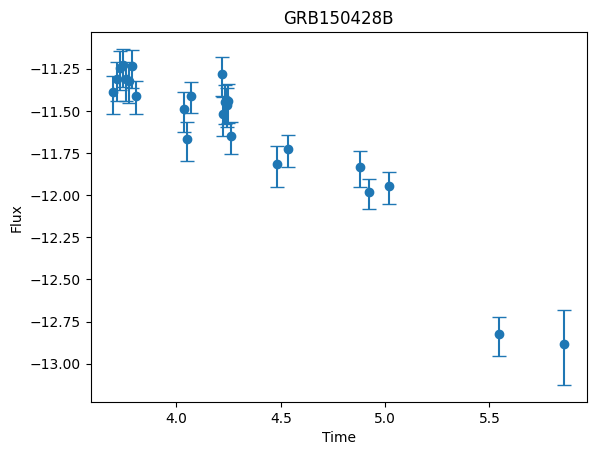


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.3761
Epoch 50, Loss: -0.6364
Epoch 100, Loss: -0.7021
Epoch 150, Loss: -0.7584
Epoch 200, Loss: -0.7632
Epoch 250, Loss: -0.6841
Epoch 300, Loss: -0.8344
Epoch 350, Loss: -0.8494
Epoch 400, Loss: -0.8250
Epoch 450, Loss: -0.8834

-----RECONSTRUCTED GRB-----



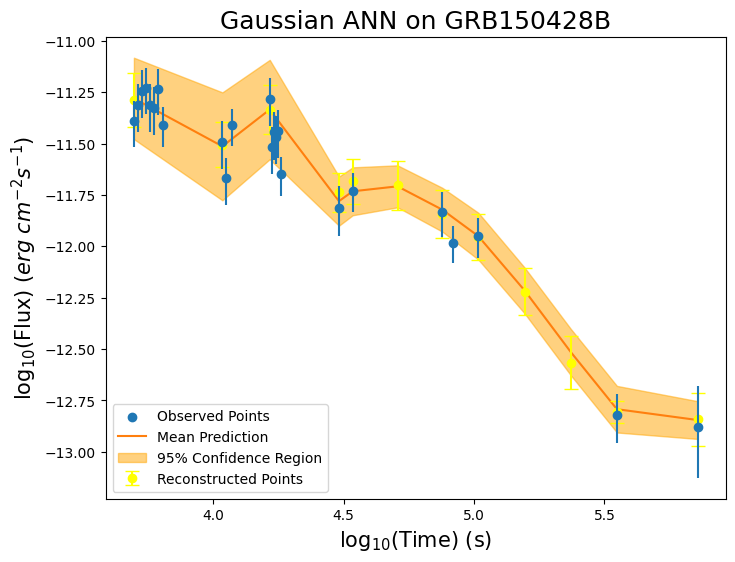


-----TRAINING FOR GRB150430A-----


-----ORIGINAL GRB-----



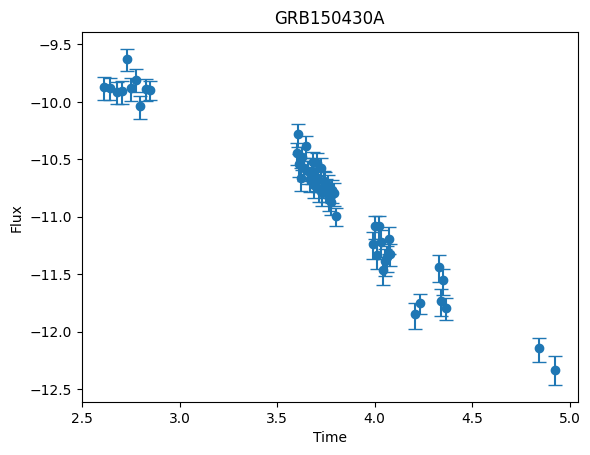


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.7288
Epoch 50, Loss: -0.8468
Epoch 100, Loss: -0.8630
Epoch 150, Loss: -0.8677
Epoch 200, Loss: -0.8173
Epoch 250, Loss: -0.8117
Epoch 300, Loss: -0.8324
Epoch 350, Loss: -0.7999
Epoch 400, Loss: -0.6935
Epoch 450, Loss: -0.8451

-----RECONSTRUCTED GRB-----



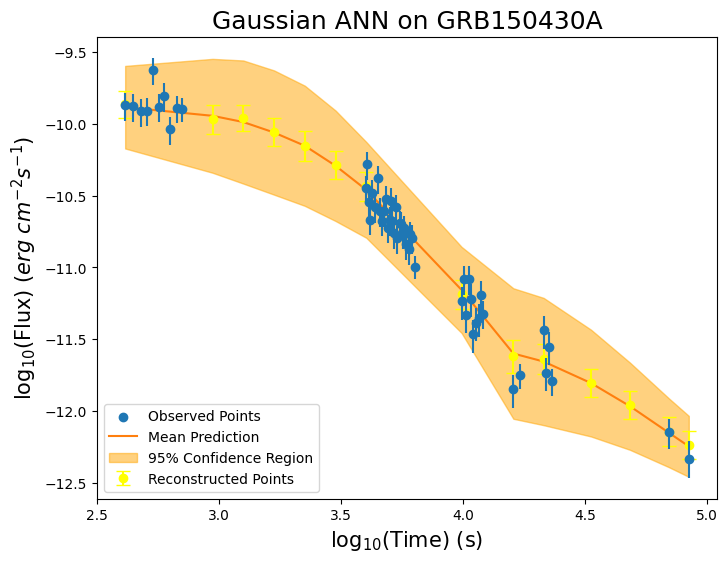


-----TRAINING FOR GRB150530A-----


-----ORIGINAL GRB-----



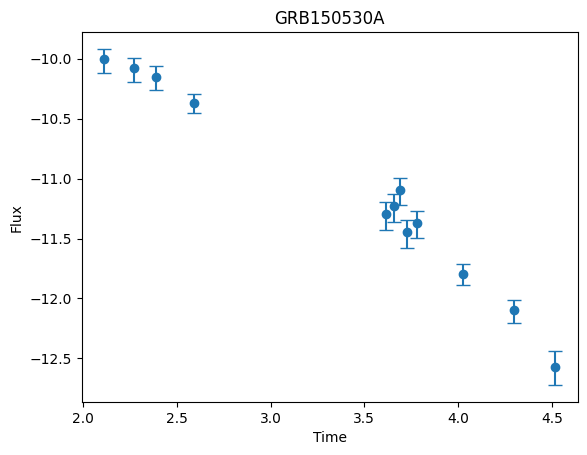


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.4397
Epoch 50, Loss: -1.0189
Epoch 100, Loss: -1.0524
Epoch 150, Loss: -1.0654
Epoch 200, Loss: -1.0517
Epoch 250, Loss: -1.0864
Epoch 300, Loss: -1.1001
Epoch 350, Loss: -1.1106
Epoch 400, Loss: -1.1092
Epoch 450, Loss: -1.1178

-----RECONSTRUCTED GRB-----



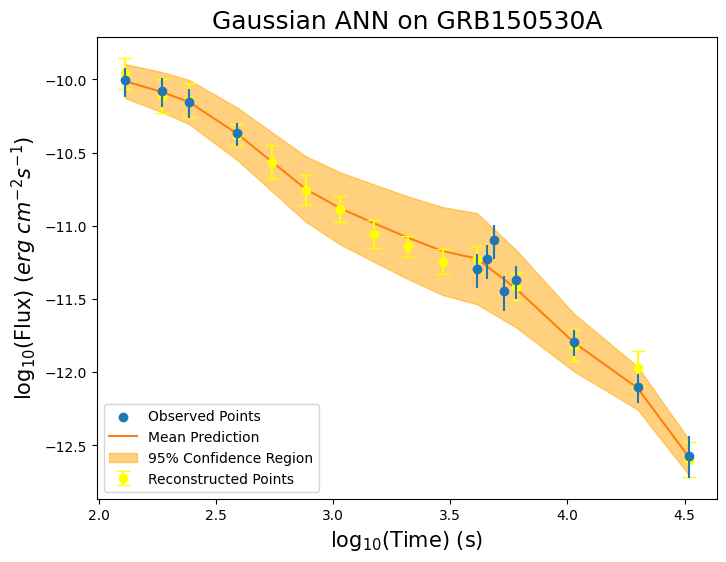


-----TRAINING FOR GRB150607A-----


-----ORIGINAL GRB-----



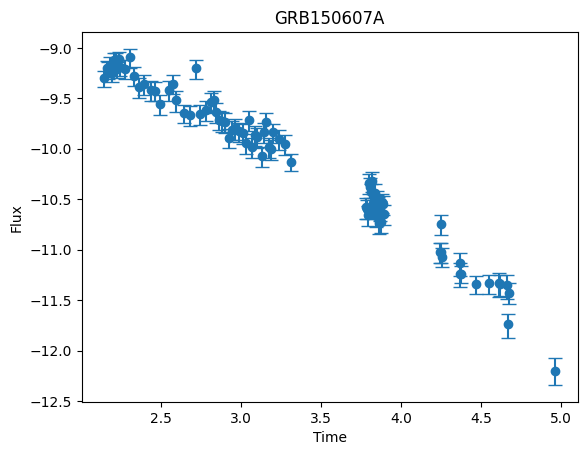


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.2674
Epoch 50, Loss: -0.8649
Epoch 100, Loss: -0.8003
Epoch 150, Loss: -0.7939
Epoch 200, Loss: -0.7667
Epoch 250, Loss: -0.8382
Epoch 300, Loss: -0.9080
Epoch 350, Loss: -0.9304
Epoch 400, Loss: -0.8510
Epoch 450, Loss: -0.8921

-----RECONSTRUCTED GRB-----



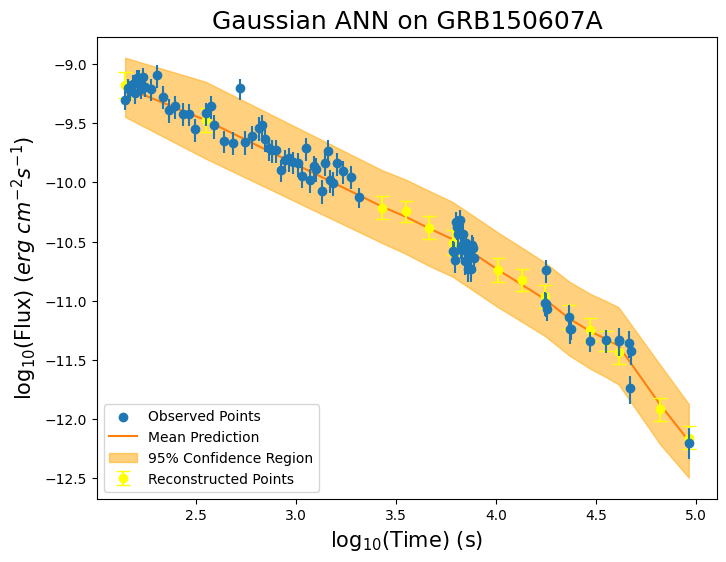


-----TRAINING FOR GRB150615A-----


-----ORIGINAL GRB-----



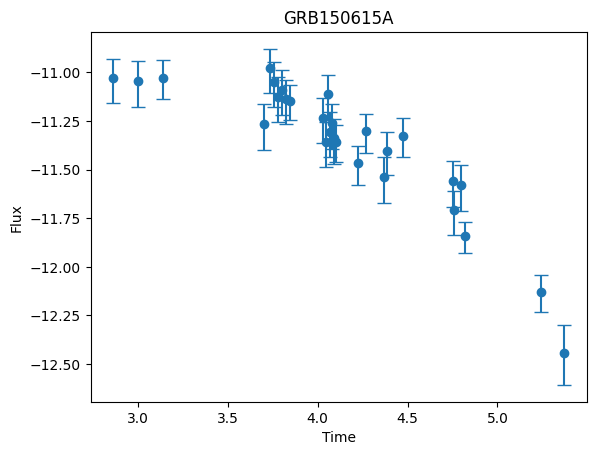


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.5258
Epoch 50, Loss: -0.6030
Epoch 100, Loss: -0.6307
Epoch 150, Loss: -0.6451
Epoch 200, Loss: -0.6603
Epoch 250, Loss: -0.6558
Epoch 300, Loss: -0.6562
Epoch 350, Loss: -0.7030
Epoch 400, Loss: -0.6670
Epoch 450, Loss: -0.7152

-----RECONSTRUCTED GRB-----



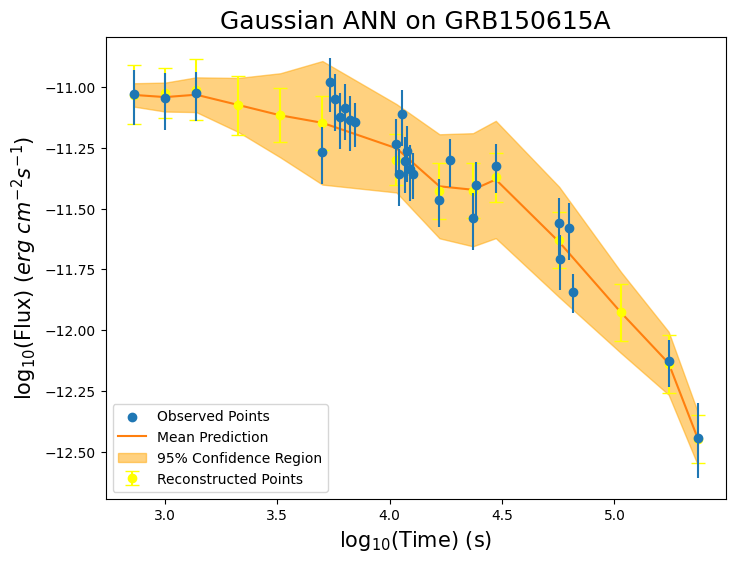


-----TRAINING FOR GRB150626B-----


-----ORIGINAL GRB-----



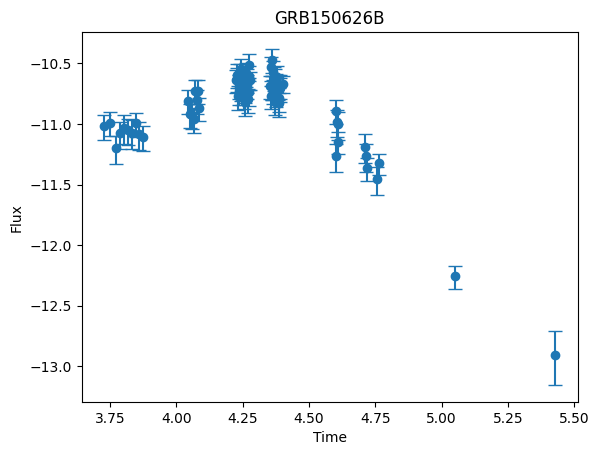


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.0595
Epoch 50, Loss: -0.4960
Epoch 100, Loss: -0.6655
Epoch 150, Loss: -0.6354
Epoch 200, Loss: -0.5907
Epoch 250, Loss: -0.7069
Epoch 300, Loss: -0.5868
Epoch 350, Loss: -0.6708
Epoch 400, Loss: -0.4982
Epoch 450, Loss: -0.6572

-----RECONSTRUCTED GRB-----



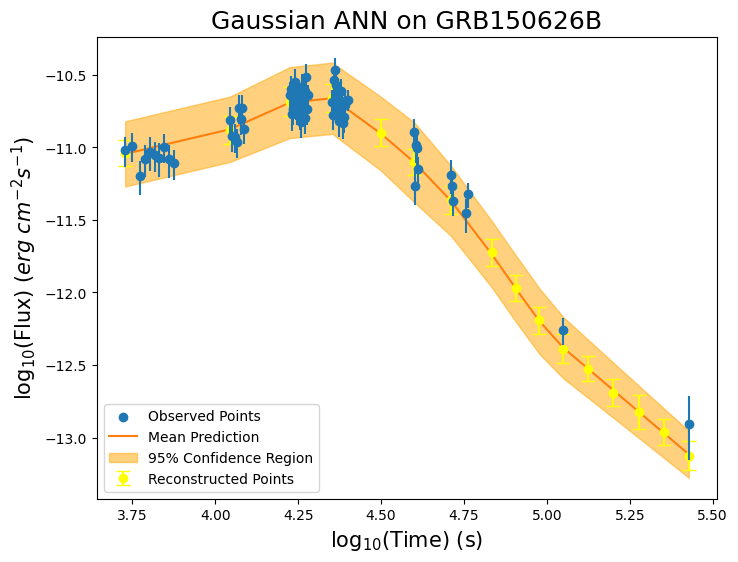


-----TRAINING FOR GRB150711A-----


-----ORIGINAL GRB-----



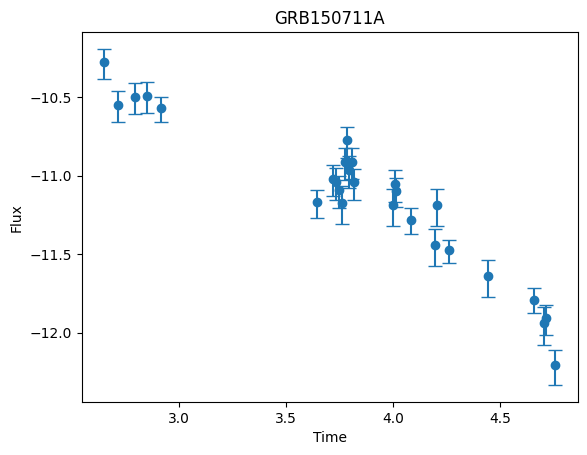


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.5161
Epoch 50, Loss: -0.6458
Epoch 100, Loss: -0.6827
Epoch 150, Loss: -0.7154
Epoch 200, Loss: -0.7417
Epoch 250, Loss: -0.7766
Epoch 300, Loss: -0.7872
Epoch 350, Loss: -0.7989
Epoch 400, Loss: -0.8061
Epoch 450, Loss: -0.8197

-----RECONSTRUCTED GRB-----



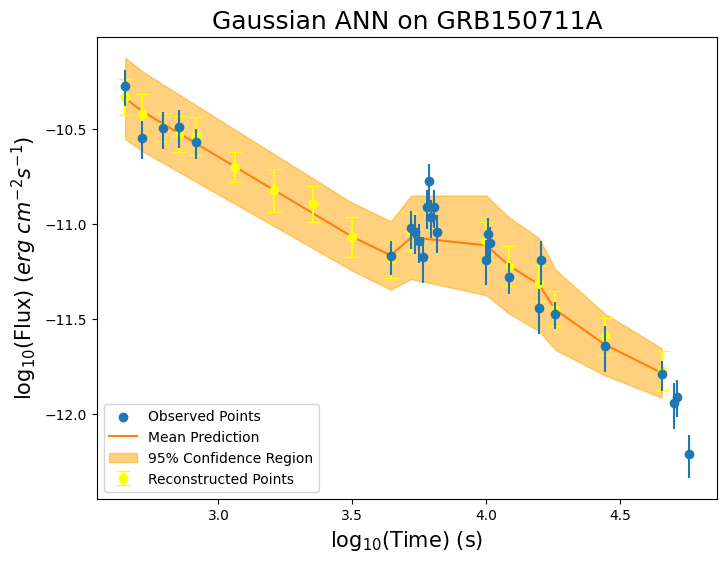


-----TRAINING FOR GRB150801B-----


-----ORIGINAL GRB-----



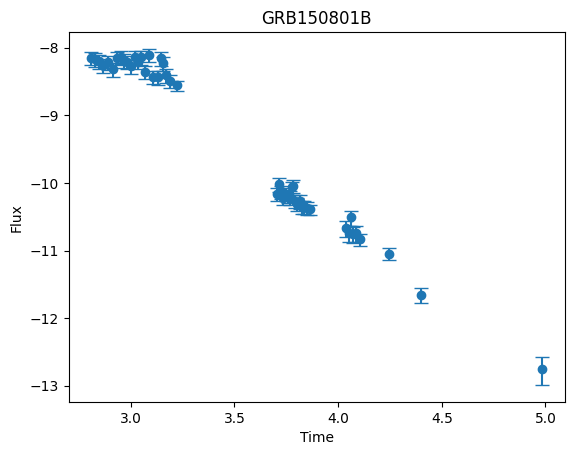


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.3310
Epoch 50, Loss: -1.0298
Epoch 100, Loss: -1.0715
Epoch 150, Loss: -1.0761
Epoch 200, Loss: -0.9991
Epoch 250, Loss: -0.9847
Epoch 300, Loss: -1.1049
Epoch 350, Loss: -1.0850
Epoch 400, Loss: -1.1276
Epoch 450, Loss: -1.1172

-----RECONSTRUCTED GRB-----



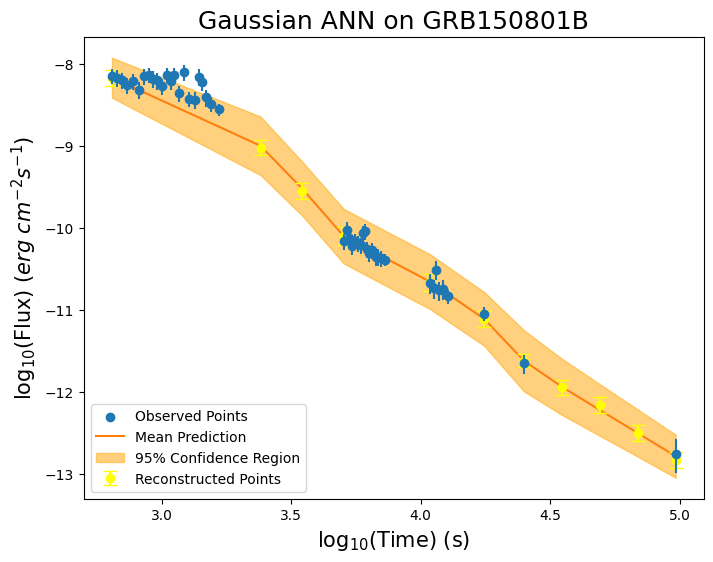


-----TRAINING FOR GRB150817A-----


-----ORIGINAL GRB-----



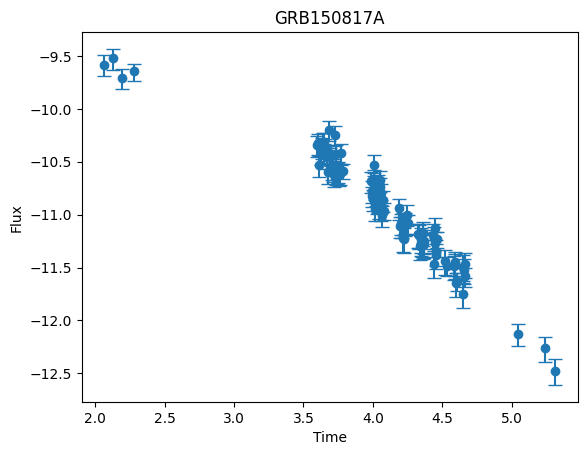


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.0150
Epoch 50, Loss: -0.8643
Epoch 100, Loss: -0.4750
Epoch 150, Loss: -0.7204
Epoch 200, Loss: -0.6418
Epoch 250, Loss: -0.7732
Epoch 300, Loss: -0.4699
Epoch 350, Loss: -0.8251
Epoch 400, Loss: -0.8502
Epoch 450, Loss: -0.6811

-----RECONSTRUCTED GRB-----



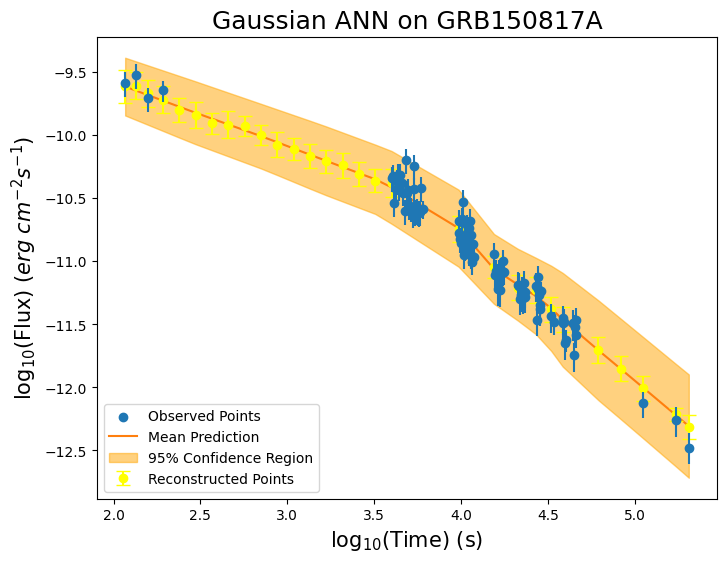


-----TRAINING FOR GRB150911A-----


-----ORIGINAL GRB-----



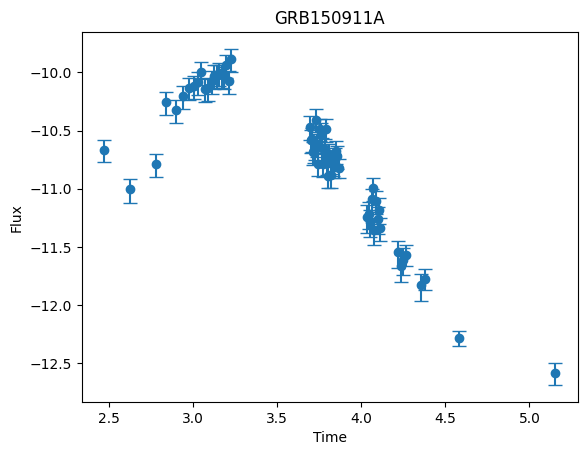


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.5040
Epoch 50, Loss: -0.5527
Epoch 100, Loss: -0.8808
Epoch 150, Loss: -0.9071
Epoch 200, Loss: -0.7902
Epoch 250, Loss: -0.8641
Epoch 300, Loss: -0.6622
Epoch 350, Loss: -0.2642
Epoch 400, Loss: -0.7018
Epoch 450, Loss: -0.6271

-----RECONSTRUCTED GRB-----



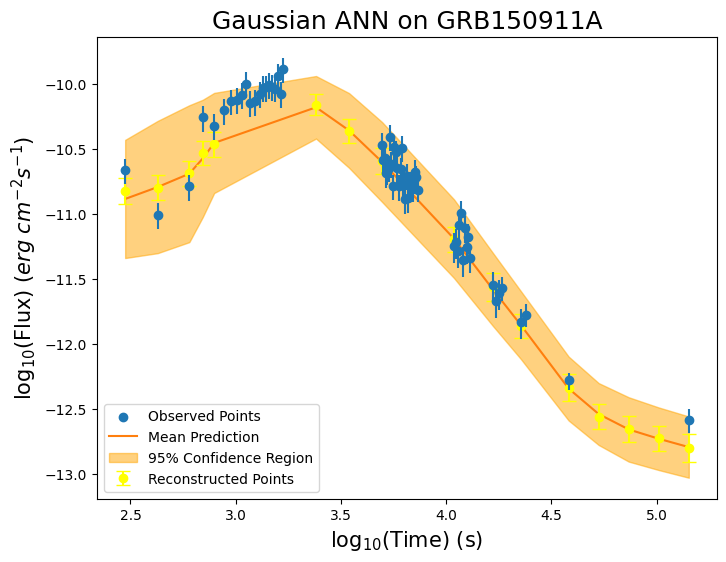


-----TRAINING FOR GRB151001A-----


-----ORIGINAL GRB-----



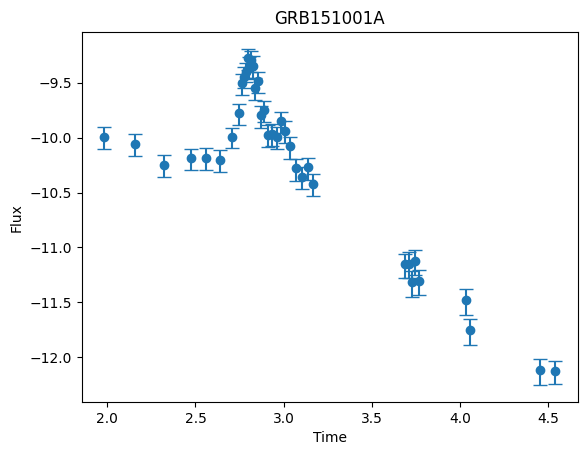


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.1813
Epoch 50, Loss: -0.5197
Epoch 100, Loss: -0.7307
Epoch 150, Loss: -0.9760
Epoch 200, Loss: -0.9370
Epoch 250, Loss: -0.9241
Epoch 300, Loss: -0.9172
Epoch 350, Loss: -0.9670
Epoch 400, Loss: -0.9788
Epoch 450, Loss: -1.0306

-----RECONSTRUCTED GRB-----



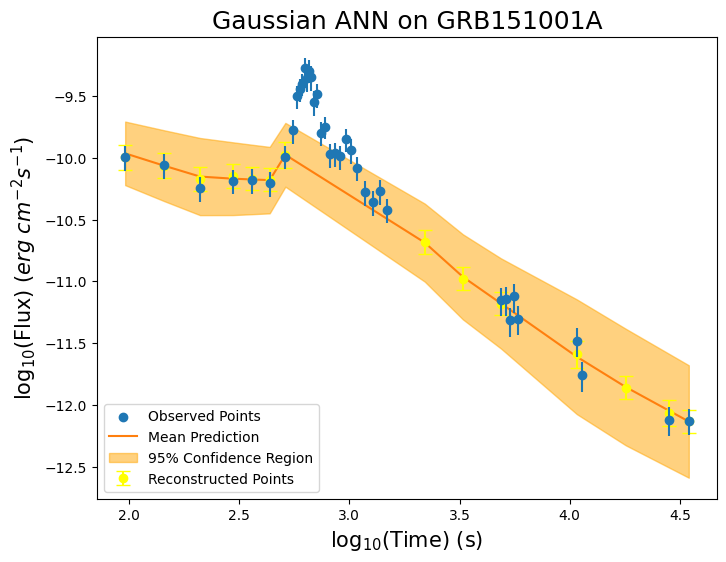


-----TRAINING FOR GRB151114A-----


-----ORIGINAL GRB-----



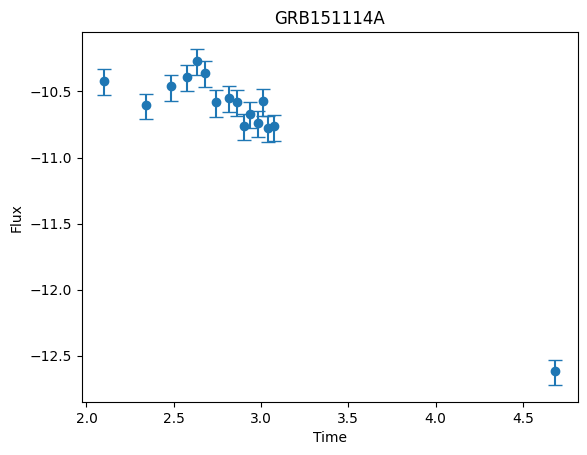


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.4629
Epoch 50, Loss: -0.7631
Epoch 100, Loss: -0.8313
Epoch 150, Loss: -0.8373
Epoch 200, Loss: -0.8436
Epoch 250, Loss: -0.6475
Epoch 300, Loss: -0.8559
Epoch 350, Loss: -0.9009
Epoch 400, Loss: -0.9333
Epoch 450, Loss: -0.9698

-----RECONSTRUCTED GRB-----



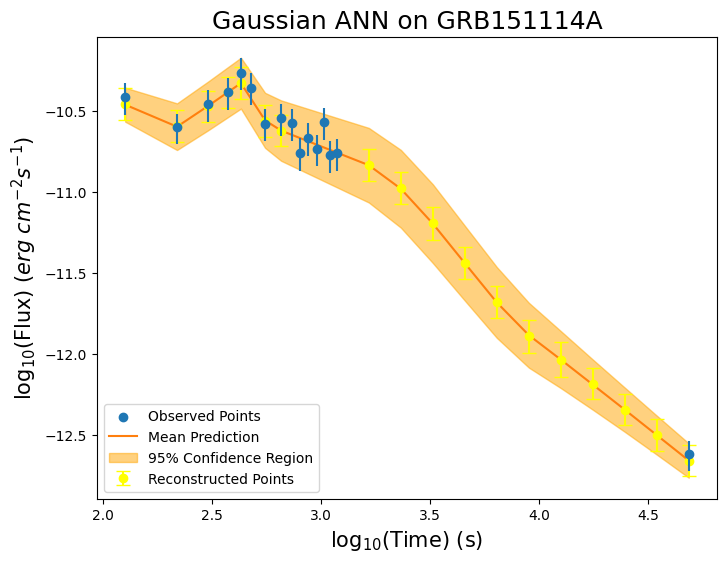


-----TRAINING FOR GRB151118A-----


-----ORIGINAL GRB-----



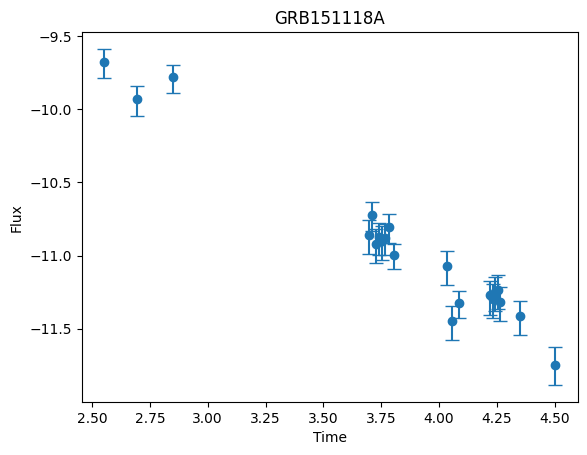


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.5540
Epoch 50, Loss: -0.8048
Epoch 100, Loss: -0.8583
Epoch 150, Loss: -0.8669
Epoch 200, Loss: -0.8875
Epoch 250, Loss: -0.8987
Epoch 300, Loss: -0.9002
Epoch 350, Loss: -0.9167
Epoch 400, Loss: -0.9450
Epoch 450, Loss: -0.8985

-----RECONSTRUCTED GRB-----



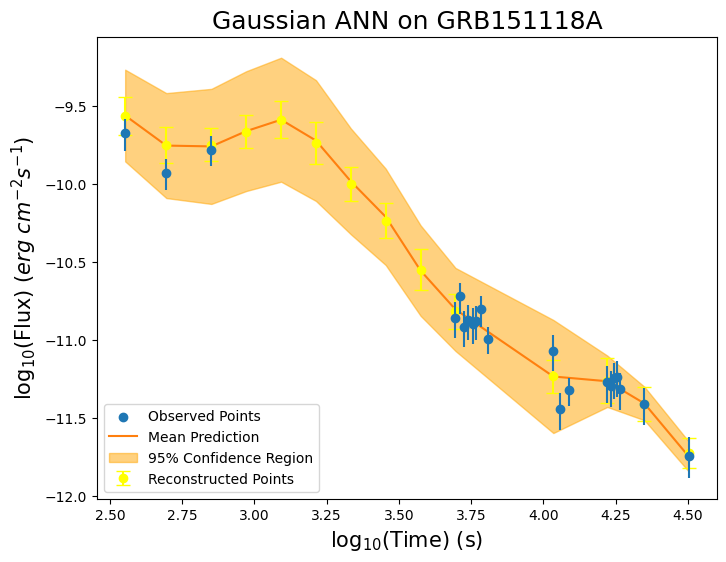


-----TRAINING FOR GRB151205A-----


-----ORIGINAL GRB-----



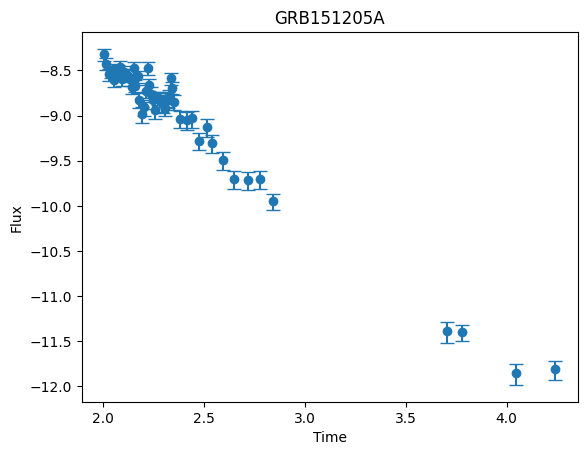


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.2475
Epoch 50, Loss: -0.8224
Epoch 100, Loss: -0.8669
Epoch 150, Loss: -0.8944
Epoch 200, Loss: -0.8958
Epoch 250, Loss: -0.9072
Epoch 300, Loss: -0.9843
Epoch 350, Loss: -0.9888
Epoch 400, Loss: -0.9623
Epoch 450, Loss: -0.9717

-----RECONSTRUCTED GRB-----



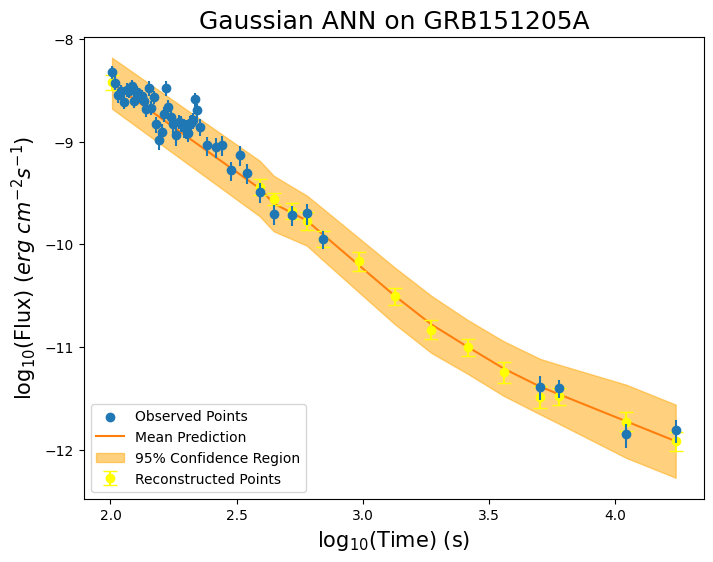


-----TRAINING FOR GRB151228B-----


-----ORIGINAL GRB-----



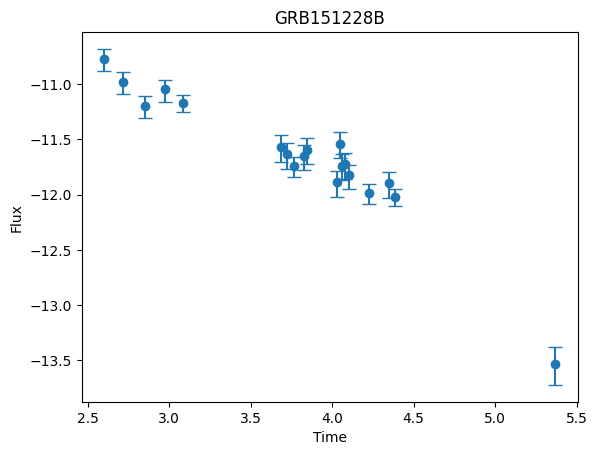


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.5062
Epoch 50, Loss: -0.8220
Epoch 100, Loss: -0.8309
Epoch 150, Loss: -0.8332
Epoch 200, Loss: -0.8411
Epoch 250, Loss: -0.8467
Epoch 300, Loss: -0.8510
Epoch 350, Loss: -0.8382
Epoch 400, Loss: -0.8677
Epoch 450, Loss: -0.8540

-----RECONSTRUCTED GRB-----



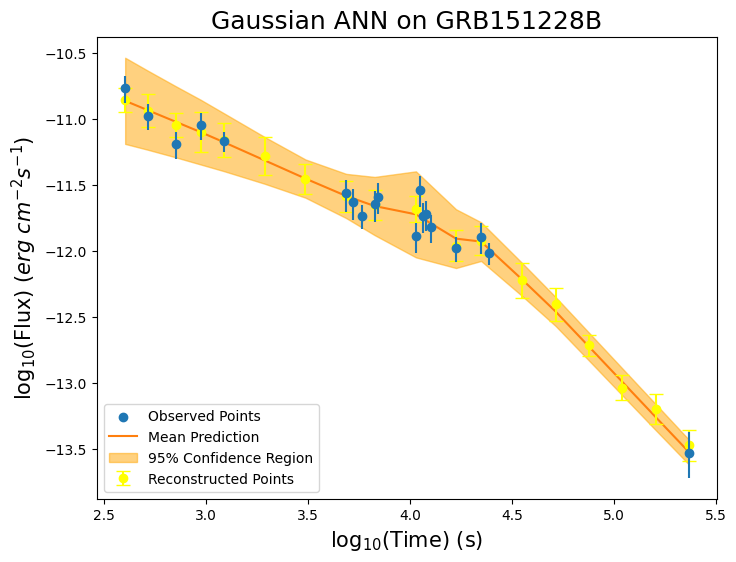


-----TRAINING FOR GRB151229A-----


-----ORIGINAL GRB-----



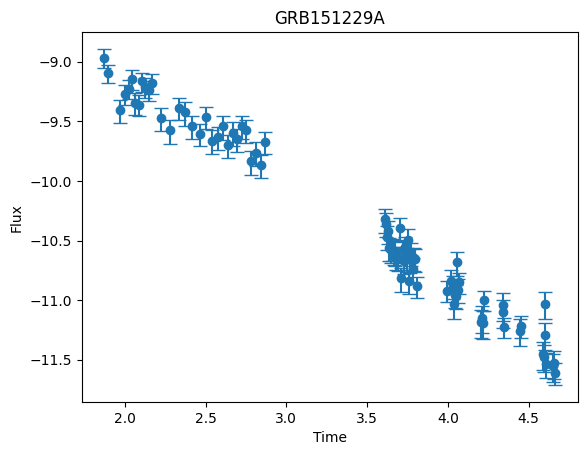


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.2662
Epoch 50, Loss: -0.8641
Epoch 100, Loss: -0.8700
Epoch 150, Loss: -0.7824
Epoch 200, Loss: -0.8263
Epoch 250, Loss: -0.9067
Epoch 300, Loss: -0.8606
Epoch 350, Loss: -0.8591
Epoch 400, Loss: -0.8716
Epoch 450, Loss: -0.7740

-----RECONSTRUCTED GRB-----



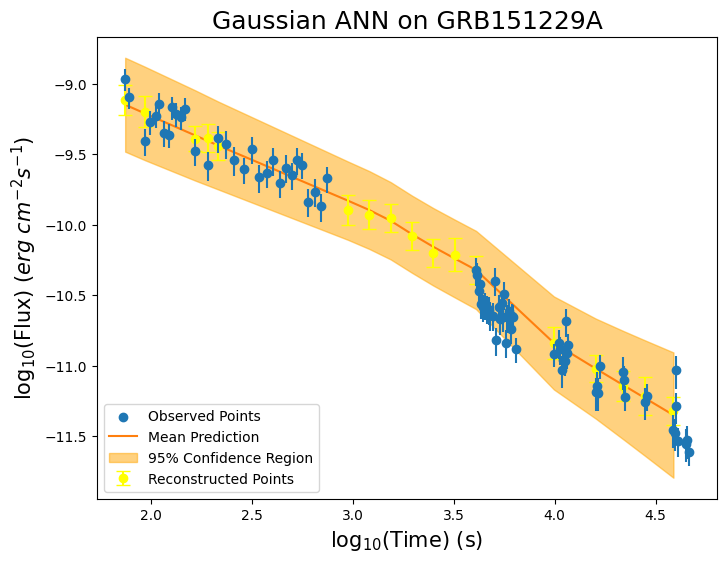


-----TRAINING FOR GRB160104A-----


-----ORIGINAL GRB-----



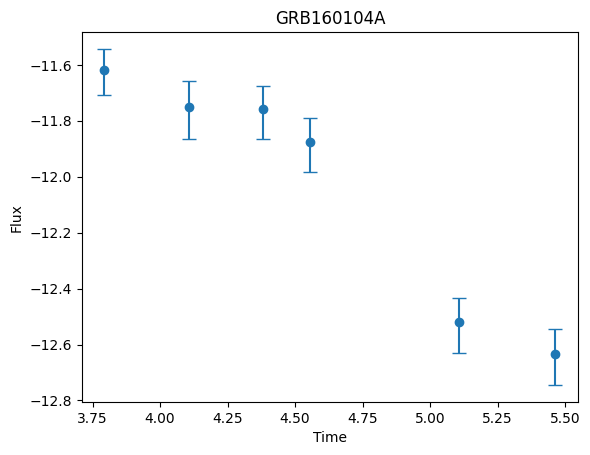


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.6941
Epoch 50, Loss: -0.9582
Epoch 100, Loss: -1.2395
Epoch 150, Loss: -1.2443
Epoch 200, Loss: -1.2099
Epoch 250, Loss: -1.2484
Epoch 300, Loss: -1.2491
Epoch 350, Loss: -1.2456
Epoch 400, Loss: -1.2483
Epoch 450, Loss: -1.2441

-----RECONSTRUCTED GRB-----



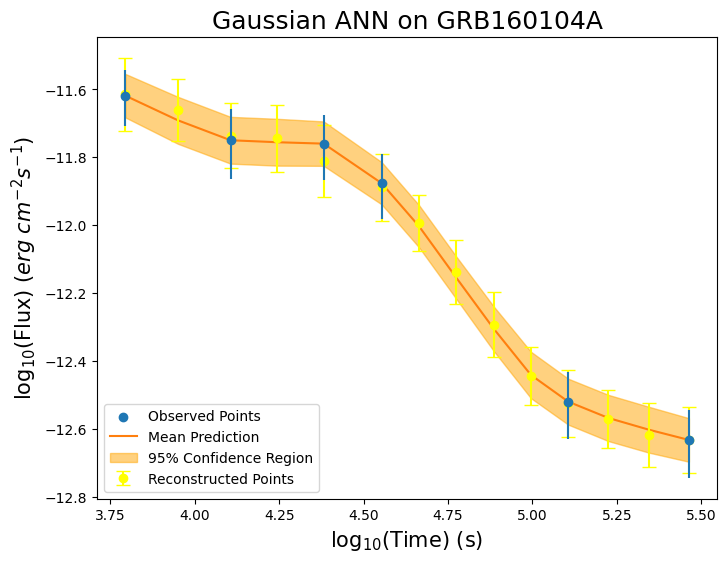


-----TRAINING FOR GRB160119A-----


-----ORIGINAL GRB-----



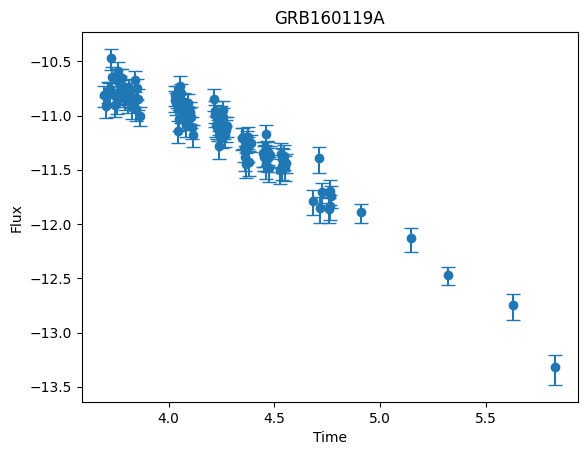


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.2195
Epoch 50, Loss: -0.6883
Epoch 100, Loss: -0.6106
Epoch 150, Loss: -0.4265
Epoch 200, Loss: -0.7085
Epoch 250, Loss: -0.5378
Epoch 300, Loss: -0.6595
Epoch 350, Loss: -0.6396
Epoch 400, Loss: -0.6024
Epoch 450, Loss: -0.5420

-----RECONSTRUCTED GRB-----



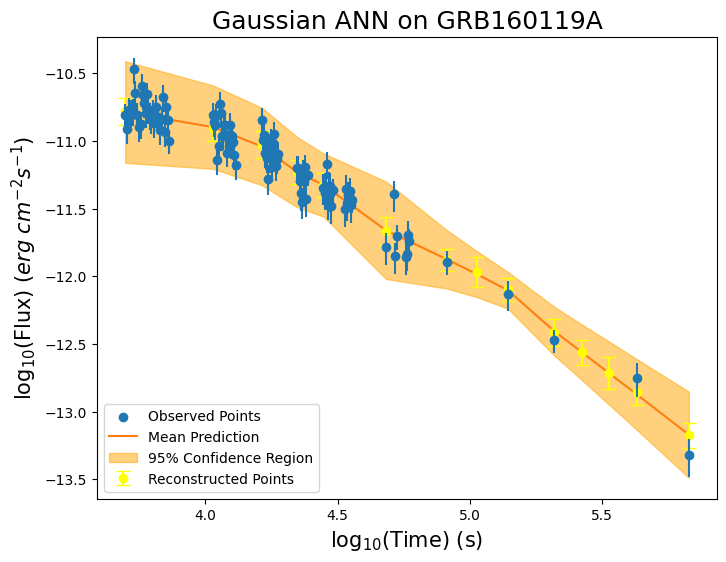


-----TRAINING FOR GRB160123A-----


-----ORIGINAL GRB-----



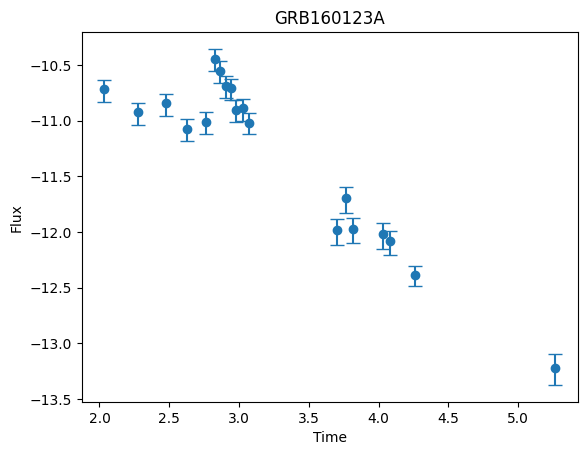


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.4673
Epoch 50, Loss: -0.7619
Epoch 100, Loss: -0.8414
Epoch 150, Loss: -0.9692
Epoch 200, Loss: -0.9012
Epoch 250, Loss: -1.0350
Epoch 300, Loss: -1.0319
Epoch 350, Loss: -1.0528
Epoch 400, Loss: -1.0578
Epoch 450, Loss: -1.0650

-----RECONSTRUCTED GRB-----



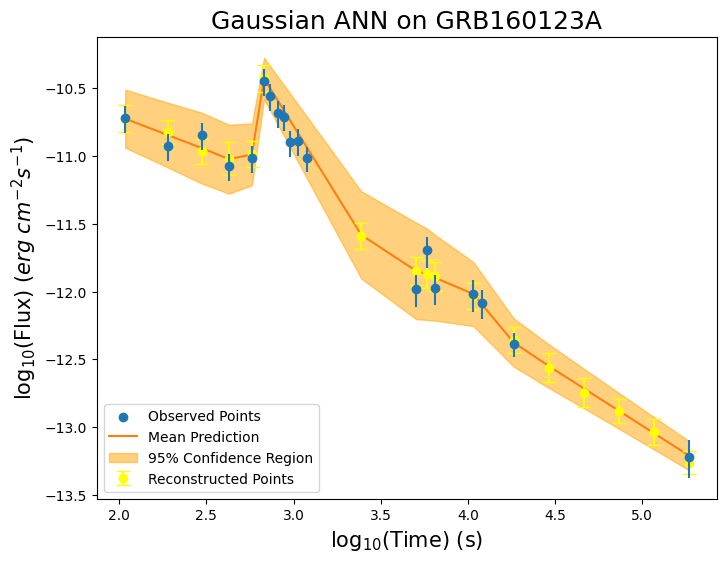


-----TRAINING FOR GRB160127A-----


-----ORIGINAL GRB-----



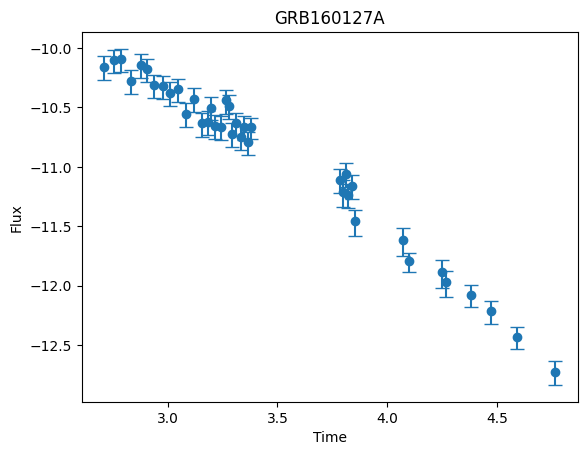


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.4258
Epoch 50, Loss: -0.8549
Epoch 100, Loss: -0.9655
Epoch 150, Loss: -0.7773
Epoch 200, Loss: -0.8190
Epoch 250, Loss: -0.9748
Epoch 300, Loss: -0.8973
Epoch 350, Loss: -0.8010
Epoch 400, Loss: -0.9919
Epoch 450, Loss: -1.0304

-----RECONSTRUCTED GRB-----



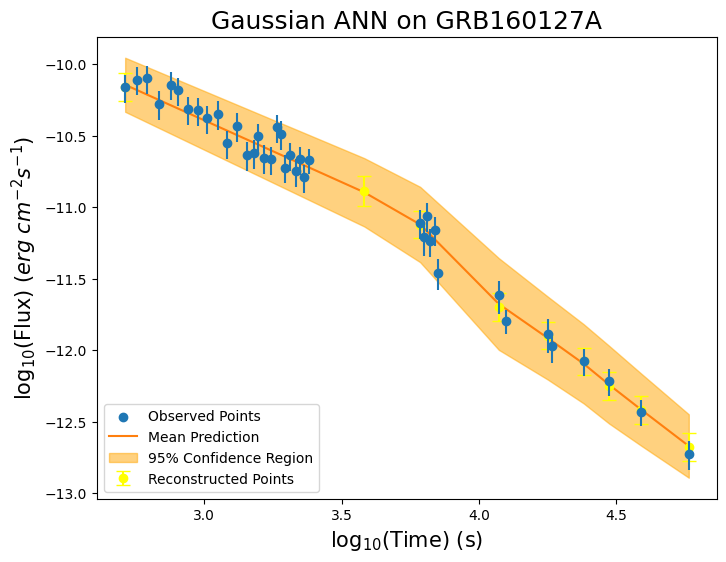


-----TRAINING FOR GRB160412A-----


-----ORIGINAL GRB-----



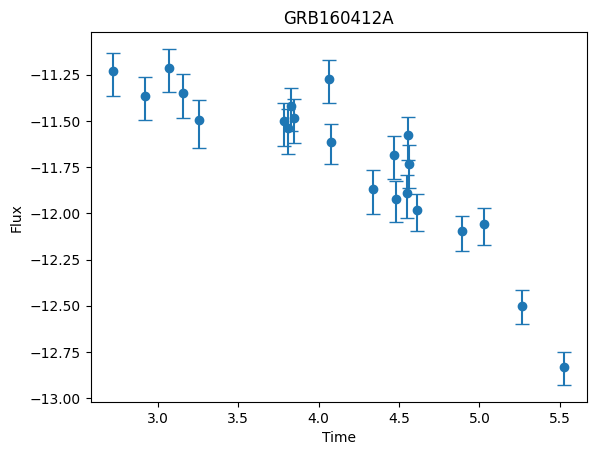


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.7730
Epoch 50, Loss: -0.5396
Epoch 100, Loss: -0.5822
Epoch 150, Loss: -0.6028
Epoch 200, Loss: -0.6250
Epoch 250, Loss: -0.6633
Epoch 300, Loss: -0.7013
Epoch 350, Loss: -0.6582
Epoch 400, Loss: -0.7451
Epoch 450, Loss: -0.7370

-----RECONSTRUCTED GRB-----



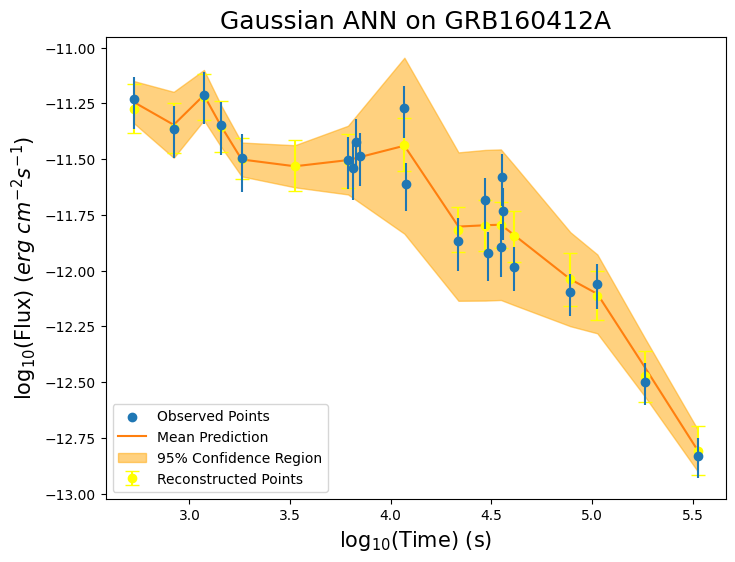


-----TRAINING FOR GRB160417A-----


-----ORIGINAL GRB-----



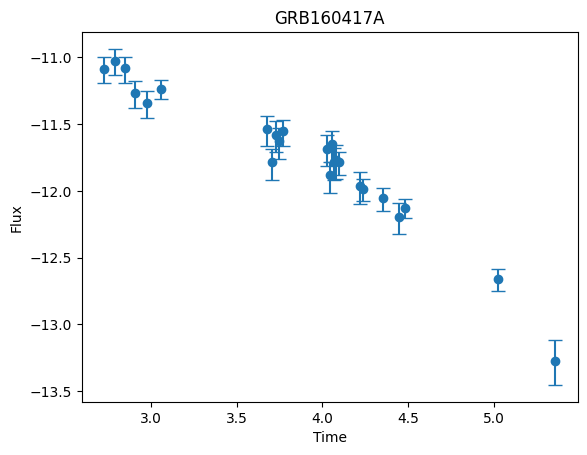


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.6709
Epoch 50, Loss: -0.8297
Epoch 100, Loss: -0.8789
Epoch 150, Loss: -0.8535
Epoch 200, Loss: -0.9065
Epoch 250, Loss: -0.9114
Epoch 300, Loss: -0.9152
Epoch 350, Loss: -0.9195
Epoch 400, Loss: -0.9264
Epoch 450, Loss: -0.9229

-----RECONSTRUCTED GRB-----



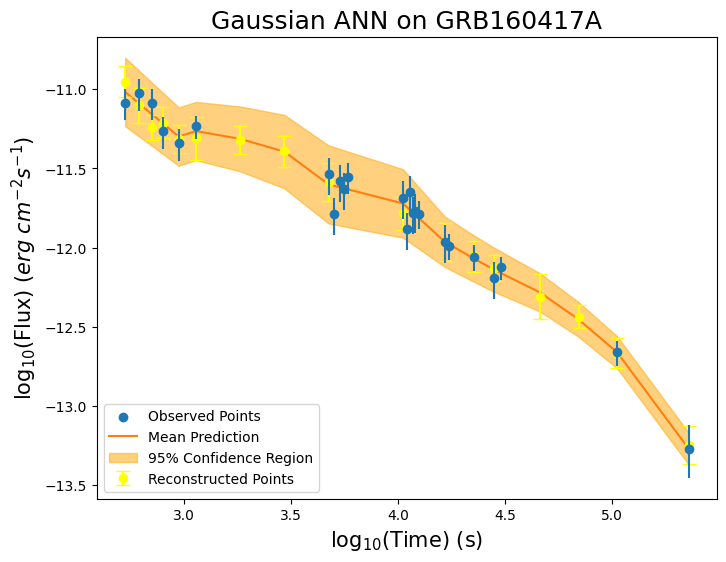


-----TRAINING FOR GRB160504A-----


-----ORIGINAL GRB-----



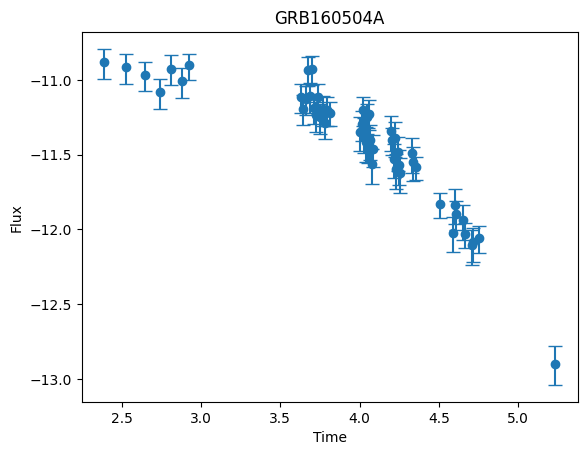


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.2759
Epoch 50, Loss: -0.6795
Epoch 100, Loss: -0.7714
Epoch 150, Loss: -0.7635
Epoch 200, Loss: -0.7107
Epoch 250, Loss: -0.6105
Epoch 300, Loss: -0.8213
Epoch 350, Loss: -0.6251
Epoch 400, Loss: -0.7306
Epoch 450, Loss: -0.7378

-----RECONSTRUCTED GRB-----



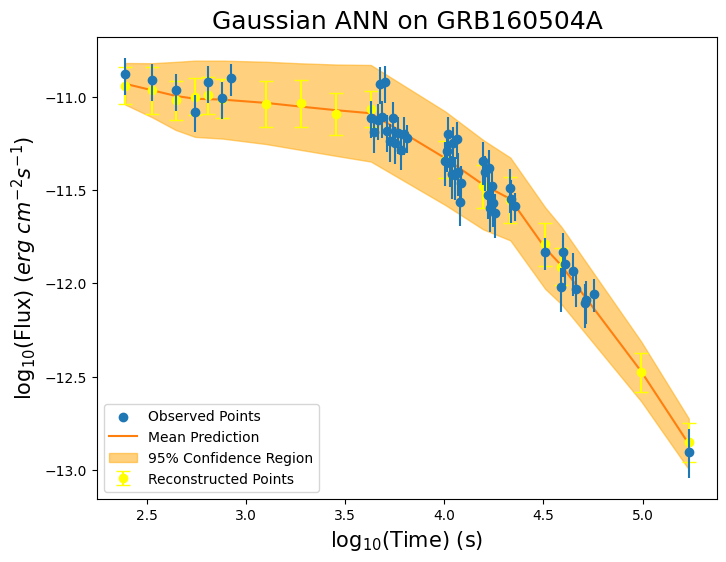


-----TRAINING FOR GRB160630A-----


-----ORIGINAL GRB-----



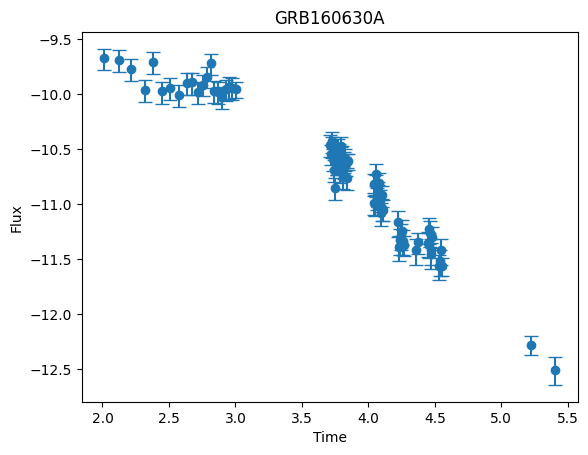


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.4132
Epoch 50, Loss: -0.6698
Epoch 100, Loss: -0.8250
Epoch 150, Loss: -0.7641
Epoch 200, Loss: -0.7060
Epoch 250, Loss: -0.8647
Epoch 300, Loss: -0.9371
Epoch 350, Loss: -0.8734
Epoch 400, Loss: -0.8482
Epoch 450, Loss: -0.9340

-----RECONSTRUCTED GRB-----



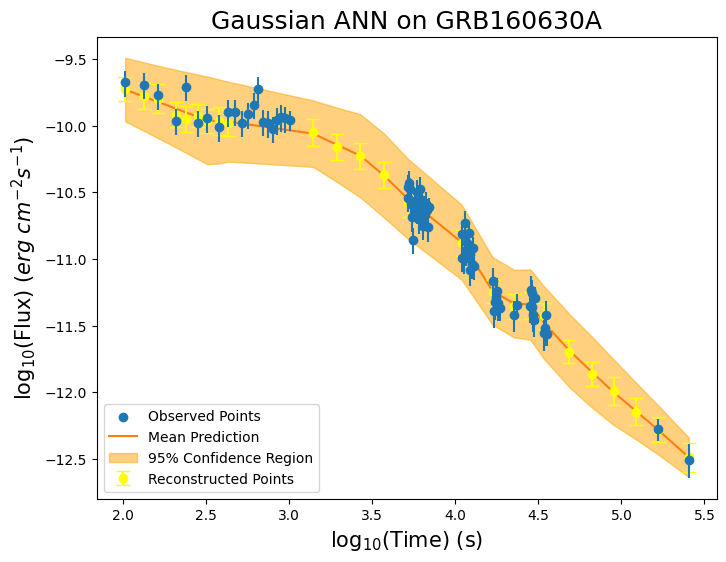


-----TRAINING FOR GRB160705B-----


-----ORIGINAL GRB-----



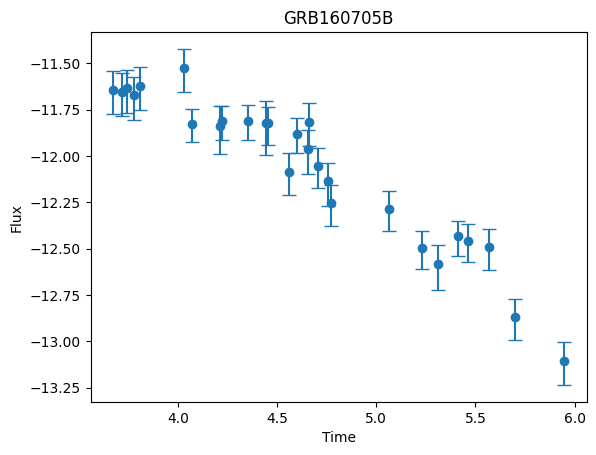


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.4683
Epoch 50, Loss: -0.6734
Epoch 100, Loss: -0.7226
Epoch 150, Loss: -0.7657
Epoch 200, Loss: -0.8178
Epoch 250, Loss: -0.8588
Epoch 300, Loss: -0.8841
Epoch 350, Loss: -0.8261
Epoch 400, Loss: -0.9141
Epoch 450, Loss: -0.9169

-----RECONSTRUCTED GRB-----



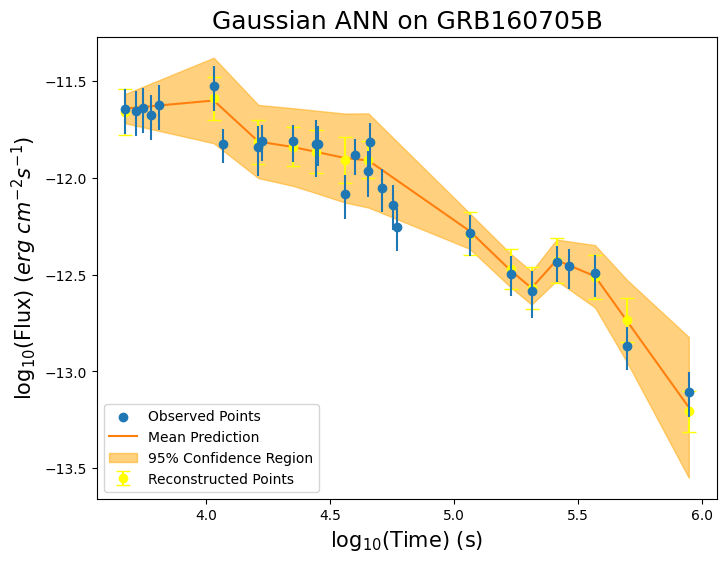


-----TRAINING FOR GRB160815A-----


-----ORIGINAL GRB-----



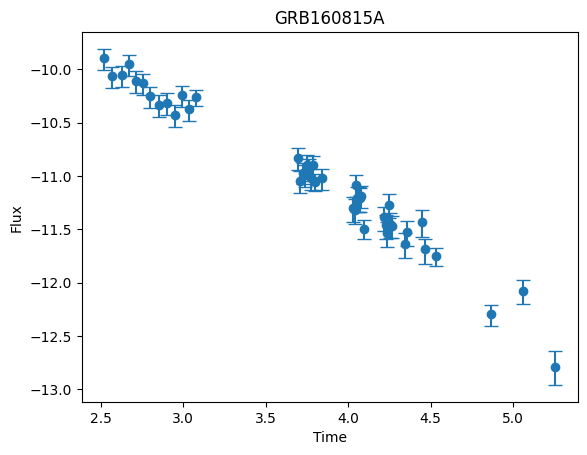


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.2487
Epoch 50, Loss: -0.9055
Epoch 100, Loss: -0.8700
Epoch 150, Loss: -0.8006
Epoch 200, Loss: -0.7943
Epoch 250, Loss: -0.9576
Epoch 300, Loss: -0.8352
Epoch 350, Loss: -0.8427
Epoch 400, Loss: -0.7703
Epoch 450, Loss: -0.8796

-----RECONSTRUCTED GRB-----



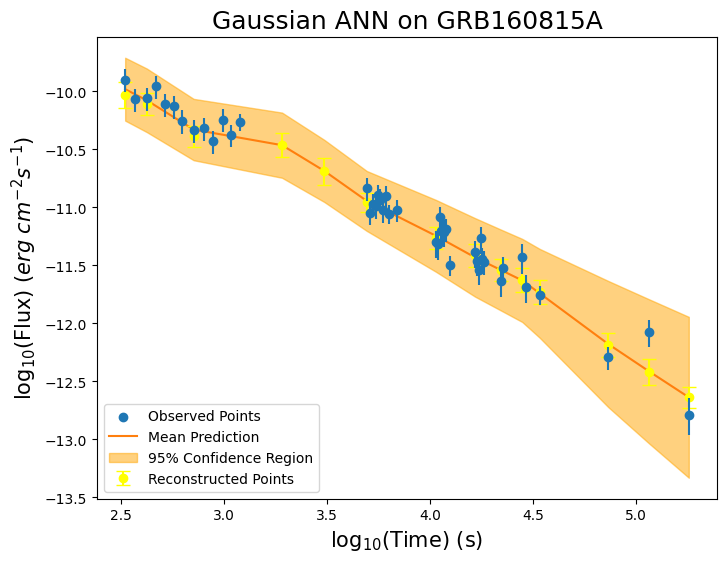


-----TRAINING FOR GRB160824A-----


-----ORIGINAL GRB-----



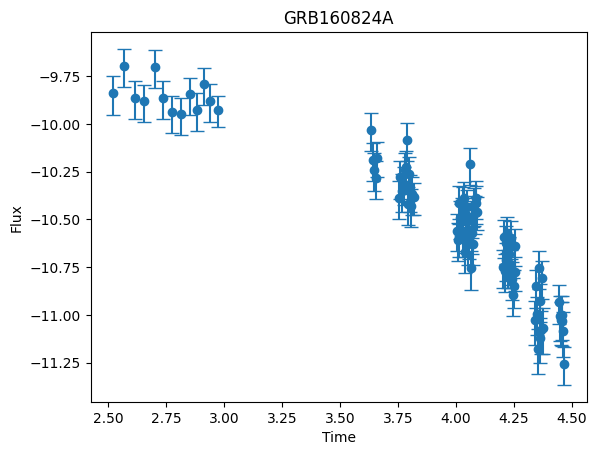


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.3384
Epoch 50, Loss: -0.4012
Epoch 100, Loss: -0.5478
Epoch 150, Loss: -0.5019
Epoch 200, Loss: -0.4761
Epoch 250, Loss: -0.4731
Epoch 300, Loss: -0.6140
Epoch 350, Loss: -0.5564
Epoch 400, Loss: -0.6250
Epoch 450, Loss: -0.5777

-----RECONSTRUCTED GRB-----



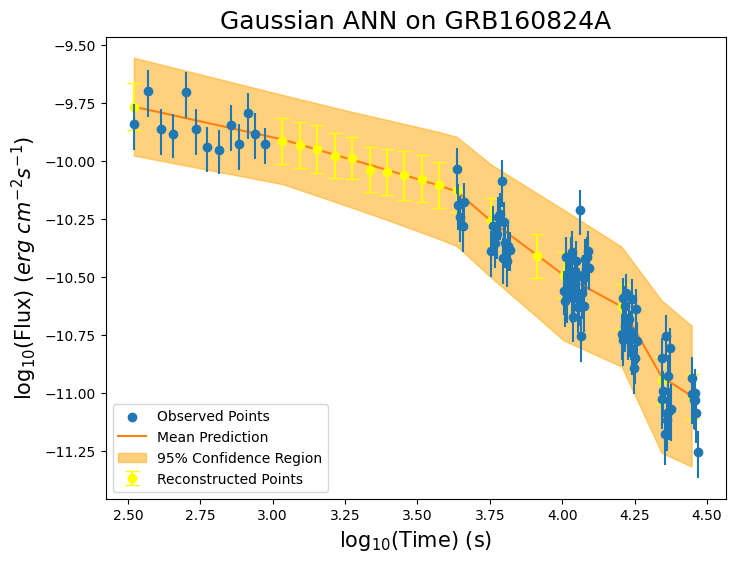


-----TRAINING FOR GRB160905A-----


-----ORIGINAL GRB-----



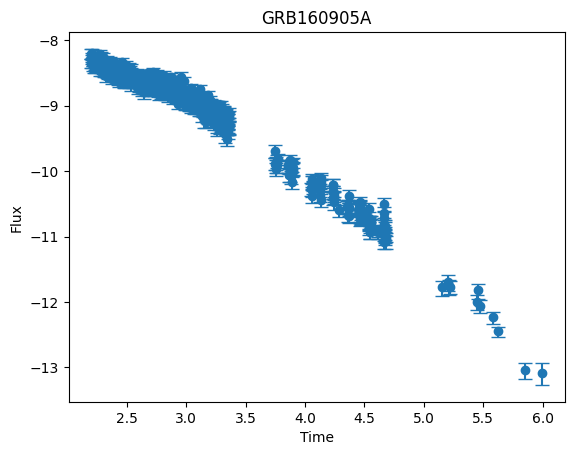


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: -0.6544
Epoch 50, Loss: -0.9756
Epoch 100, Loss: -0.9217
Epoch 150, Loss: -0.8835
Epoch 200, Loss: -0.9328
Epoch 250, Loss: -0.9376
Epoch 300, Loss: -0.9384
Epoch 350, Loss: -0.9769
Epoch 400, Loss: -0.9252
Epoch 450, Loss: -0.9619

-----RECONSTRUCTED GRB-----



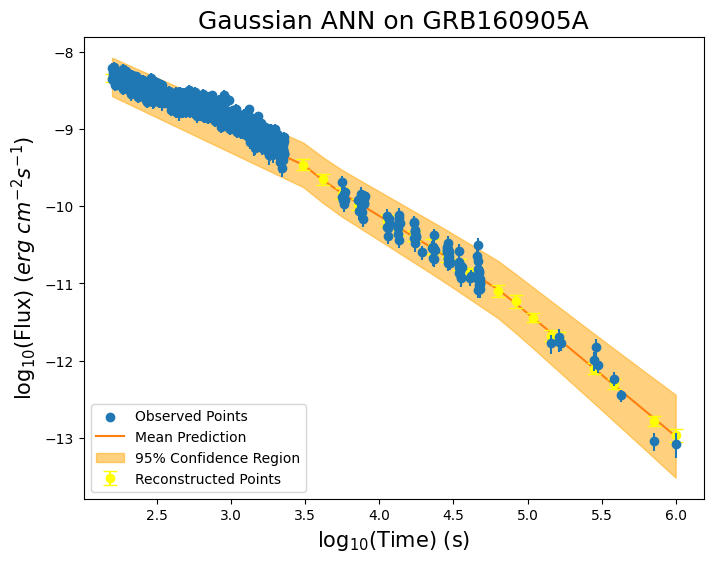


-----TRAINING FOR GRB161001A-----


-----ORIGINAL GRB-----



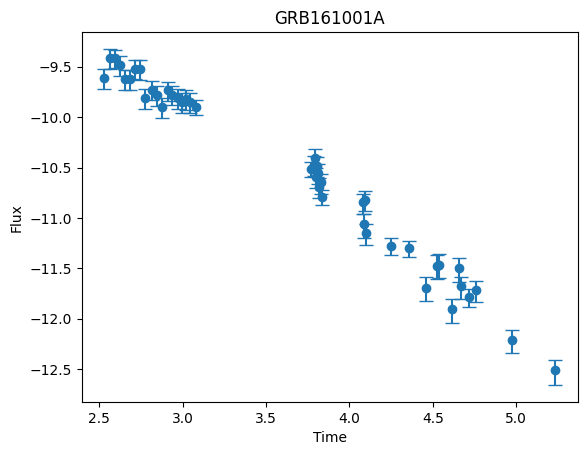


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.5421
Epoch 50, Loss: -0.8396
Epoch 100, Loss: -0.9276
Epoch 150, Loss: -0.8715
Epoch 200, Loss: -0.8199
Epoch 250, Loss: -0.9103
Epoch 300, Loss: -0.9276
Epoch 350, Loss: -0.8667
Epoch 400, Loss: -0.9192
Epoch 450, Loss: -0.9337

-----RECONSTRUCTED GRB-----



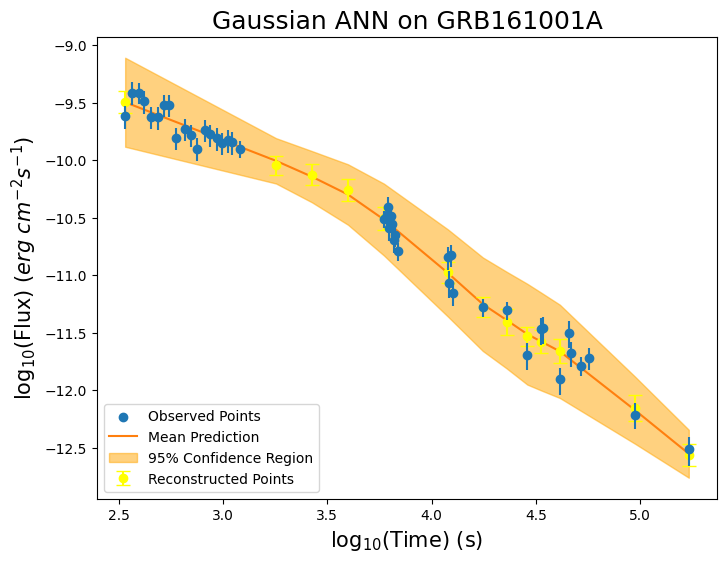


-----TRAINING FOR GRB161004B-----


-----ORIGINAL GRB-----



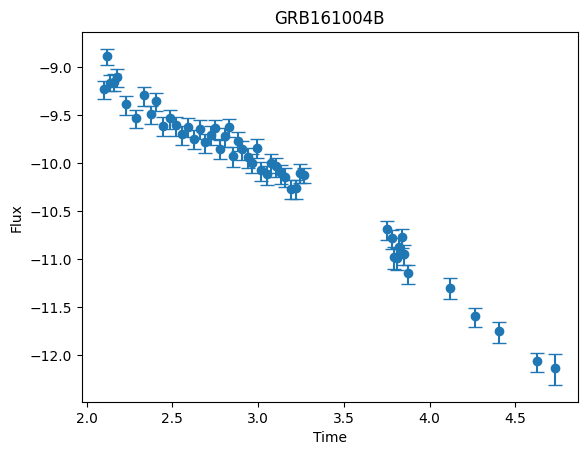


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.2950
Epoch 50, Loss: -0.9365
Epoch 100, Loss: -0.9075
Epoch 150, Loss: -0.8228
Epoch 200, Loss: -0.8974
Epoch 250, Loss: -0.9033
Epoch 300, Loss: -0.9462
Epoch 350, Loss: -0.9225
Epoch 400, Loss: -0.9115
Epoch 450, Loss: -0.8826

-----RECONSTRUCTED GRB-----



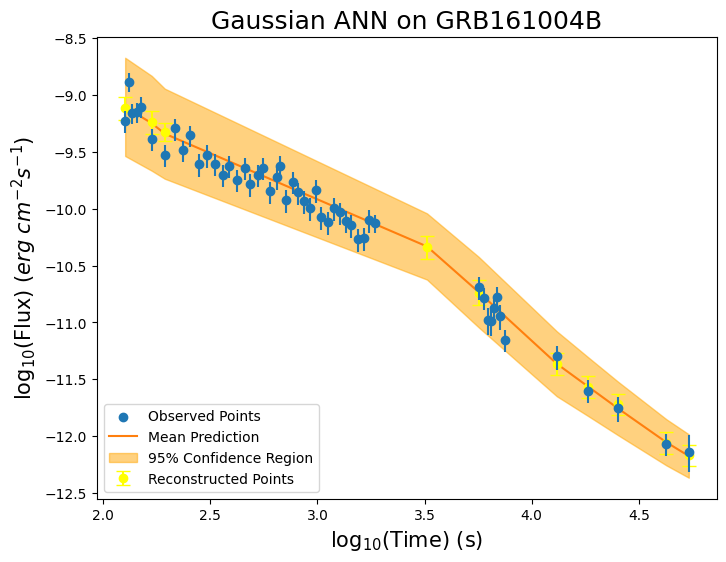


-----TRAINING FOR GRB161113A-----


-----ORIGINAL GRB-----



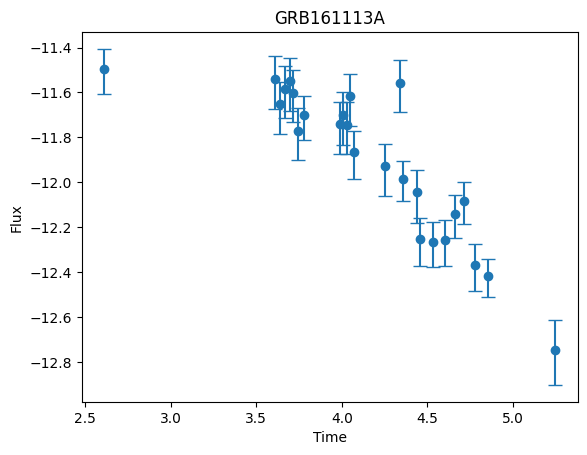


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.4444
Epoch 50, Loss: -0.5230
Epoch 100, Loss: -0.5684
Epoch 150, Loss: -0.5965
Epoch 200, Loss: -0.6160
Epoch 250, Loss: -0.6401
Epoch 300, Loss: -0.6596
Epoch 350, Loss: -0.6719
Epoch 400, Loss: -0.6858
Epoch 450, Loss: -0.7101

-----RECONSTRUCTED GRB-----



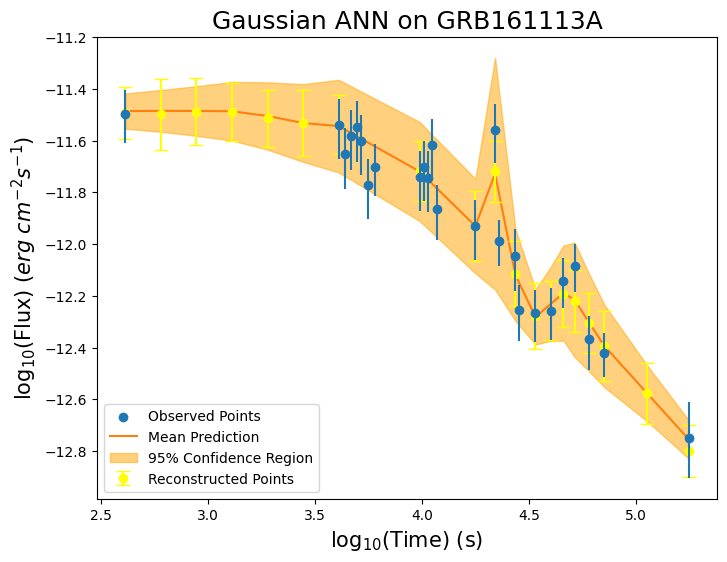


-----TRAINING FOR GRB161214B-----


-----ORIGINAL GRB-----



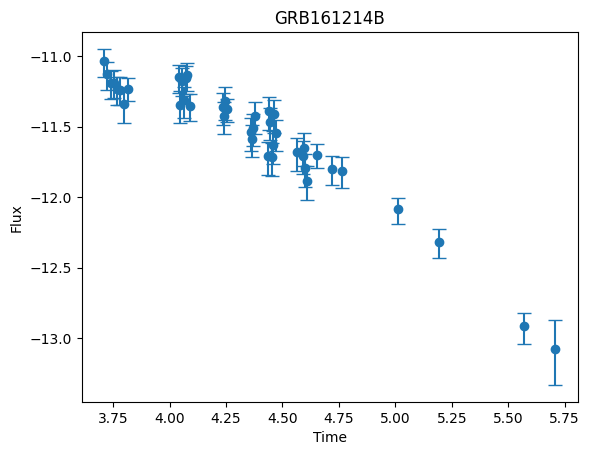


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.3005
Epoch 50, Loss: -0.6536
Epoch 100, Loss: -0.6004
Epoch 150, Loss: -0.7886
Epoch 200, Loss: -0.8870
Epoch 250, Loss: -0.7796
Epoch 300, Loss: -0.7324
Epoch 350, Loss: -0.7097
Epoch 400, Loss: -0.7695
Epoch 450, Loss: -0.7898

-----RECONSTRUCTED GRB-----



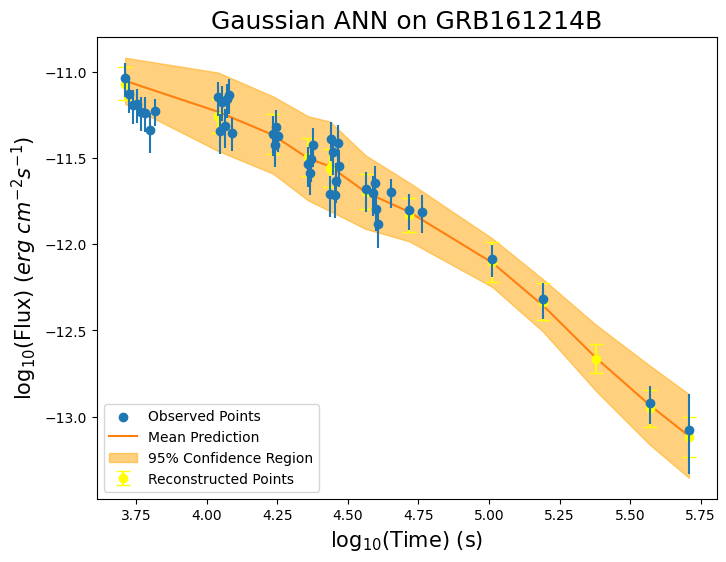


-----TRAINING FOR GRB161217A-----


-----ORIGINAL GRB-----



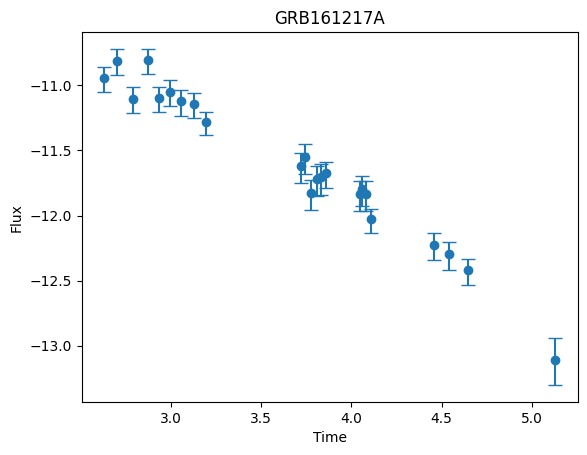


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.5379
Epoch 50, Loss: -0.8736
Epoch 100, Loss: -0.8926
Epoch 150, Loss: -0.9029
Epoch 200, Loss: -0.9144
Epoch 250, Loss: -0.9109
Epoch 300, Loss: -0.9305
Epoch 350, Loss: -0.9399
Epoch 400, Loss: -0.9484
Epoch 450, Loss: -0.9564

-----RECONSTRUCTED GRB-----



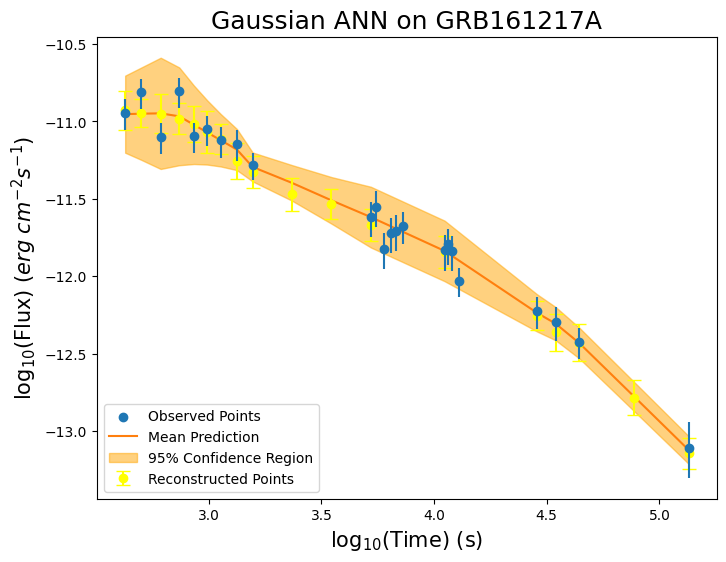


-----TRAINING FOR GRB170208B-----


-----ORIGINAL GRB-----



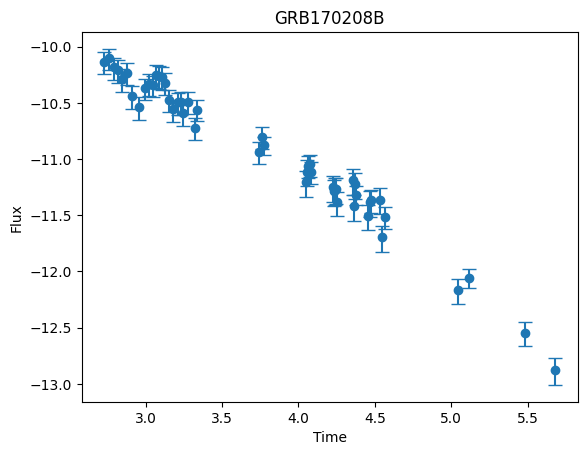


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.3203
Epoch 50, Loss: -0.8701
Epoch 100, Loss: -0.8082
Epoch 150, Loss: -0.8797
Epoch 200, Loss: -0.8727
Epoch 250, Loss: -0.7745
Epoch 300, Loss: -0.8464
Epoch 350, Loss: -0.8253
Epoch 400, Loss: -0.9038
Epoch 450, Loss: -0.8899

-----RECONSTRUCTED GRB-----



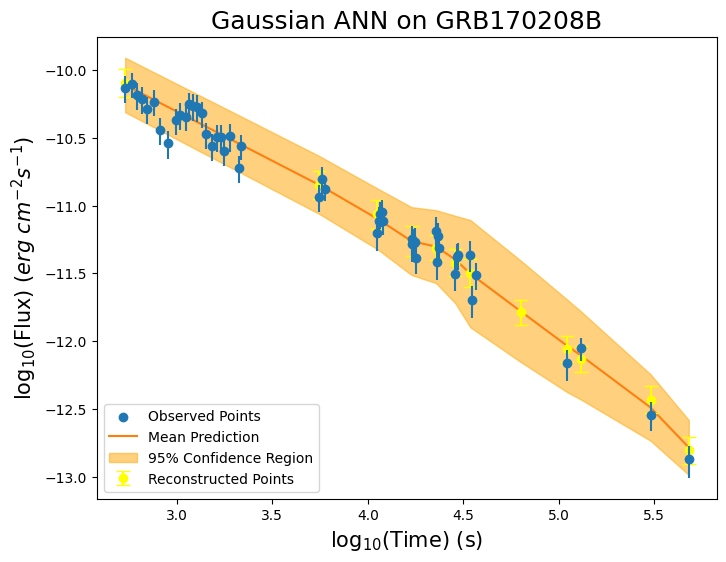


-----TRAINING FOR GRB170317A-----


-----ORIGINAL GRB-----



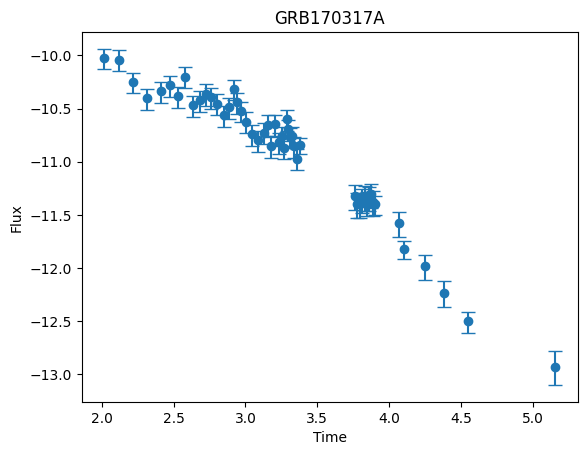


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.2681
Epoch 50, Loss: -0.8337
Epoch 100, Loss: -0.7599
Epoch 150, Loss: -0.9271
Epoch 200, Loss: -0.9105
Epoch 250, Loss: -0.9499
Epoch 300, Loss: -0.9277
Epoch 350, Loss: -0.9722
Epoch 400, Loss: -0.9614
Epoch 450, Loss: -0.8655

-----RECONSTRUCTED GRB-----



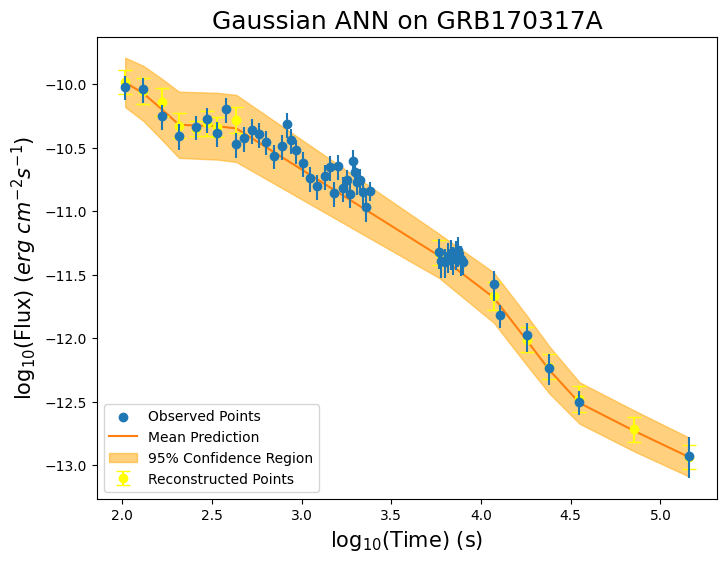


-----TRAINING FOR GRB170331A-----


-----ORIGINAL GRB-----



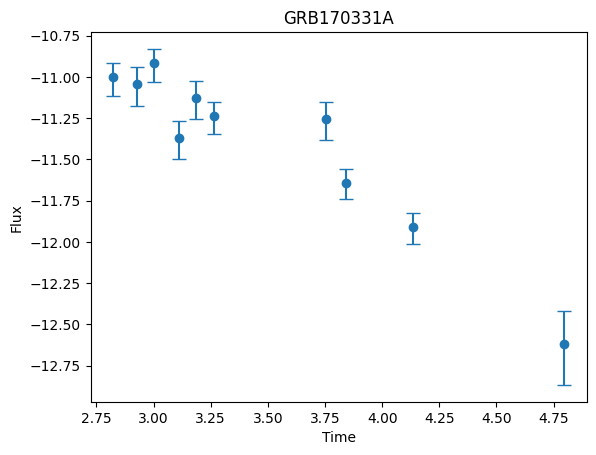


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.5215
Epoch 50, Loss: -0.7054
Epoch 100, Loss: -0.7507
Epoch 150, Loss: -0.7260
Epoch 200, Loss: -0.7314
Epoch 250, Loss: -0.7814
Epoch 300, Loss: -0.9122
Epoch 350, Loss: -0.9341
Epoch 400, Loss: -0.9508
Epoch 450, Loss: -0.9710

-----RECONSTRUCTED GRB-----



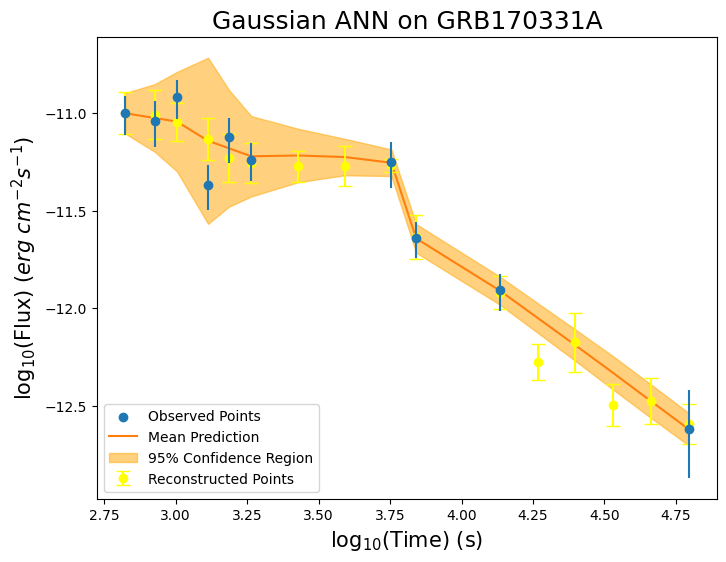


-----TRAINING FOR GRB170711A-----


-----ORIGINAL GRB-----



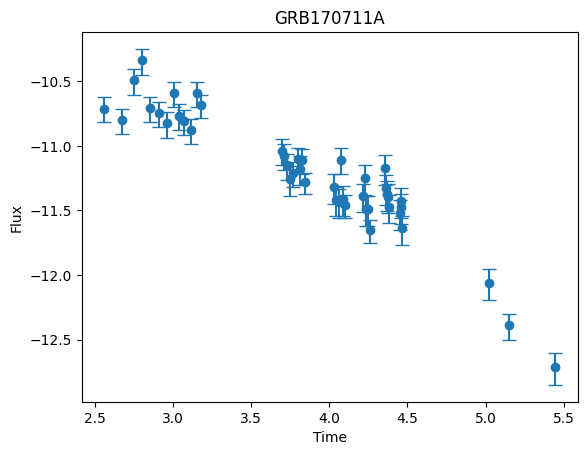


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.4966
Epoch 50, Loss: -0.7599
Epoch 100, Loss: -0.4850
Epoch 150, Loss: -0.6631
Epoch 200, Loss: -0.5187
Epoch 250, Loss: -0.5640
Epoch 300, Loss: -0.5169
Epoch 350, Loss: -0.5846
Epoch 400, Loss: -0.6843
Epoch 450, Loss: -0.7100

-----RECONSTRUCTED GRB-----



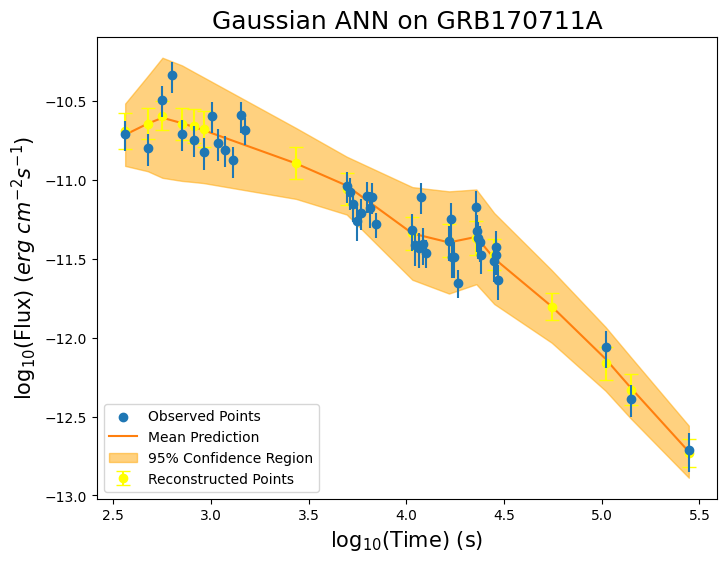


-----TRAINING FOR GRB170803A-----


-----ORIGINAL GRB-----



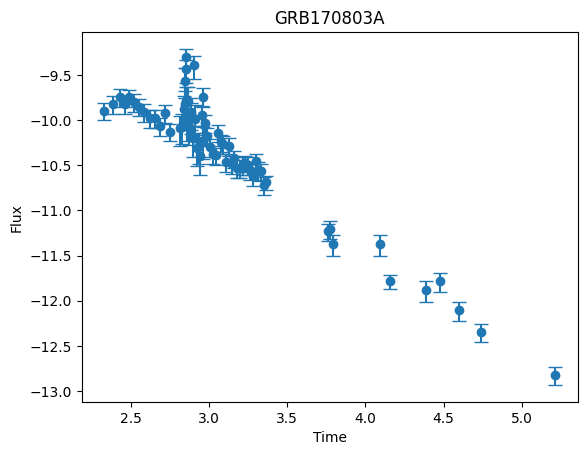


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.3651
Epoch 50, Loss: -0.6279
Epoch 100, Loss: -0.4962
Epoch 150, Loss: -0.9313
Epoch 200, Loss: -0.7774
Epoch 250, Loss: -0.9268
Epoch 300, Loss: -0.7695
Epoch 350, Loss: -0.3797
Epoch 400, Loss: -0.7489
Epoch 450, Loss: -0.7478

-----RECONSTRUCTED GRB-----



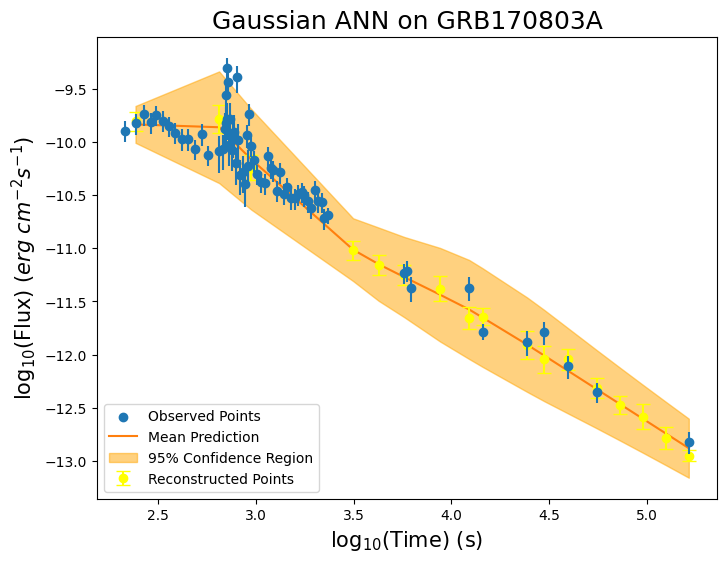


-----TRAINING FOR GRB170822A-----


-----ORIGINAL GRB-----



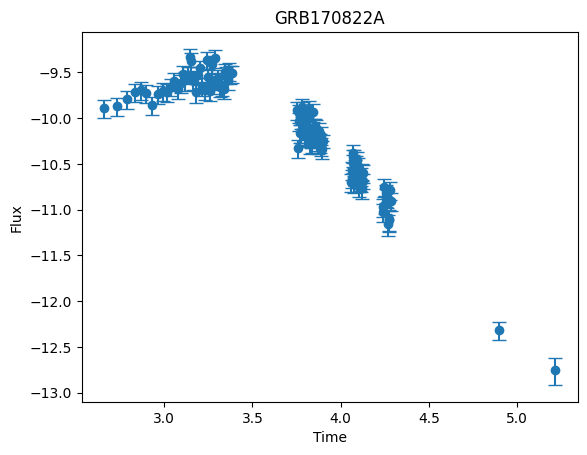


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.1070
Epoch 50, Loss: -0.7161
Epoch 100, Loss: -0.5597
Epoch 150, Loss: -0.7013
Epoch 200, Loss: -0.7882
Epoch 250, Loss: -0.6803
Epoch 300, Loss: -0.6611
Epoch 350, Loss: -0.6798
Epoch 400, Loss: -0.8386
Epoch 450, Loss: -0.6476

-----RECONSTRUCTED GRB-----



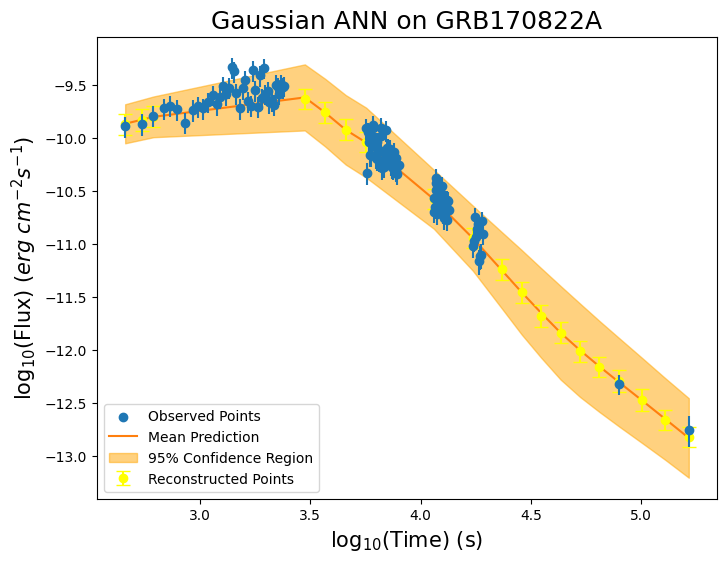


-----TRAINING FOR GRB171027A-----


-----ORIGINAL GRB-----



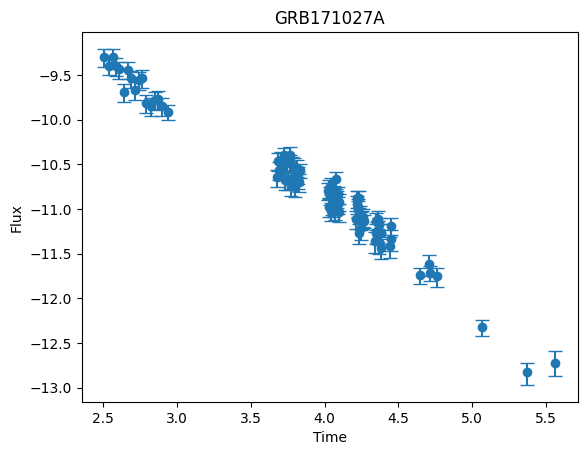


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.2584
Epoch 50, Loss: -0.8222
Epoch 100, Loss: -0.7891
Epoch 150, Loss: -0.9574
Epoch 200, Loss: -0.8322
Epoch 250, Loss: -0.8639
Epoch 300, Loss: -0.8591
Epoch 350, Loss: -0.8367
Epoch 400, Loss: -0.8127
Epoch 450, Loss: -0.8787

-----RECONSTRUCTED GRB-----



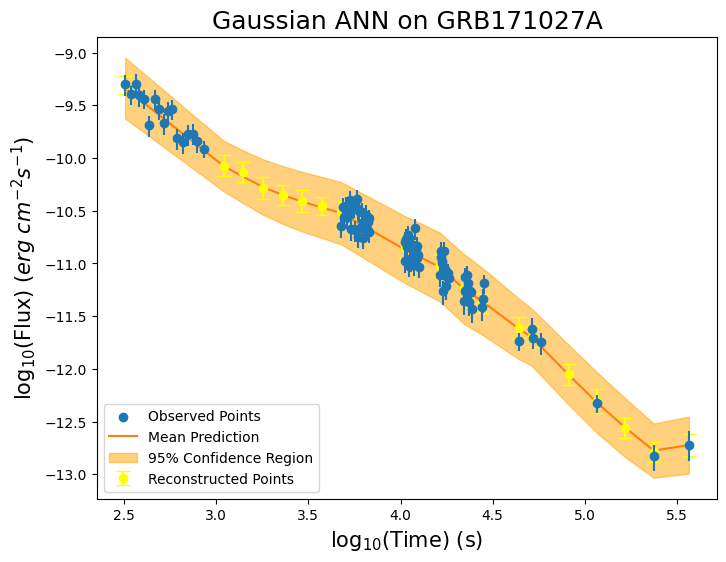


-----TRAINING FOR GRB171120A-----


-----ORIGINAL GRB-----



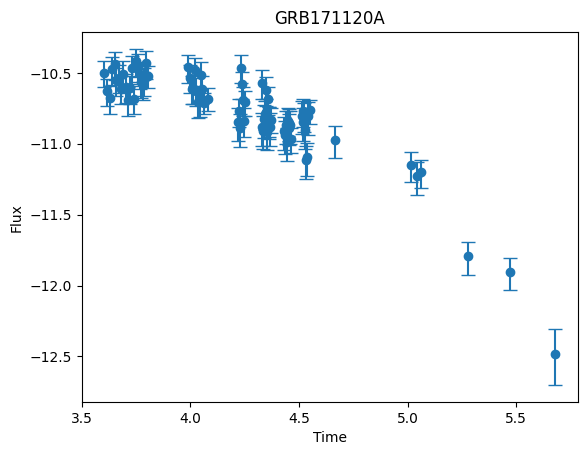


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.2057
Epoch 50, Loss: -0.4046
Epoch 100, Loss: -0.3965
Epoch 150, Loss: -0.5021
Epoch 200, Loss: -0.3068
Epoch 250, Loss: -0.3975
Epoch 300, Loss: -0.4914
Epoch 350, Loss: -0.3919
Epoch 400, Loss: -0.4923
Epoch 450, Loss: -0.4327

-----RECONSTRUCTED GRB-----



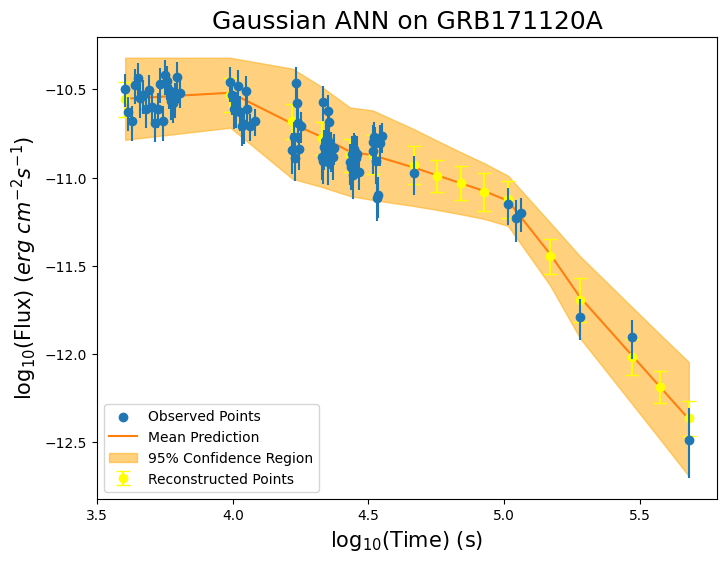


-----TRAINING FOR GRB171123A-----


-----ORIGINAL GRB-----



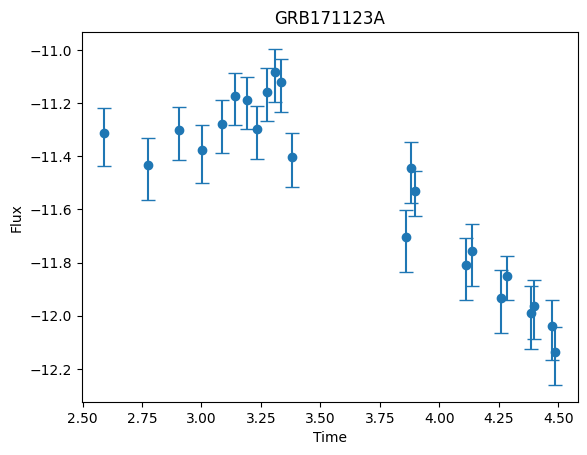


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.5562
Epoch 50, Loss: -0.6315
Epoch 100, Loss: -0.6487
Epoch 150, Loss: -0.6698
Epoch 200, Loss: -0.7043
Epoch 250, Loss: -0.7348
Epoch 300, Loss: -0.7943
Epoch 350, Loss: -0.8030
Epoch 400, Loss: -0.8089
Epoch 450, Loss: -0.8143

-----RECONSTRUCTED GRB-----



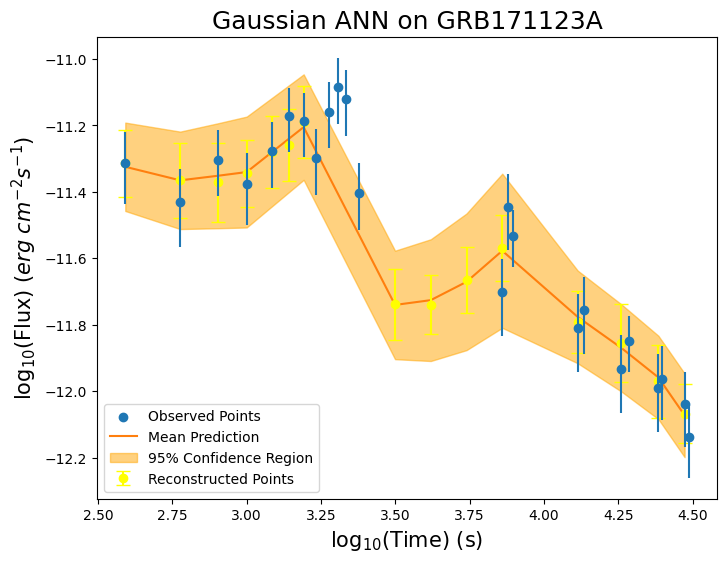


-----TRAINING FOR GRB171211A-----


-----ORIGINAL GRB-----



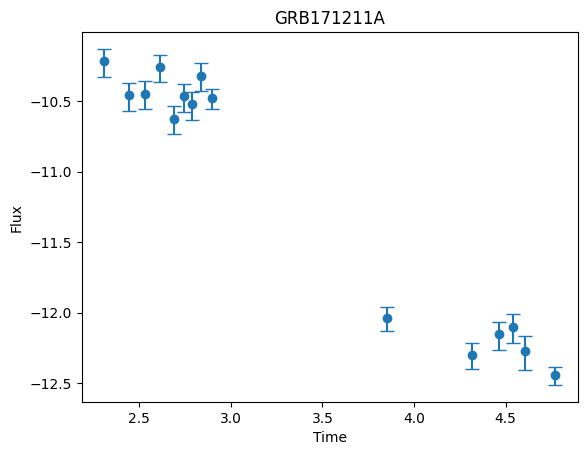


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.5883
Epoch 50, Loss: -0.8965
Epoch 100, Loss: -0.9077
Epoch 150, Loss: -0.9164
Epoch 200, Loss: -0.9269
Epoch 250, Loss: -0.9340
Epoch 300, Loss: -0.9227
Epoch 350, Loss: -0.9694
Epoch 400, Loss: -1.0007
Epoch 450, Loss: -1.0160

-----RECONSTRUCTED GRB-----



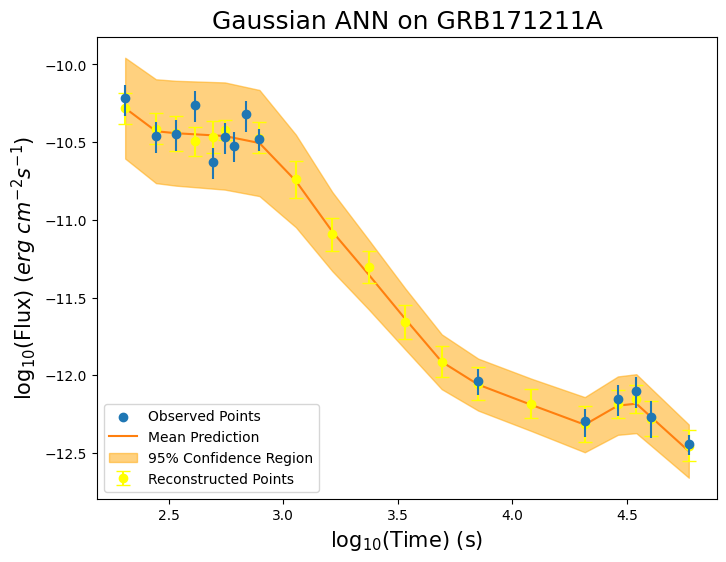


-----TRAINING FOR GRB180115A-----


-----ORIGINAL GRB-----



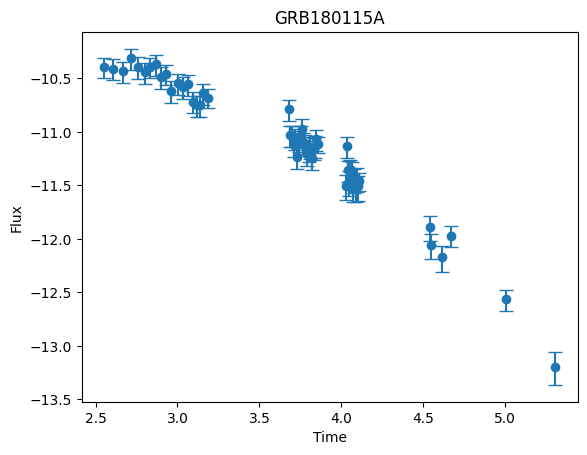


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.2710
Epoch 50, Loss: -0.8338
Epoch 100, Loss: -0.8341
Epoch 150, Loss: -0.8647
Epoch 200, Loss: -0.8871
Epoch 250, Loss: -0.9422
Epoch 300, Loss: -0.9218
Epoch 350, Loss: -0.8023
Epoch 400, Loss: -0.9210
Epoch 450, Loss: -0.8275

-----RECONSTRUCTED GRB-----



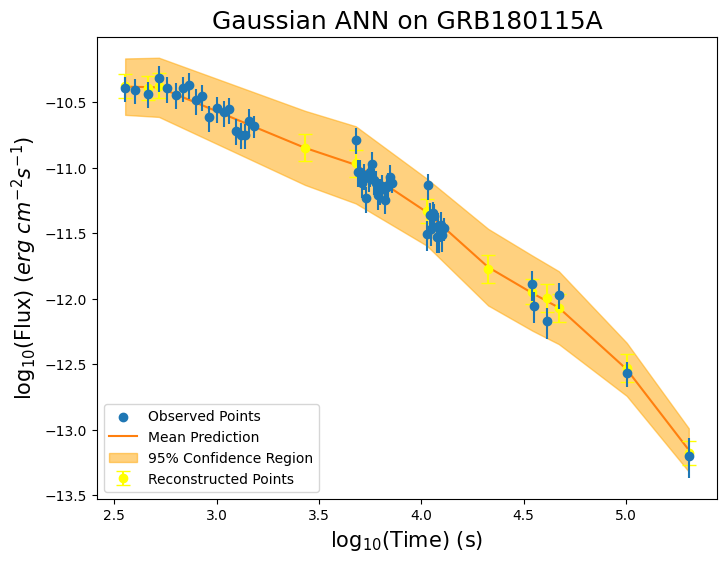


-----TRAINING FOR GRB180224A-----


-----ORIGINAL GRB-----



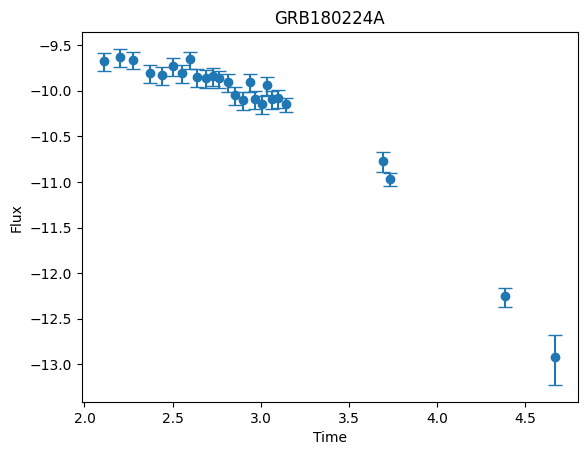


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.7155
Epoch 50, Loss: -1.0175
Epoch 100, Loss: -1.0392
Epoch 150, Loss: -1.0447
Epoch 200, Loss: -1.0424
Epoch 250, Loss: -1.0380
Epoch 300, Loss: -1.0684
Epoch 350, Loss: -1.0511
Epoch 400, Loss: -1.0674
Epoch 450, Loss: -1.0863

-----RECONSTRUCTED GRB-----



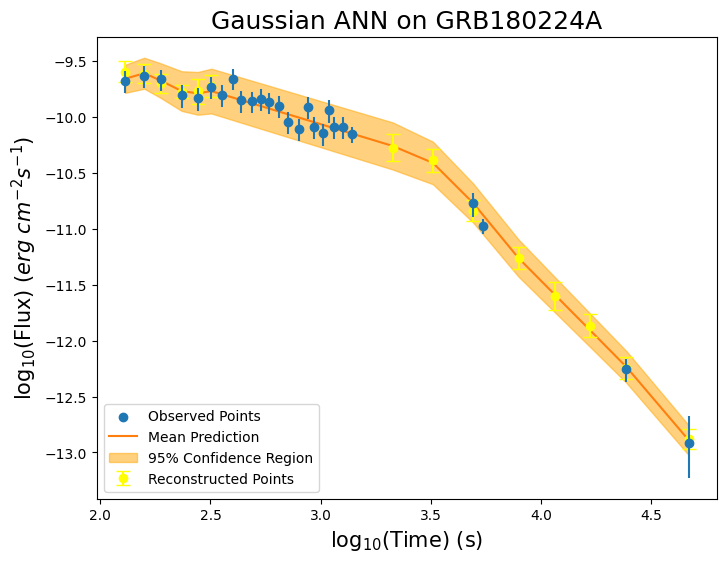


-----TRAINING FOR GRB180314A-----


-----ORIGINAL GRB-----



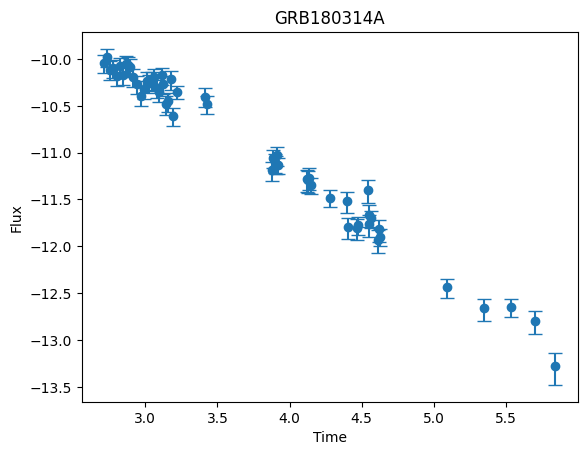


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.4603
Epoch 50, Loss: -0.7875
Epoch 100, Loss: -0.8768
Epoch 150, Loss: -0.9542
Epoch 200, Loss: -0.7609
Epoch 250, Loss: -0.8824
Epoch 300, Loss: -0.9256
Epoch 350, Loss: -0.9731
Epoch 400, Loss: -0.9262
Epoch 450, Loss: -0.9122

-----RECONSTRUCTED GRB-----



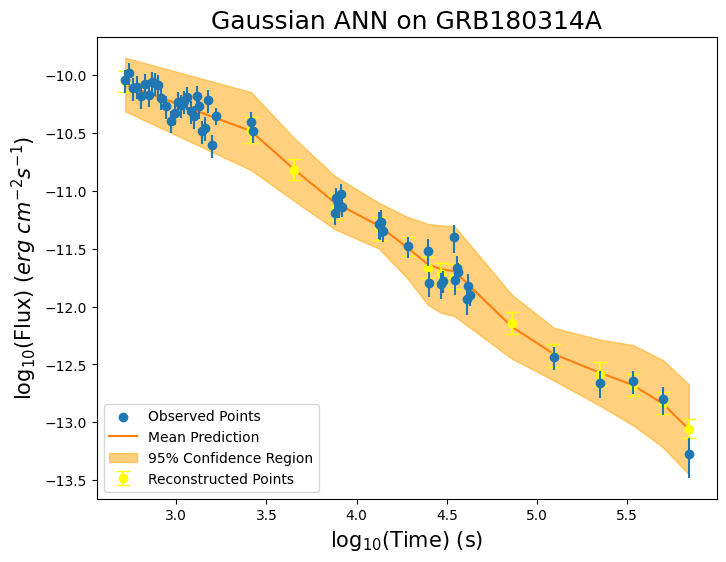


-----TRAINING FOR GRB180316A-----


-----ORIGINAL GRB-----



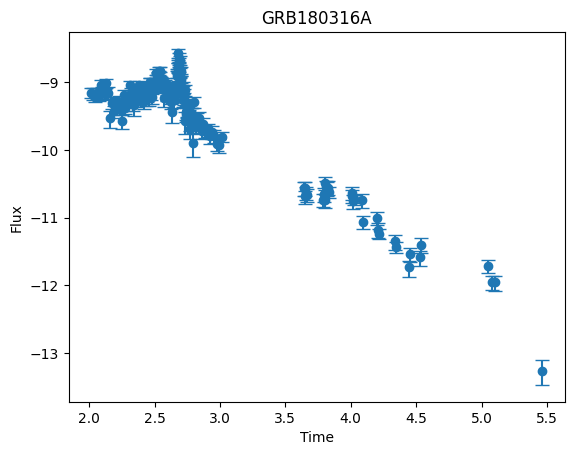


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.3201
Epoch 50, Loss: -0.6967
Epoch 100, Loss: -0.6967
Epoch 150, Loss: -0.7856
Epoch 200, Loss: -0.7860
Epoch 250, Loss: -0.7986
Epoch 300, Loss: -0.8131
Epoch 350, Loss: -0.9201
Epoch 400, Loss: -0.7495
Epoch 450, Loss: -0.7585

-----RECONSTRUCTED GRB-----



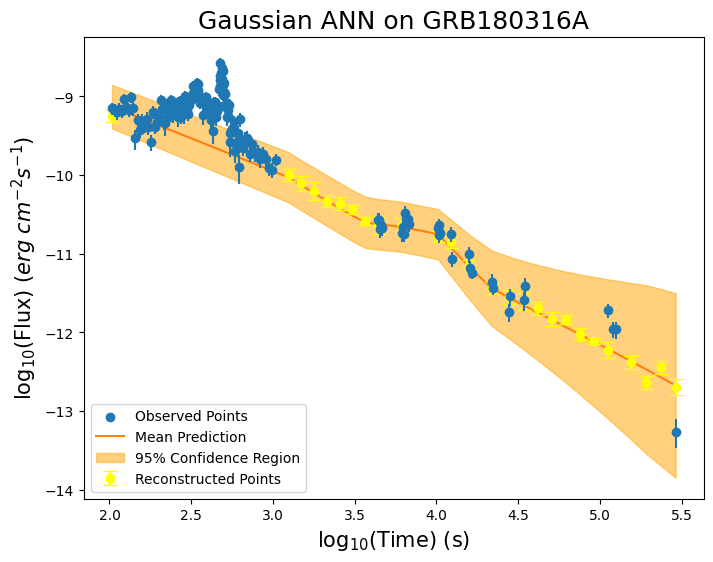


-----TRAINING FOR GRB180331B-----


-----ORIGINAL GRB-----



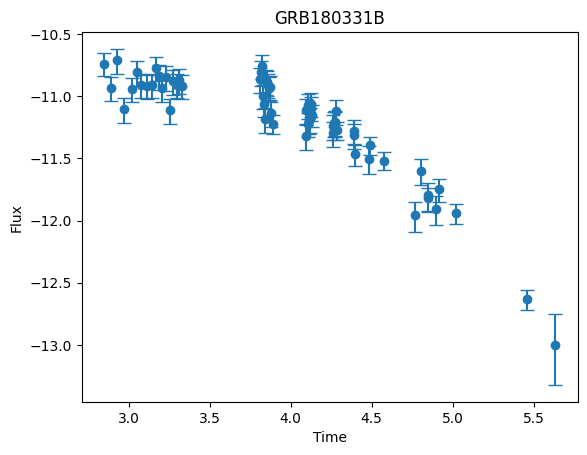


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.3480
Epoch 50, Loss: -0.5791
Epoch 100, Loss: -0.5163
Epoch 150, Loss: -0.6669
Epoch 200, Loss: -0.5780
Epoch 250, Loss: -0.6803
Epoch 300, Loss: -0.6928
Epoch 350, Loss: -0.7166
Epoch 400, Loss: -0.6439
Epoch 450, Loss: -0.7094

-----RECONSTRUCTED GRB-----



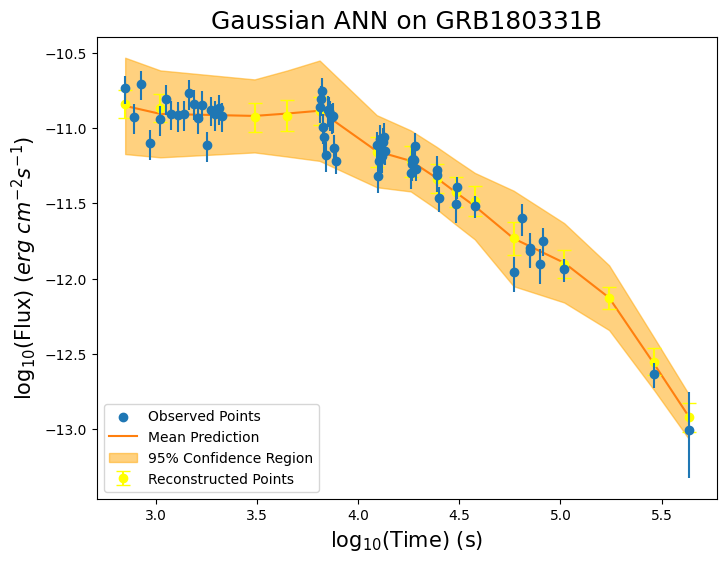


-----TRAINING FOR GRB180411A-----


-----ORIGINAL GRB-----



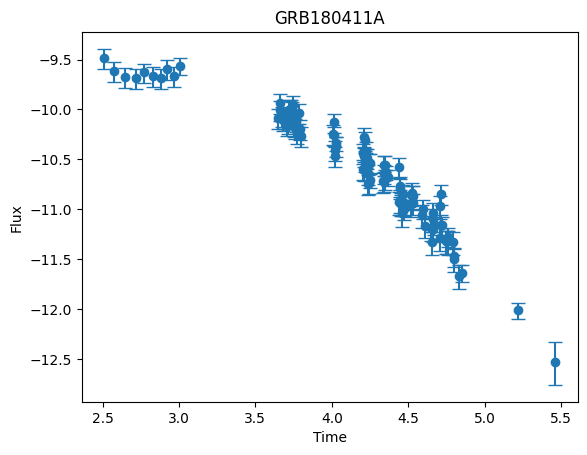


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.0242
Epoch 50, Loss: -0.7606
Epoch 100, Loss: -0.8025
Epoch 150, Loss: -0.7849
Epoch 200, Loss: -0.8075
Epoch 250, Loss: -0.8491
Epoch 300, Loss: -0.7654
Epoch 350, Loss: -0.7043
Epoch 400, Loss: -0.7090
Epoch 450, Loss: -0.7994

-----RECONSTRUCTED GRB-----



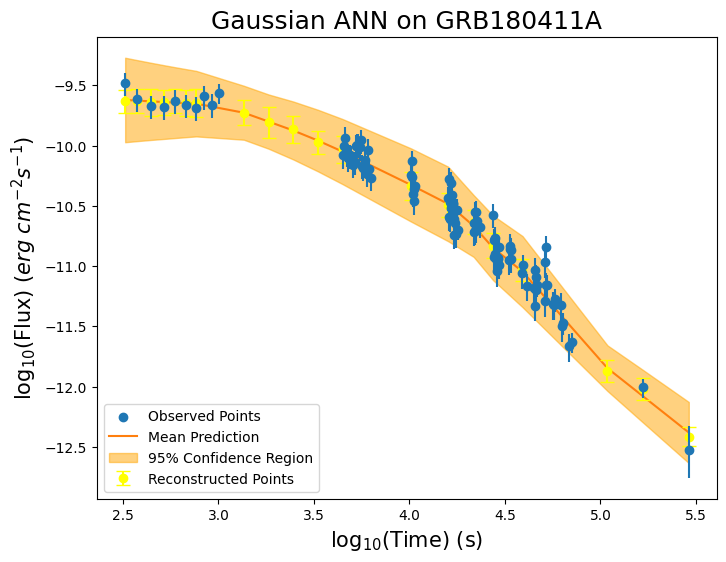


-----TRAINING FOR GRB180425A-----


-----ORIGINAL GRB-----



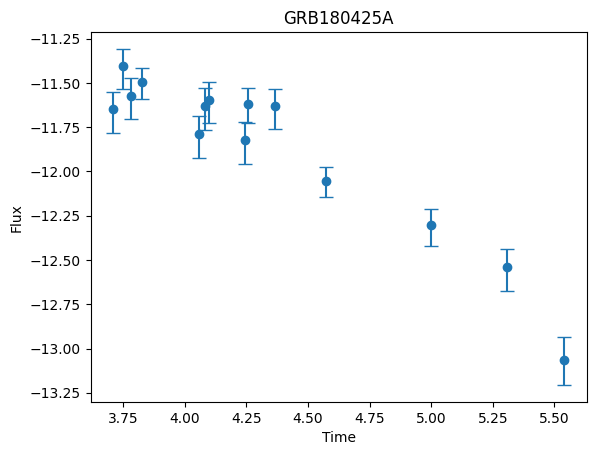


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.4451
Epoch 50, Loss: -0.7051
Epoch 100, Loss: -0.7942
Epoch 150, Loss: -0.8289
Epoch 200, Loss: -0.8440
Epoch 250, Loss: -0.8784
Epoch 300, Loss: -0.9094
Epoch 350, Loss: -0.9298
Epoch 400, Loss: -0.9388
Epoch 450, Loss: -0.9442

-----RECONSTRUCTED GRB-----



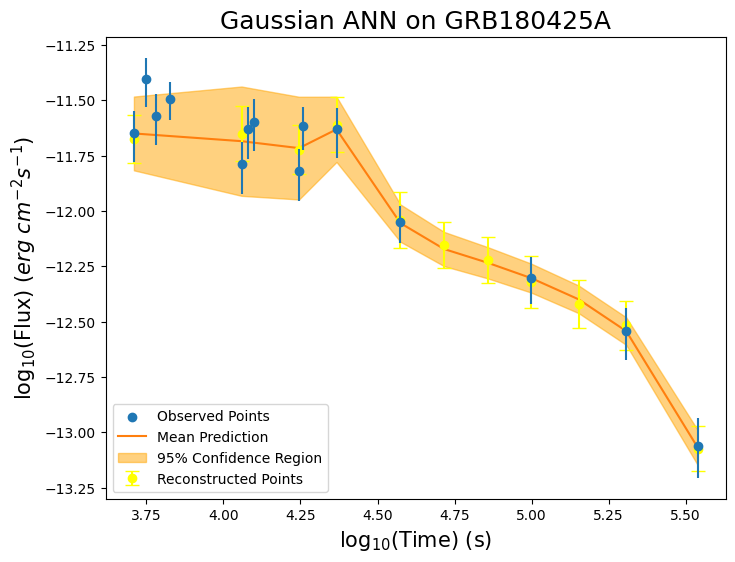


-----TRAINING FOR GRB180514A-----


-----ORIGINAL GRB-----



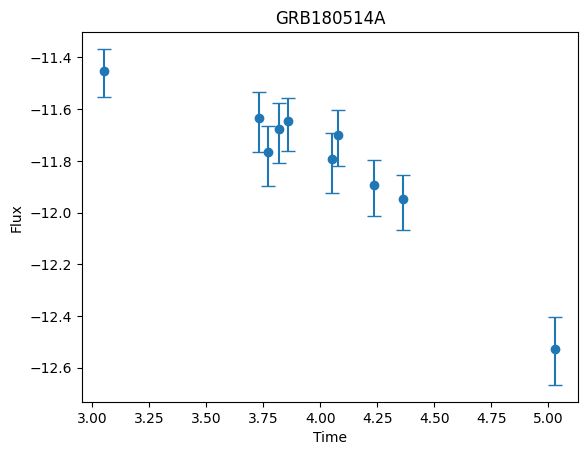


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.5649
Epoch 50, Loss: -0.8852
Epoch 100, Loss: -0.9065
Epoch 150, Loss: -0.9134
Epoch 200, Loss: -0.9240
Epoch 250, Loss: -0.9146
Epoch 300, Loss: -0.9403
Epoch 350, Loss: -0.9497
Epoch 400, Loss: -0.9612
Epoch 450, Loss: -0.9536

-----RECONSTRUCTED GRB-----



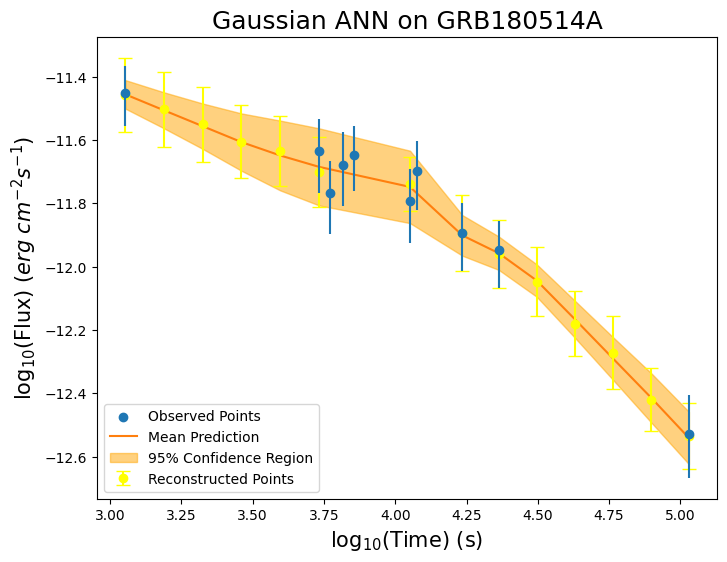


-----TRAINING FOR GRB180614A-----


-----ORIGINAL GRB-----



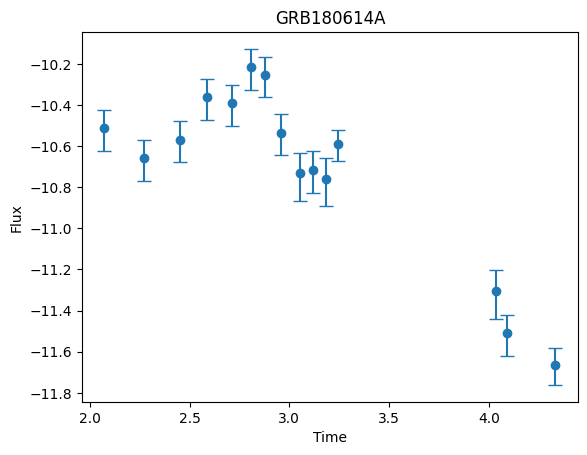


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.5064
Epoch 50, Loss: -0.6934
Epoch 100, Loss: -0.8492
Epoch 150, Loss: -0.9153
Epoch 200, Loss: -0.9705
Epoch 250, Loss: -0.9952
Epoch 300, Loss: -0.9980
Epoch 350, Loss: -1.0079
Epoch 400, Loss: -1.0122
Epoch 450, Loss: -1.0039

-----RECONSTRUCTED GRB-----



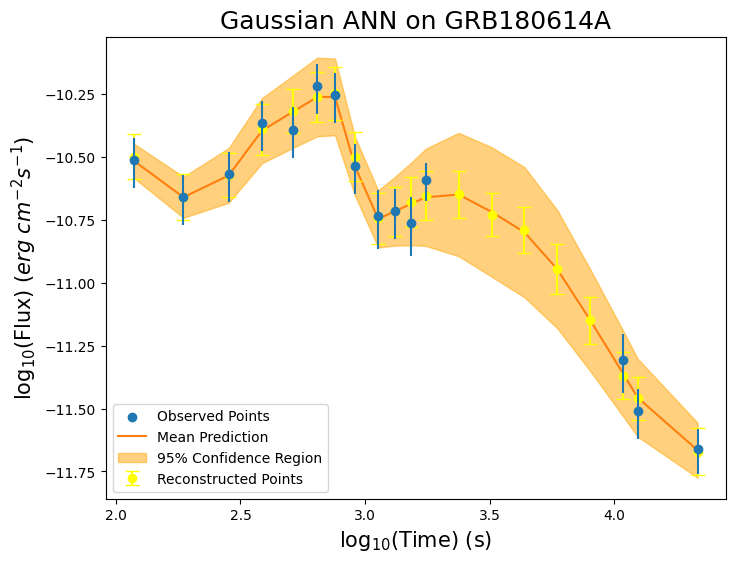


-----TRAINING FOR GRB180623A-----


-----ORIGINAL GRB-----



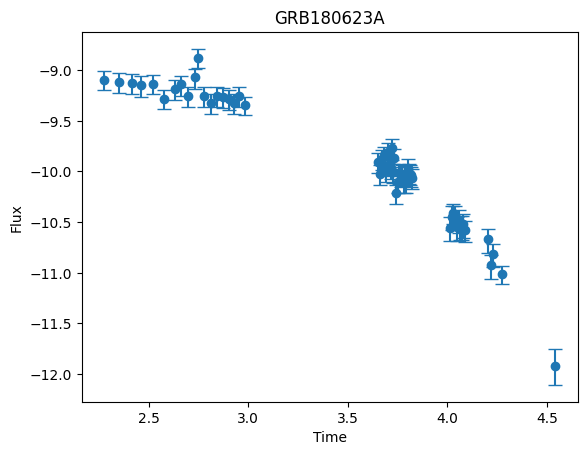


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.2380
Epoch 50, Loss: -0.9318
Epoch 100, Loss: -0.8273
Epoch 150, Loss: -0.9006
Epoch 200, Loss: -0.7605
Epoch 250, Loss: -0.7912
Epoch 300, Loss: -0.9283
Epoch 350, Loss: -0.8909
Epoch 400, Loss: -0.9356
Epoch 450, Loss: -0.9235

-----RECONSTRUCTED GRB-----



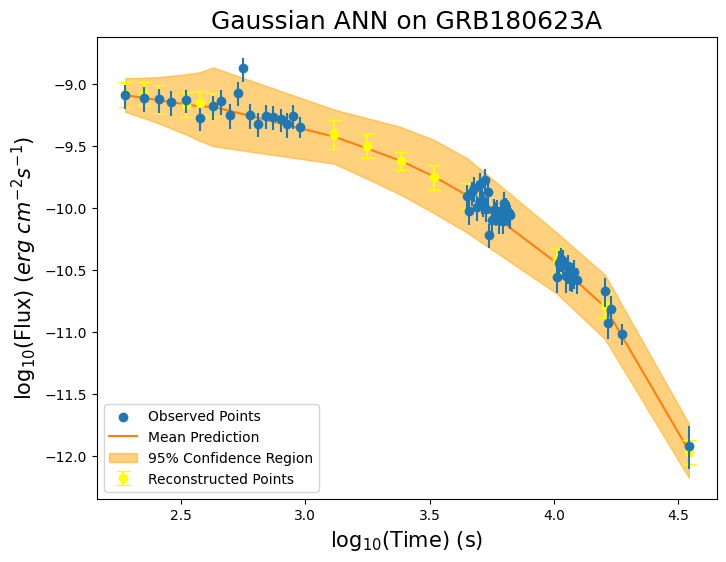


-----TRAINING FOR GRB180626A-----


-----ORIGINAL GRB-----



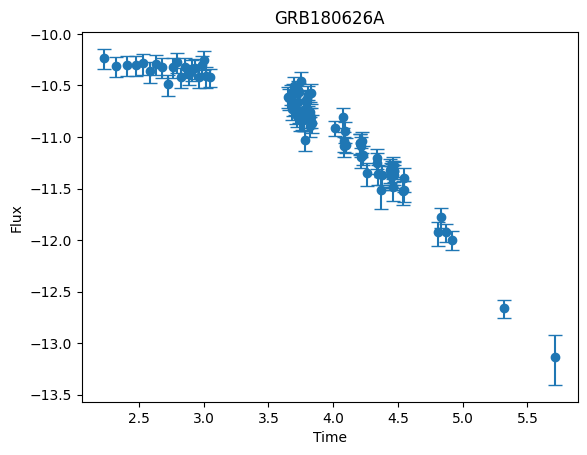


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.2163
Epoch 50, Loss: -0.8098
Epoch 100, Loss: -0.7943
Epoch 150, Loss: -0.8218
Epoch 200, Loss: -0.7093
Epoch 250, Loss: -0.8194
Epoch 300, Loss: -0.8198
Epoch 350, Loss: -0.8085
Epoch 400, Loss: -0.7418
Epoch 450, Loss: -0.8120

-----RECONSTRUCTED GRB-----



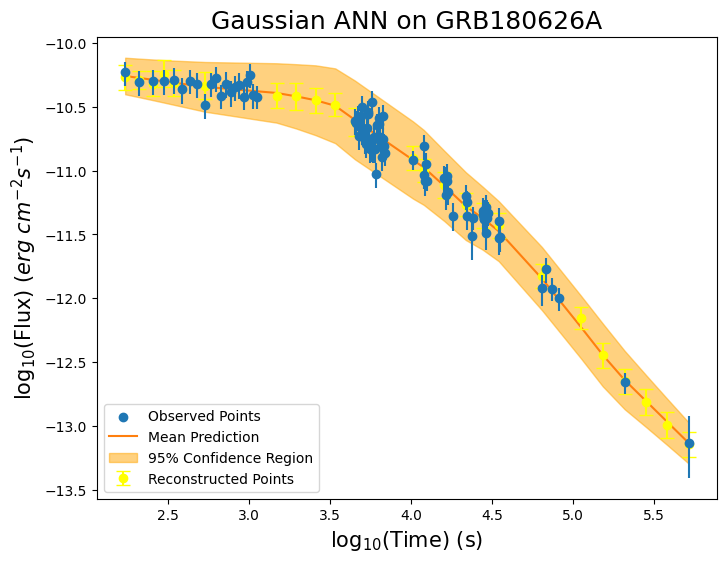


-----TRAINING FOR GRB180630A-----


-----ORIGINAL GRB-----



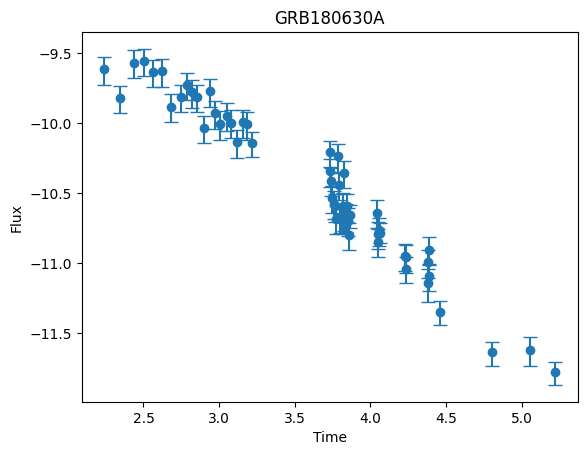


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.1980
Epoch 50, Loss: -0.6876
Epoch 100, Loss: -0.7951
Epoch 150, Loss: -0.7140
Epoch 200, Loss: -0.7317
Epoch 250, Loss: -0.6580
Epoch 300, Loss: -0.7717
Epoch 350, Loss: -0.7543
Epoch 400, Loss: -0.6037
Epoch 450, Loss: -0.6970

-----RECONSTRUCTED GRB-----



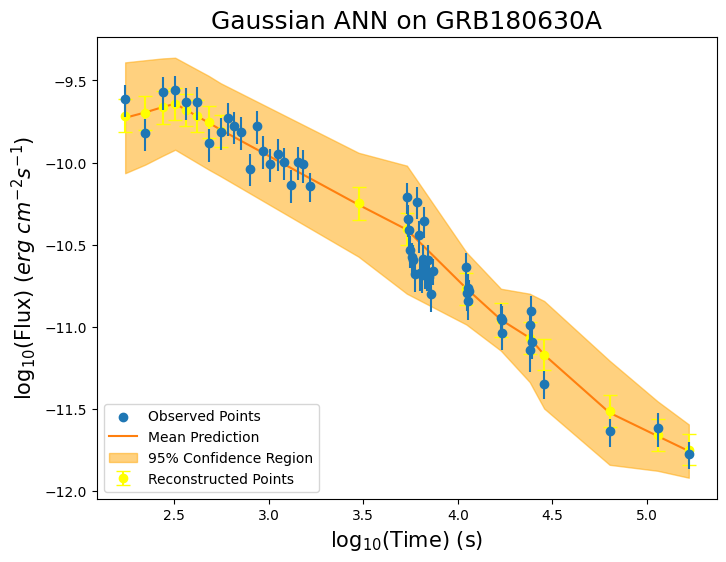


-----TRAINING FOR GRB180706A-----


-----ORIGINAL GRB-----



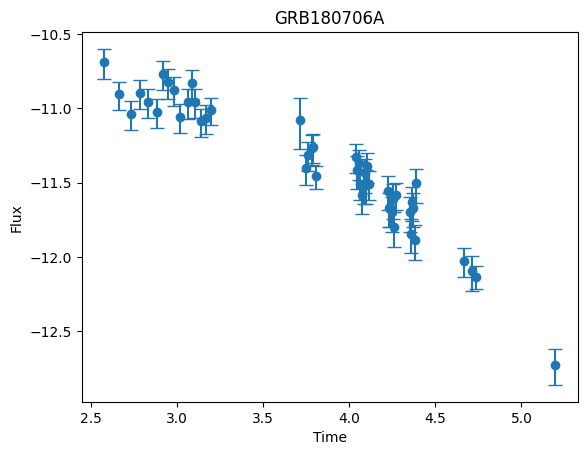


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.4621
Epoch 50, Loss: -0.6383
Epoch 100, Loss: -0.6888
Epoch 150, Loss: -0.6484
Epoch 200, Loss: -0.6435
Epoch 250, Loss: -0.6599
Epoch 300, Loss: -0.7085
Epoch 350, Loss: -0.5486
Epoch 400, Loss: -0.6381
Epoch 450, Loss: -0.6993

-----RECONSTRUCTED GRB-----



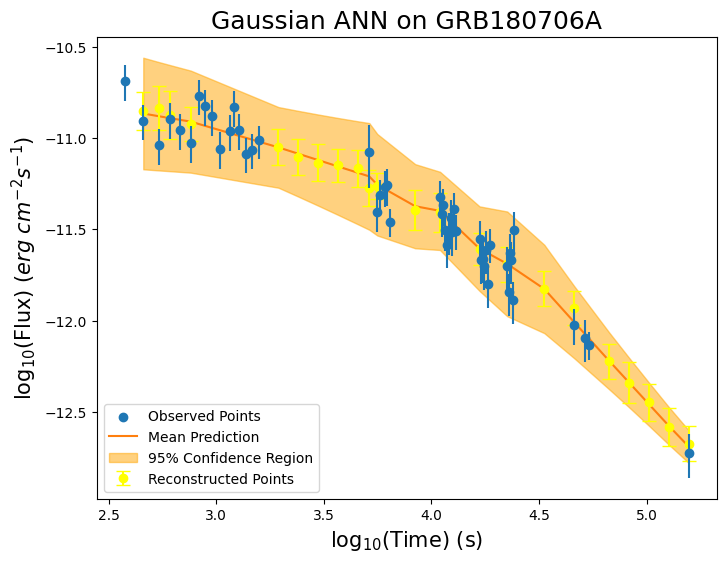


-----TRAINING FOR GRB180720C-----


-----ORIGINAL GRB-----



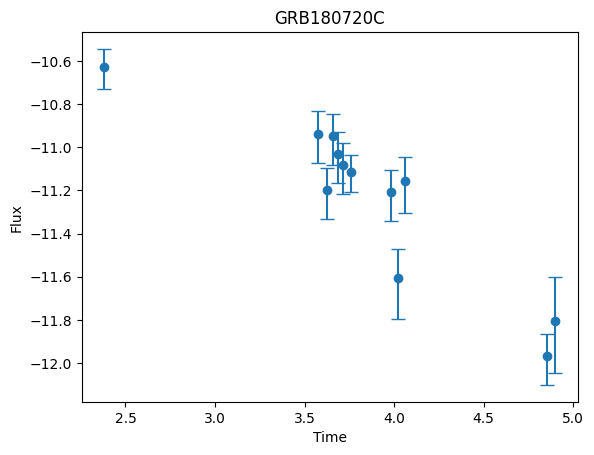


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.4705
Epoch 50, Loss: -0.4781
Epoch 100, Loss: -0.5096
Epoch 150, Loss: -0.5339
Epoch 200, Loss: -0.5772
Epoch 250, Loss: -0.5765
Epoch 300, Loss: -0.5934
Epoch 350, Loss: -0.6700
Epoch 400, Loss: -0.6558
Epoch 450, Loss: -0.6170

-----RECONSTRUCTED GRB-----



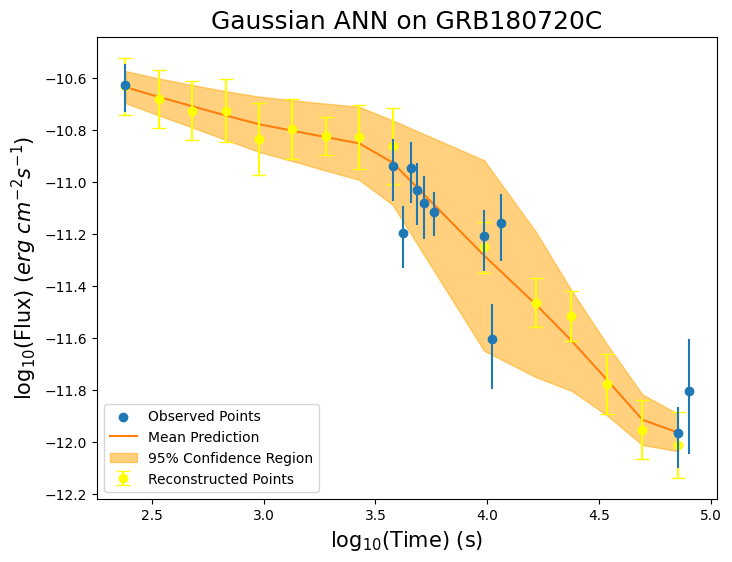


-----TRAINING FOR GRB180721A-----


-----ORIGINAL GRB-----



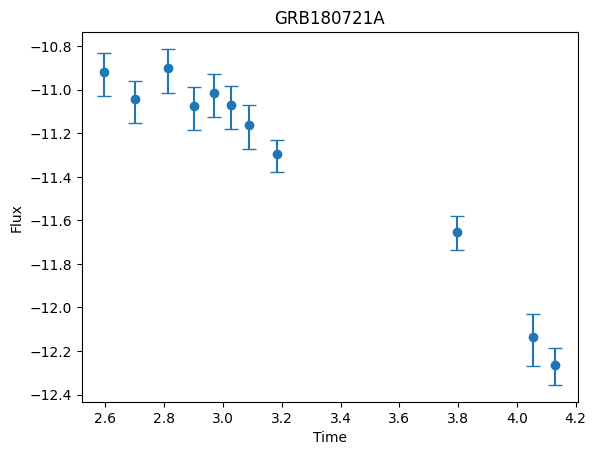


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.4823
Epoch 50, Loss: -0.7918
Epoch 100, Loss: -1.0137
Epoch 150, Loss: -1.0524
Epoch 200, Loss: -1.0649
Epoch 250, Loss: -1.0734
Epoch 300, Loss: -1.0740
Epoch 350, Loss: -1.0771
Epoch 400, Loss: -1.0731
Epoch 450, Loss: -1.0949

-----RECONSTRUCTED GRB-----



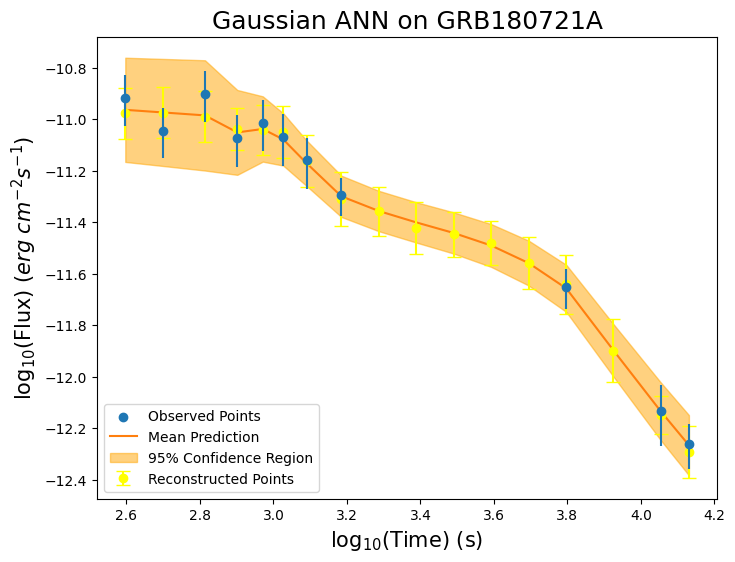


-----TRAINING FOR GRB180818B-----


-----ORIGINAL GRB-----



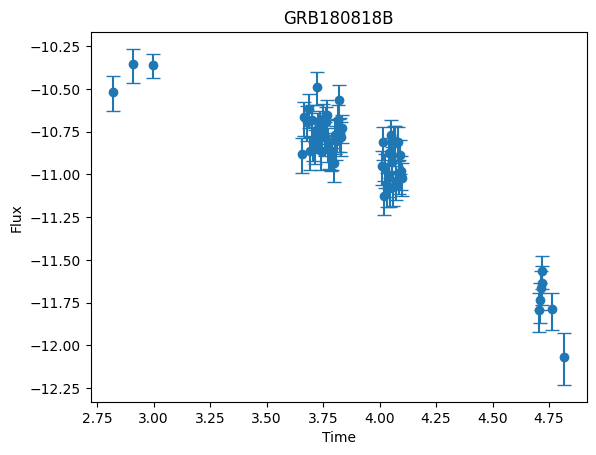


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.4572
Epoch 50, Loss: -0.4684
Epoch 100, Loss: -0.4526
Epoch 150, Loss: -0.4610
Epoch 200, Loss: -0.5655
Epoch 250, Loss: -0.4942
Epoch 300, Loss: -0.4953
Epoch 350, Loss: -0.4800
Epoch 400, Loss: -0.5194
Epoch 450, Loss: -0.4086

-----RECONSTRUCTED GRB-----



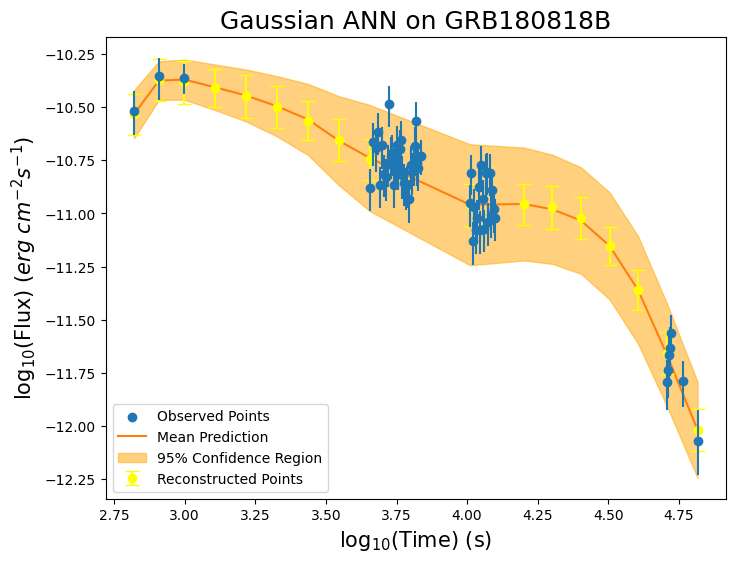


-----TRAINING FOR GRB180821A-----


-----ORIGINAL GRB-----



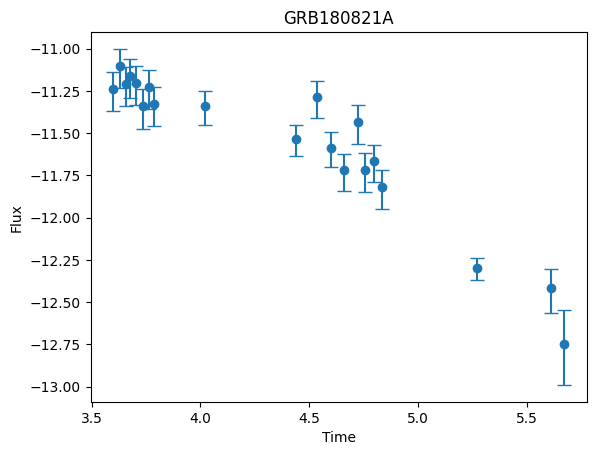


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.6812
Epoch 50, Loss: -0.6741
Epoch 100, Loss: -0.6902
Epoch 150, Loss: -0.7058
Epoch 200, Loss: -0.7056
Epoch 250, Loss: -0.7468
Epoch 300, Loss: -0.7684
Epoch 350, Loss: -0.7887
Epoch 400, Loss: -0.7286
Epoch 450, Loss: -0.8251

-----RECONSTRUCTED GRB-----



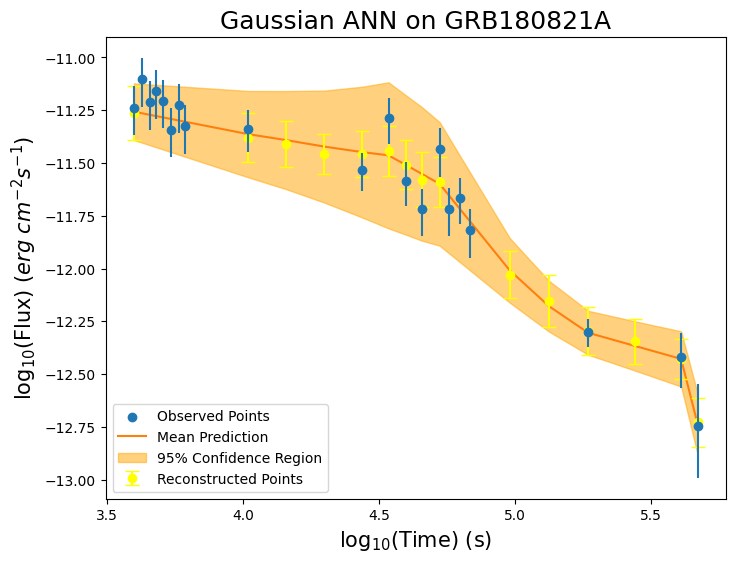


-----TRAINING FOR GRB180823A-----


-----ORIGINAL GRB-----



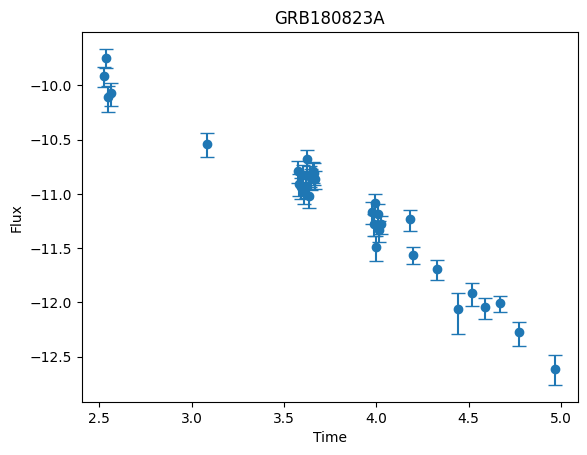


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.0687
Epoch 50, Loss: -0.7488
Epoch 100, Loss: -0.5782
Epoch 150, Loss: -0.9795
Epoch 200, Loss: -0.7136
Epoch 250, Loss: -0.1771
Epoch 300, Loss: -0.9516
Epoch 350, Loss: -0.5197
Epoch 400, Loss: -0.9456
Epoch 450, Loss: -0.4616

-----RECONSTRUCTED GRB-----



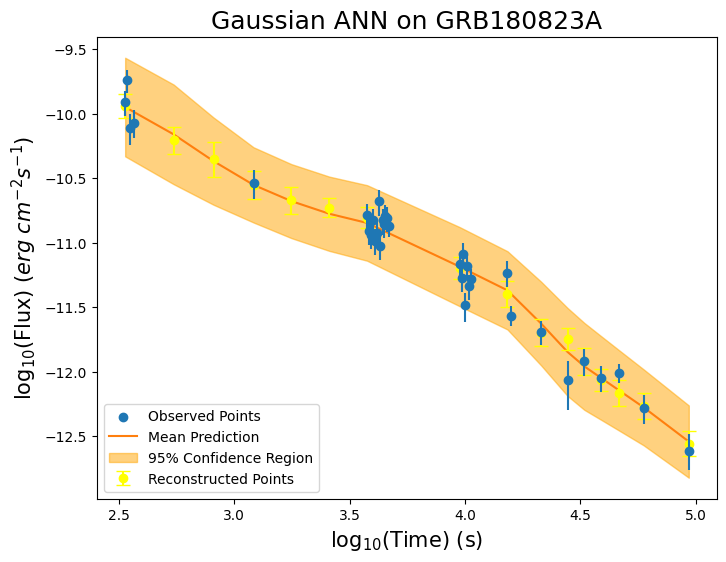


-----TRAINING FOR GRB180924A-----


-----ORIGINAL GRB-----



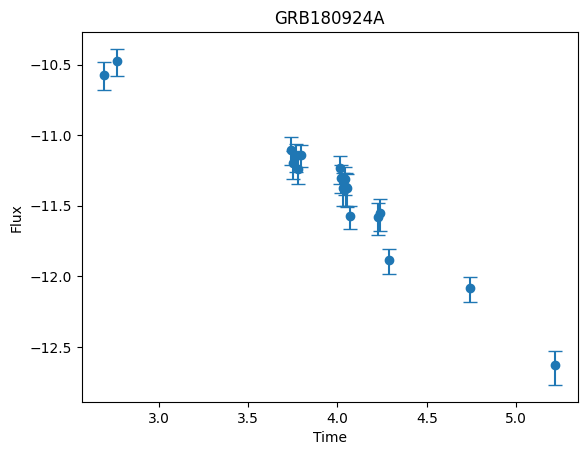


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.4597
Epoch 50, Loss: -0.8050
Epoch 100, Loss: -0.8606
Epoch 150, Loss: -0.8984
Epoch 200, Loss: -0.9068
Epoch 250, Loss: -0.9156
Epoch 300, Loss: -0.9600
Epoch 350, Loss: -0.9451
Epoch 400, Loss: -0.9749
Epoch 450, Loss: -0.9718

-----RECONSTRUCTED GRB-----



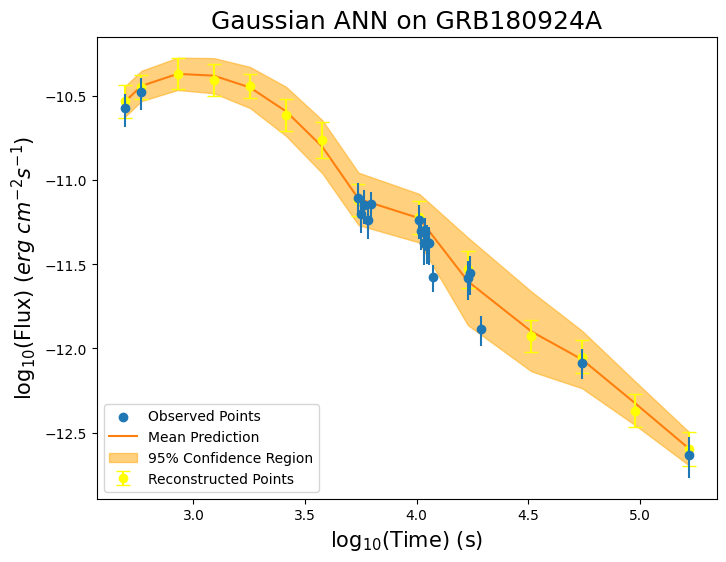


-----TRAINING FOR GRB180925A-----


-----ORIGINAL GRB-----



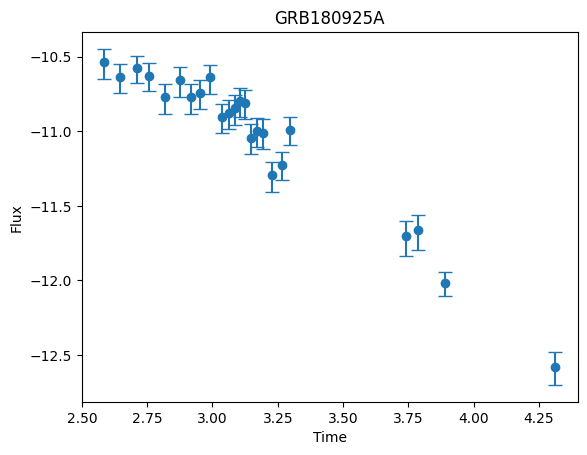


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.6466
Epoch 50, Loss: -0.7988
Epoch 100, Loss: -0.8193
Epoch 150, Loss: -0.8335
Epoch 200, Loss: -0.8451
Epoch 250, Loss: -0.8291
Epoch 300, Loss: -0.8670
Epoch 350, Loss: -0.8796
Epoch 400, Loss: -0.8865
Epoch 450, Loss: -0.9043

-----RECONSTRUCTED GRB-----



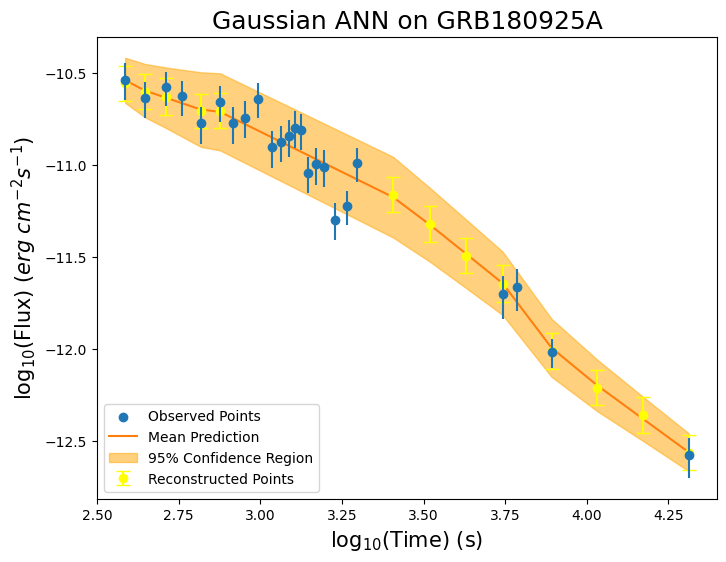


-----TRAINING FOR GRB180930A-----


-----ORIGINAL GRB-----



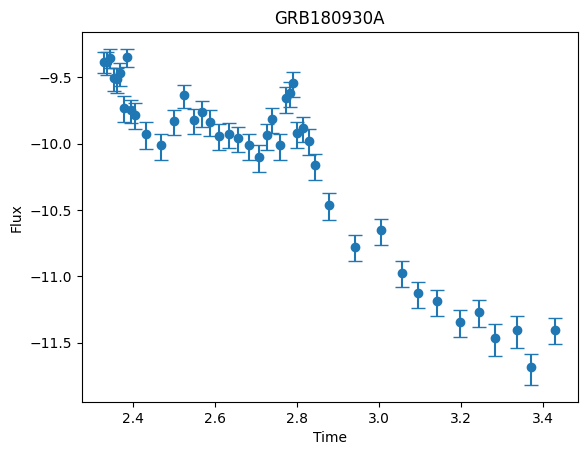


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.1839
Epoch 50, Loss: -0.7666
Epoch 100, Loss: -0.7033
Epoch 150, Loss: -0.6146
Epoch 200, Loss: -0.6569
Epoch 250, Loss: -0.5643
Epoch 300, Loss: -0.8561
Epoch 350, Loss: -0.8341
Epoch 400, Loss: -0.6759
Epoch 450, Loss: -0.9171

-----RECONSTRUCTED GRB-----



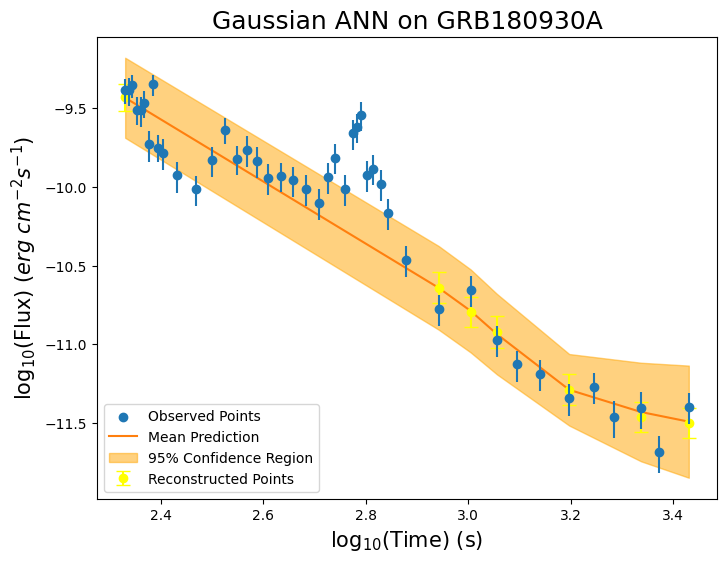


-----TRAINING FOR GRB181023A-----


-----ORIGINAL GRB-----



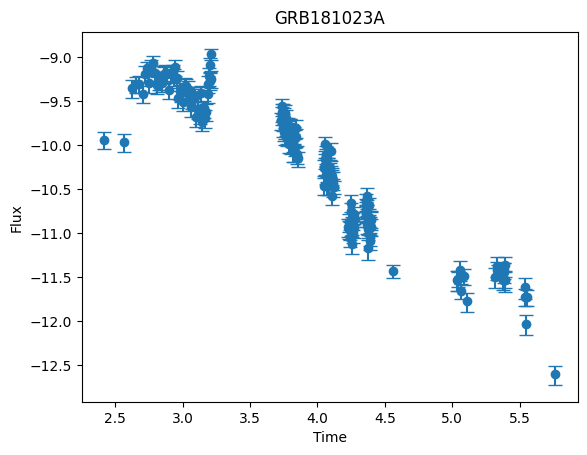


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: -0.0163
Epoch 50, Loss: -0.6987
Epoch 100, Loss: -0.7608
Epoch 150, Loss: -0.8613
Epoch 200, Loss: -0.7128
Epoch 250, Loss: -0.7763
Epoch 300, Loss: -0.7394
Epoch 350, Loss: -0.8388
Epoch 400, Loss: -0.8265
Epoch 450, Loss: -0.8702

-----RECONSTRUCTED GRB-----



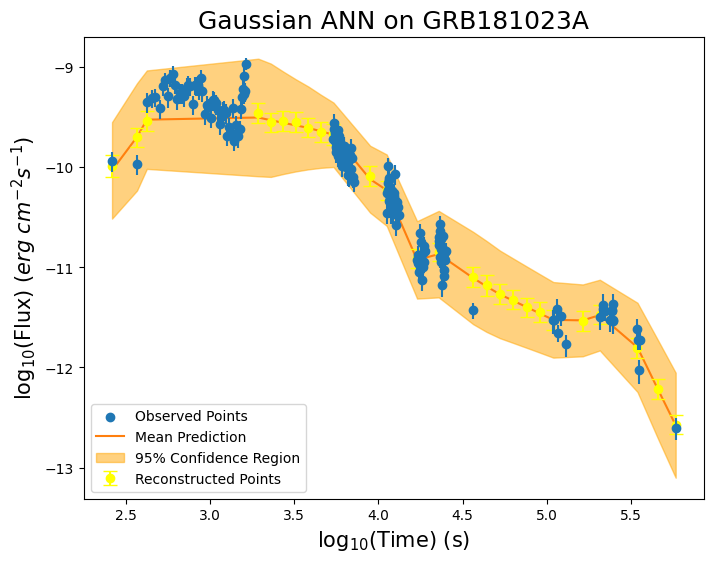


-----TRAINING FOR GRB181103A-----


-----ORIGINAL GRB-----



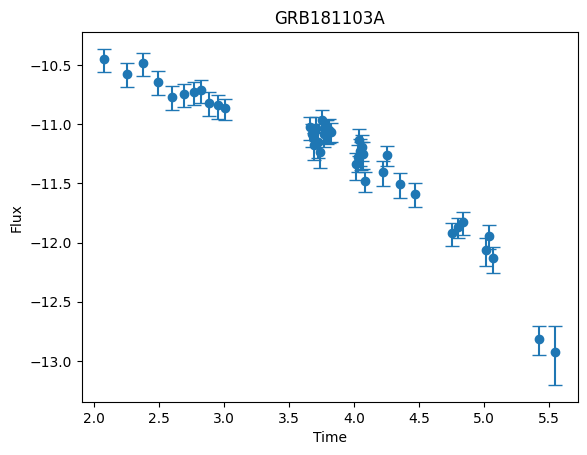


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.5026
Epoch 50, Loss: -0.4905
Epoch 100, Loss: -0.8576
Epoch 150, Loss: -0.9510
Epoch 200, Loss: -0.7506
Epoch 250, Loss: -0.7539
Epoch 300, Loss: -1.0056
Epoch 350, Loss: -0.8763
Epoch 400, Loss: -1.0534
Epoch 450, Loss: -0.7719

-----RECONSTRUCTED GRB-----



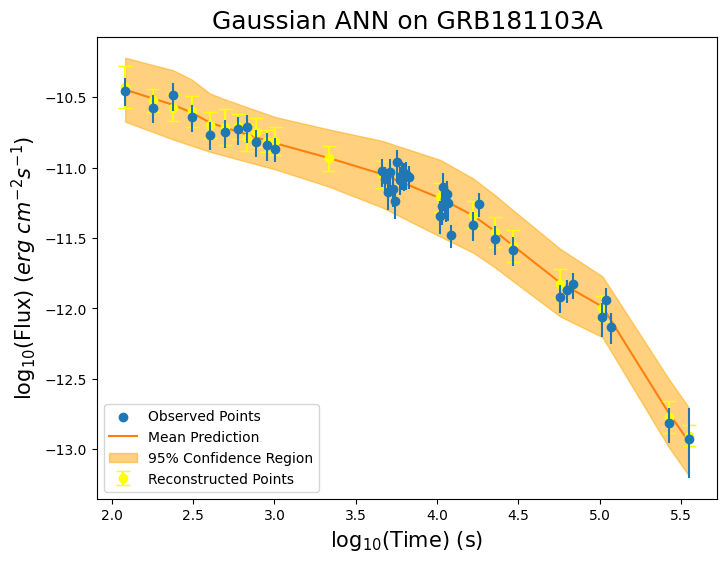


-----TRAINING FOR GRB190109A-----


-----ORIGINAL GRB-----



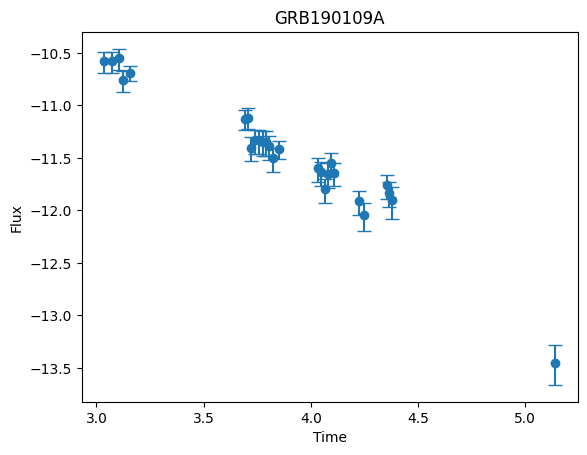


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.5193
Epoch 50, Loss: -0.8381
Epoch 100, Loss: -0.8689
Epoch 150, Loss: -0.9404
Epoch 200, Loss: -0.9527
Epoch 250, Loss: -0.9622
Epoch 300, Loss: -0.9768
Epoch 350, Loss: -0.9855
Epoch 400, Loss: -1.0008
Epoch 450, Loss: -1.0198

-----RECONSTRUCTED GRB-----



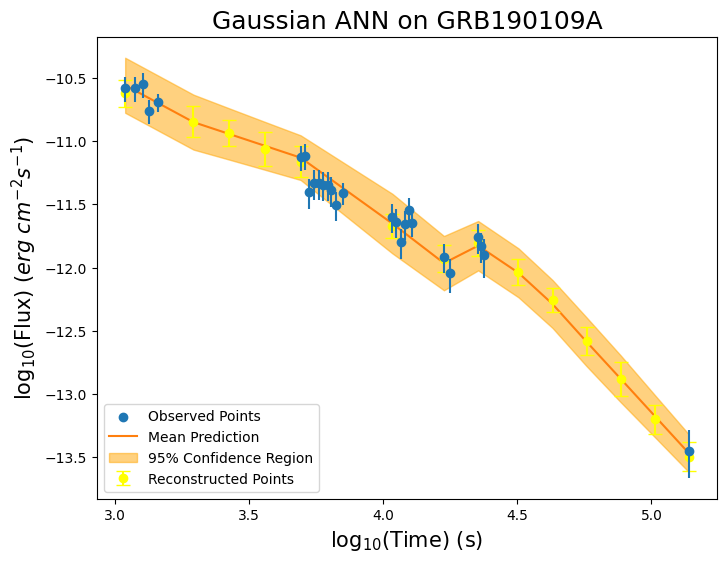


-----TRAINING FOR GRB190202A-----


-----ORIGINAL GRB-----



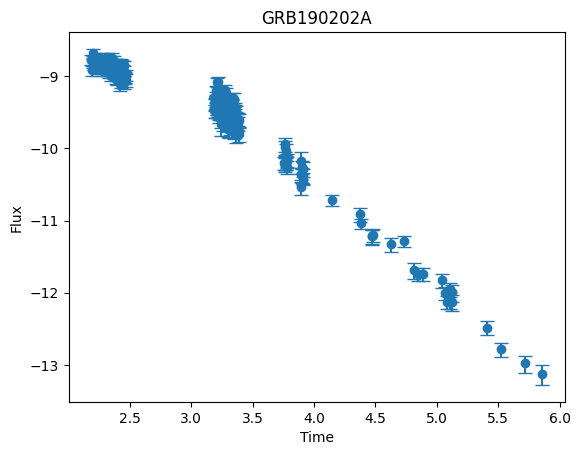


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: -0.7588
Epoch 50, Loss: -0.4979
Epoch 100, Loss: -0.8861
Epoch 150, Loss: -0.9495
Epoch 200, Loss: -0.7529
Epoch 250, Loss: -0.8291
Epoch 300, Loss: -0.8983
Epoch 350, Loss: -0.8031
Epoch 400, Loss: -0.9613
Epoch 450, Loss: -0.7694

-----RECONSTRUCTED GRB-----



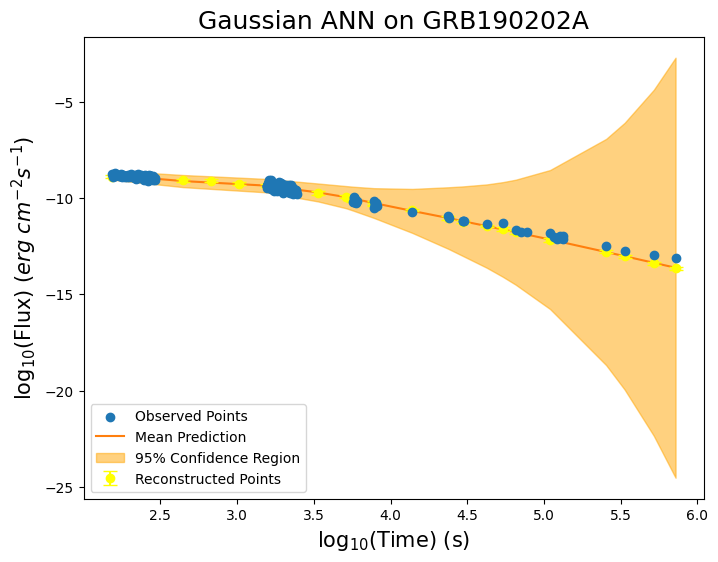


-----TRAINING FOR GRB190203A-----


-----ORIGINAL GRB-----



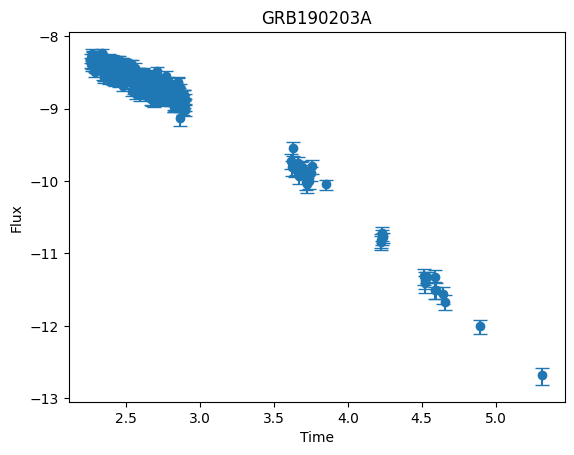


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: -0.8068
Epoch 50, Loss: -0.8028
Epoch 100, Loss: -0.7927
Epoch 150, Loss: -0.9060
Epoch 200, Loss: -0.8434
Epoch 250, Loss: -0.8905
Epoch 300, Loss: -0.7846
Epoch 350, Loss: -0.9268
Epoch 400, Loss: -0.8955
Epoch 450, Loss: -0.8976

-----RECONSTRUCTED GRB-----



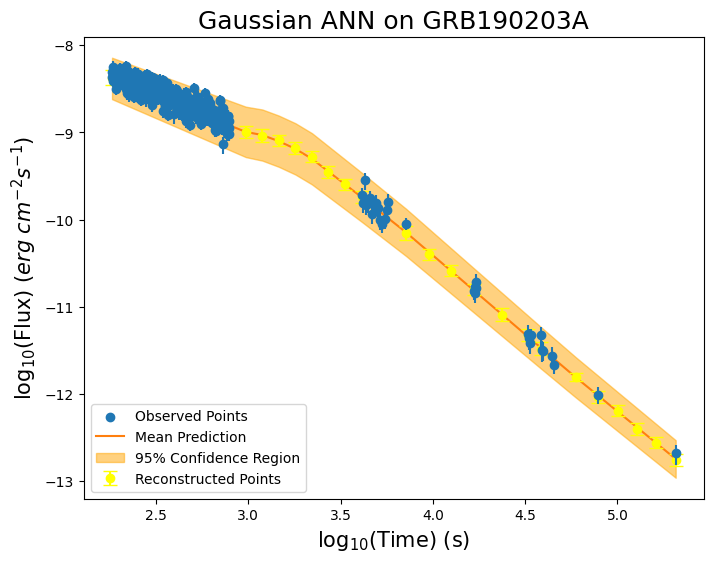


-----TRAINING FOR GRB190204A-----


-----ORIGINAL GRB-----



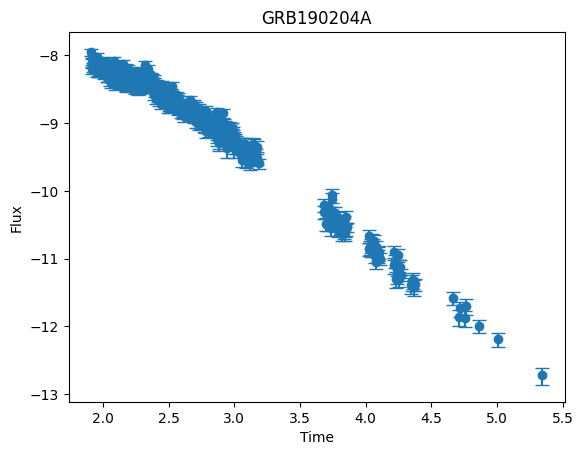


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: -0.8555
Epoch 50, Loss: -0.9457
Epoch 100, Loss: -1.0287
Epoch 150, Loss: -1.0153
Epoch 200, Loss: -0.9668
Epoch 250, Loss: -0.9013
Epoch 300, Loss: -1.0080
Epoch 350, Loss: -1.0580
Epoch 400, Loss: -0.9589
Epoch 450, Loss: -0.9894

-----RECONSTRUCTED GRB-----



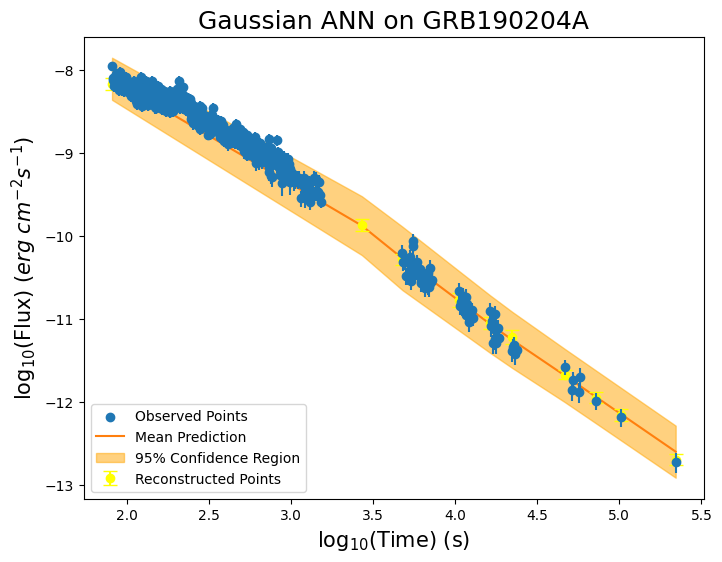


-----TRAINING FOR GRB190211A-----


-----ORIGINAL GRB-----



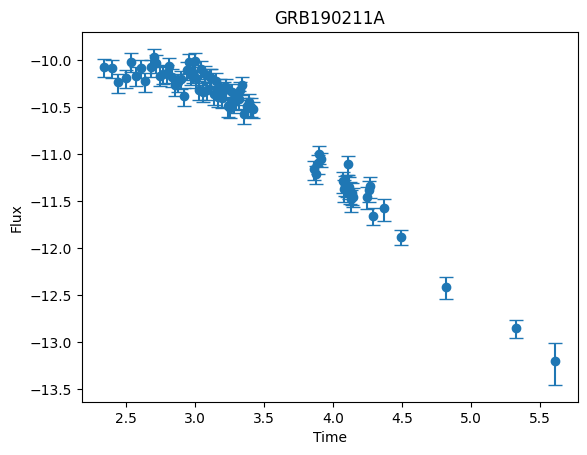


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.2510
Epoch 50, Loss: -0.6764
Epoch 100, Loss: -0.8619
Epoch 150, Loss: -0.6867
Epoch 200, Loss: -0.7200
Epoch 250, Loss: -0.9692
Epoch 300, Loss: -0.9317
Epoch 350, Loss: -0.8820
Epoch 400, Loss: -0.8321
Epoch 450, Loss: -0.8856

-----RECONSTRUCTED GRB-----



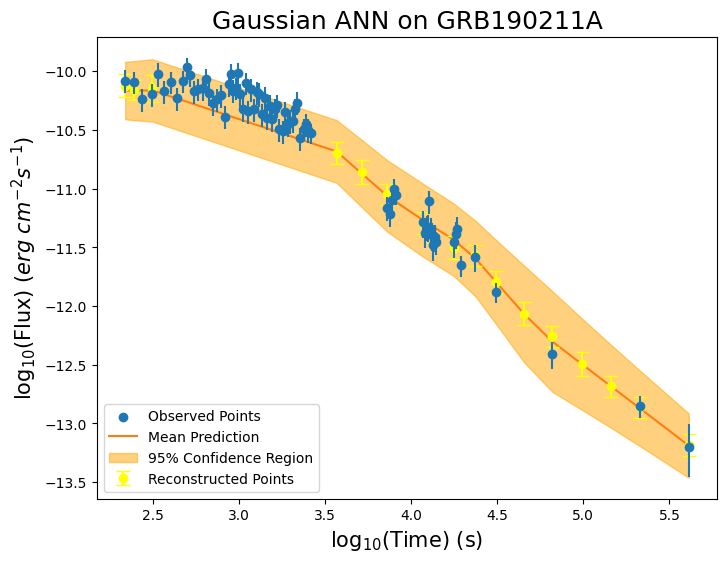


-----TRAINING FOR GRB190219A-----


-----ORIGINAL GRB-----



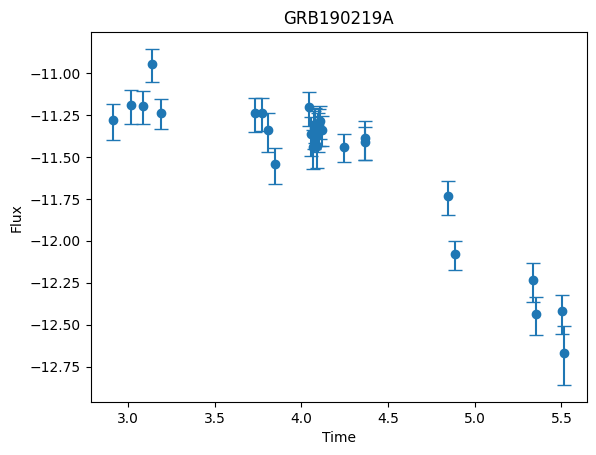


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.4831
Epoch 50, Loss: -0.6277
Epoch 100, Loss: -0.6490
Epoch 150, Loss: -0.6786
Epoch 200, Loss: -0.7024
Epoch 250, Loss: -0.7415
Epoch 300, Loss: -0.7541
Epoch 350, Loss: -0.7565
Epoch 400, Loss: -0.7746
Epoch 450, Loss: -0.7772

-----RECONSTRUCTED GRB-----



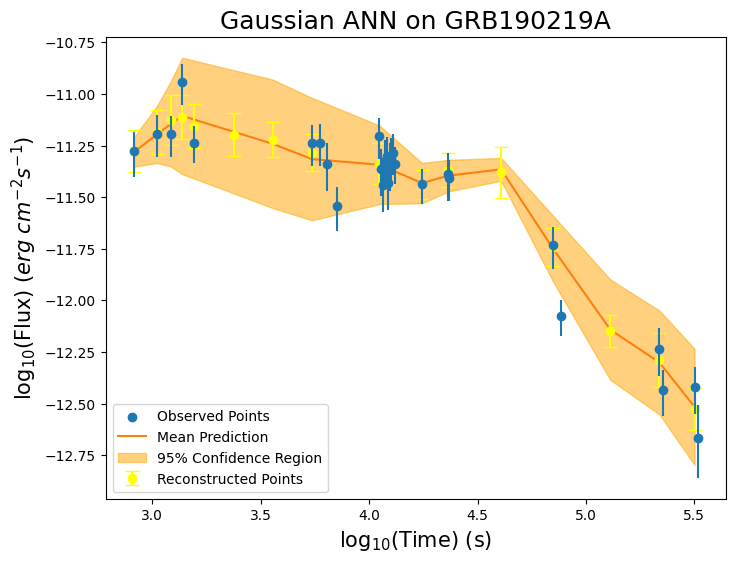


-----TRAINING FOR GRB190311A-----


-----ORIGINAL GRB-----



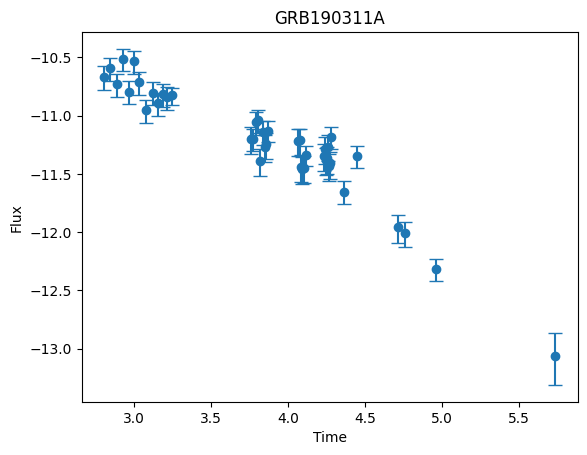


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.2082
Epoch 50, Loss: -0.6484
Epoch 100, Loss: -0.6652
Epoch 150, Loss: -0.4652
Epoch 200, Loss: -0.5990
Epoch 250, Loss: -0.7681
Epoch 300, Loss: -0.5757
Epoch 350, Loss: -0.6372
Epoch 400, Loss: -0.6662
Epoch 450, Loss: -0.7909

-----RECONSTRUCTED GRB-----



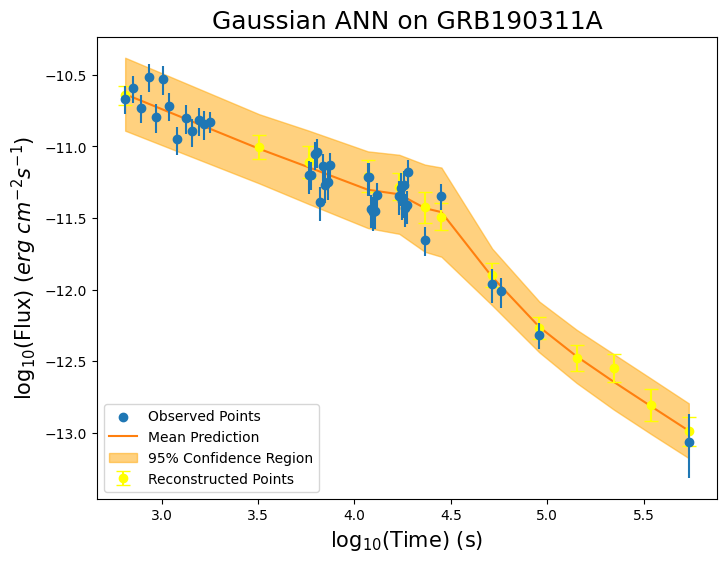


-----TRAINING FOR GRB190422A-----


-----ORIGINAL GRB-----



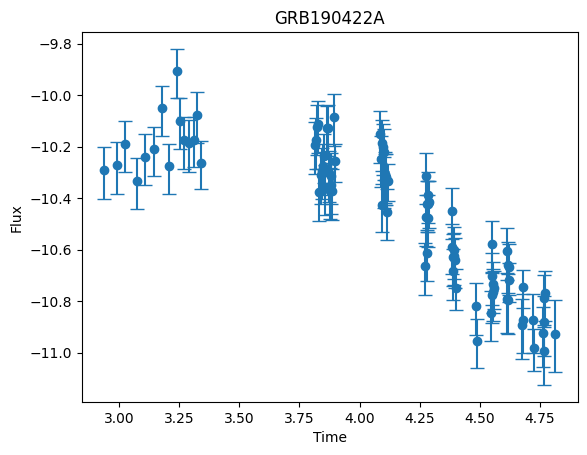


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.3069
Epoch 50, Loss: -0.2388
Epoch 100, Loss: -0.3616
Epoch 150, Loss: -0.3378
Epoch 200, Loss: -0.2963
Epoch 250, Loss: -0.4603
Epoch 300, Loss: -0.4284
Epoch 350, Loss: -0.4864
Epoch 400, Loss: -0.2722
Epoch 450, Loss: -0.3884

-----RECONSTRUCTED GRB-----



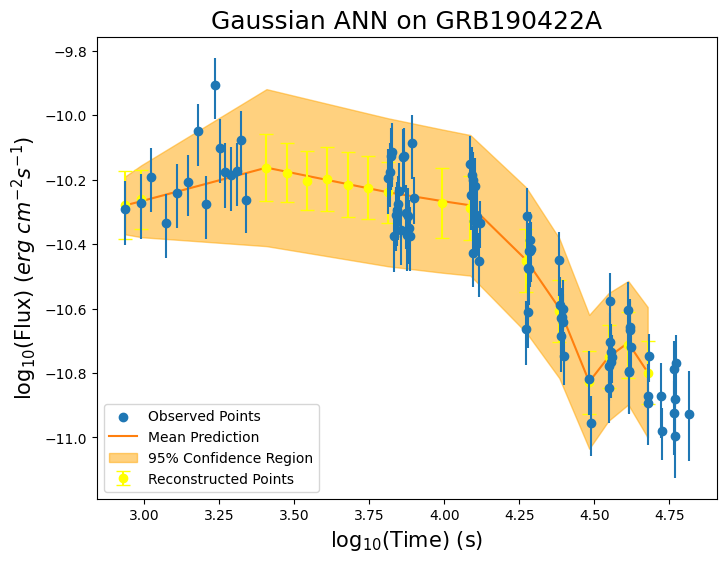


-----TRAINING FOR GRB190511A-----


-----ORIGINAL GRB-----



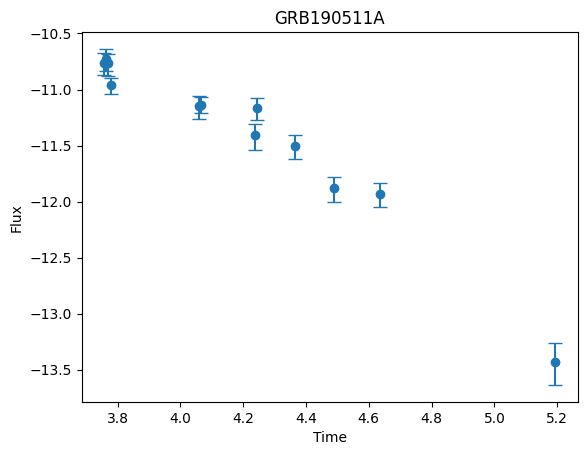


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.3858
Epoch 50, Loss: -0.9269
Epoch 100, Loss: -0.9662
Epoch 150, Loss: -0.9931
Epoch 200, Loss: -1.0142
Epoch 250, Loss: -1.0393
Epoch 300, Loss: -0.7694
Epoch 350, Loss: -1.0624
Epoch 400, Loss: -1.0597
Epoch 450, Loss: -1.0668

-----RECONSTRUCTED GRB-----



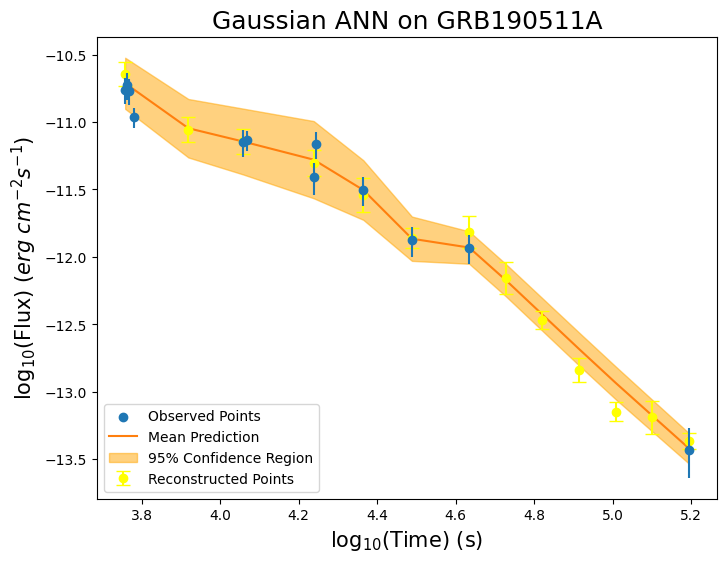


-----TRAINING FOR GRB190515B-----


-----ORIGINAL GRB-----



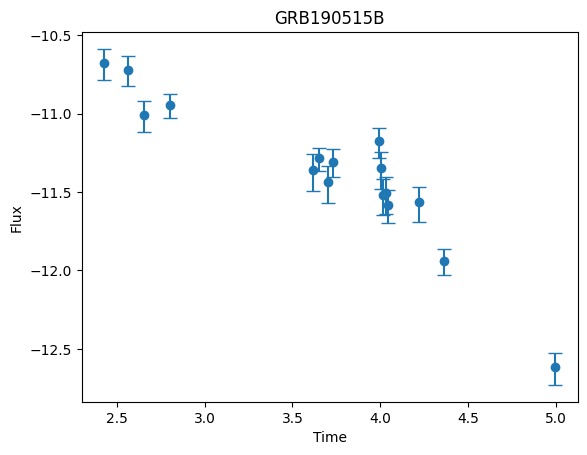


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.5046
Epoch 50, Loss: -0.6841
Epoch 100, Loss: -0.7268
Epoch 150, Loss: -0.7496
Epoch 200, Loss: -0.7596
Epoch 250, Loss: -0.7666
Epoch 300, Loss: -0.7848
Epoch 350, Loss: -0.7839
Epoch 400, Loss: -0.8022
Epoch 450, Loss: -0.8164

-----RECONSTRUCTED GRB-----



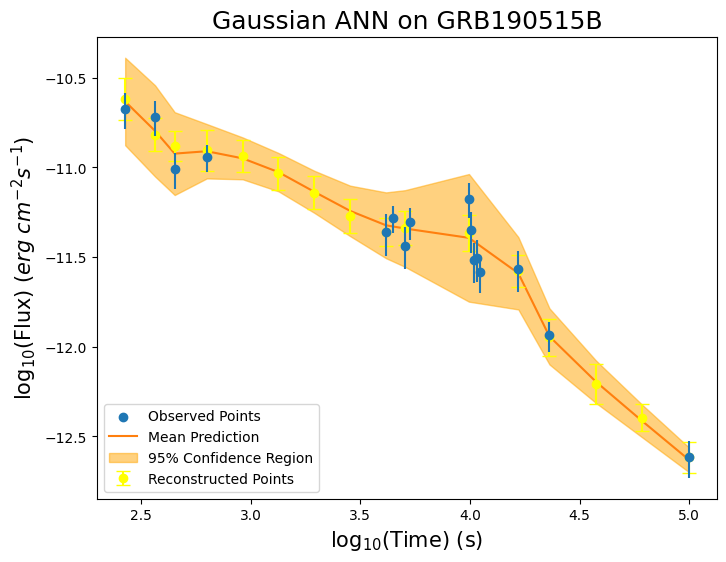


-----TRAINING FOR GRB190519A-----


-----ORIGINAL GRB-----



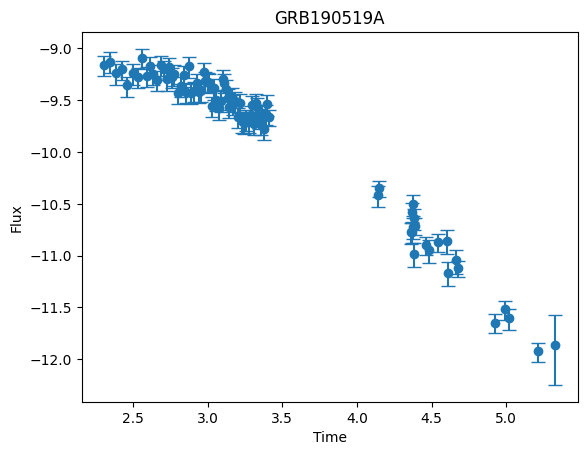


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.3352
Epoch 50, Loss: -0.8815
Epoch 100, Loss: -0.8068
Epoch 150, Loss: -0.7725
Epoch 200, Loss: -0.8737
Epoch 250, Loss: -0.7548
Epoch 300, Loss: -0.8783
Epoch 350, Loss: -0.9190
Epoch 400, Loss: -0.9255
Epoch 450, Loss: -0.9153

-----RECONSTRUCTED GRB-----



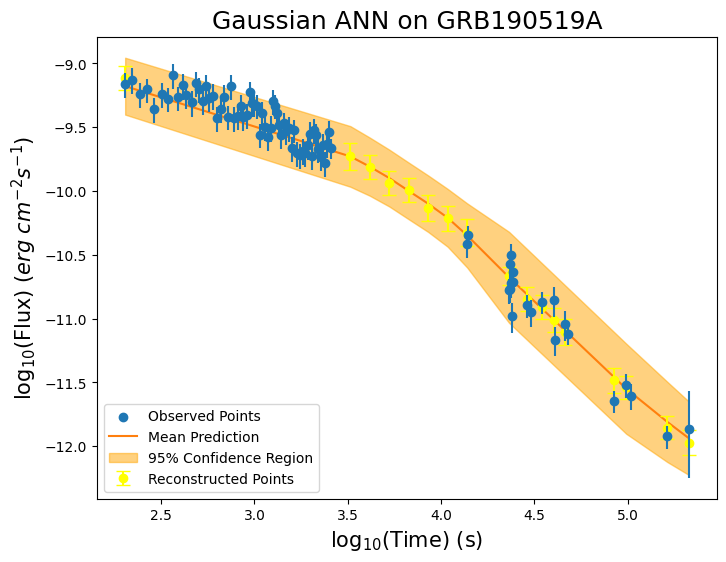


-----TRAINING FOR GRB190604B-----


-----ORIGINAL GRB-----



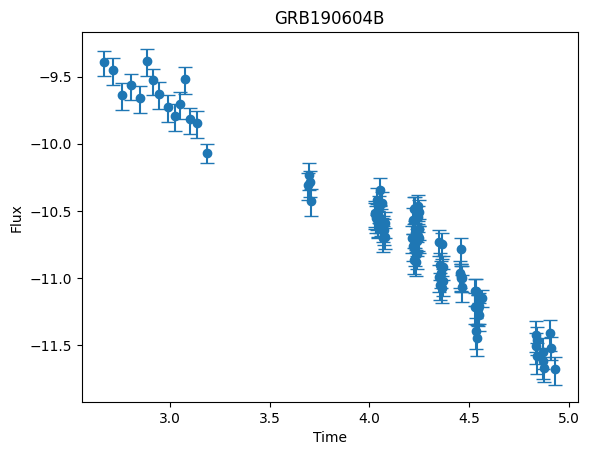


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.4620
Epoch 50, Loss: -0.7723
Epoch 100, Loss: -0.7775
Epoch 150, Loss: -0.7744
Epoch 200, Loss: -0.6424
Epoch 250, Loss: -0.7833
Epoch 300, Loss: -0.7576
Epoch 350, Loss: -0.6996
Epoch 400, Loss: -0.7023
Epoch 450, Loss: -0.7107

-----RECONSTRUCTED GRB-----



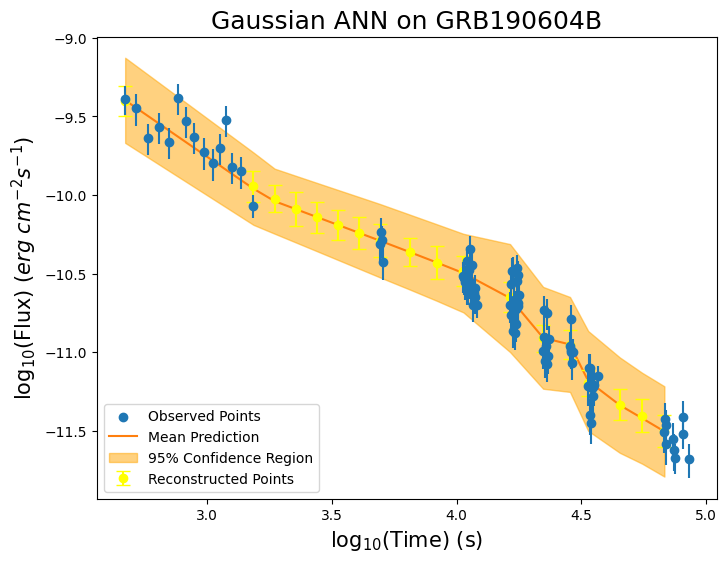


-----TRAINING FOR GRB190613B-----


-----ORIGINAL GRB-----



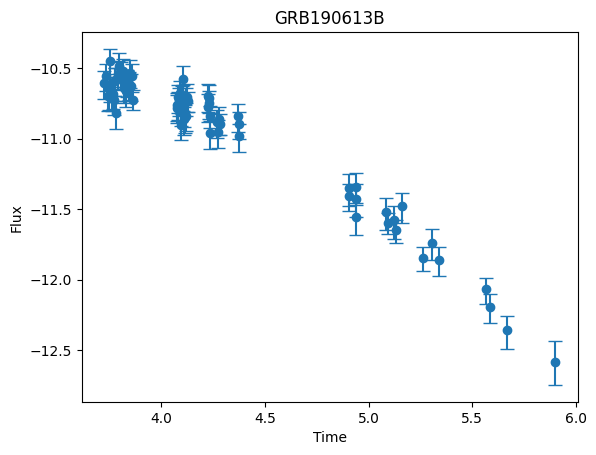


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.4783
Epoch 50, Loss: -0.7564
Epoch 100, Loss: -0.7304
Epoch 150, Loss: -0.6164
Epoch 200, Loss: -0.8930
Epoch 250, Loss: -0.7168
Epoch 300, Loss: -0.7419
Epoch 350, Loss: -0.8586
Epoch 400, Loss: -0.9183
Epoch 450, Loss: -0.7684

-----RECONSTRUCTED GRB-----



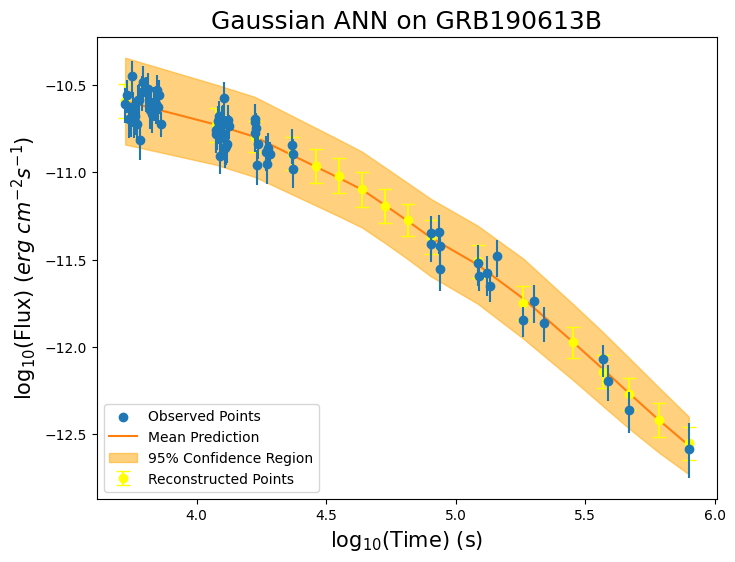


-----TRAINING FOR GRB190706B-----


-----ORIGINAL GRB-----



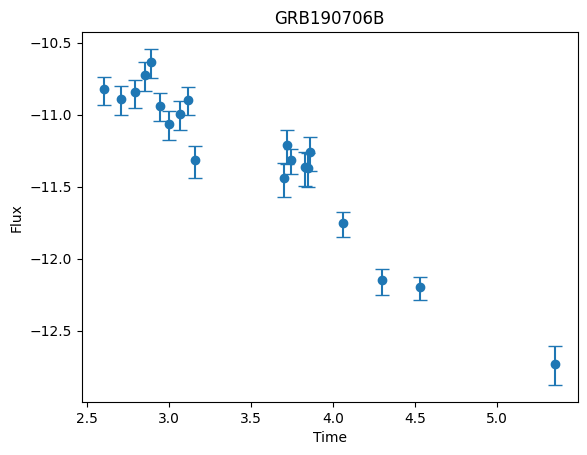


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.5380
Epoch 50, Loss: -0.7358
Epoch 100, Loss: -0.8269
Epoch 150, Loss: -0.8377
Epoch 200, Loss: -0.8540
Epoch 250, Loss: -0.8573
Epoch 300, Loss: -0.8765
Epoch 350, Loss: -0.8941
Epoch 400, Loss: -0.9133
Epoch 450, Loss: -0.9291

-----RECONSTRUCTED GRB-----



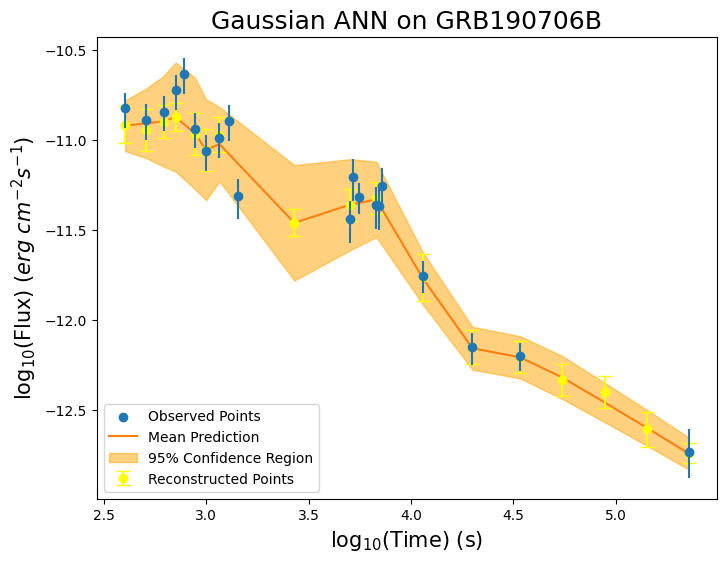


-----TRAINING FOR GRB190719C-----


-----ORIGINAL GRB-----



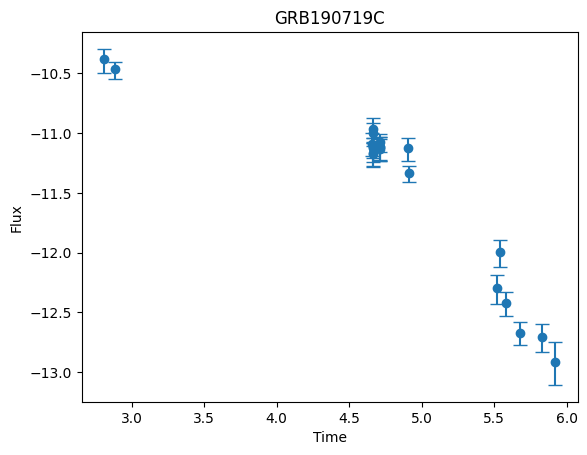


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.5093
Epoch 50, Loss: -0.9197
Epoch 100, Loss: -0.9295
Epoch 150, Loss: -0.9367
Epoch 200, Loss: -0.9440
Epoch 250, Loss: -0.9509
Epoch 300, Loss: -0.9559
Epoch 350, Loss: -0.9599
Epoch 400, Loss: -0.9647
Epoch 450, Loss: -0.9721

-----RECONSTRUCTED GRB-----



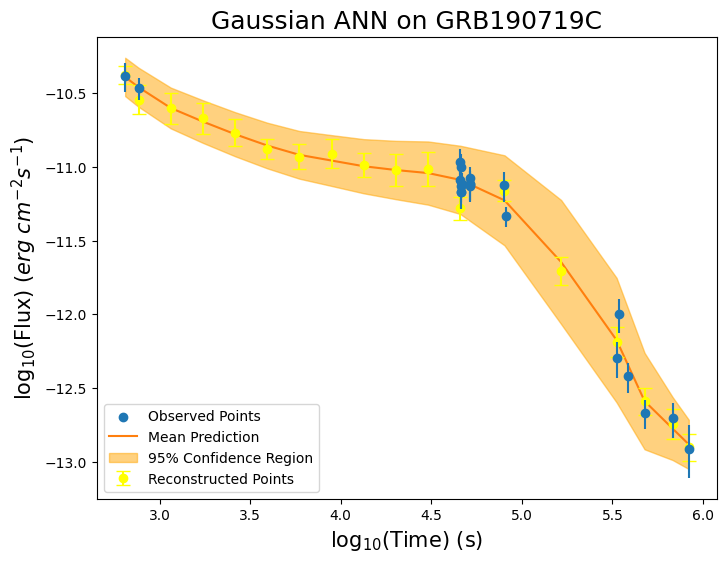


-----TRAINING FOR GRB050315-----


-----ORIGINAL GRB-----



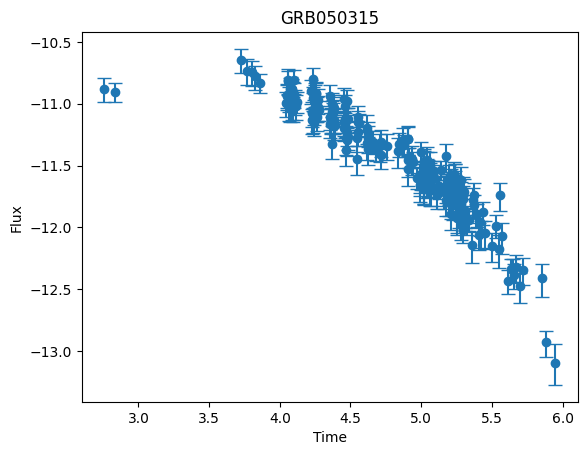


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: -0.2049
Epoch 50, Loss: -0.7050
Epoch 100, Loss: -0.7901
Epoch 150, Loss: -0.6674
Epoch 200, Loss: -0.8242
Epoch 250, Loss: -0.4360
Epoch 300, Loss: -0.3550
Epoch 350, Loss: -0.8355
Epoch 400, Loss: -0.7616
Epoch 450, Loss: -0.6204

-----RECONSTRUCTED GRB-----



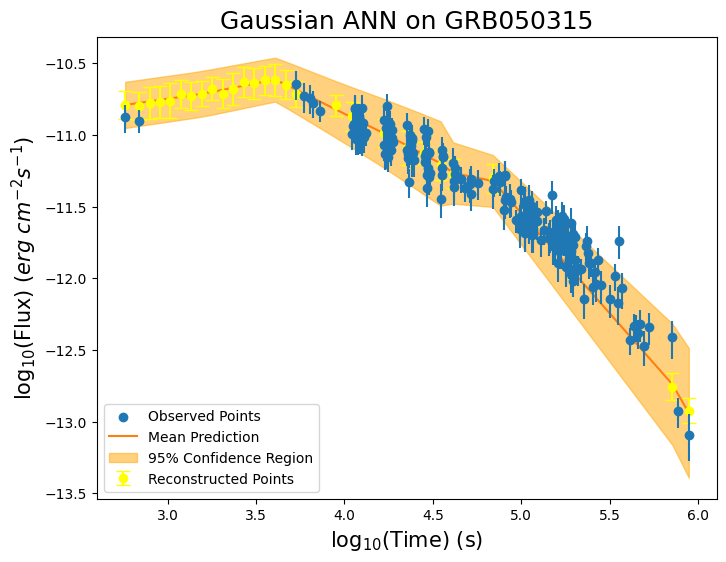


-----TRAINING FOR GRB050319-----


-----ORIGINAL GRB-----



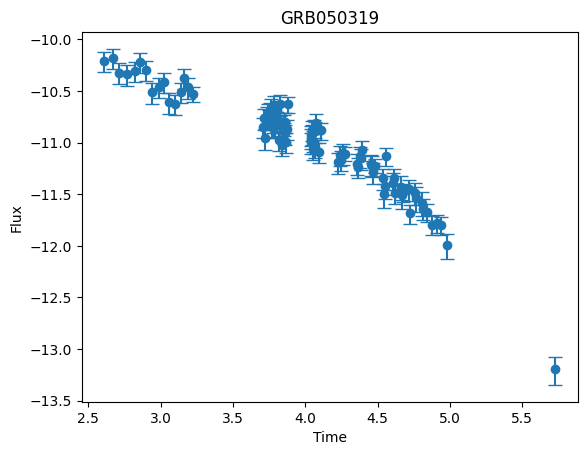


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.1516
Epoch 50, Loss: -0.6804
Epoch 100, Loss: -0.7096
Epoch 150, Loss: -0.7439
Epoch 200, Loss: -0.6904
Epoch 250, Loss: -0.6993
Epoch 300, Loss: -0.6231
Epoch 350, Loss: -0.6767
Epoch 400, Loss: -0.7304
Epoch 450, Loss: -0.6593

-----RECONSTRUCTED GRB-----



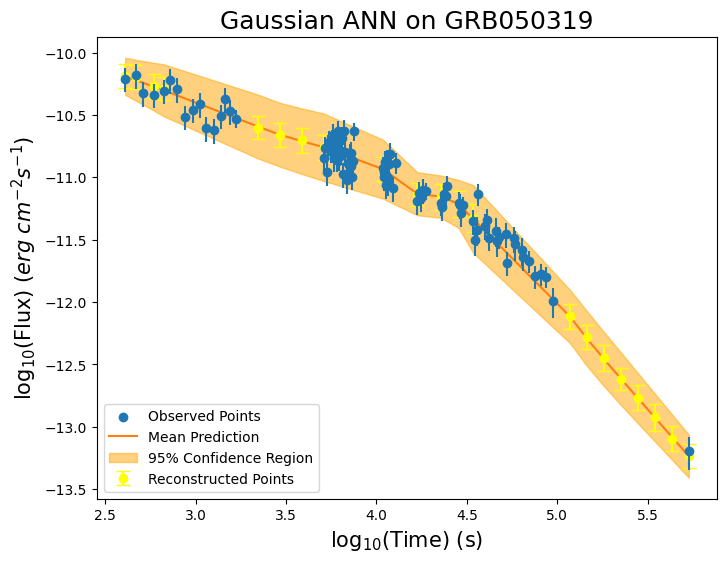


-----TRAINING FOR GRB050401-----


-----ORIGINAL GRB-----



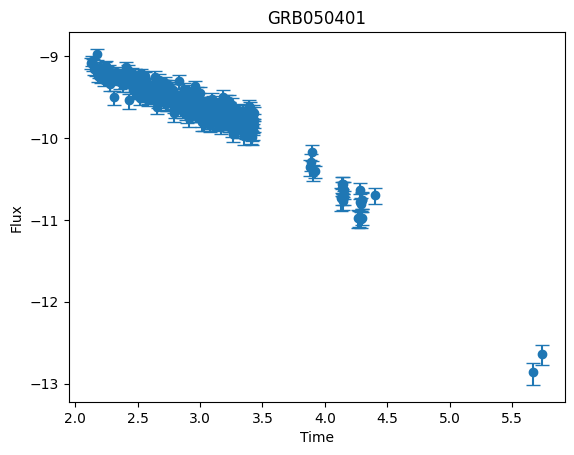


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.3357
Epoch 50, Loss: -0.1130
Epoch 100, Loss: 0.0419
Epoch 150, Loss: -0.9130
Epoch 200, Loss: -0.3960
Epoch 250, Loss: -0.8610
Epoch 300, Loss: -0.9046
Epoch 350, Loss: -0.7289
Epoch 400, Loss: -0.8326
Epoch 450, Loss: -0.9295

-----RECONSTRUCTED GRB-----



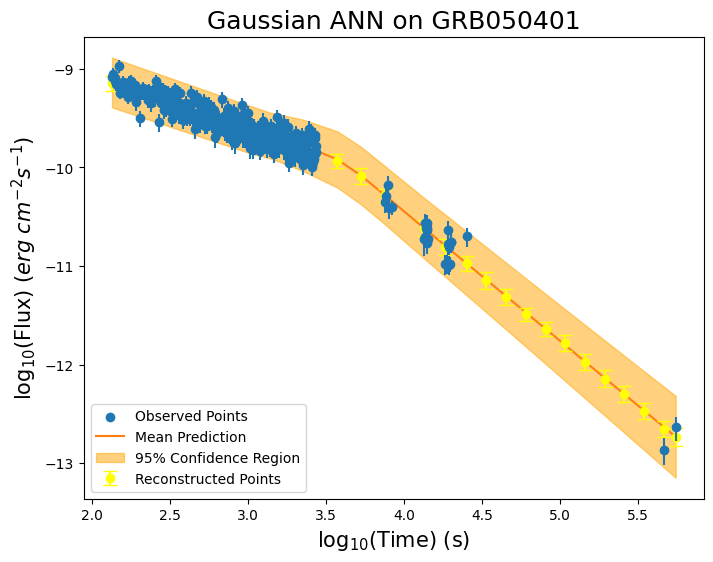


-----TRAINING FOR GRB050416A-----


-----ORIGINAL GRB-----



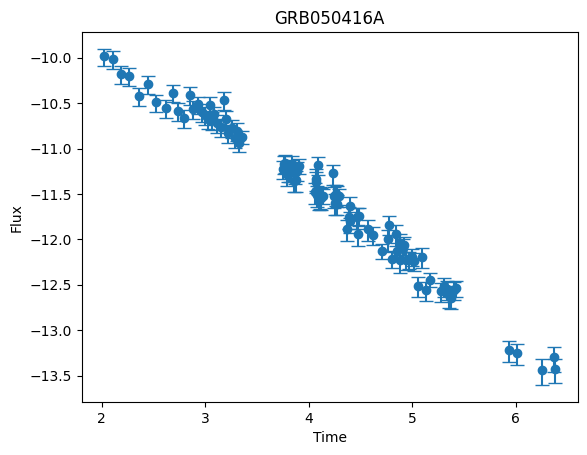


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.0691
Epoch 50, Loss: -0.9396
Epoch 100, Loss: -1.0551
Epoch 150, Loss: -0.8286
Epoch 200, Loss: -0.9677
Epoch 250, Loss: -1.0207
Epoch 300, Loss: -1.0486
Epoch 350, Loss: -0.9758
Epoch 400, Loss: -0.8429
Epoch 450, Loss: -0.8738

-----RECONSTRUCTED GRB-----



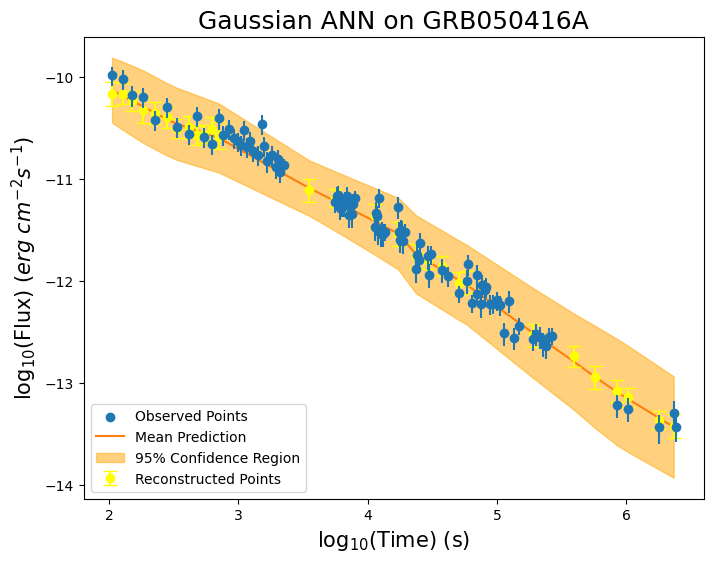


-----TRAINING FOR GRB050730-----


-----ORIGINAL GRB-----



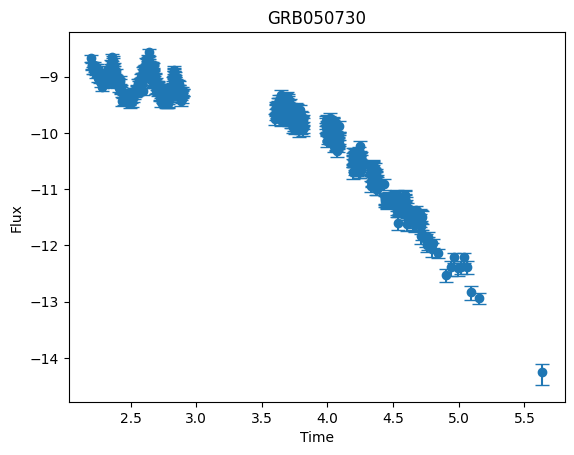


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.2624
Epoch 50, Loss: -0.9168
Epoch 100, Loss: -1.0043
Epoch 150, Loss: -0.7489
Epoch 200, Loss: -0.6392
Epoch 250, Loss: -0.8317
Epoch 300, Loss: -0.9612
Epoch 350, Loss: -0.8950
Epoch 400, Loss: -0.9278
Epoch 450, Loss: -0.8098

-----RECONSTRUCTED GRB-----



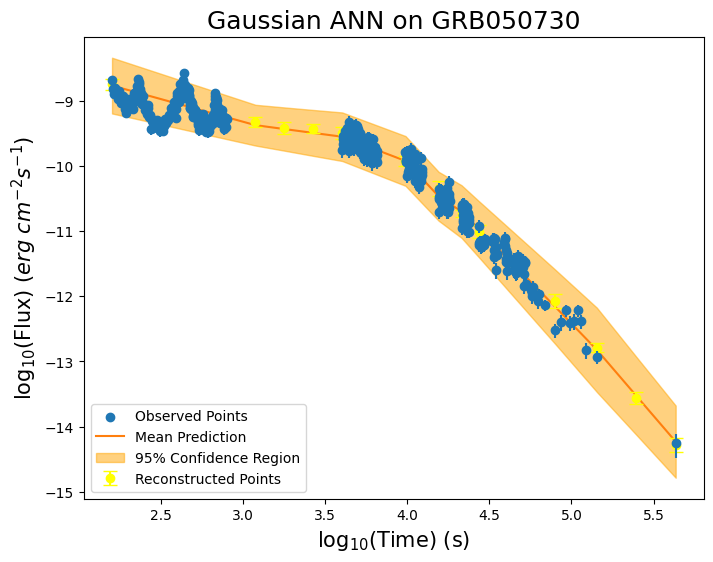


-----TRAINING FOR GRB050802-----


-----ORIGINAL GRB-----



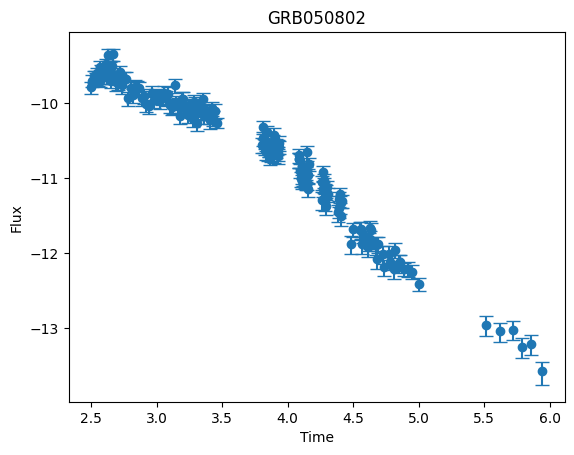


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.1058
Epoch 50, Loss: -0.8138
Epoch 100, Loss: -0.8925
Epoch 150, Loss: -0.9661
Epoch 200, Loss: -0.7773
Epoch 250, Loss: -0.9239
Epoch 300, Loss: -0.9735
Epoch 350, Loss: -0.9962
Epoch 400, Loss: -1.0310
Epoch 450, Loss: -0.9760

-----RECONSTRUCTED GRB-----



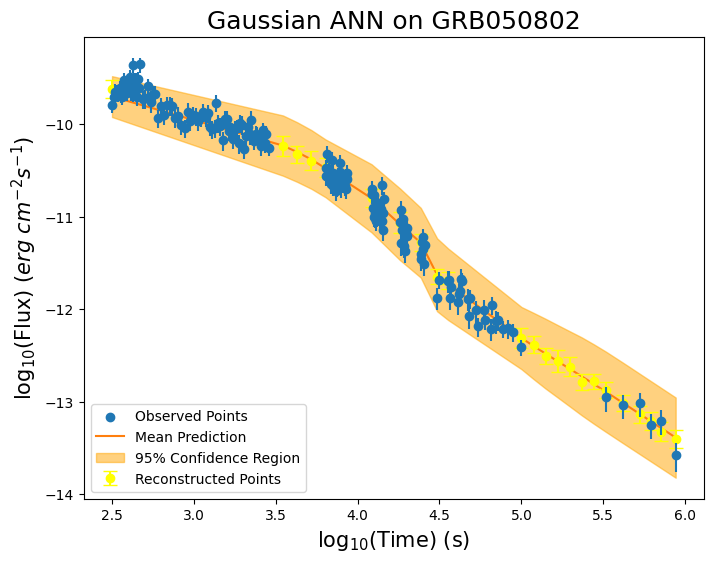


-----TRAINING FOR GRB050803-----


-----ORIGINAL GRB-----



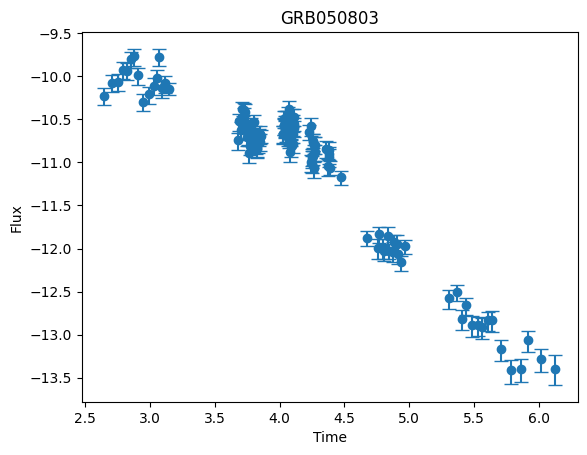


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.1009
Epoch 50, Loss: -0.8384
Epoch 100, Loss: -0.8887
Epoch 150, Loss: -0.9042
Epoch 200, Loss: -0.8721
Epoch 250, Loss: -0.8910
Epoch 300, Loss: -0.9265
Epoch 350, Loss: -0.7992
Epoch 400, Loss: -0.9241
Epoch 450, Loss: -0.8034

-----RECONSTRUCTED GRB-----



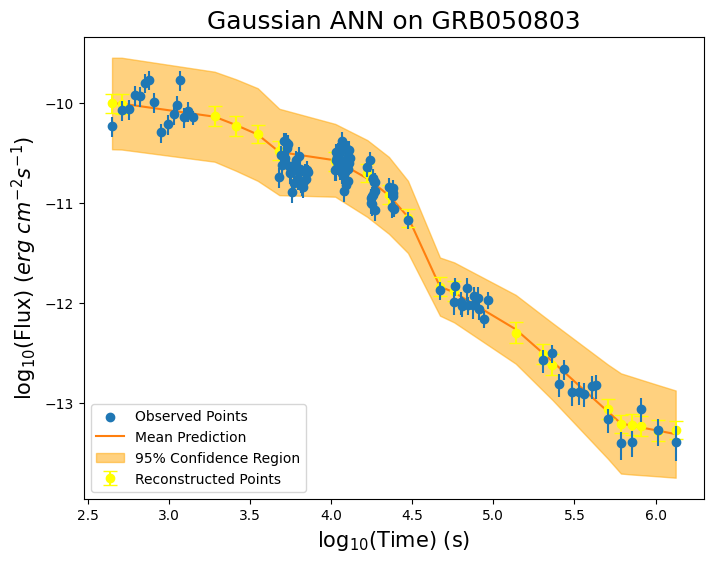


-----TRAINING FOR GRB050824-----


-----ORIGINAL GRB-----



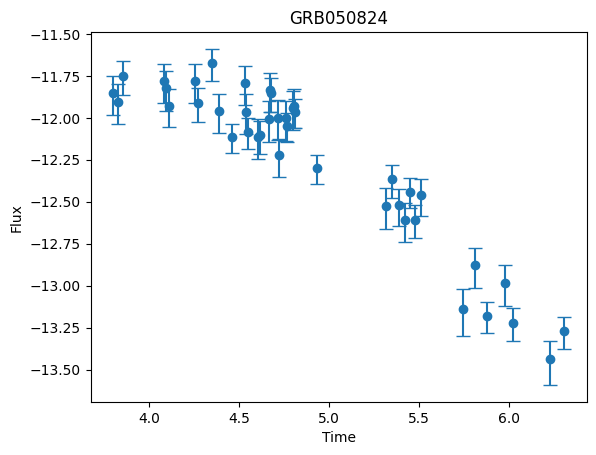


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.3449
Epoch 50, Loss: -0.5604
Epoch 100, Loss: -0.5357
Epoch 150, Loss: -0.6823
Epoch 200, Loss: -0.7033
Epoch 250, Loss: -0.6967
Epoch 300, Loss: -0.7042
Epoch 350, Loss: -0.6340
Epoch 400, Loss: -0.6669
Epoch 450, Loss: -0.7176

-----RECONSTRUCTED GRB-----



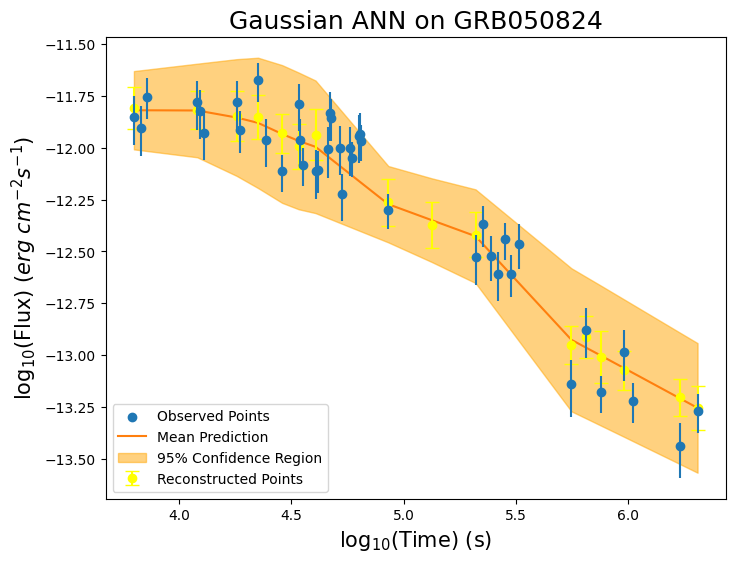


-----TRAINING FOR GRB050826-----


-----ORIGINAL GRB-----



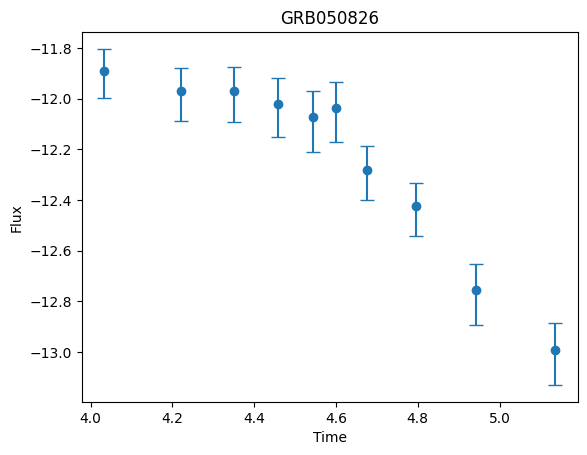


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.5714
Epoch 50, Loss: -1.0840
Epoch 100, Loss: -1.1354
Epoch 150, Loss: -1.1160
Epoch 200, Loss: -1.1971
Epoch 250, Loss: -1.2296
Epoch 300, Loss: -1.2336
Epoch 350, Loss: -1.2383
Epoch 400, Loss: -1.2406
Epoch 450, Loss: -1.2496

-----RECONSTRUCTED GRB-----



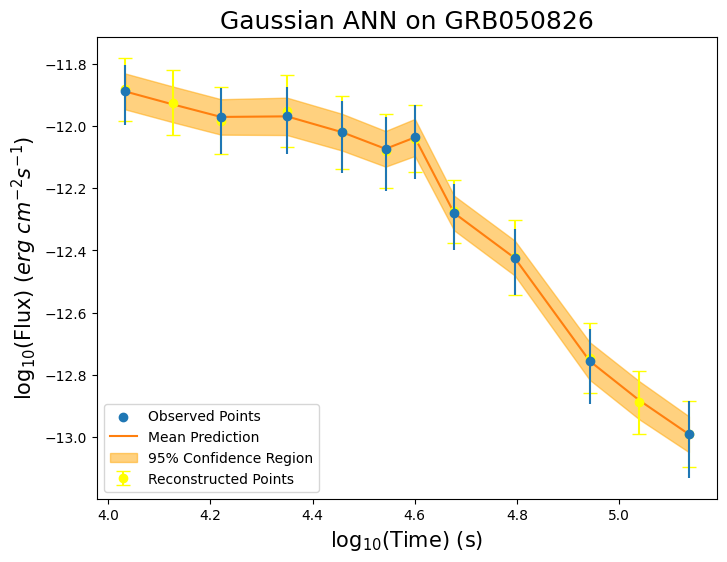


-----TRAINING FOR GRB051016B-----


-----ORIGINAL GRB-----



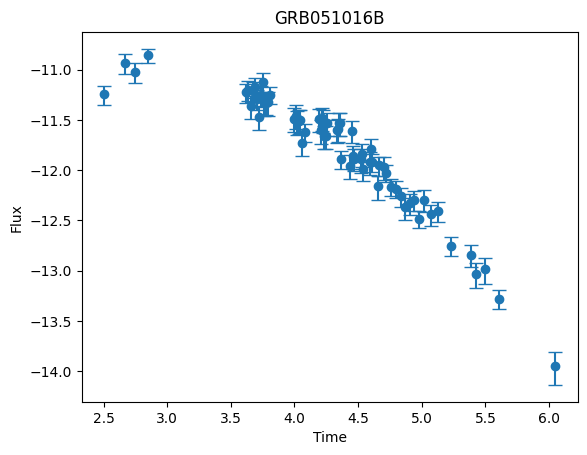


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.2008
Epoch 50, Loss: -0.9880
Epoch 100, Loss: -0.6512
Epoch 150, Loss: -0.7903
Epoch 200, Loss: -0.6838
Epoch 250, Loss: -0.4498
Epoch 300, Loss: -0.9265
Epoch 350, Loss: -0.8130
Epoch 400, Loss: -0.8236
Epoch 450, Loss: -0.7710

-----RECONSTRUCTED GRB-----



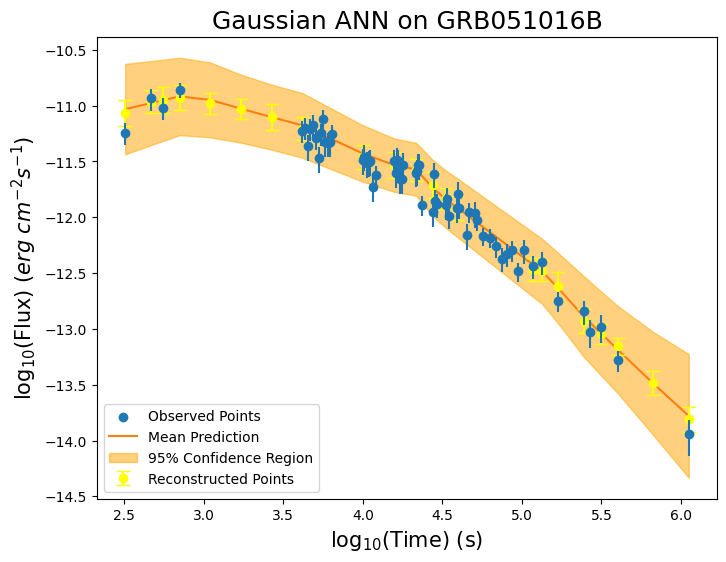


-----TRAINING FOR GRB051109A-----


-----ORIGINAL GRB-----



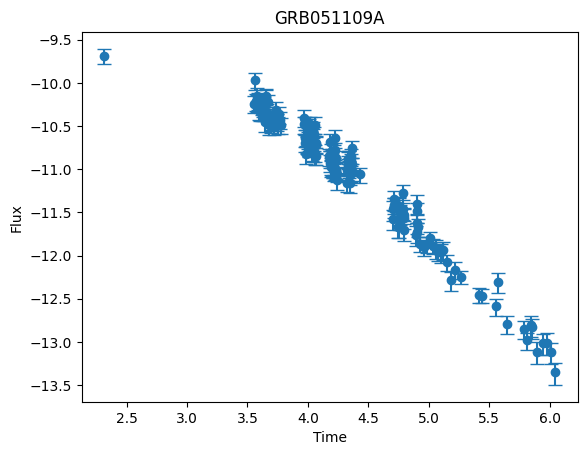


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.0215
Epoch 50, Loss: -0.8944
Epoch 100, Loss: -0.7094
Epoch 150, Loss: -0.9061
Epoch 200, Loss: -0.7663
Epoch 250, Loss: -0.9557
Epoch 300, Loss: -0.9578
Epoch 350, Loss: -0.9897
Epoch 400, Loss: -0.9714
Epoch 450, Loss: 0.1707

-----RECONSTRUCTED GRB-----



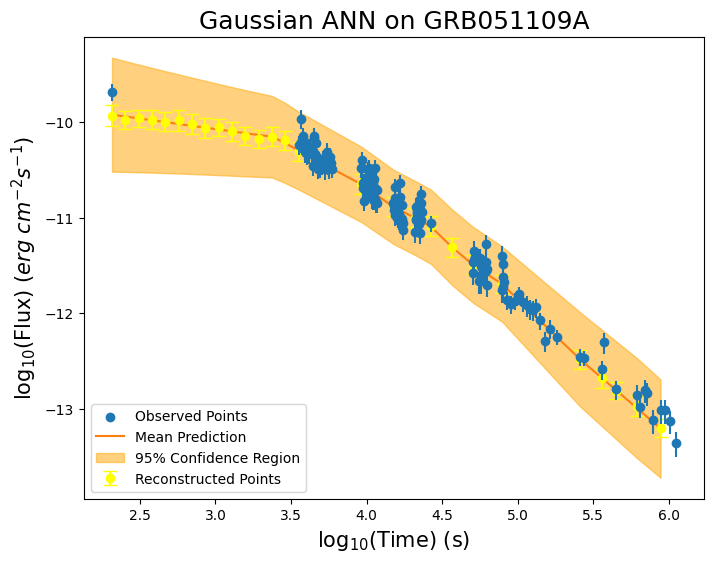


-----TRAINING FOR GRB051109B-----


-----ORIGINAL GRB-----



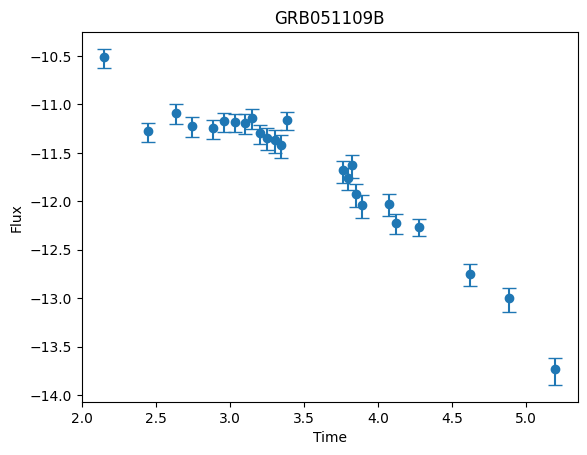


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.5845
Epoch 50, Loss: -0.8137
Epoch 100, Loss: -0.9213
Epoch 150, Loss: -0.9593
Epoch 200, Loss: -0.9793
Epoch 250, Loss: -0.9851
Epoch 300, Loss: -0.9906
Epoch 350, Loss: -0.9908
Epoch 400, Loss: -0.9967
Epoch 450, Loss: -0.9976

-----RECONSTRUCTED GRB-----



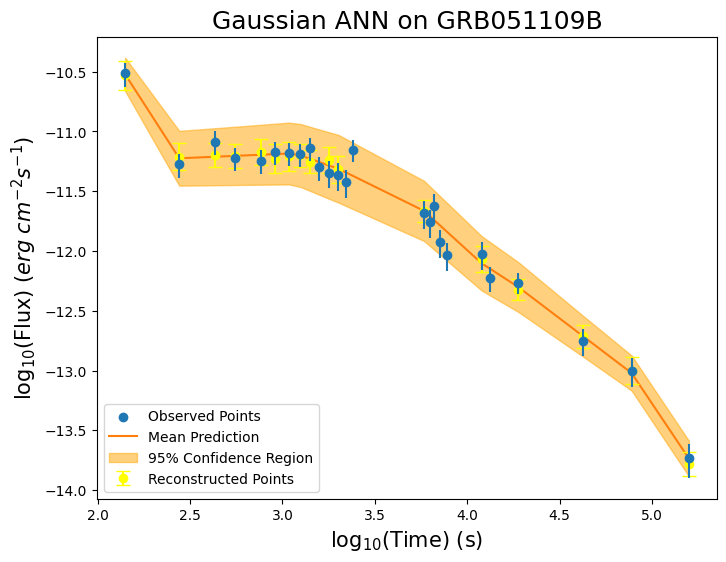


-----TRAINING FOR GRB051221A-----


-----ORIGINAL GRB-----



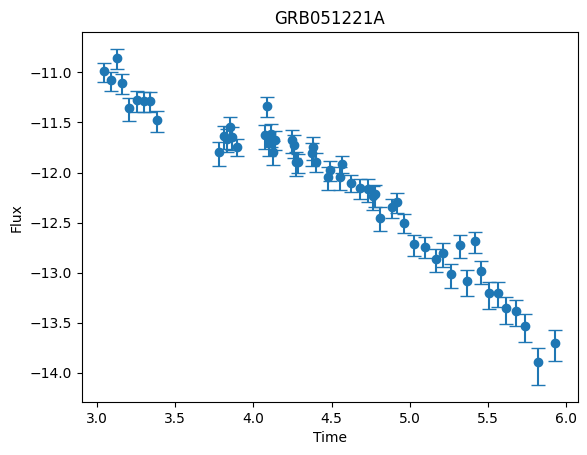


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.4391
Epoch 50, Loss: -0.7642
Epoch 100, Loss: -0.8126
Epoch 150, Loss: -0.7658
Epoch 200, Loss: -0.8940
Epoch 250, Loss: -0.8399
Epoch 300, Loss: -0.8387
Epoch 350, Loss: -0.7604
Epoch 400, Loss: -0.8577
Epoch 450, Loss: -0.8595

-----RECONSTRUCTED GRB-----



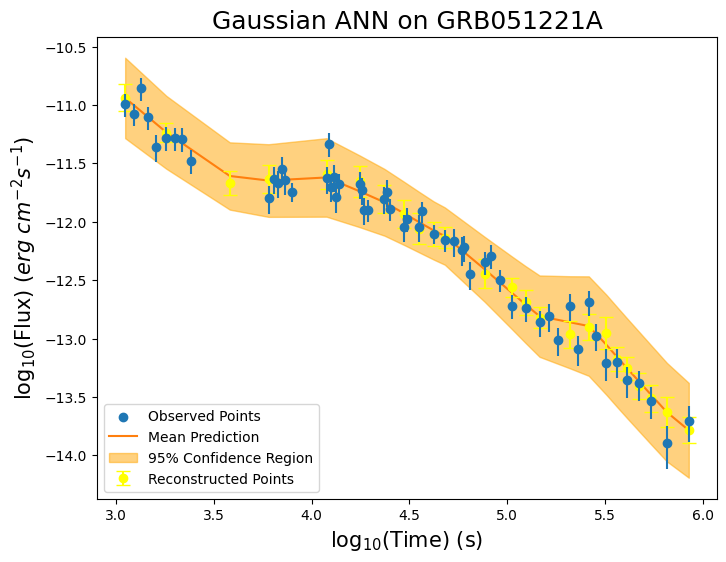


-----TRAINING FOR GRB060115-----


-----ORIGINAL GRB-----



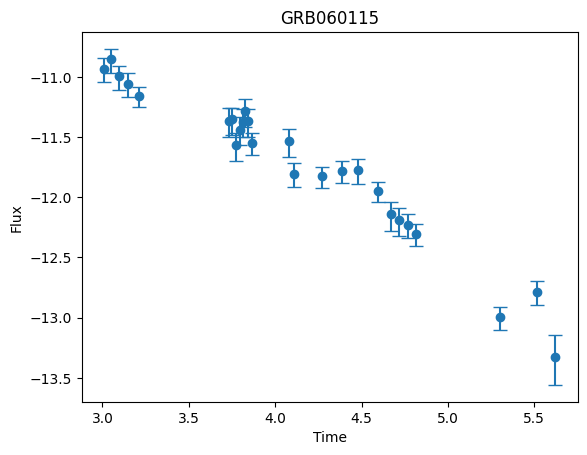


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.5238
Epoch 50, Loss: -0.8317
Epoch 100, Loss: -0.8700
Epoch 150, Loss: -0.9184
Epoch 200, Loss: -0.9338
Epoch 250, Loss: -0.9365
Epoch 300, Loss: -0.9443
Epoch 350, Loss: -0.9452
Epoch 400, Loss: -0.9533
Epoch 450, Loss: -0.9620

-----RECONSTRUCTED GRB-----



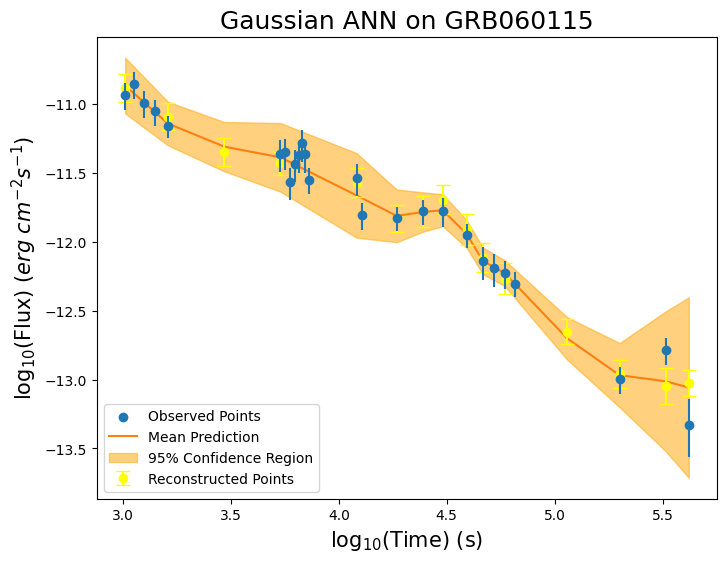


-----TRAINING FOR GRB060124-----


-----ORIGINAL GRB-----



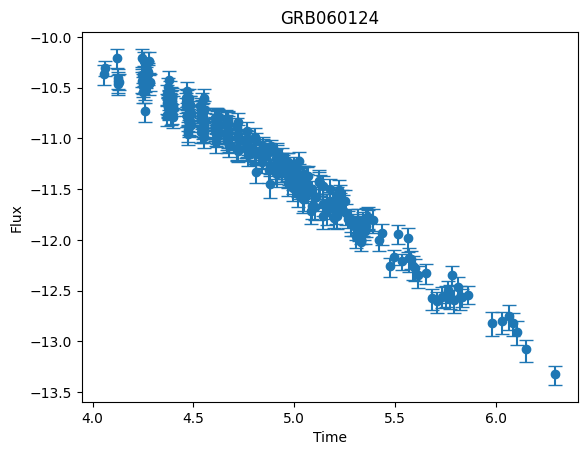


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: -0.4413
Epoch 50, Loss: -0.6639
Epoch 100, Loss: -1.0403
Epoch 150, Loss: -0.7795
Epoch 200, Loss: -1.0004
Epoch 250, Loss: -0.7883
Epoch 300, Loss: -0.9303
Epoch 350, Loss: -0.6482
Epoch 400, Loss: -0.8998
Epoch 450, Loss: -0.7735

-----RECONSTRUCTED GRB-----



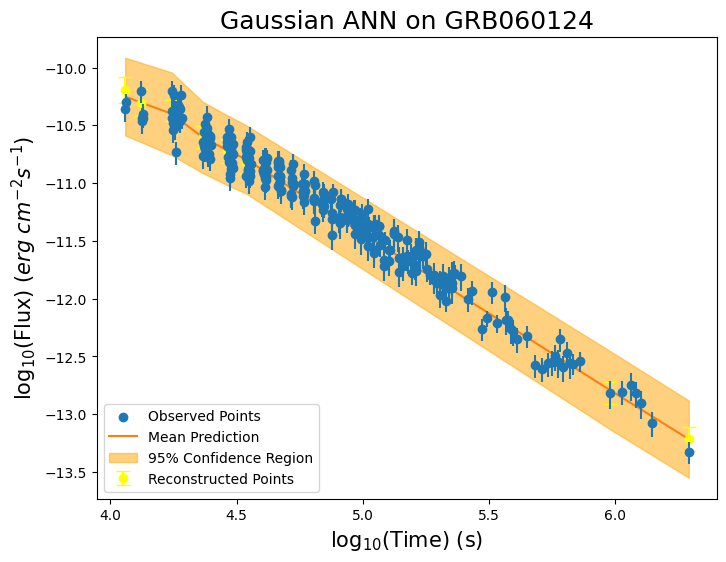


-----TRAINING FOR GRB060206-----


-----ORIGINAL GRB-----



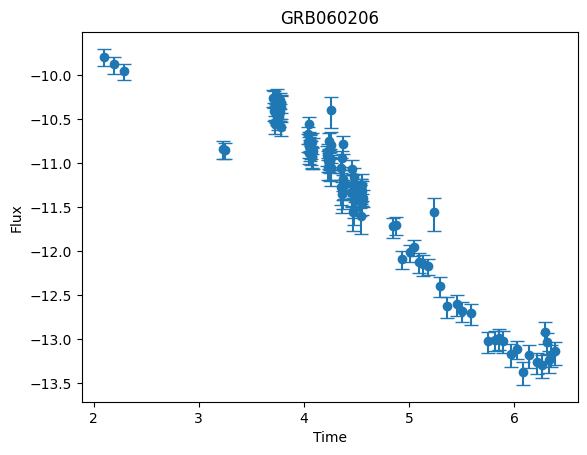


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.2375
Epoch 50, Loss: -0.8457
Epoch 100, Loss: -0.7615
Epoch 150, Loss: -0.8634
Epoch 200, Loss: -0.8337
Epoch 250, Loss: -0.8545
Epoch 300, Loss: -0.8968
Epoch 350, Loss: -0.9141
Epoch 400, Loss: -0.9170
Epoch 450, Loss: -0.9471

-----RECONSTRUCTED GRB-----



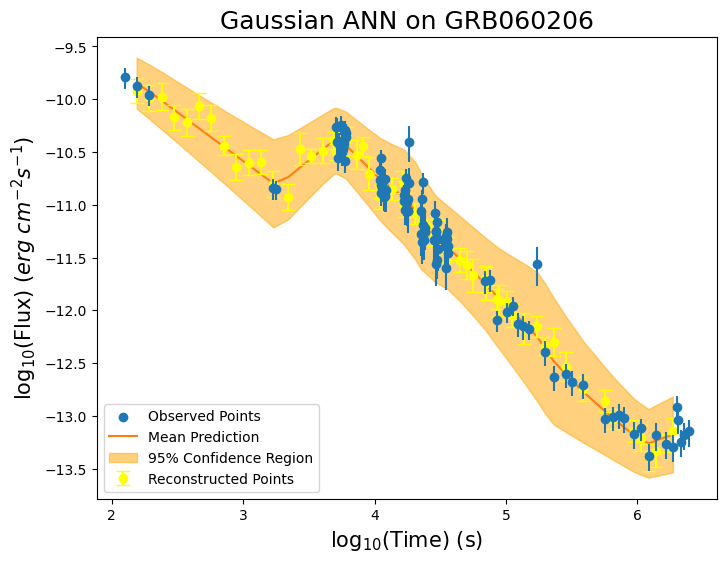


-----TRAINING FOR GRB060210-----


-----ORIGINAL GRB-----



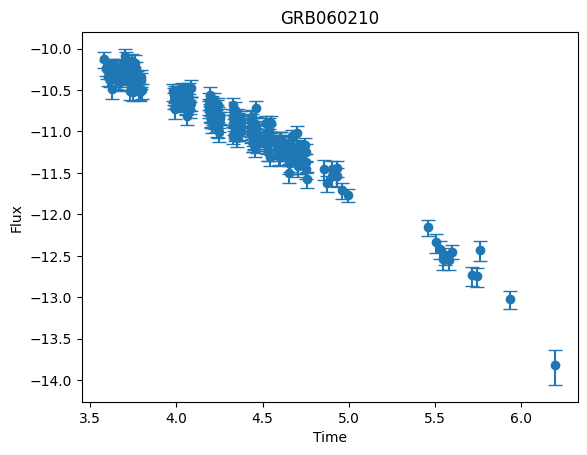


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: -0.2045
Epoch 50, Loss: -0.8312
Epoch 100, Loss: -0.8357
Epoch 150, Loss: -0.9171
Epoch 200, Loss: -0.8620
Epoch 250, Loss: -0.8348
Epoch 300, Loss: -0.8665
Epoch 350, Loss: -0.5257
Epoch 400, Loss: -0.6584
Epoch 450, Loss: -0.4954

-----RECONSTRUCTED GRB-----



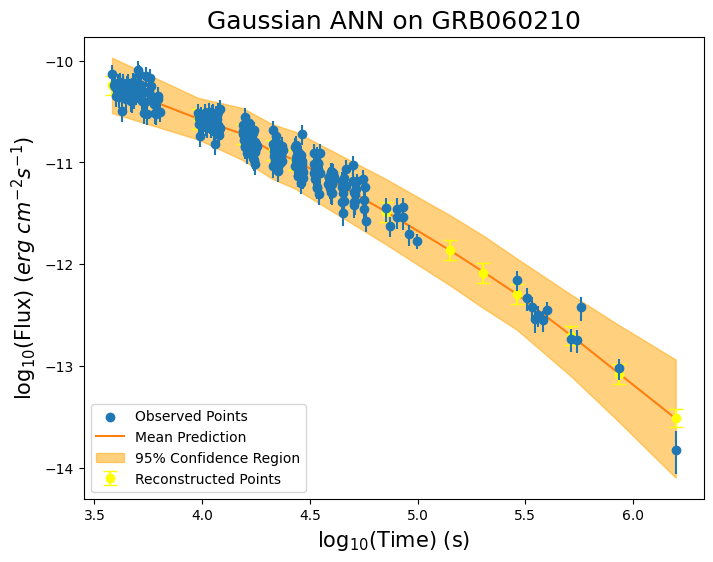


-----TRAINING FOR GRB060218-----


-----ORIGINAL GRB-----



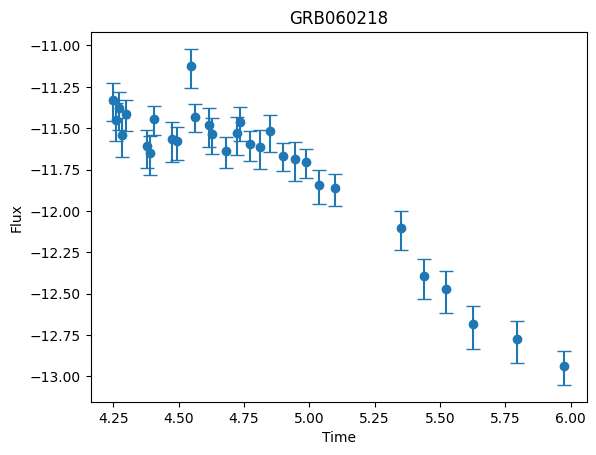


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.5676
Epoch 50, Loss: -0.6958
Epoch 100, Loss: -0.7840
Epoch 150, Loss: -0.8325
Epoch 200, Loss: -0.8343
Epoch 250, Loss: -0.8730
Epoch 300, Loss: -0.8971
Epoch 350, Loss: -0.9095
Epoch 400, Loss: -0.9000
Epoch 450, Loss: -0.9472

-----RECONSTRUCTED GRB-----



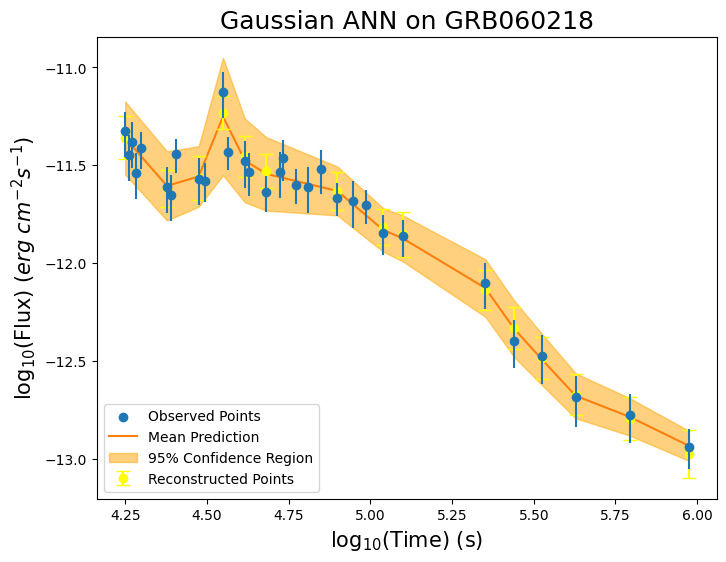


-----TRAINING FOR GRB060223A-----


-----ORIGINAL GRB-----



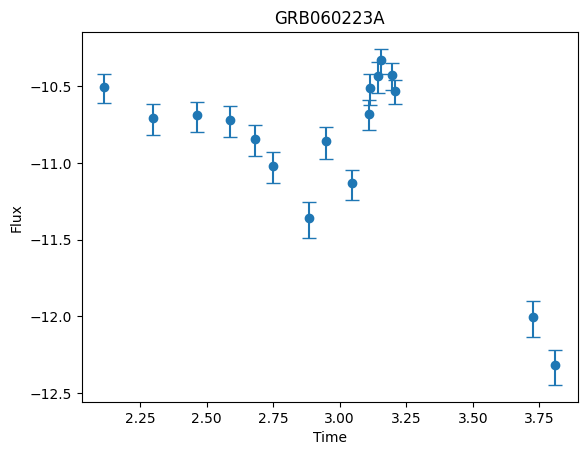


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.5607
Epoch 50, Loss: -0.5852
Epoch 100, Loss: -0.7952
Epoch 150, Loss: -0.8672
Epoch 200, Loss: -0.9663
Epoch 250, Loss: -0.9914
Epoch 300, Loss: -0.9729
Epoch 350, Loss: -1.0084
Epoch 400, Loss: -1.0117
Epoch 450, Loss: -1.0001

-----RECONSTRUCTED GRB-----



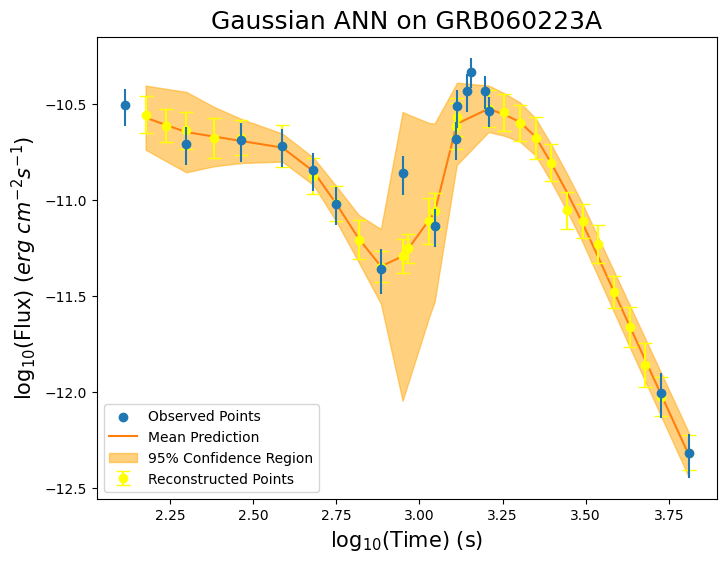


-----TRAINING FOR GRB060306-----


-----ORIGINAL GRB-----



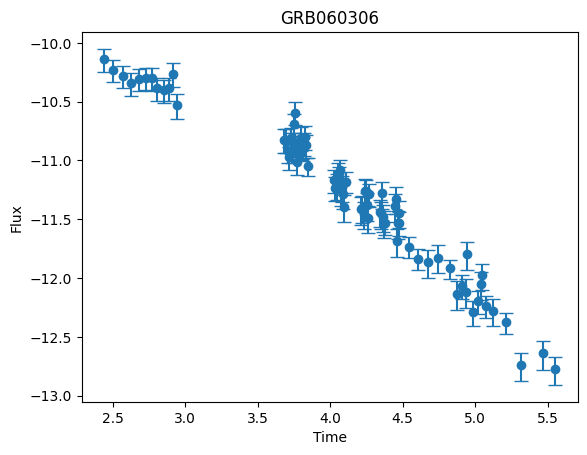


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.4091
Epoch 50, Loss: -0.6497
Epoch 100, Loss: -0.8123
Epoch 150, Loss: -0.9021
Epoch 200, Loss: -0.8066
Epoch 250, Loss: -0.7948
Epoch 300, Loss: -0.8840
Epoch 350, Loss: -0.8009
Epoch 400, Loss: -0.8051
Epoch 450, Loss: -0.7892

-----RECONSTRUCTED GRB-----



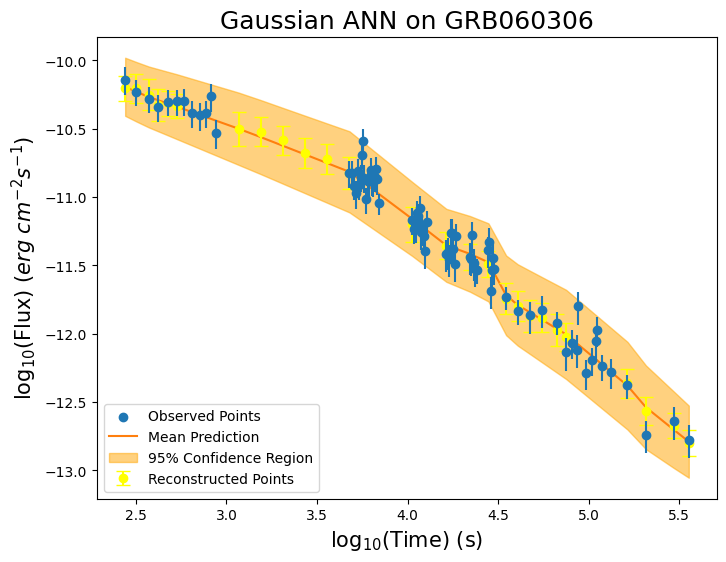


-----TRAINING FOR GRB060502A-----


-----ORIGINAL GRB-----



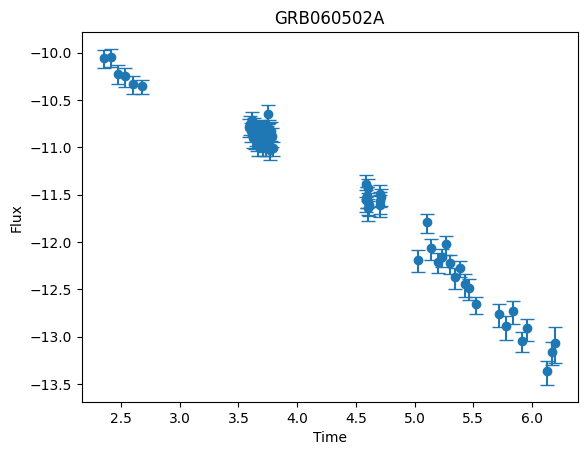


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.1402
Epoch 50, Loss: -0.8172
Epoch 100, Loss: -0.9821
Epoch 150, Loss: -1.0915
Epoch 200, Loss: -0.8647
Epoch 250, Loss: -1.0873
Epoch 300, Loss: -0.5405
Epoch 350, Loss: -0.9622
Epoch 400, Loss: -0.2542
Epoch 450, Loss: -1.0481

-----RECONSTRUCTED GRB-----



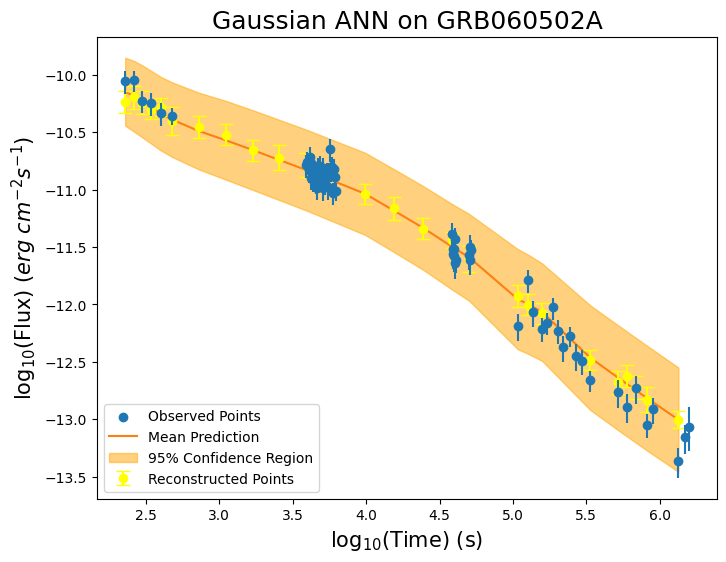


-----TRAINING FOR GRB060510B-----


-----ORIGINAL GRB-----



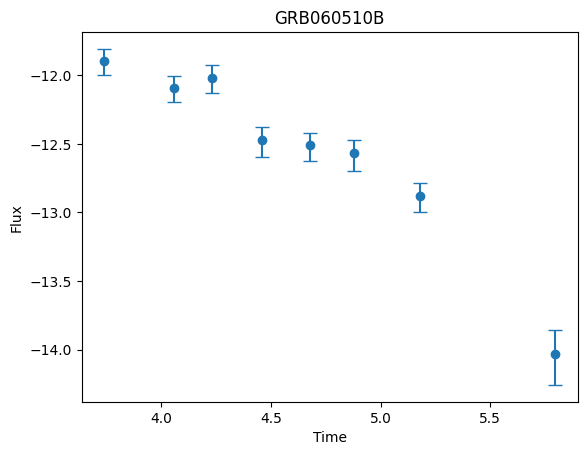


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.4845
Epoch 50, Loss: -1.0399
Epoch 100, Loss: -1.1289
Epoch 150, Loss: -1.1504
Epoch 200, Loss: -1.1332
Epoch 250, Loss: -1.1846
Epoch 300, Loss: -1.1854
Epoch 350, Loss: -1.1939
Epoch 400, Loss: -1.1932
Epoch 450, Loss: -1.2126

-----RECONSTRUCTED GRB-----



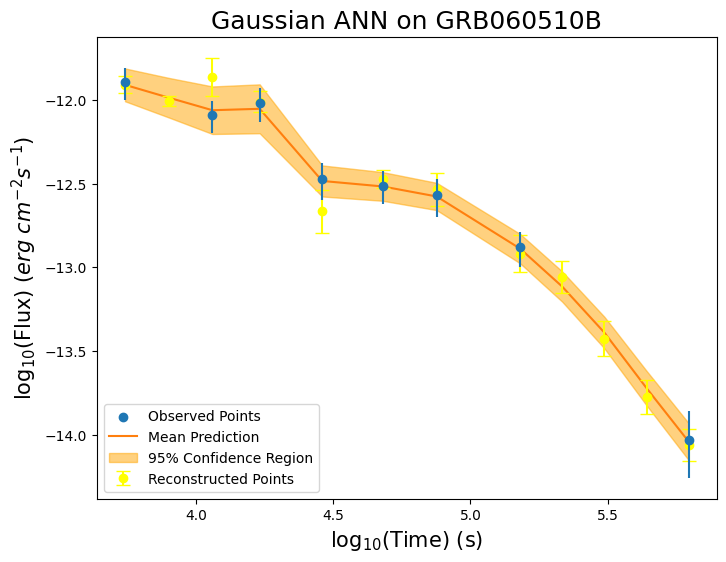


-----TRAINING FOR GRB060526-----


-----ORIGINAL GRB-----



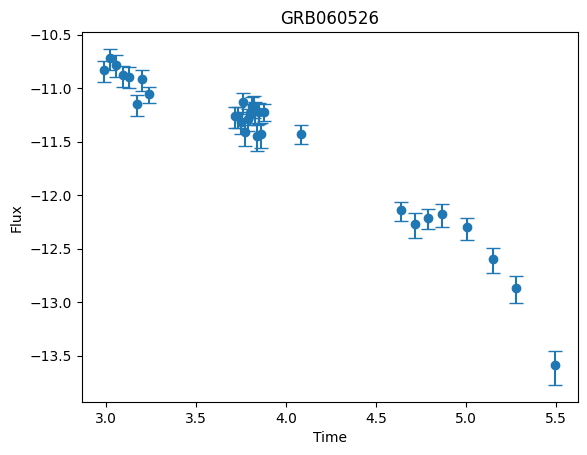


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.5052
Epoch 50, Loss: -0.8741
Epoch 100, Loss: -0.9235
Epoch 150, Loss: -0.9249
Epoch 200, Loss: -0.9392
Epoch 250, Loss: -0.9343
Epoch 300, Loss: -0.9448
Epoch 350, Loss: -0.9491
Epoch 400, Loss: -0.9566
Epoch 450, Loss: -0.9615

-----RECONSTRUCTED GRB-----



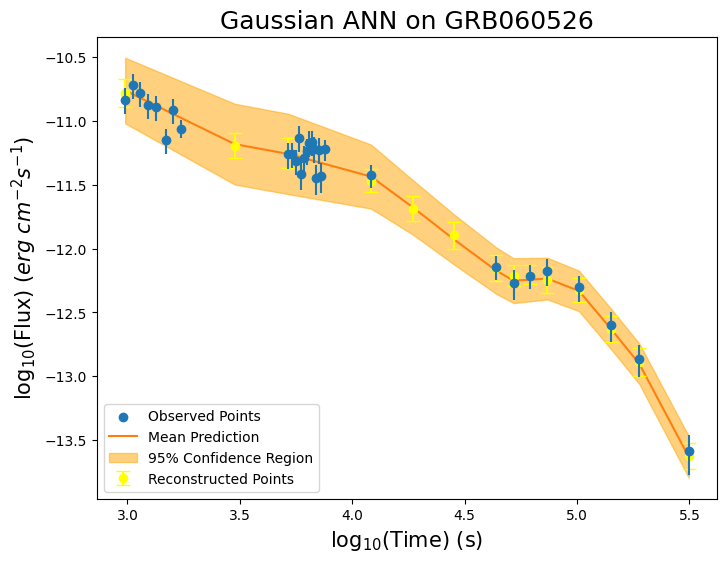


-----TRAINING FOR GRB060604-----


-----ORIGINAL GRB-----



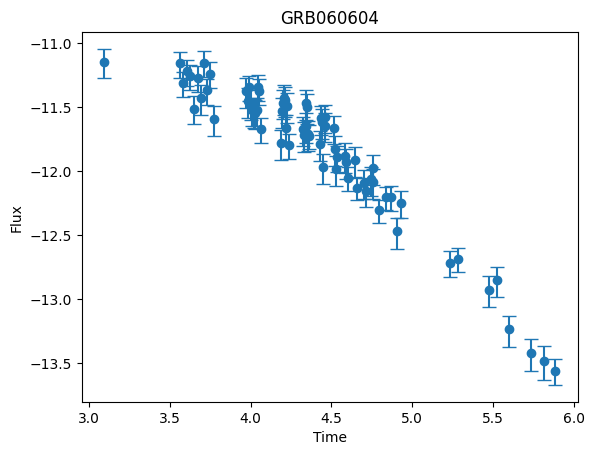


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.7725
Epoch 50, Loss: -0.7553
Epoch 100, Loss: -0.8326
Epoch 150, Loss: -0.7842
Epoch 200, Loss: -0.7528
Epoch 250, Loss: -0.8762
Epoch 300, Loss: -0.7519
Epoch 350, Loss: -0.8614
Epoch 400, Loss: -0.7731
Epoch 450, Loss: -0.6616

-----RECONSTRUCTED GRB-----



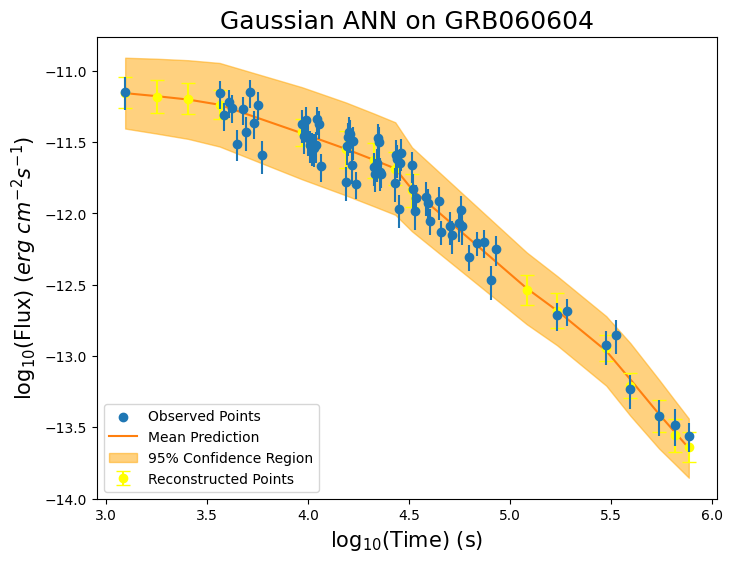


-----TRAINING FOR GRB060605-----


-----ORIGINAL GRB-----



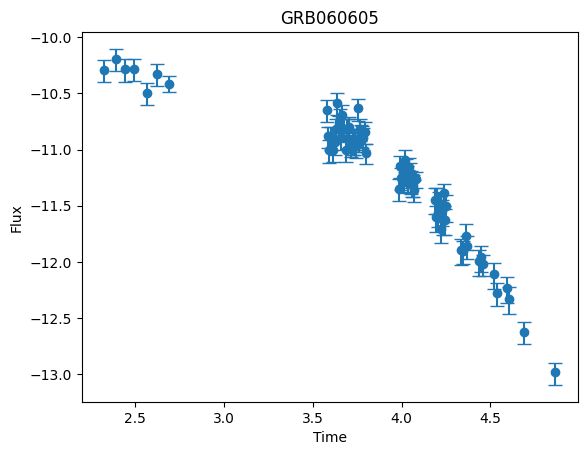


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.1046
Epoch 50, Loss: -0.8742
Epoch 100, Loss: -0.7160
Epoch 150, Loss: -0.8834
Epoch 200, Loss: -0.7776
Epoch 250, Loss: -0.8488
Epoch 300, Loss: -0.8481
Epoch 350, Loss: -0.7028
Epoch 400, Loss: -0.6935
Epoch 450, Loss: -0.8682

-----RECONSTRUCTED GRB-----



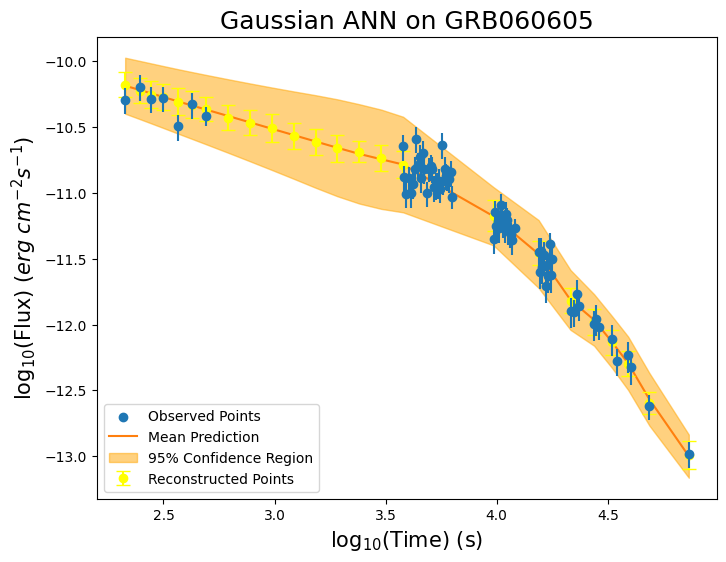


-----TRAINING FOR GRB060607A-----


-----ORIGINAL GRB-----



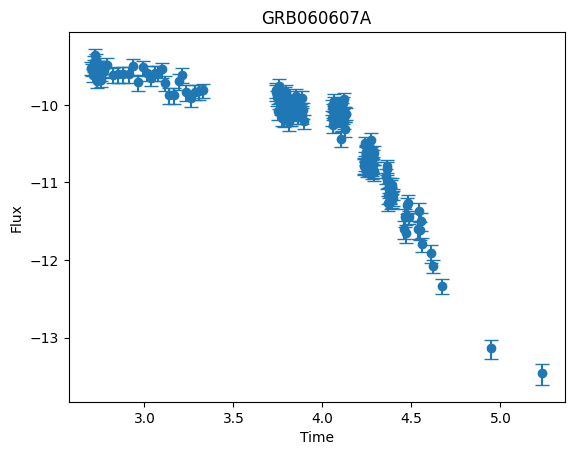


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.2016
Epoch 50, Loss: -0.7763
Epoch 100, Loss: -0.8186
Epoch 150, Loss: -0.8109
Epoch 200, Loss: -0.8393
Epoch 250, Loss: -0.8072
Epoch 300, Loss: -0.6596
Epoch 350, Loss: -0.8819
Epoch 400, Loss: -0.7643
Epoch 450, Loss: -0.7770

-----RECONSTRUCTED GRB-----



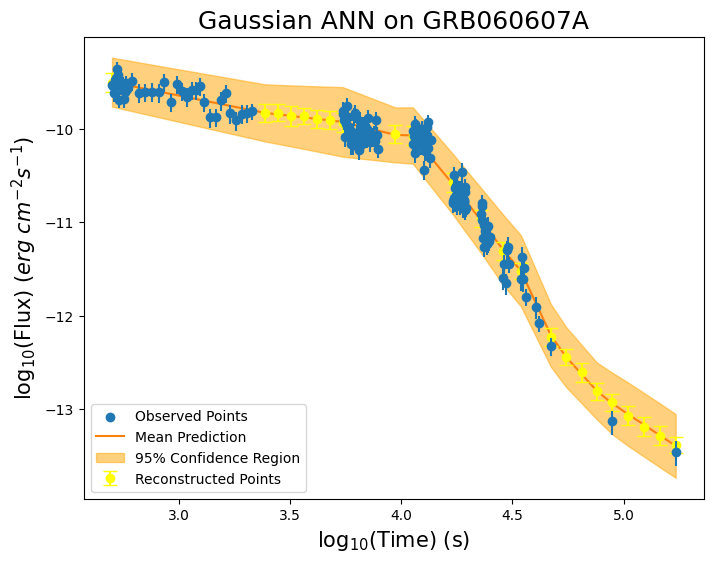


-----TRAINING FOR GRB060614-----


-----ORIGINAL GRB-----



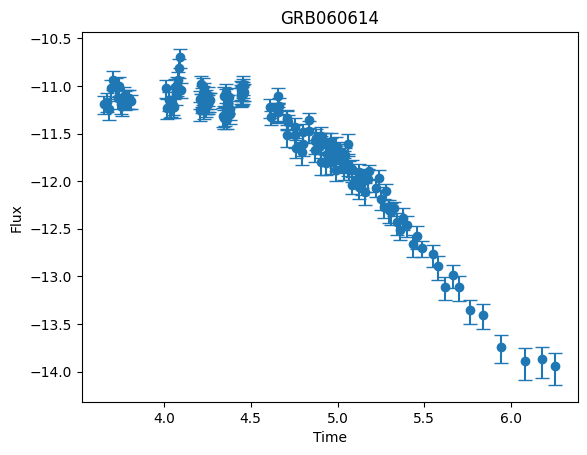


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: -0.0234
Epoch 50, Loss: -0.7107
Epoch 100, Loss: -0.7214
Epoch 150, Loss: -0.7665
Epoch 200, Loss: -0.7839
Epoch 250, Loss: -0.7425
Epoch 300, Loss: -0.7985
Epoch 350, Loss: -0.6793
Epoch 400, Loss: -0.7870
Epoch 450, Loss: -0.8609

-----RECONSTRUCTED GRB-----



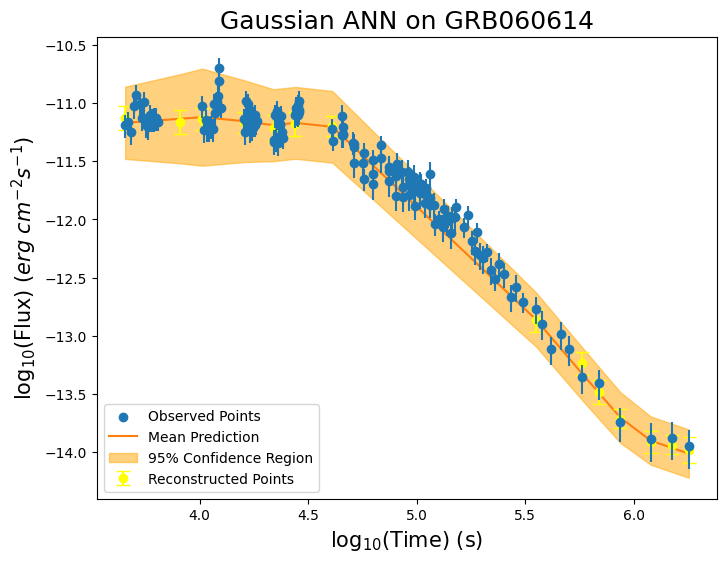


-----TRAINING FOR GRB060708-----


-----ORIGINAL GRB-----



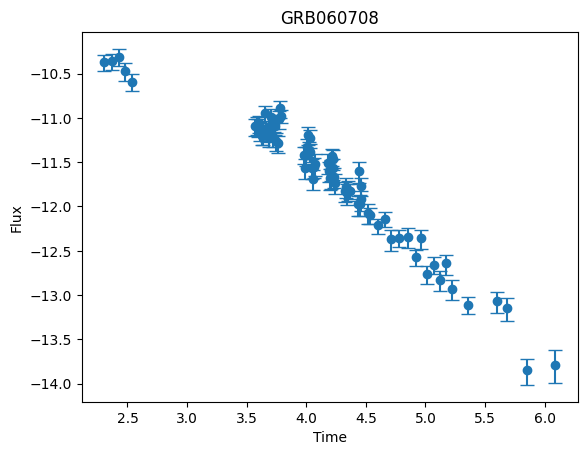


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.3400
Epoch 50, Loss: -0.6675
Epoch 100, Loss: -0.7215
Epoch 150, Loss: -0.7346
Epoch 200, Loss: -0.6735
Epoch 250, Loss: -0.8604
Epoch 300, Loss: -0.8580
Epoch 350, Loss: -0.7476
Epoch 400, Loss: -0.7536
Epoch 450, Loss: -0.8426

-----RECONSTRUCTED GRB-----



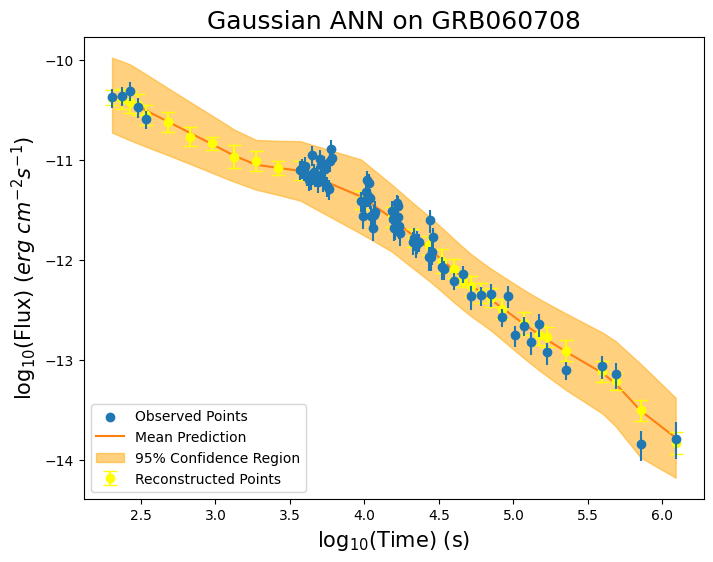


-----TRAINING FOR GRB060714-----


-----ORIGINAL GRB-----



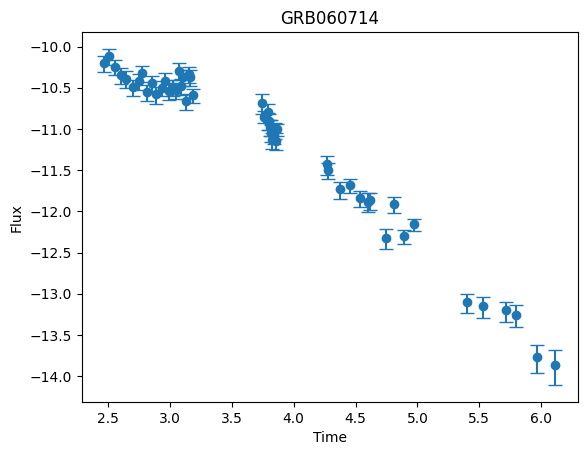


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.2632
Epoch 50, Loss: -0.9038
Epoch 100, Loss: -0.9043
Epoch 150, Loss: -0.9905
Epoch 200, Loss: -1.0391
Epoch 250, Loss: -0.9079
Epoch 300, Loss: -1.0174
Epoch 350, Loss: -0.9844
Epoch 400, Loss: -0.9655
Epoch 450, Loss: -0.9619

-----RECONSTRUCTED GRB-----



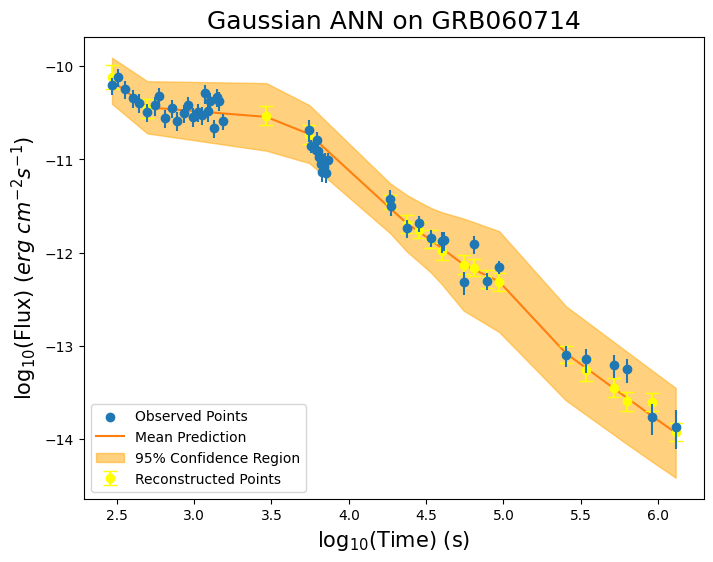


-----TRAINING FOR GRB060729-----


-----ORIGINAL GRB-----



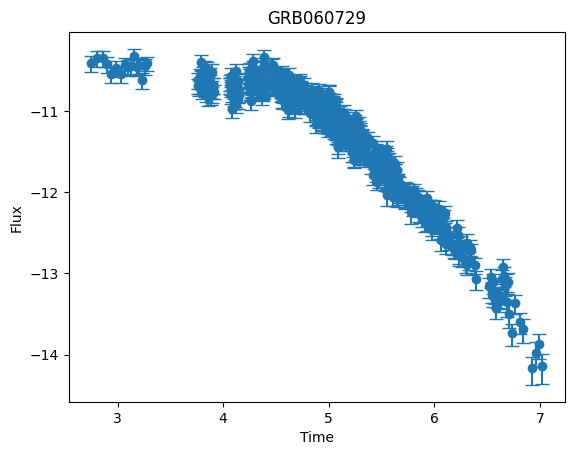


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: -0.7316
Epoch 50, Loss: -0.9500
Epoch 100, Loss: -0.8608
Epoch 150, Loss: -0.8570
Epoch 200, Loss: -0.7212
Epoch 250, Loss: -0.8238
Epoch 300, Loss: -0.8869
Epoch 350, Loss: -0.7872
Epoch 400, Loss: -0.7314
Epoch 450, Loss: -0.7263

-----RECONSTRUCTED GRB-----



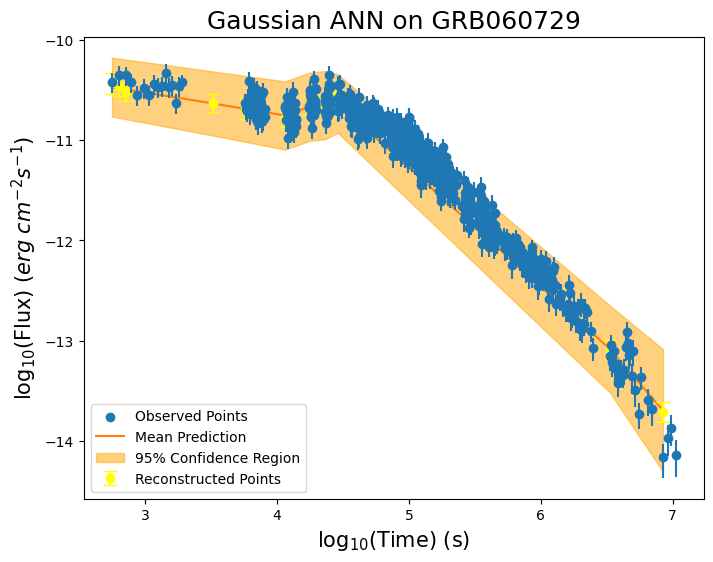


-----TRAINING FOR GRB060814-----


-----ORIGINAL GRB-----



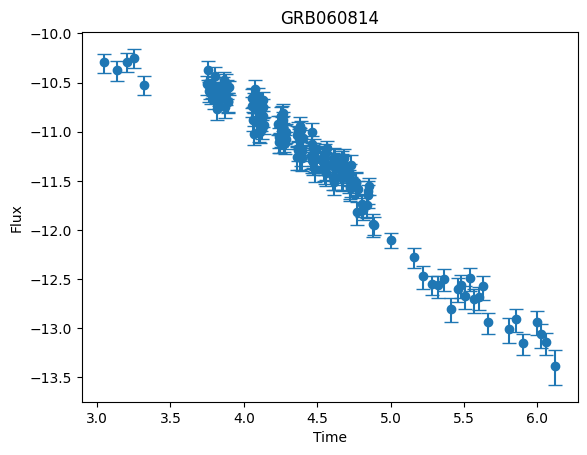


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.0908
Epoch 50, Loss: -0.7234
Epoch 100, Loss: -0.8258
Epoch 150, Loss: -0.9018
Epoch 200, Loss: -0.9337
Epoch 250, Loss: -0.8625
Epoch 300, Loss: -0.8952
Epoch 350, Loss: -0.7658
Epoch 400, Loss: -0.9232
Epoch 450, Loss: -0.7592

-----RECONSTRUCTED GRB-----



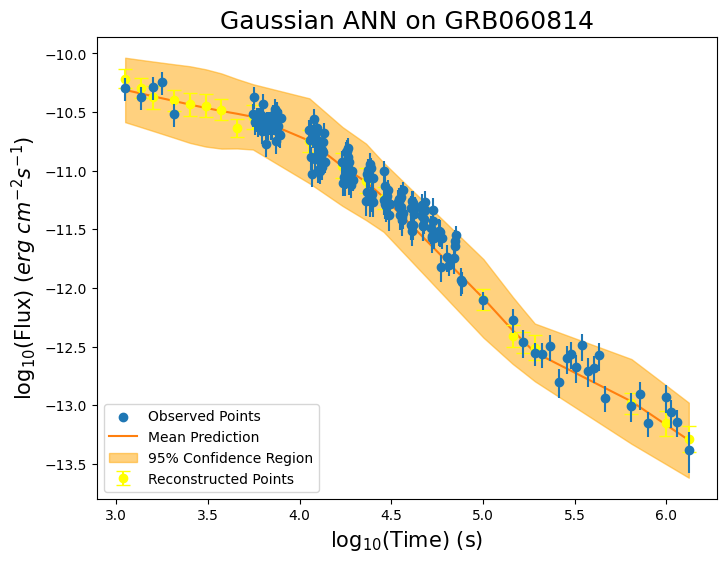


-----TRAINING FOR GRB060904B-----


-----ORIGINAL GRB-----



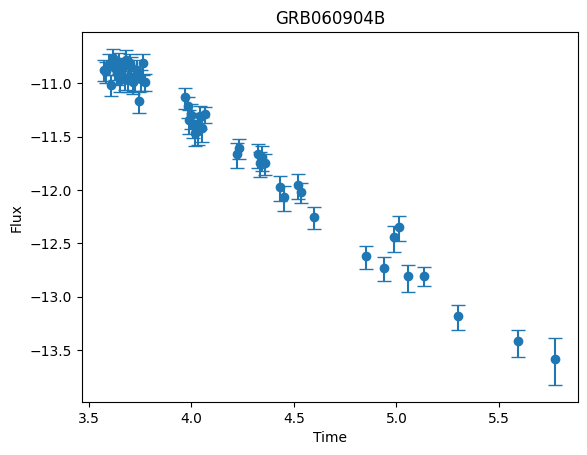


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.3294
Epoch 50, Loss: -0.7553
Epoch 100, Loss: -0.8867
Epoch 150, Loss: -0.8047
Epoch 200, Loss: -0.9174
Epoch 250, Loss: -0.8498
Epoch 300, Loss: -0.9620
Epoch 350, Loss: -0.9464
Epoch 400, Loss: -0.8730
Epoch 450, Loss: -0.9211

-----RECONSTRUCTED GRB-----



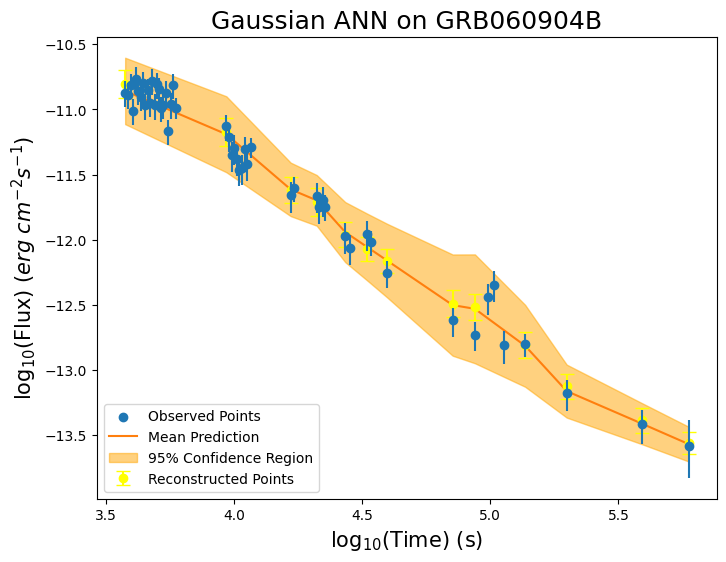


-----TRAINING FOR GRB060906-----


-----ORIGINAL GRB-----



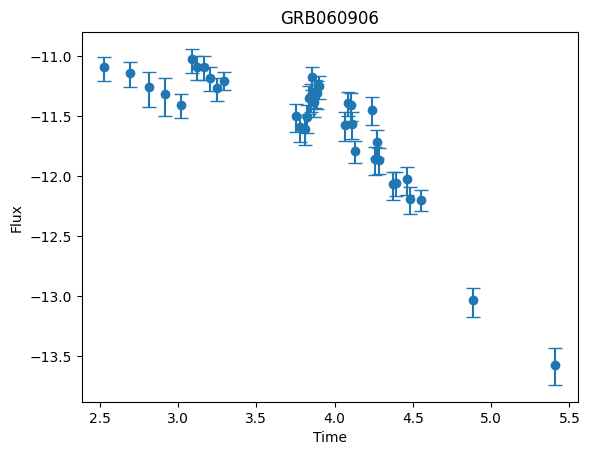


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.1898
Epoch 50, Loss: -0.4571
Epoch 100, Loss: -0.5492
Epoch 150, Loss: -0.6171
Epoch 200, Loss: -0.6390
Epoch 250, Loss: -0.5217
Epoch 300, Loss: -0.5382
Epoch 350, Loss: -0.7955
Epoch 400, Loss: -0.7433
Epoch 450, Loss: -0.7332

-----RECONSTRUCTED GRB-----



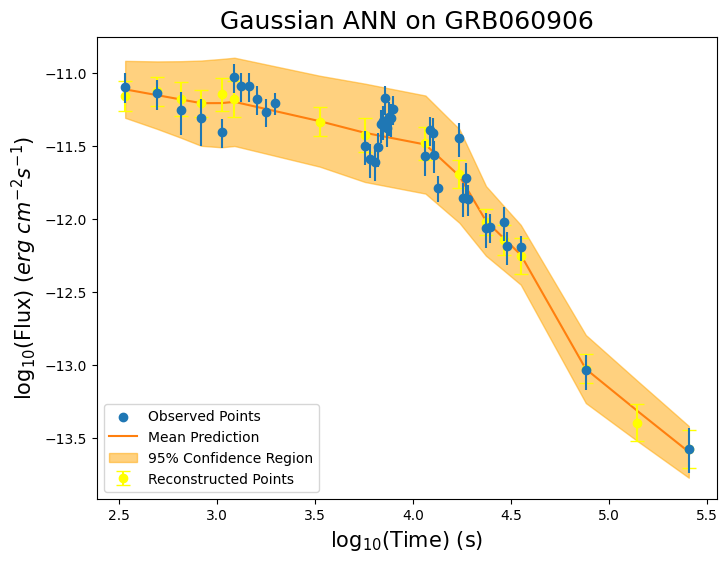


-----TRAINING FOR GRB060908-----


-----ORIGINAL GRB-----



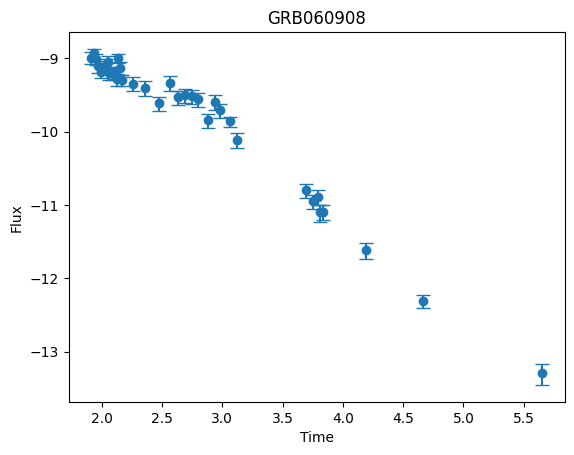


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.1132
Epoch 50, Loss: -0.9839
Epoch 100, Loss: -0.8958
Epoch 150, Loss: -1.1202
Epoch 200, Loss: -1.0068
Epoch 250, Loss: -0.9436
Epoch 300, Loss: -0.8865
Epoch 350, Loss: -0.9579
Epoch 400, Loss: -0.9342
Epoch 450, Loss: -1.0596

-----RECONSTRUCTED GRB-----



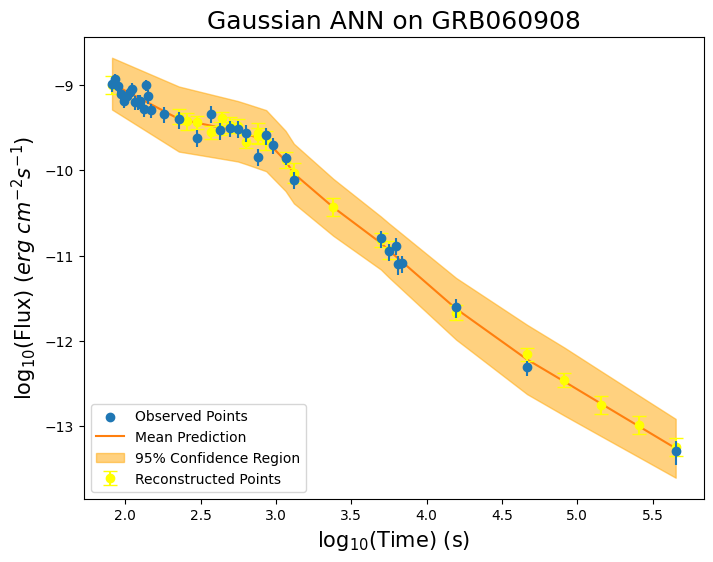


-----TRAINING FOR GRB061021-----


-----ORIGINAL GRB-----



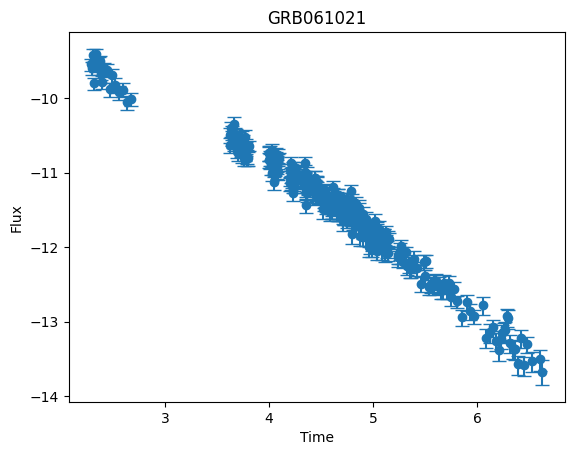


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: -0.2607
Epoch 50, Loss: -0.9907
Epoch 100, Loss: -0.9110
Epoch 150, Loss: -0.8881
Epoch 200, Loss: -0.8798
Epoch 250, Loss: -0.9349
Epoch 300, Loss: -0.8683
Epoch 350, Loss: -0.8372
Epoch 400, Loss: -0.9098
Epoch 450, Loss: -0.8153

-----RECONSTRUCTED GRB-----



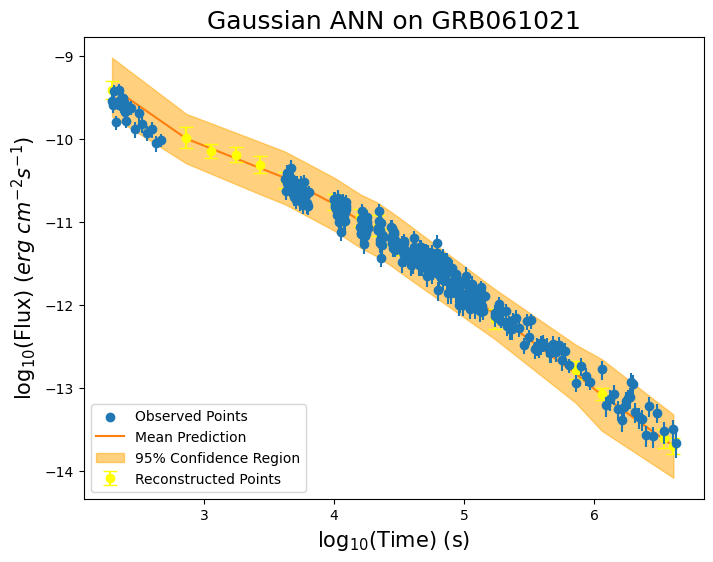


-----TRAINING FOR GRB060927-----


-----ORIGINAL GRB-----



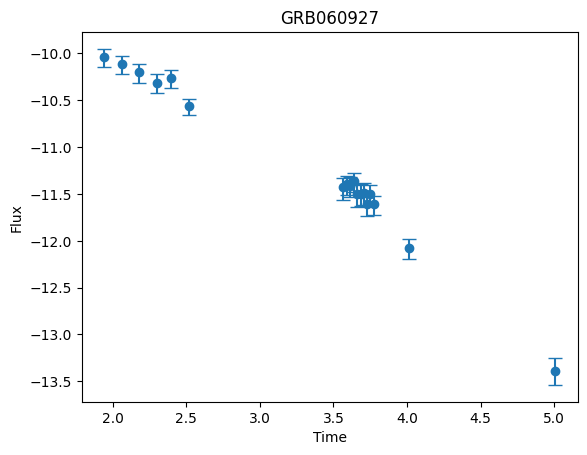


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.4611
Epoch 50, Loss: -1.1067
Epoch 100, Loss: -1.1239
Epoch 150, Loss: -1.1262
Epoch 200, Loss: -1.1244
Epoch 250, Loss: -1.1241
Epoch 300, Loss: -1.1443
Epoch 350, Loss: -1.1425
Epoch 400, Loss: -1.1536
Epoch 450, Loss: -1.1469

-----RECONSTRUCTED GRB-----



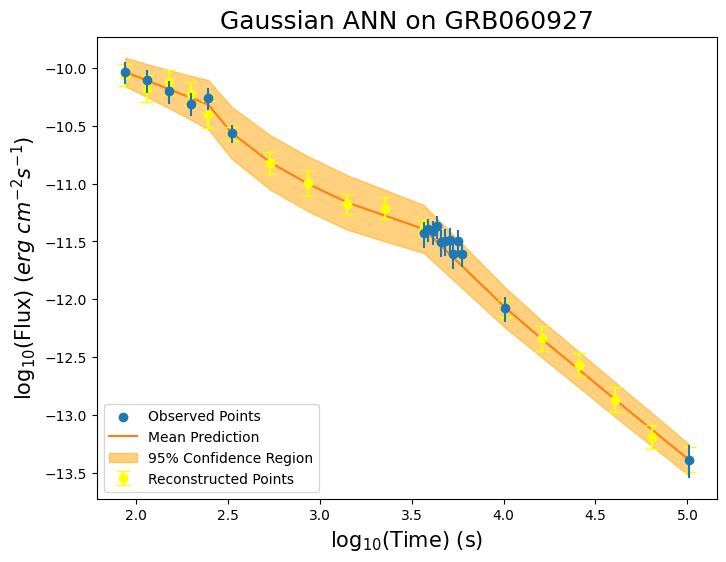


-----TRAINING FOR GRB061121-----


-----ORIGINAL GRB-----



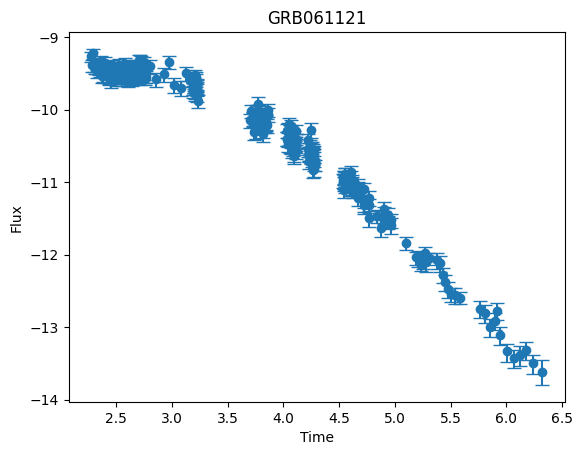


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: -0.1814
Epoch 50, Loss: -0.9780
Epoch 100, Loss: -1.0142
Epoch 150, Loss: -1.0379
Epoch 200, Loss: -1.0021
Epoch 250, Loss: -1.0920
Epoch 300, Loss: -1.0026
Epoch 350, Loss: -0.9590
Epoch 400, Loss: -0.9859
Epoch 450, Loss: -0.9116

-----RECONSTRUCTED GRB-----



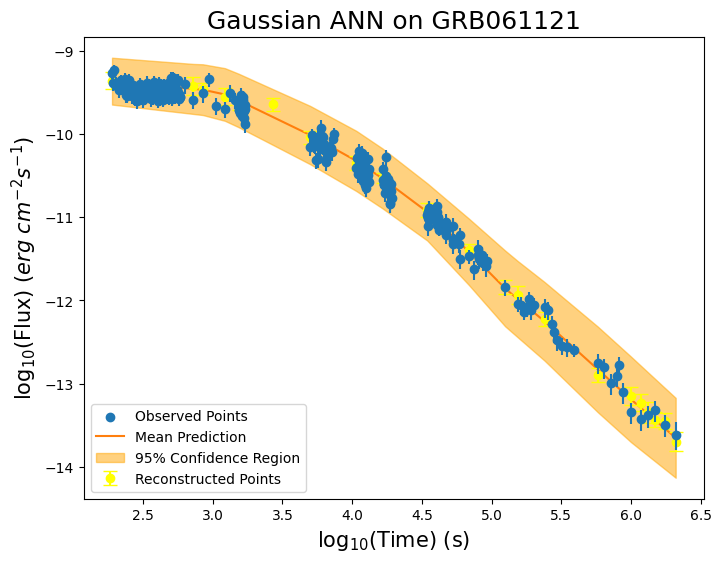


-----TRAINING FOR GRB061201-----


-----ORIGINAL GRB-----



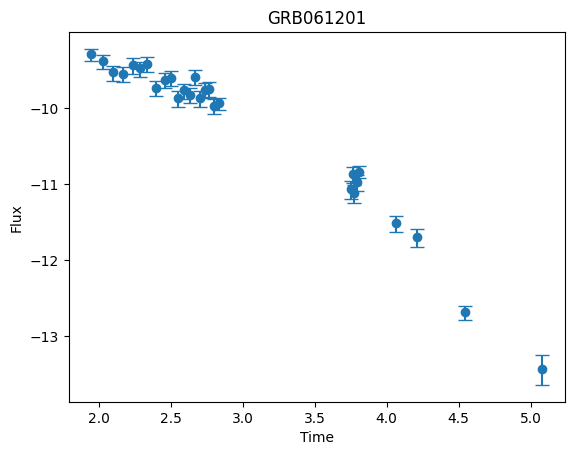


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.5634
Epoch 50, Loss: -0.9795
Epoch 100, Loss: -0.9999
Epoch 150, Loss: -1.0074
Epoch 200, Loss: -0.9504
Epoch 250, Loss: -1.0282
Epoch 300, Loss: -1.0337
Epoch 350, Loss: -1.0364
Epoch 400, Loss: -1.0459
Epoch 450, Loss: -1.0577

-----RECONSTRUCTED GRB-----



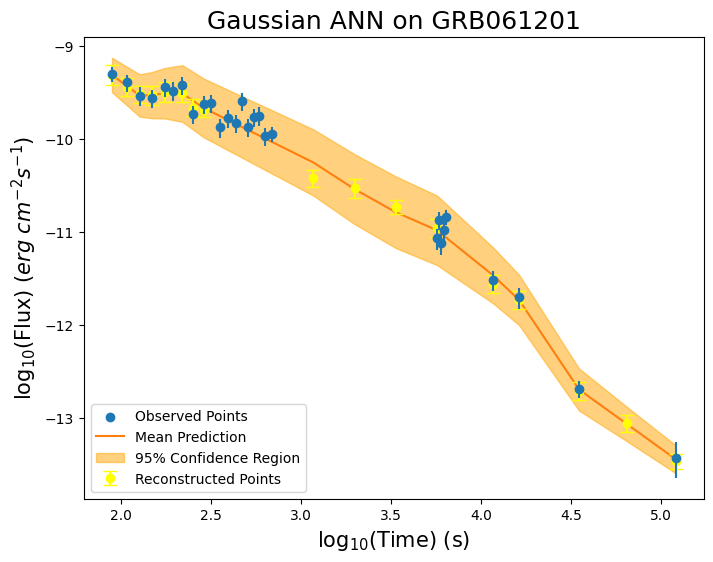


-----TRAINING FOR GRB070110-----


-----ORIGINAL GRB-----



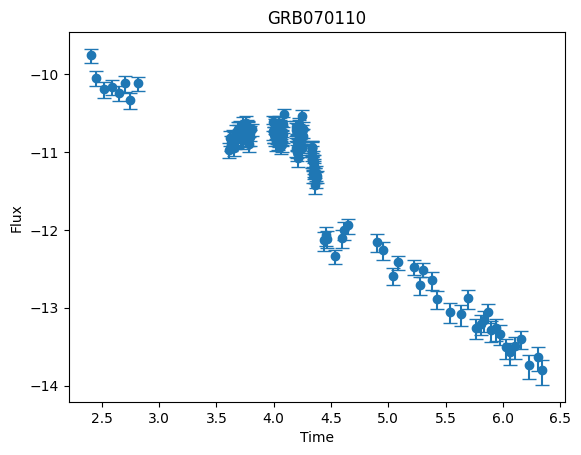


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.1122
Epoch 50, Loss: -0.9267
Epoch 100, Loss: -0.8747
Epoch 150, Loss: -0.9388
Epoch 200, Loss: -0.8839
Epoch 250, Loss: -0.9817
Epoch 300, Loss: -1.0061
Epoch 350, Loss: -0.9495
Epoch 400, Loss: -0.9874
Epoch 450, Loss: -0.9302

-----RECONSTRUCTED GRB-----



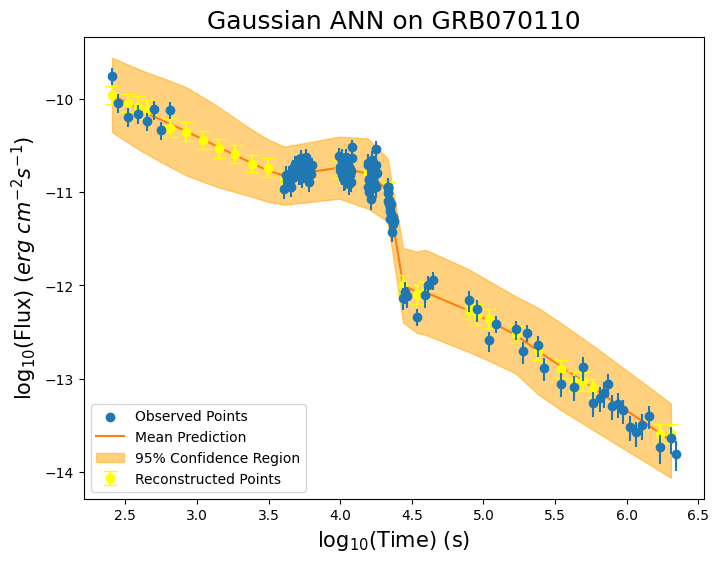


-----TRAINING FOR GRB070208-----


-----ORIGINAL GRB-----



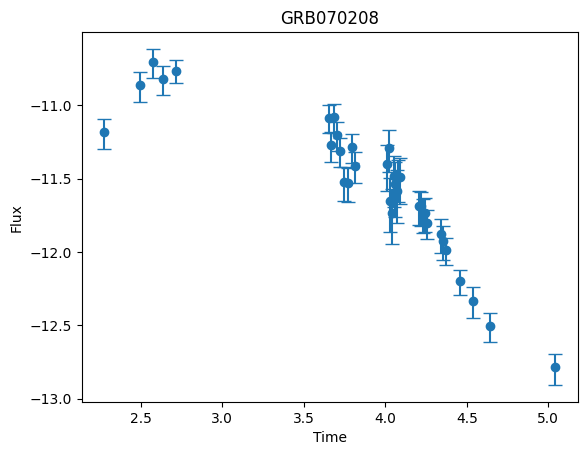


------------------MODEL TRAINING BEGIN---------------------

Epoch 0, Loss: 0.0177
Epoch 50, Loss: -0.7644
Epoch 100, Loss: -0.4182
Epoch 150, Loss: -0.8776
Epoch 200, Loss: -0.2715
Epoch 250, Loss: -0.7213
Epoch 300, Loss: -0.6981
Epoch 350, Loss: -0.4644
Epoch 400, Loss: -0.7324
Epoch 450, Loss: -0.8416

-----RECONSTRUCTED GRB-----



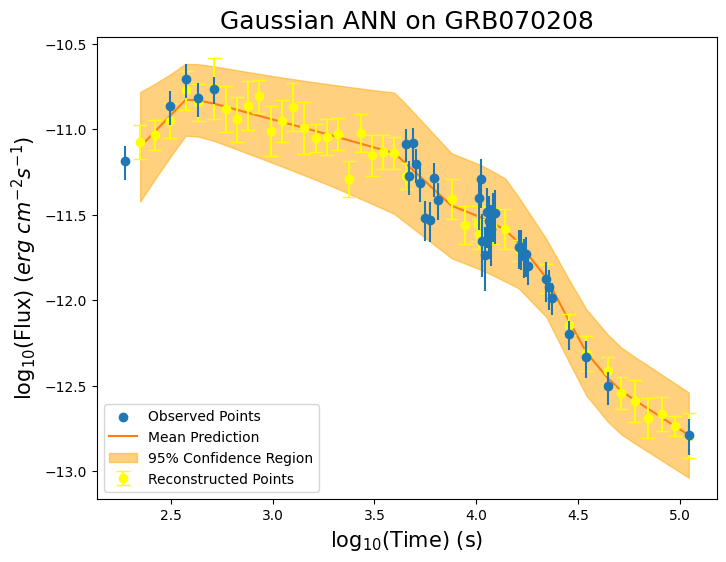

In [ ]:
GRB_names=[
      "GRB050128",
    "GRB050502B",
    "GRB050607",
    "GRB050712",
    "GRB050713A",
    "GRB050713B",
    "GRB050726",
    "GRB050814",
    "GRB050822",
    "GRB050915B",
    "GRB050922B",
    "GRB051016A",
    "GRB060105",
    "GRB060108",
    "GRB060109",
    "GRB060219",
    "GRB060312",
    "GRB060413",
    "GRB060421",
    "GRB060510A",
    "GRB060719",
    "GRB060805A",
    "GRB060807",
    "GRB060813",
    "GRB060923A",
    "GRB060923C",
    "GRB061019",
    "GRB061202",
    "GRB070103",
    "GRB070107",
    "GRB070129",
    "GRB070224",
    "GRB070328",
    "GRB070420",
    "GRB070517",
    "GRB070621",
    "GRB070628",
    "GRB070714A",
    "GRB080129",
    "GRB080205",
    "GRB080212",
    "GRB080218B",
    "GRB080229A",
    "GRB080328",
    "GRB080409",
    "GRB080426",
    "GRB080605",
    "GRB080707",
    "GRB081126",
    "GRB081222",
    "GRB090113",
    "GRB090404",
    "GRB090407",
    "GRB090518",
    "GRB090727",
    "GRB090728",
    "GRB090807",
    "GRB090813",
    "GRB090904A",
    "GRB091130B",
    "GRB100302A",
    "GRB100305A",
    "GRB100424A",
    "GRB100522A",
    "GRB100606A",
    "GRB100725A",
    "GRB100725B",
    "GRB100727A",
    "GRB100802A",
    "GRB101011A",
    "GRB101024A",
    "GRB110102A",
    "GRB110201A",
    "GRB110208A",
    "GRB110312A",
    "GRB110315A",
    "GRB110318B",
    "GRB110319A",
    "GRB110402A",
    "GRB110411A",
    "GRB110414A",
    "GRB110420A",
    "GRB110530A",
    "GRB110610A",
    "GRB110709A",
    "GRB110801A",
    "GRB110820A",
    "GRB111107A",
    "GRB111121A",
    "GRB111129A",
    "GRB120102A",
    "GRB120116A",
    "GRB120119A",
    "GRB120211A",
    "GRB120213A",
    "GRB120215A",
    "GRB120224A",
    "GRB120308A",
    "GRB120324A",
    "GRB120326A",
    "GRB120701A",
    "GRB120703A",
    "GRB120728A",
    "GRB120927A",
    "GRB121123A",
    "GRB121209A",
    "GRB121217A",
    "GRB130131A",
    "GRB130211A",
    "GRB130427B",
    "GRB130504A",
    "GRB130527A",
    "GRB130528A",
    "GRB130603A",
    "GRB130608A",
    "GRB130609B",
    "GRB130725B",
    "GRB130812A",
    "GRB130816A",
    "GRB131002A",
    "GRB131002B",
    "GRB131018A",
    "GRB131024A",
    "GRB131229A",
    "GRB140108A",
    "GRB140114A",
    "GRB140215A",
    "GRB140304A",
    "GRB140323A",
    "GRB140331A",
    "GRB140626A",
    "GRB140703A",
    "GRB140706A",
    "GRB140709A",
    "GRB140713A",
    "GRB140719A",
    "GRB140730A",
    "GRB140817A",
    "GRB140818B",
    "GRB140824A",
    "GRB140916A",
    "GRB140927A",
    "GRB141005A",
    "GRB141017A",
    "GRB141020A",
    "GRB141026A",
    "GRB141031A",
    "GRB141109B",
    "GRB141221A",
    "GRB150323A",
    "GRB150323C",
    "GRB150424A",
    "GRB150428B",
    "GRB150430A",
    "GRB150530A",
    "GRB150607A",
    "GRB150615A",
    "GRB150626B",
    "GRB150711A",
    "GRB150801B",
    "GRB150817A",
    "GRB150911A",
    "GRB151001A",
    "GRB151114A",
    "GRB151118A",
    "GRB151205A",
    "GRB151228B",
    "GRB151229A",
    "GRB160104A",
    "GRB160119A",
    "GRB160123A",
    "GRB160127A",
    "GRB160412A",
    "GRB160417A",
    "GRB160504A",
    "GRB160630A",
    "GRB160705B",
    "GRB160815A",
    "GRB160824A",
    "GRB160905A",
    "GRB161001A",
    "GRB161004B",
    "GRB161113A",
    "GRB161214B",
    "GRB161217A",
    "GRB170208B",
    "GRB170317A",
    "GRB170331A",
    "GRB170711A",
    "GRB170803A",
    "GRB170822A",
    "GRB171027A",
    "GRB171120A",
    "GRB171123A",
    "GRB171211A",
    "GRB180115A",
    "GRB180224A",
    "GRB180314A",
    "GRB180316A",
    "GRB180331B",
    "GRB180411A",
    "GRB180425A",
    "GRB180514A",
    "GRB180614A",
    "GRB180623A",
    "GRB180626A",
    "GRB180630A",
    "GRB180706A",
    "GRB180720C",
    "GRB180721A",
    "GRB180818B",
    "GRB180821A",
    "GRB180823A",
    "GRB180924A",
    "GRB180925A",
    "GRB180930A",
    "GRB181023A",
    "GRB181103A",
    "GRB190109A",
    "GRB190202A",
    "GRB190203A",
    "GRB190204A",
    "GRB190211A",
    "GRB190219A",
    "GRB190311A",
    "GRB190422A",
    "GRB190511A",
    "GRB190515B",
    "GRB190519A",
    "GRB190604B",
    "GRB190613B",
    "GRB190706B",
    "GRB190719C",
    "GRB050315",
    "GRB050319",
    "GRB050401",
    "GRB050416A",
    "GRB050730",
    "GRB050802",
    "GRB050803",
    "GRB050824",
    "GRB050826",
    "GRB051016B",
    "GRB051109A",
    "GRB051109B",
    "GRB051221A",
    "GRB060115",
    "GRB060124",
    "GRB060206",
    "GRB060210",
    "GRB060218",
    "GRB060223A",
    "GRB060306",
    "GRB060502A",
    "GRB060510B",
    "GRB060526",
    "GRB060604",
    "GRB060605",
    "GRB060607A",
    "GRB060614",
    "GRB060708",
    "GRB060714",
    "GRB060729",
    "GRB060814",
    "GRB060904B",
    "GRB060906",
    "GRB060908",
    "GRB061021",
    "GRB060927",
    "GRB061121",
    "GRB061201",
    "GRB070110",
    "GRB070208"

    ]
for grb in GRB_names:
  run_model(grb)

